数据预处理

In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import os
import json
import math
import numpy as np
import cv2 as cv
import random

class Dataset():
    
    def __init__(self, file_path):
        self.file_path = file_path


接下来要做的事：
1、获取横向的图片中最高的（值）
2、查看竖的图片
3、获取最长的一段文字

4、将图片拉高（等比例缩放）[统一图片的height]

5、定义网络

6、开始训练

T1.AK_XX8hXXbnu_Z1_042512.jpg
宅
(344.01, 376.97, 408.01, 441.97)


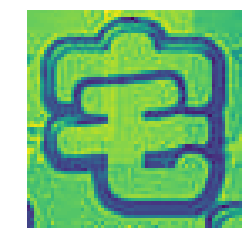

T1.AK_XX8hXXbnu_Z1_042512.jpg
屋
(396.01, 429.97, 444.01, 488.97)


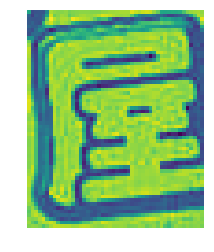

T1.AK_XX8hXXbnu_Z1_042512.jpg
S
(276.01, 397.97, 285.01, 407.97)


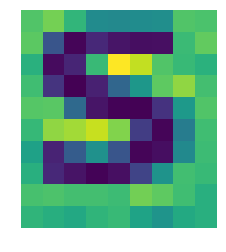

T1.AK_XX8hXXbnu_Z1_042512.jpg
F
(312.01, 397.97, 319.01, 406.97)


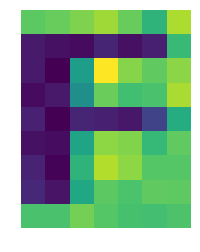

T1.AK_XX8hXXbnu_Z1_042512.jpg
★
(379.01, 502.97, 391.01, 517.97)


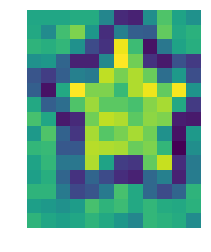

T1.AK_XX8hXXbnu_Z1_042512.jpg
★
(334.01, 498.97, 343.01, 512.97)


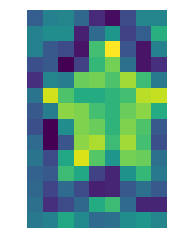

T1.AK_XX8hXXbnu_Z1_042512.jpg
★
(404.01, 498.97, 416.01, 512.97)


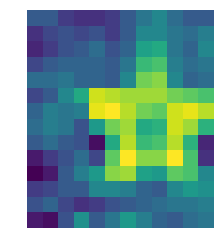

T1.AK_XX8hXXbnu_Z1_042512.jpg
★
(428.01, 411.97, 442.01, 429.97)


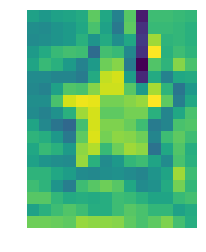

T1.AK_XX8hXXbnu_Z1_042512.jpg
★
(412.01, 400.97, 425.01, 417.97)


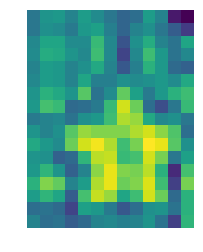

T1.AK_XX8hXXbnu_Z1_042512.jpg
★
(404.01, 382.97, 415.01, 398.97)


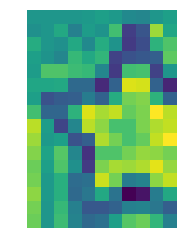

T1.lF7XuXbXXXXXXXX_!!0-item_pic.jpg
购
(78.21, 337.84, 166.47, 434.77)


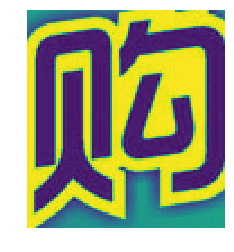

T1.lF7XuXbXXXXXXXX_!!0-item_pic.jpg
购
(310.66, 234.68, 472.73, 413.31)


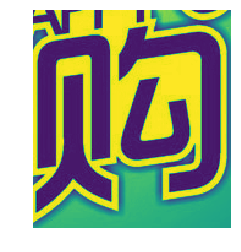

T1.lF7XuXbXXXXXXXX_!!0-item_pic.jpg
！！！
(510.42, 216.67, 592.25, 354.29)


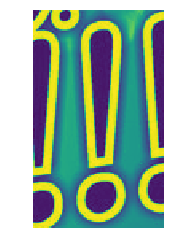

T1._WBXtXdXXXXXXXX_!!0-item_pic.jpg
0
(164.46, 335.29, 187.94, 369.04)


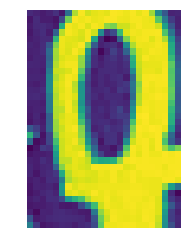

T1._WBXtXdXXXXXXXX_!!0-item_pic.jpg
R
(235.25, 320.64, 266.55, 366.22)


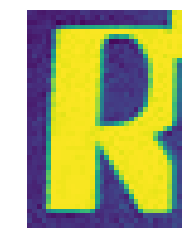

T1._WBXtXdXXXXXXXX_!!0-item_pic.jpg
O
(218.51, 439.92, 243.8, 467.13)


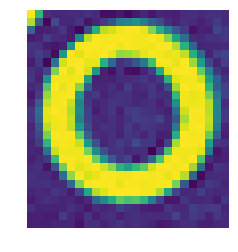

T10o9DFaRXXXXXXXXX_!!0-item_pic.jpg
孕妇护士裤
(5.29, 129.45, 75.29, 575.12)


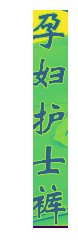

T10o9DFaRXXXXXXXXX_!!0-item_pic.jpg
粉色
(464.29, 130.12, 529.29, 254.79)


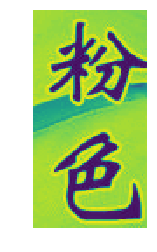

T10o9DFaRXXXXXXXXX_!!0-item_pic.jpg
蓝色
(466.29, 298.12, 528.95, 438.12)


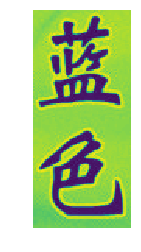

T10o9DFaRXXXXXXXXX_!!0-item_pic.jpg
白色
(546.62, 204.45, 603.95, 335.45)


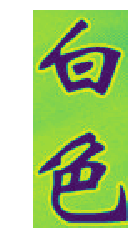

T10vNfFzJdXXXXXXXX_!!0-item_pic.jpg
TAOBAO
(154.67, 528.67, 210.67, 586.67)


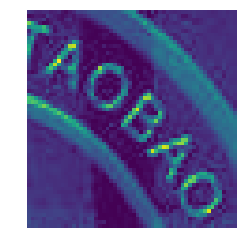

T10vNfFzJdXXXXXXXX_!!0-item_pic.jpg
.COM
(200.33, 589.67, 218.67, 631.33)


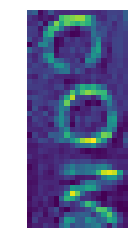

T10vNfFzJdXXXXXXXX_!!0-item_pic.jpg
实物
(49.67, 648.33, 88.0, 686.67)


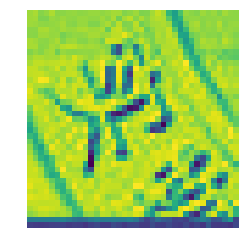

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
冀
(308.34, 551.98, 339.81, 585.63)


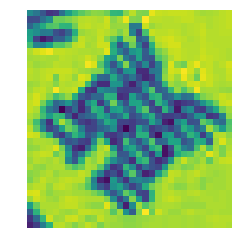

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
州
(296.1, 531.17, 322.29, 562.54)


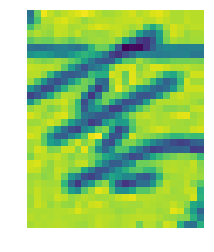

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
润
(291.63, 480.7, 314.72, 504.89)


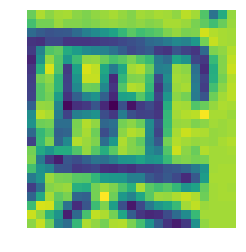

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
械
(328.95, 411.81, 355.33, 442.38)


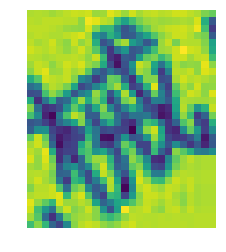

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
配
(356.23, 404.96, 376.23, 432.33)


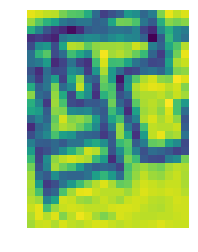

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
件
(379.42, 398.58, 397.03, 422.67)


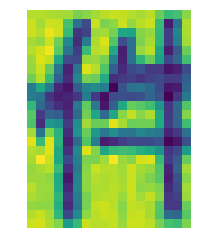

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
有
(448.21, 424.95, 475.68, 455.43)


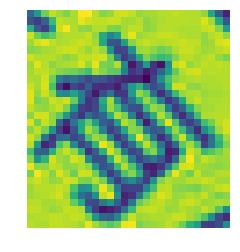

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
限
(460.45, 446.76, 488.11, 478.42)


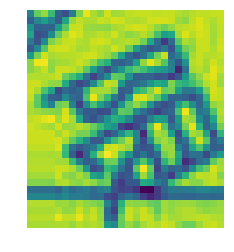

T10WUiFkdfXXXXXXXX_!!0-item_pic.jpg
司
(475.59, 503.8, 496.49, 528.6)


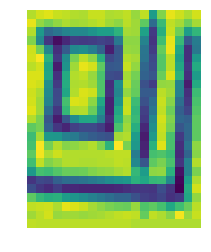

T10zjcFF0bXXa5Rw33_050206.jpg
明
(60.69, 336.56, 132.24, 412.0)


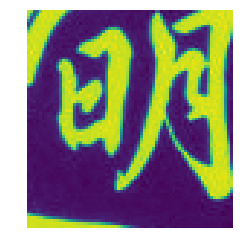

T10zjcFF0bXXa5Rw33_050206.jpg
?
(351.91, 184.18, 370.46, 206.73)


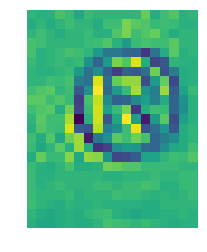

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
?
(188.68, 65.86, 201.68, 80.86)


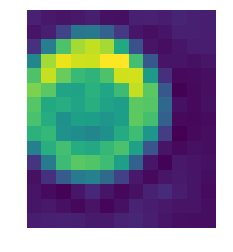

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
c
(60.08, 105.86, 66.48, 113.46)


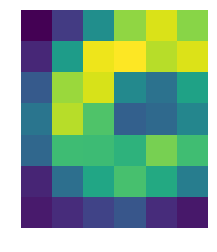

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
g
(129.68, 106.35, 134.68, 114.66)


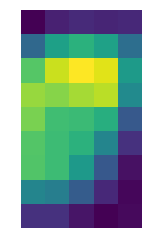

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
i
(176.21, 106.35, 181.37, 114.2)


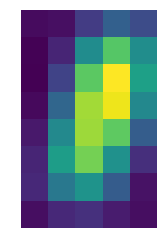

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
t
(189.52, 106.35, 197.52, 114.74)


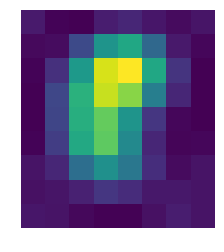

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
b
(219.98, 106.89, 227.98, 115.12)


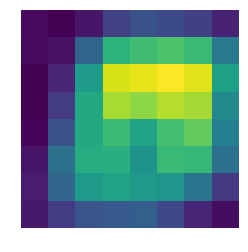

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
i
(255.98, 107.28, 261.68, 116.12)


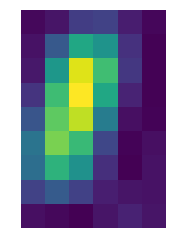

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
n
(275.37, 107.74, 281.37, 116.58)


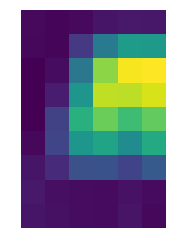

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
i
(287.37, 106.82, 291.98, 115.66)


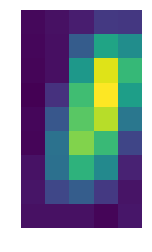

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
n
(298.14, 109.12, 303.6, 116.12)


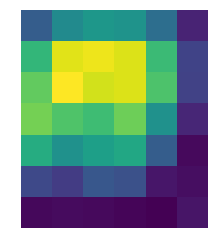

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
大
(185.21, 478.1, 273.45, 576.56)


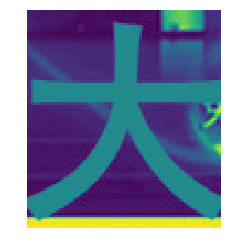

T1138BFHpbXXXXXXXX_!!0-item_pic.jpg
O
(314.52, 177.1, 330.75, 200.87)


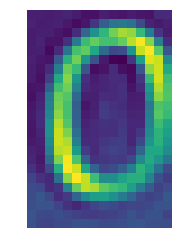

T11Ii.FORdXXXXXXXX_!!0-item_pic.jpg
4
(347.59, 585.92, 365.73, 604.69)


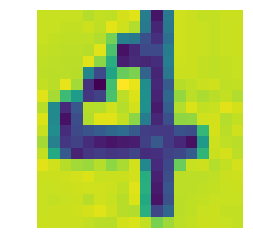

T11S3EFeJgXXXXXXXX_!!0-item_pic.jpg
B
(400.68, 468.09, 417.59, 493.73)


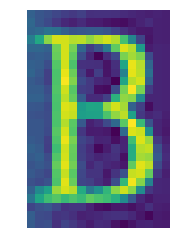

T11S3EFeJgXXXXXXXX_!!0-item_pic.jpg
F
(87.23, 361.73, 113.14, 391.45)


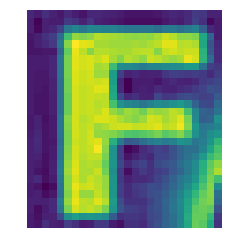

T11S3EFeJgXXXXXXXX_!!0-item_pic.jpg
Nikon
(309.5, 390.0, 344.05, 437.18)


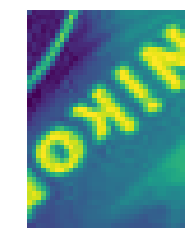

T11S3EFeJgXXXXXXXX_!!0-item_pic.jpg
丶
(350.59, 483.18, 354.68, 490.09)


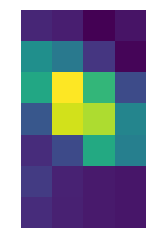

T12fNaFFhdXXa0FDo3_051314.jpg
香雪制药
(761.76, 369.06, 782.42, 448.73)


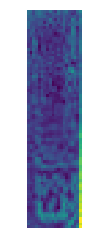

T12fNaFFhdXXa0FDo3_051314.jpg
xiangxue
(750.76, 370.39, 762.09, 450.06)


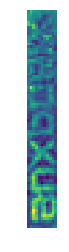

T12gsBFhBXXXXXXXXX_!!0-item_pic.jpg
深圳喷码设备
(95.34, 60.0, 259.64, 226.3)


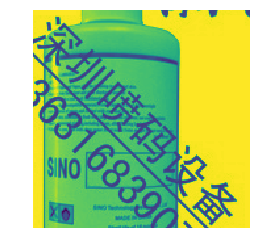

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
?
(226.99, 415.7, 239.36, 431.33)


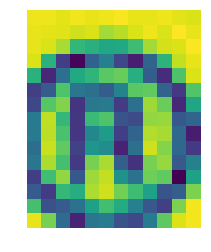

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
授权一级代理商
(600.67, 191.41, 641.1, 540.57)


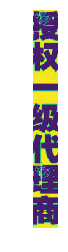

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
正品
(674.0, 192.94, 724.01, 286.69)


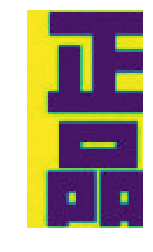

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
原装
(676.53, 313.48, 732.53, 413.76)


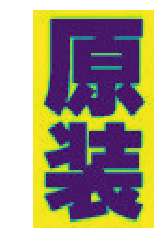

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
全新
(679.05, 444.08, 734.53, 541.83)


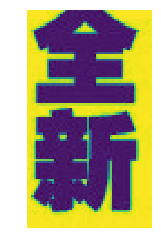

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
深圳昊仪仪器
(5.91, 189.26, 139.08, 324.18)


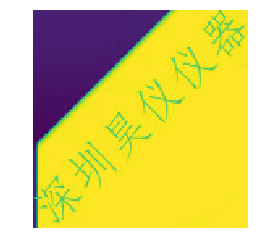

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
深圳昊仪仪器
(252.99, 187.0, 392.22, 326.44)


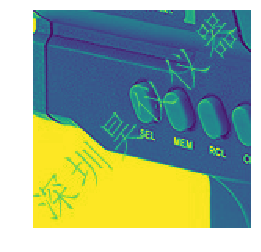

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
深圳昊仪仪器
(495.82, 434.88, 628.73, 572.32)


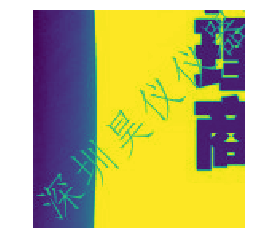

T13cZvFwBbXXXXXXXX_!!0-item_pic.jpg
表
(195.63, 437.68, 227.0, 469.11)


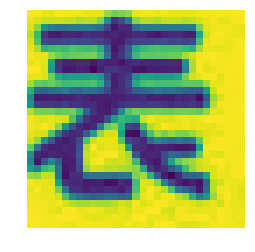

T13fGMXz8dXXXXXXXX_!!0-item_pic.jpg
编
(89.46, 259.5, 112.46, 283.09)


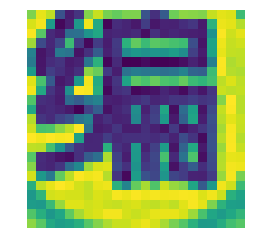

T13JrlXcXmXXbvwaw._110954.jpg
包邮
(618.38, 599.75, 736.13, 738.75)


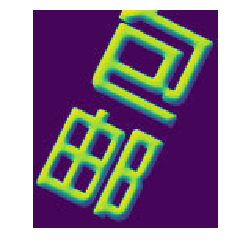

T13JrlXcXmXXbvwaw._110954.jpg
超值
(14.63, 585.75, 136.63, 732.25)


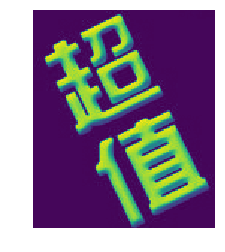

T13JrlXcXmXXbvwaw._110954.jpg
惠农孵化机
(24.88, 190.75, 92.38, 553.5)


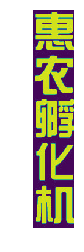

T13JrlXcXmXXbvwaw._110954.jpg
实惠给农民 
(667.88, 196.75, 729.13, 560.75)


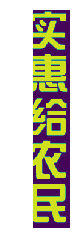

T13JrlXcXmXXbvwaw._110954.jpg
热卖
(611.63, 22.25, 735.63, 156.75)


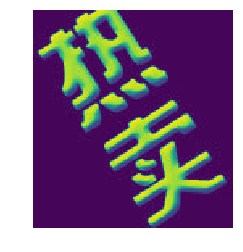

T13JrlXcXmXXbvwaw._110954.jpg
新款
(11.88, 22.5, 127.88, 162.0)


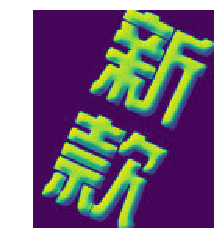

T13OV_FpNiXXXANWHX_113930.jpg
?
(391.82, 261.29, 402.32, 275.79)


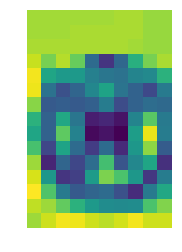

T13OV_FpNiXXXANWHX_113930.jpg
?
(445.82, 302.79, 454.82, 312.29)


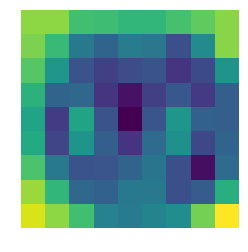

T13OV_FpNiXXXANWHX_113930.jpg
1
(450.32, 285.29, 469.32, 329.29)


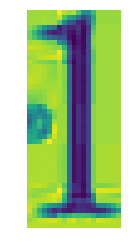

T13OV_FpNiXXXANWHX_113930.jpg
1
(460.32, 455.17, 476.32, 477.17)


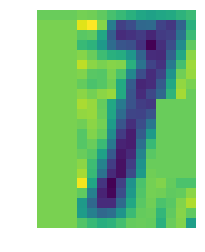

T13v9XXeFjXXXZjfTa_121124.jpg
論語
(363.75, 147.0, 398.75, 217.5)


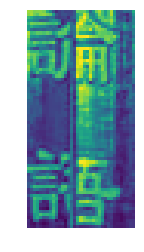

T13v9XXeFjXXXZjfTa_121124.jpg
子曰學而時習之
(324.75, 92.0, 348.75, 266.0)


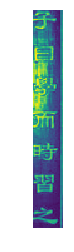

T13v9XXeFjXXXZjfTa_121124.jpg
不亦說乎有朋自
(292.25, 93.5, 315.75, 263.0)


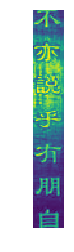

T13v9XXeFjXXXZjfTa_121124.jpg
遠方來不亦樂乎
(263.34, 92.44, 286.16, 265.44)


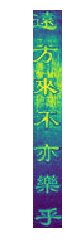

T13v9XXeFjXXXZjfTa_121124.jpg
人不知而不慍不
(235.97, 94.44, 257.34, 264.5)


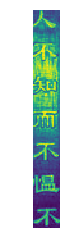

T13v9XXeFjXXXZjfTa_121124.jpg
亦君子乎有子曰
(204.78, 91.81, 222.16, 265.5)


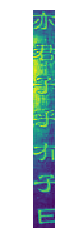

T13v9XXeFjXXXZjfTa_121124.jpg
其為人也孝弟而
(177.03, 93.81, 196.59, 271.38)


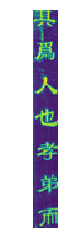

T13v9XXeFjXXXZjfTa_121124.jpg
好犯上者鮮矣不
(154.16, 89.75, 174.41, 274.13)


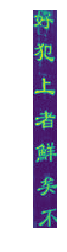

T13v9XXeFjXXXZjfTa_121124.jpg
好犯上而好作亂
(118.72, 88.75, 153.78, 282.31)


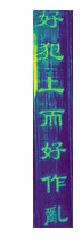

T13v9XXeFjXXXZjfTa_121124.jpg
者未之有也君子
(85.78, 88.81, 118.47, 282.63)


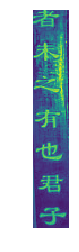

T13v9XXeFjXXXZjfTa_121124.jpg
務本本立而道生
(57.91, 87.75, 83.34, 279.13)


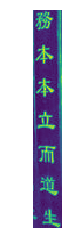

T14l43FKJXXXXXXXXX_!!0-item_pic.jpg
?
(129.55, 731.09, 164.0, 780.45)


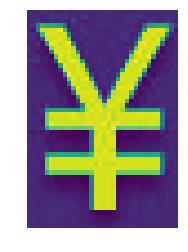

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
著
(425.63, 170.84, 441.63, 189.84)


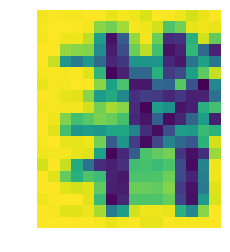

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
变
(213.63, 202.84, 280.63, 285.84)


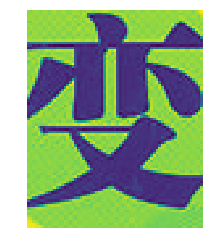

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
你
(324.63, 262.84, 367.63, 312.84)


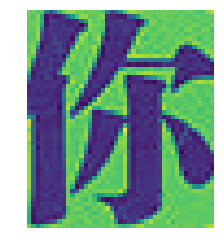

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
化
(258.63, 300.84, 305.63, 364.84)


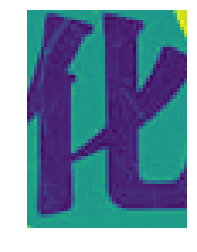

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
饮
(381.63, 315.84, 442.63, 376.84)


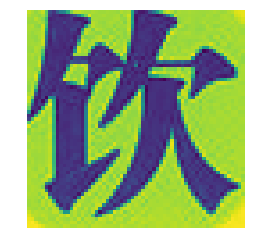

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
食
(461.63, 280.84, 521.63, 347.84)


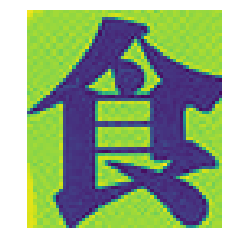

T14uwuXeNgXXXXXXXX_!!0-item_pic.jpg
BIAN
(183.63, 309.84, 226.63, 384.84)


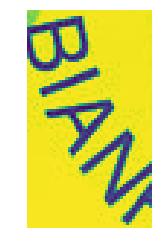

T158IlFmdXXXXXXXXX_!!0-item_pic.jpg
厂家直销
(218.4, 5.2, 237.4, 81.8)


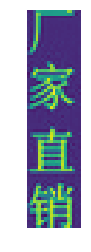

T158IlFmdXXXXXXXXX_!!0-item_pic.jpg
正品三包
(215.4, 100.0, 234.0, 174.6)


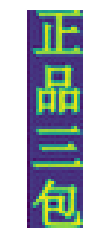

T158IlFmdXXXXXXXXX_!!0-item_pic.jpg
全铜
(1.6, 2.0, 19.6, 45.2)


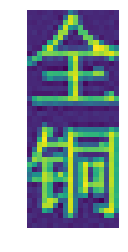

T158IlFmdXXXXXXXXX_!!0-item_pic.jpg
足功率设计
(4.2, 56.0, 19.6, 163.6)


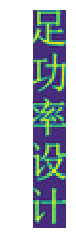

T158IlFmdXXXXXXXXX_!!0-item_pic.jpg
电
(114.2, 64.8, 128.2, 79.6)


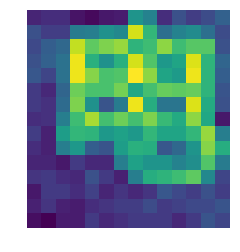

T158IlFmdXXXXXXXXX_!!0-item_pic.jpg
气
(137.2, 65.0, 149.8, 78.2)


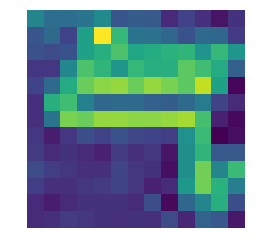

T15XQzFlFiXXXXXXXX_!!0-item_pic.jpg
北京八方通达配件批发专营
(68.28, 36.05, 96.58, 425.8)


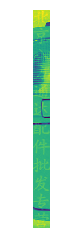

T15XQzFlFiXXXXXXXX_!!0-item_pic.jpg
北京八方通达配件批发专营
(543.02, 39.35, 567.77, 296.1)


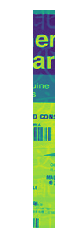

T15zajXr8eXXXXXXXX_!!0-item_pic.jpg
小心轻放
(121.74, 639.2, 325.19, 1199.26)


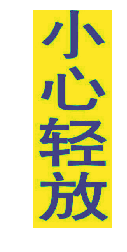

T15zajXr8eXXXXXXXX_!!0-item_pic.jpg
勿压勿摔
(1221.98, 648.2, 1406.9, 1192.67)


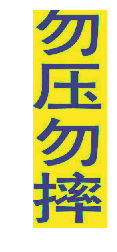

T167WTFgRcXXXXXXXX_!!0-item_pic.jpg
大
(217.03, 62.64, 330.14, 212.53)


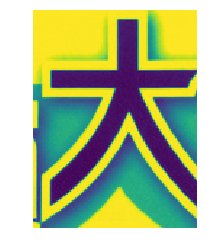

T16dBxFohbXXXXXXXX_!!0-item_pic.jpg
CE
(303.2, 227.2, 324.9, 250.6)


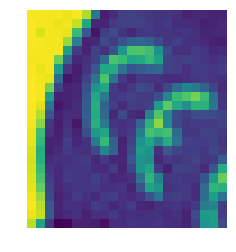

T16dBxFohbXXXXXXXX_!!0-item_pic.jpg
41+
(344.4, 57.0, 352.7, 78.1)


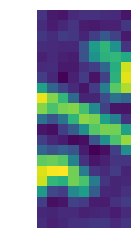

T16dBxFohbXXXXXXXX_!!0-item_pic.jpg
CE
(100.7, 285.2, 106.8, 316.8)


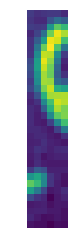

T16EB8XohtXXaMXt_X_084652.jpg
旭
(165.65, 63.47, 197.42, 99.77)


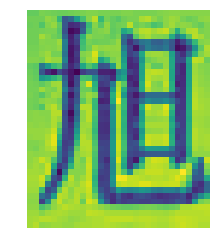

T16EB8XohtXXaMXt_X_084652.jpg
建
(216.65, 64.92, 247.23, 97.32)


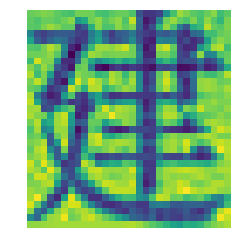

T16EB8XohtXXaMXt_X_084652.jpg
建
(24.18, 148.33, 66.3, 202.78)


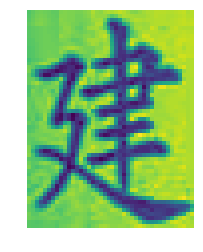

T16EB8XohtXXaMXt_X_084652.jpg
PE
(-0.95, 115.43, 14.93, 132.77)


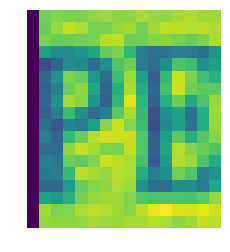

T16WKsXzdjXXXXXXXX_!!0-item_pic.jpg
原装正品
(575.4, 3.98, 697.57, 129.98)


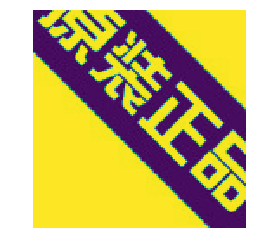

T16WKsXzdjXXXXXXXX_!!0-item_pic.jpg
点我
(427.57, 469.65, 537.24, 604.48)


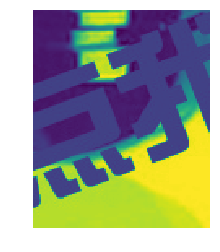

T17c2.Fe8bXXXXXXXX_!!0-item_pic.jpg
光雅电子商务运营中心
(457.71, 26.86, 491.86, 423.43)


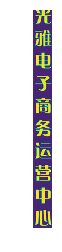

T17c2.Fe8bXXXXXXXX_!!0-item_pic.jpg
GOODFAITHFIRSTSERVICEFIRSTQUALITYFIRST
(439.57, 20.43, 457.0, 479.86)


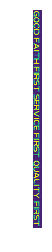

T17c2.Fe8bXXXXXXXX_!!0-item_pic.jpg
REMOVE
(302.71, 229.14, 351.71, 300.57)


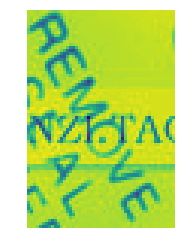

T17c2.Fe8bXXXXXXXX_!!0-item_pic.jpg
SEAL
(296.29, 246.14, 329.86, 298.14)


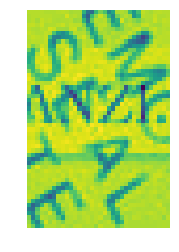

T17c2.Fe8bXXXXXXXX_!!0-item_pic.jpg
APTER
(278.43, 253.86, 316.86, 315.0)


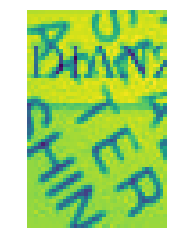

T17c2.Fe8bXXXXXXXX_!!0-item_pic.jpg
WASHING
(254.71, 250.71, 312.0, 331.0)


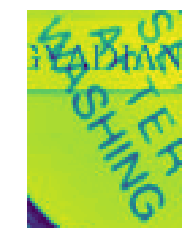

T17wiwFgdgXXXXXXXX_!!0-item_pic.jpg
伴
(347.5, 456.0, 400.5, 509.0)


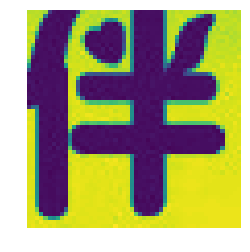

T17wiwFgdgXXXXXXXX_!!0-item_pic.jpg
侣
(421.5, 451.0, 468.5, 507.0)


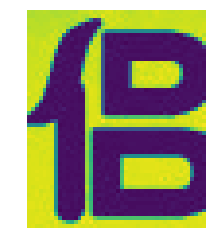

T17wiwFgdgXXXXXXXX_!!0-item_pic.jpg
持
(143.5, 526.0, 200.5, 589.0)


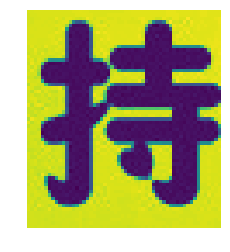

T17wiwFgdgXXXXXXXX_!!0-item_pic.jpg
康
(461.5, 528.0, 513.5, 586.0)


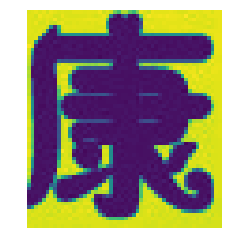

T17wiwFgdgXXXXXXXX_!!0-item_pic.jpg
新
(321.5, 77.0, 369.5, 145.0)


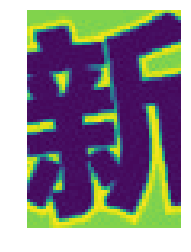

T19fLZXadlXXc4ae6b_123646.jpg
宽
(6.45, 256.21, 41.17, 302.55)


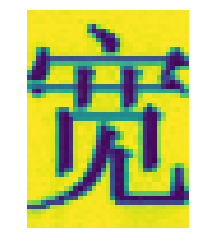

T19fLZXadlXXc4ae6b_123646.jpg
米
(265.82, 257.8, 305.64, 298.03)


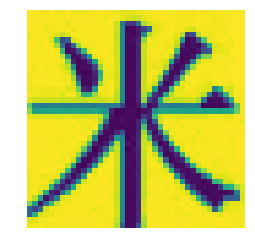

T19RmdXmhlXXcXh0I._111656.jpg
只卖江浙沪皖
(275.57, 92.0, 296.26, 240.47)


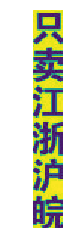

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
GENUINEPA
(765.7, 491.51, 868.07, 616.47)


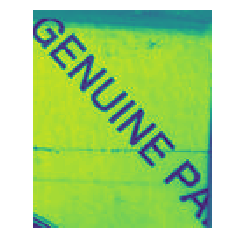

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
INE
(211.09, 531.79, 243.27, 576.29)


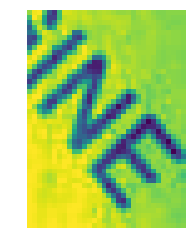

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
GENUINE
(273.09, 483.28, 354.68, 572.1)


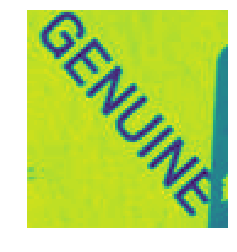

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
NEPART
(189.44, 645.85, 261.96, 733.39)


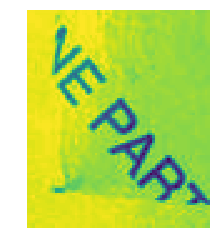

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
68
(433.33, 623.18, 450.31, 642.84)


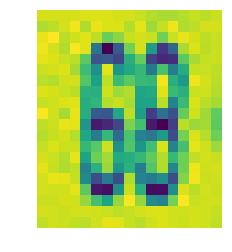

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
Hh3
(451.56, 625.42, 470.03, 647.09)


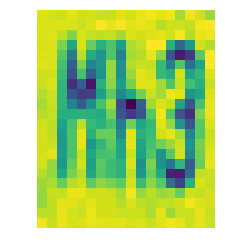

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
NALES
(677.7, 530.67, 743.05, 606.14)


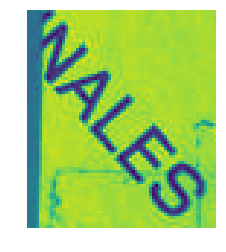

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
INEPART
(678.33, 676.73, 767.64, 772.29)


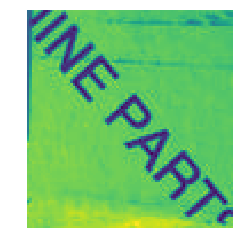

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
PIEZA
(800.1, 676.3, 867.39, 746.33)


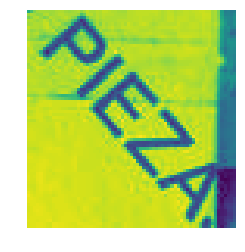

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
PIE
(307.37, 658.69, 345.7, 701.07)


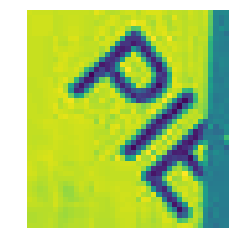

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
LAND
(266.96, 589.72, 299.37, 627.8)


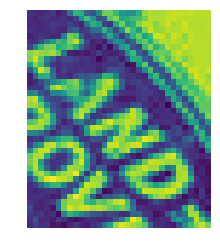

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
ROVER
(264.29, 609.09, 286.68, 638.5)


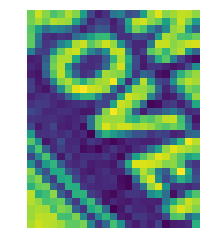

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
1
(496.83, 522.89, 506.19, 543.94)


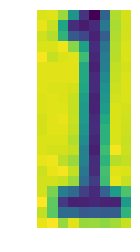

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
FRAGILE:FRAGIL
(657.88, 567.0, 675.25, 681.94)


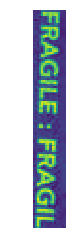

T19RucFExtXXXXXXXX_!!0-item_pic.jpg
ZERBRECHLICH
(642.84, 564.66, 661.21, 669.57)


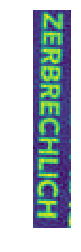

T19srUFCJcXXXXXXXX_!!0-item_pic.jpg
玻璃加厚款
(288.0, 18.33, 355.33, 375.0)


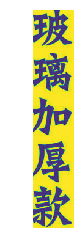

T19YoKFMhcXXXXXXXX_!!0-item_pic.jpg
F
(235.9, 453.81, 257.62, 475.89)


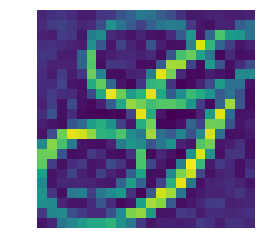

T1aMK6FtdbXXXXXXXX_!!0-item_pic.jpg
深圳市铭乐电子
(291.35, 261.8, 506.35, 590.0)


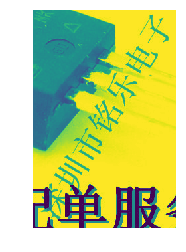

T1aMK6FtdbXXXXXXXX_!!0-item_pic.jpg
IRF740
(230.85, 262.2, 242.65, 320.2)


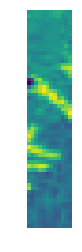

T1AtFRFzRaXXXXXXXX_!!0-item_pic.jpg
6
(43.9, 371.24, 113.79, 465.46)


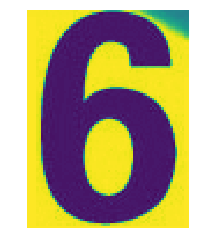

T1AtFRFzRaXXXXXXXX_!!0-item_pic.jpg
号
(119.57, 411.46, 173.23, 470.02)


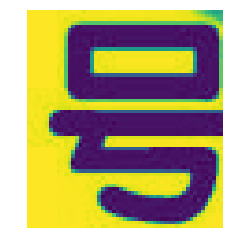

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
果
(234.0, 216.4, 256.67, 239.33)


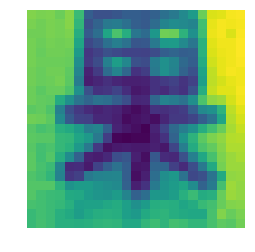

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
牌
(271.6, 216.4, 286.73, 240.4)


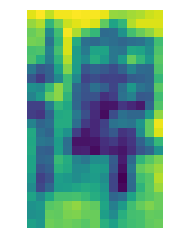

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
?
(281.8, 192.07, 295.73, 211.07)


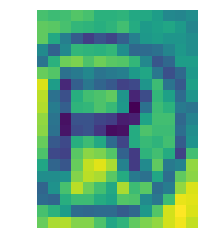

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
防
(211.47, 242.6, 224.73, 256.4)


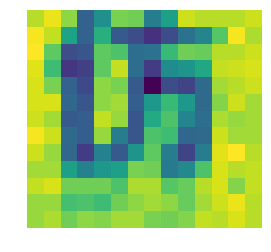

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
必
(248.73, 241.67, 259.93, 256.0)


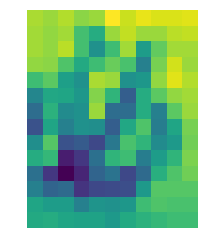

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
究
(266.4, 243.67, 274.53, 257.47)


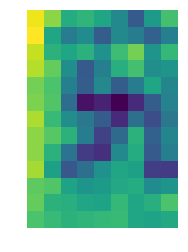

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
冒
(232.2, 241.6, 240.27, 255.4)


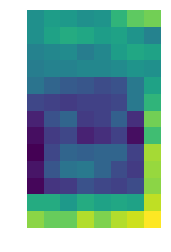

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
0
(110.53, 397.27, 138.27, 455.8)


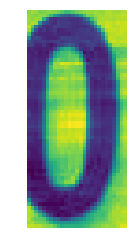

T1b7UvXohaXXXXXXXX_!!0-item_pic.jpg
s
(292.47, 404.8, 326.0, 439.93)


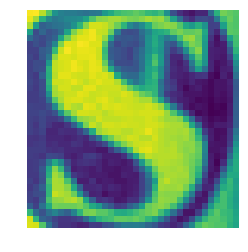

T1BFhmFKFdXXXXXXXX_!!0-item_pic.jpg
加大加厚
(728.67, 333.0, 785.33, 577.33)


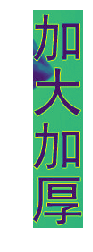

T1Bk36FAJaXXXXXXXX_!!0-item_pic.jpg
白
(29.89, 276.0, 48.78, 298.11)


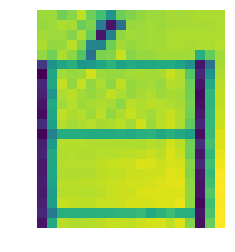

T1bm5jXkFiXXXJoqk3_045737.jpg
1
(146.88, 270.97, 151.31, 277.85)


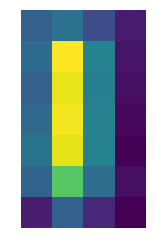

T1bQ1NFtxiXXXXXXXX_!!0-item_pic.jpg
7
(35.86, 300.14, 85.63, 391.42)


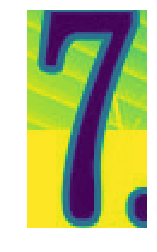

T1bQ1NFtxiXXXXXXXX_!!0-item_pic.jpg
三包送脚踩气筒
(334.28, 75.18, 380.88, 355.68)


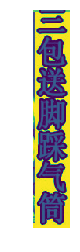

T1cMkaFMFcXXXXXXXX_!!0-item_pic.jpg
H
(352.33, 281.67, 360.33, 291.0)


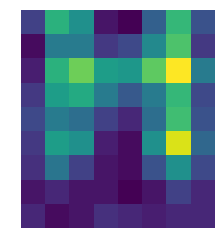

T1cMRgXcIb3tMRyW35_055013.jpg
客栈
(0.4, 110.44, 51.9, 201.94)


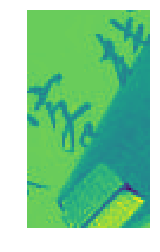

T1cMRgXcIb3tMRyW35_055013.jpg
客栈
(2.9, 267.61, 69.9, 362.61)


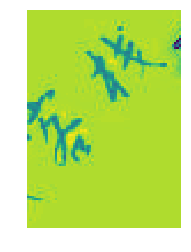

T1cMRgXcIb3tMRyW35_055013.jpg
机械客栈
(270.9, 104.49, 400.4, 235.49)


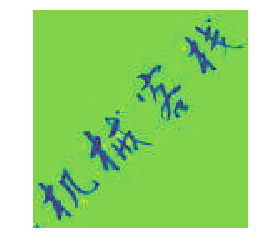

T1cMRgXcIb3tMRyW35_055013.jpg
机械客
(442.4, 129.49, 538.4, 237.99)


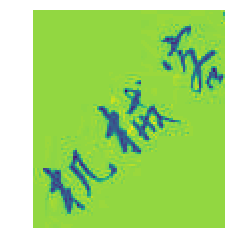

T1cMRgXcIb3tMRyW35_055013.jpg
机械客
(441.4, 297.66, 538.9, 399.16)


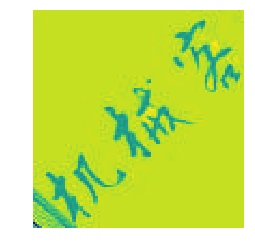

T1cMRgXcIb3tMRyW35_055013.jpg
客栈
(-2.6, 449.16, 62.4, 546.16)


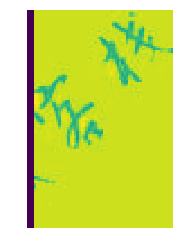

T1cMRgXcIb3tMRyW35_055013.jpg
2
(121.32, 159.12, 127.09, 165.72)


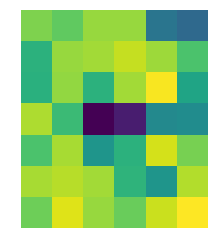

T1cMRgXcIb3tMRyW35_055013.jpg
5
(131.29, 130.62, 136.79, 137.12)


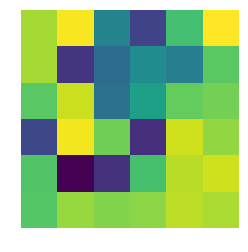

T1cMRgXcIb3tMRyW35_055013.jpg
0
(176.59, 128.7, 184.29, 136.67)


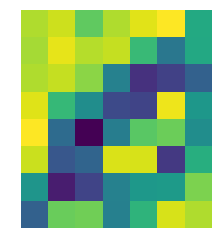

T1cMRgXcIb3tMRyW35_055013.jpg
1
(184.57, 138.32, 190.62, 144.37)


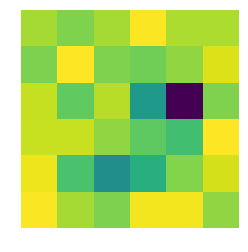

T1cMRgXcIb3tMRyW35_055013.jpg
2
(188.32, 147.85, 194.74, 155.92)


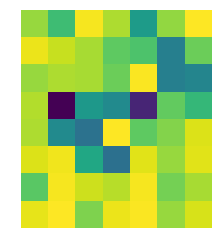

T1cMRgXcIb3tMRyW35_055013.jpg
9
(141.57, 182.53, 146.52, 189.68)


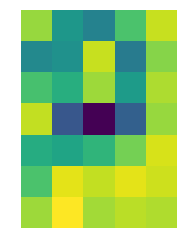

T1coatFhhaXXXXXXXX_!!0-item_pic.jpg
盗图必究
(33.2, 53.12, 91.76, 299.48)


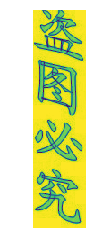

T1coatFhhaXXXXXXXX_!!0-item_pic.jpg
厂家直销
(612.08, 26.64, 695.16, 246.92)


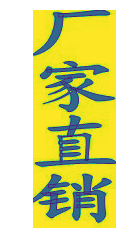

T1cpBqXzxhXXXXXXXX_!!0-item_pic.jpg
p
(156.9, 113.82, 186.87, 157.54)


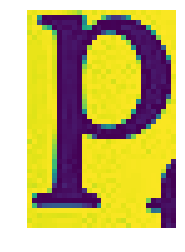

T1cpBqXzxhXXXXXXXX_!!0-item_pic.jpg
s
(189.34, 112.98, 211.04, 139.32)


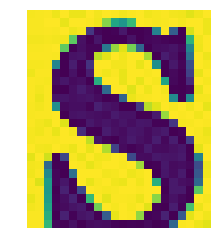

T1cSmwFQ8dXXXXXXXX_!!0-item_pic.jpg
非贴纸
(568.63, 479.84, 593.63, 546.84)


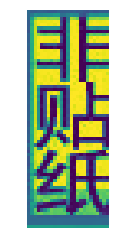

T1cTheXxBfXXXXXXXX_!!0-item_pic.jpg
白
(73.78, 85.82, 80.63, 96.76)


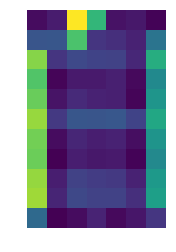

T1cTheXxBfXXXXXXXX_!!0-item_pic.jpg
/
(109.46, 84.82, 116.04, 96.76)


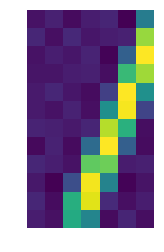

T1cTheXxBfXXXXXXXX_!!0-item_pic.jpg
著
(120.54, 84.82, 130.87, 98.97)


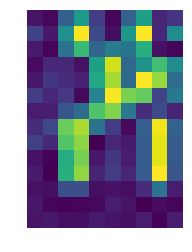

T1cTheXxBfXXXXXXXX_!!0-item_pic.jpg
日
(223.99, 159.24, 280.04, 222.59)


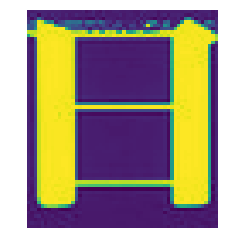

T1eghSFaFaXXXXXXXX_!!2-item_pic.png
1
(255.19, 126.43, 260.33, 136.34)


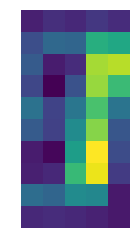

T1EhF.XltjXXapWb.Y_025603.jpg
KANGFU
(55.23, 475.83, 81.81, 504.71)


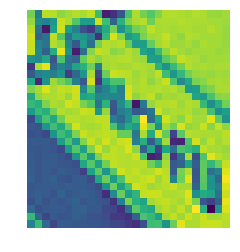

T1EhF.XltjXXapWb.Y_025603.jpg
FU
(146.15, 354.29, 150.1, 362.92)


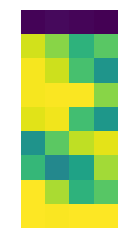

T1EI2VFnhlXXXXXXXX_!!0-item_pic.jpg
卡
(101.04, 74.5, 119.16, 94.36)


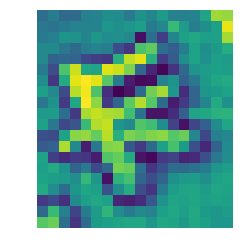

T1EJCVXrljXXXXXXXX_!!0-item_pic.jpg
牛
(63.47, 115.08, 141.0, 195.28)


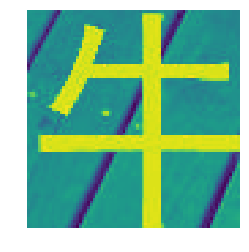

T1EkZCFbXeXXXXXXXX_!!0-item_pic.jpg
爆
(215.06, 341.76, 252.33, 383.71)


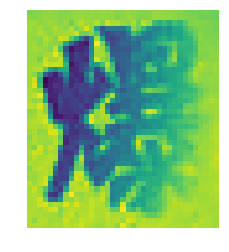

T1F55jFm4bXXXXXXXX_!!0-item_pic.jpg
J
(402.6, 341.4, 416.0, 370.8)


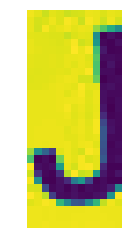

T1F55jFm4bXXXXXXXX_!!0-item_pic.jpg
D
(80.0, 66.6, 104.0, 94.2)


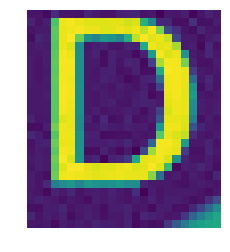

T1F55jFm4bXXXXXXXX_!!0-item_pic.jpg
X
(34.6, 65.4, 61.0, 92.4)


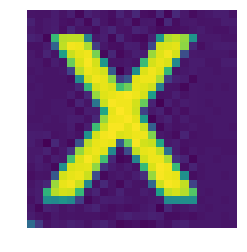

T1F6LhFsRaXXXXXXXX_!!0-item_pic.jpg
*
(3.81, 82.13, 9.82, 88.14)


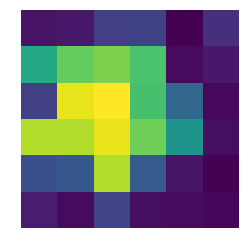

T1FBv_FUXaXXXXXXXX_!!0-item_pic.jpg
V
(176.91, 487.25, 188.1, 500.61)


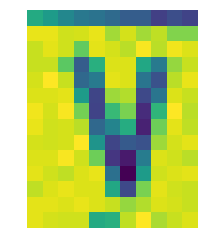

T1FBv_FUXaXXXXXXXX_!!0-item_pic.jpg
V
(179.91, 376.07, 183.91, 388.43)


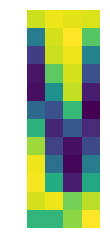

T1FgRzFi8bXXXXXXXX_!!0-item_pic.jpg
?
(920.35, 481.3, 937.35, 499.9)


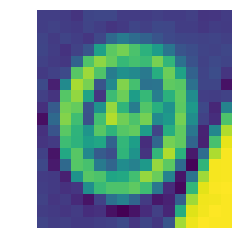

T1FKYQFj4cXXXXXXXX_!!0-item_pic.jpg
AquariumHeater
(83.67, 156.65, 99.24, 351.57)


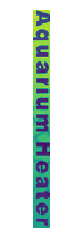

T1FKYQFj4cXXXXXXXX_!!0-item_pic.jpg
P
(237.9, 303.98, 247.91, 315.6)


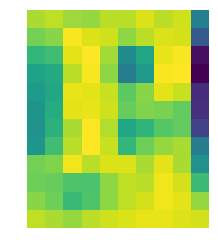

T1FKYQFj4cXXXXXXXX_!!0-item_pic.jpg
短
(227.86, 340.9, 259.56, 386.5)


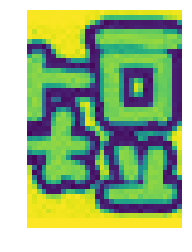

T1FKYQFj4cXXXXXXXX_!!0-item_pic.jpg
厘
(308.54, 343.03, 337.56, 387.8)


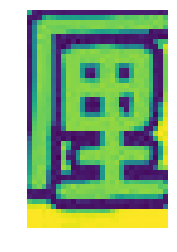

T1FKYQFj4cXXXXXXXX_!!0-item_pic.jpg
米
(350.47, 340.38, 382.19, 388.58)


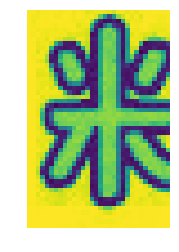

T1FKYQFj4cXXXXXXXX_!!0-item_pic.jpg
1
(152.32, 348.27, 155.57, 352.61)


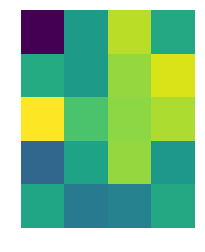

T1FUKIXrhbXXXXXXXX_!!0-item_pic.jpg
秒
(700.4, 236.58, 775.73, 323.25)


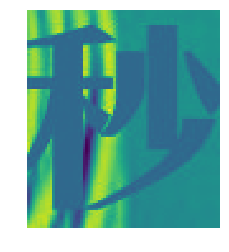

T1FUKIXrhbXXXXXXXX_!!0-item_pic.jpg
杀
(699.06, 408.91, 782.73, 494.91)


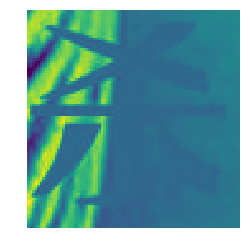

T1FUKIXrhbXXXXXXXX_!!0-item_pic.jpg
品
(11.4, 387.91, 76.06, 466.58)


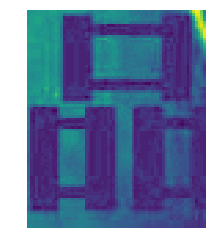

T1FusXFHdcXXXXXXXX_!!0-item_pic.jpg
同步
(94.0, 88.91, 111.91, 110.64)


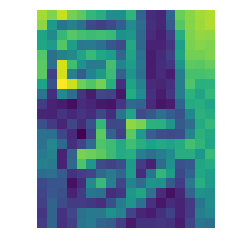

T1FusXFHdcXXXXXXXX_!!0-item_pic.jpg
对症按摩
(5.64, 149.55, 27.73, 270.0)


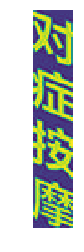

T1FusXFHdcXXXXXXXX_!!0-item_pic.jpg
速查图典
(8.91, 278.27, 28.45, 373.64)


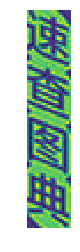

T1FusXFHdcXXXXXXXX_!!0-item_pic.jpg
刘红
(13.18, 386.82, 21.64, 417.09)


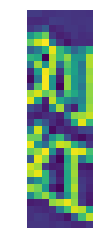

T1FusXFHdcXXXXXXXX_!!0-item_pic.jpg
主编
(8.64, 423.82, 23.64, 452.0)


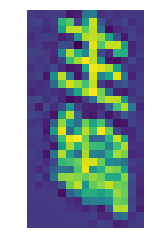

T1FusXFHdcXXXXXXXX_!!0-item_pic.jpg
吉林科学技术出版社
(12.82, 528.36, 22.73, 633.64)


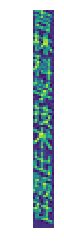

T1FWhlFo8gXXXXXXXX_!!0-item_pic.jpg
L
(692.89, 442.91, 714.62, 468.6)


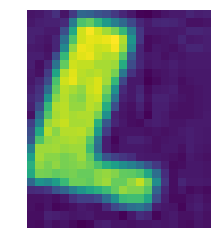

T1FWhlFo8gXXXXXXXX_!!0-item_pic.jpg
L
(709.22, 387.24, 731.94, 414.35)


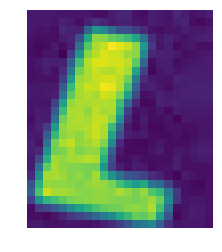

T1FWhlFo8gXXXXXXXX_!!0-item_pic.jpg
L
(717.45, 357.84, 744.3, 386.24)


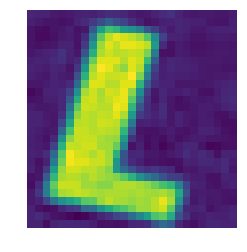

T1FWhlFo8gXXXXXXXX_!!0-item_pic.jpg
L
(728.11, 327.31, 752.25, 356.13)


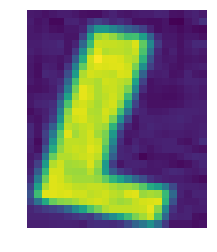

T1G5SLXgFoXXcK5RZ8_101520.jpg
CREE
(220.76, 153.82, 234.71, 169.84)


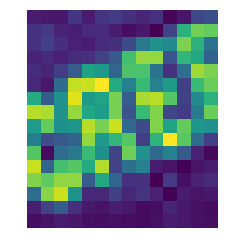

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
YON
(327.11, 315.74, 344.32, 333.66)


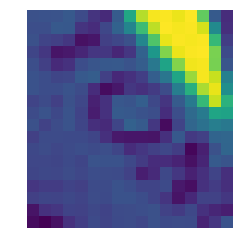

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
8
(528.12, 564.25, 539.79, 591.55)


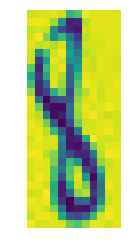

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
8
(555.57, 558.13, 565.81, 584.73)


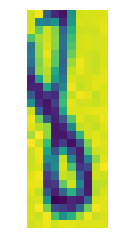

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
5
(570.79, 561.54, 580.17, 592.83)


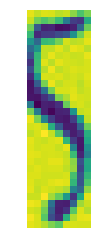

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
11
(582.01, 559.27, 597.95, 576.62)


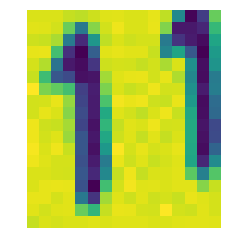

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
8
(601.65, 544.19, 611.47, 570.5)


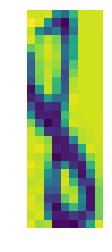

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
5
(543.48, 570.5, 553.87, 599.94)


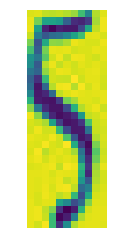

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
1
(477.39, 590.8, 484.37, 607.51)


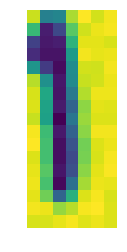

T1gw9CFc8gXXXXXXXX_!!0-item_pic.jpg
囊下
(185.65, 343.11, 214.25, 380.02)


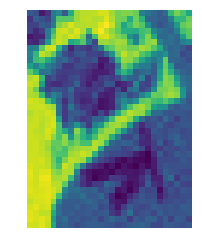

T1gyCwFPRbXXXXXXXX_!!0-item_pic.jpg
进店
(42.78, 420.8, 116.38, 530.6)


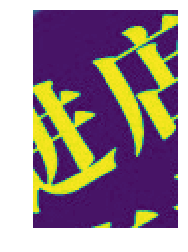

T1gyCwFPRbXXXXXXXX_!!0-item_pic.jpg
有礼
(83.78, 492.2, 137.78, 588.8)


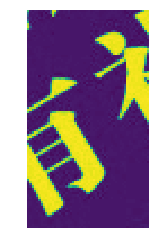

T1gyCwFPRbXXXXXXXX_!!0-item_pic.jpg
非贴纸
(570.78, 481.2, 594.98, 543.8)


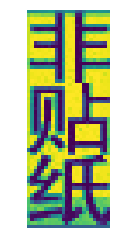

T1H2RCFFJaXXXXXXXX_!!0-item_pic.jpg
沃尔品牌
(43.01, 130.51, 113.51, 505.68)


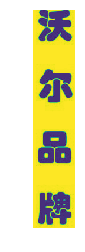

T1H2RCFFJaXXXXXXXX_!!0-item_pic.jpg
质量信赖
(574.35, 118.34, 639.01, 489.34)


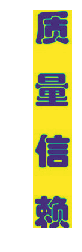

T1I01uFk8aXXXXXXXX_!!0-item_pic.jpg
?
(354.35, 59.4, 361.25, 67.9)


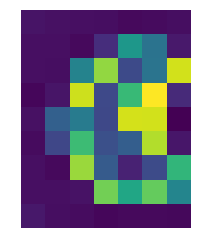

T1I01uFk8aXXXXXXXX_!!0-item_pic.jpg
￥
(397.25, 67.2, 413.25, 91.0)


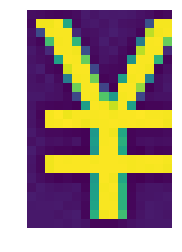

T1I01uFk8aXXXXXXXX_!!0-item_pic.jpg
赠
(274.75, 452.0, 303.35, 482.7)


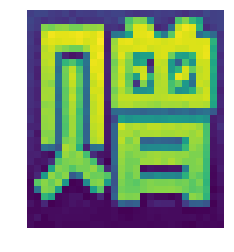

T1i8X0XyRgXXXXXXXX_!!0-item_pic.jpg
封
(55.52, 10.38, 77.56, 33.5)


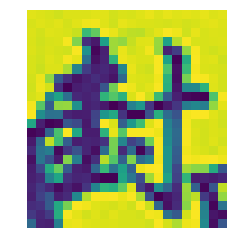

T1i8X0XyRgXXXXXXXX_!!0-item_pic.jpg
氏
(75.52, 22.46, 82.98, 44.46)


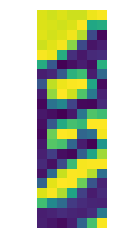

T1i8X0XyRgXXXXXXXX_!!0-item_pic.jpg
附赠
(53.65, 172.54, 82.98, 236.17)


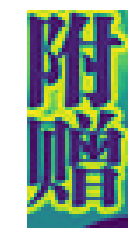

T1i8X0XyRgXXXXXXXX_!!0-item_pic.jpg
腰
(135.06, 75.5, 224.85, 172.33)


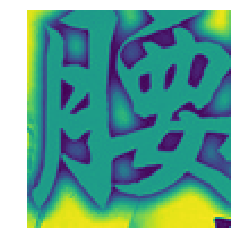

T1i8X0XyRgXXXXXXXX_!!0-item_pic.jpg
腰
(214.73, 22.54, 315.77, 157.04)


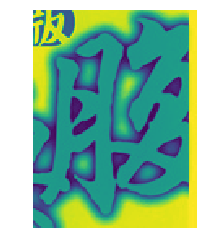

T1ivdPFsdoXXXXXXXX_!!0-item_pic.jpg
，
(372.7, 68.02, 385.4, 83.25)


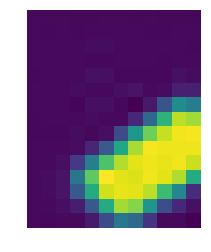

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
R
(372.42, 662.83, 387.25, 678.17)


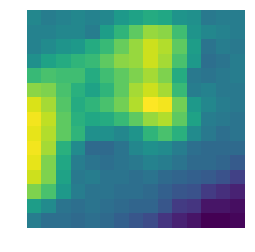

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
GL
(722.08, 461.67, 747.92, 488.67)


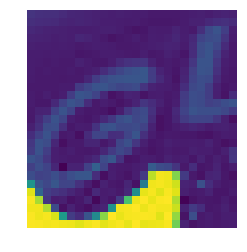

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
2
(314.25, 329.17, 329.58, 345.0)


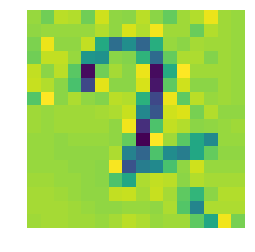

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
3
(363.25, 305.0, 375.08, 320.83)


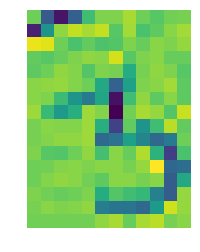

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
4
(413.08, 286.0, 424.42, 304.17)


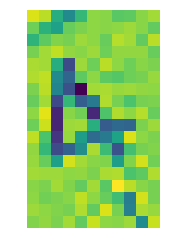

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
6
(501.92, 247.5, 517.25, 264.17)


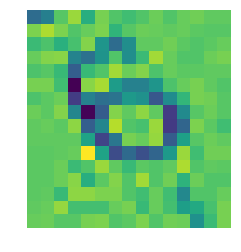

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
9
(637.25, 192.67, 649.42, 205.17)


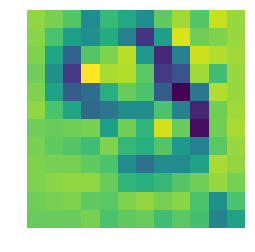

T1ixibFDBfXXXXXXXX_!!0-item_pic.jpg
1
(349.42, 354.17, 362.75, 371.0)


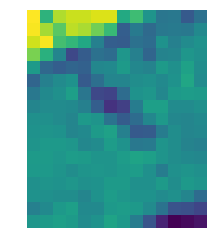

T1jclsFSRcXXXXXXXX_!!0-item_pic.jpg
?
(254.25, 650.58, 289.92, 688.91)


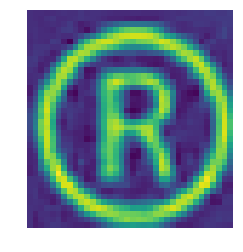

T1jclsFSRcXXXXXXXX_!!0-item_pic.jpg
正品保证
(27.92, 17.25, 199.25, 195.91)


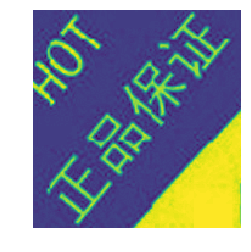

T1jclsFSRcXXXXXXXX_!!0-item_pic.jpg
HOT
(7.92, 16.58, 90.58, 102.58)


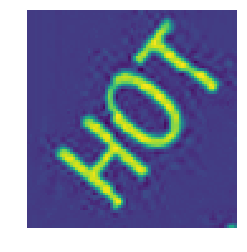

T1jhGZFtBXXXXXXXXX_!!0-item_pic.jpg
70
(301.53, 569.41, 327.2, 602.41)


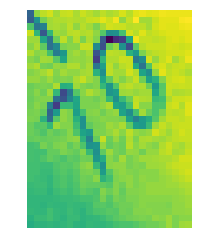

T1jhGZFtBXXXXXXXXX_!!0-item_pic.jpg
0
(335.2, 667.75, 349.86, 684.75)


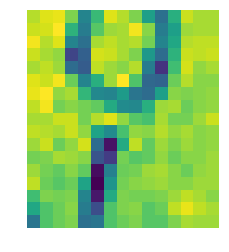

T1jhGZFtBXXXXXXXXX_!!0-item_pic.jpg
90
(300.53, 639.08, 324.86, 664.75)


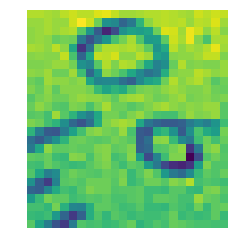

T1jhGZFtBXXXXXXXXX_!!0-item_pic.jpg
40
(229.2, 351.2, 246.2, 375.87)


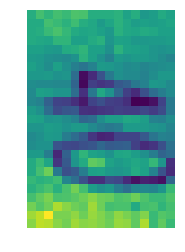

T1jhGZFtBXXXXXXXXX_!!0-item_pic.jpg
80
(163.53, 309.87, 177.86, 335.53)


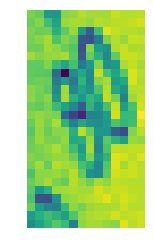

T1jk1bXilrXXbXufw3_050009.jpg
久品书斋专用图片
(28.79, 166.66, 452.28, 623.52)


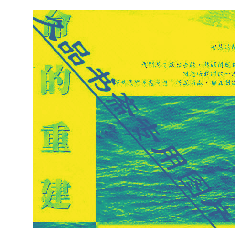

T1jk1bXilrXXbXufw3_050009.jpg
命
(46.64, 159.23, 108.08, 224.56)


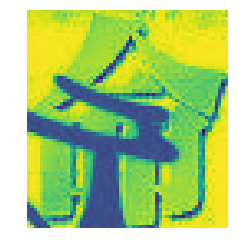

T1JrX6FvFjXXXXXXXX_!!0-item_pic.jpg
?
(125.72, 32.53, 135.87, 45.68)


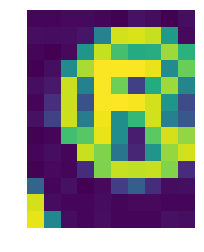

T1JrX6FvFjXXXXXXXX_!!0-item_pic.jpg
囊下
(658.96, 477.92, 681.71, 505.25)


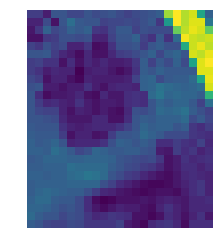

T1JrX6FvFjXXXXXXXX_!!0-item_pic.jpg
专
(620.46, 565.83, 631.46, 576.83)


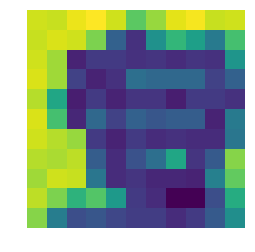

T1k2h1FihgXXXXXXXX_!!0-item_pic.jpg
明月松间
(464.56, 51.02, 572.06, 554.35)


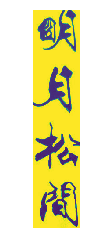

T1k2h1FihgXXXXXXXX_!!0-item_pic.jpg
照清泉石
(324.39, 47.85, 433.06, 561.02)


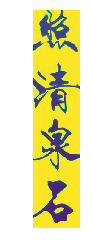

T1k2h1FihgXXXXXXXX_!!0-item_pic.jpg
上流
(178.89, 51.69, 294.73, 291.02)


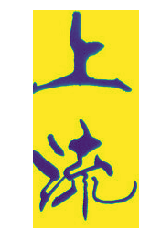

T1k2h1FihgXXXXXXXX_!!0-item_pic.jpg
王维句洪光書
(100.39, 108.52, 147.23, 381.35)


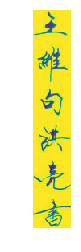

T1k2h1FihgXXXXXXXX_!!0-item_pic.jpg
心心向佛
(-1.44, 1.85, 175.06, 182.02)


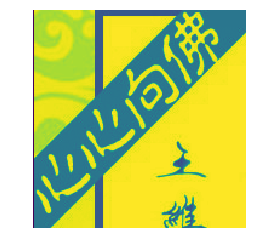

T1LbEfFXlbXXXXXXXX_!!0-item_pic.jpg
金雕标牌
(17.36, 91.03, 42.69, 213.7)


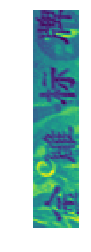

T1lJdPFadhXXXXXXXX_!!0-item_pic.jpg
45mm
(278.13, 251.0, 306.63, 315.5)


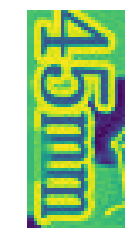

T1lJdPFadhXXXXXXXX_!!0-item_pic.jpg
65mm
(97.38, 226.25, 141.38, 289.5)


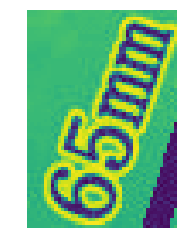

T1lK00FtJeXXXXXXXX_!!0-item_pic.jpg
前
(145.88, 4.25, 167.88, 26.5)


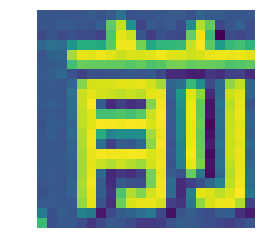

T1lK00FtJeXXXXXXXX_!!0-item_pic.jpg
！
(271.54, 287.42, 282.63, 303.75)


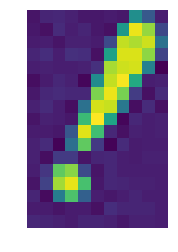

T1m819XeFwXXXXXXXX_!!0-item_pic.jpg
防盗门锁芯
(12.13, 194.36, 34.19, 350.62)


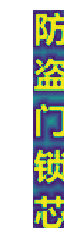

T1m819XeFwXXXXXXXX_!!0-item_pic.jpg
防盗门锁体
(61.97, 229.34, 86.57, 383.5)


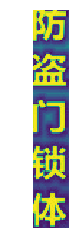

T1m819XeFwXXXXXXXX_!!0-item_pic.jpg
防盗门把手
(109.8, 256.95, 132.77, 413.57)


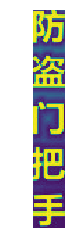

T1m819XeFwXXXXXXXX_!!0-item_pic.jpg
：
(201.19, 433.39, 204.74, 450.33)


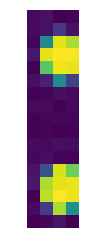

T1MsFiFntcXXXXXXXX_!!0-item_pic.jpg
K
(363.33, 284.98, 375.94, 301.02)


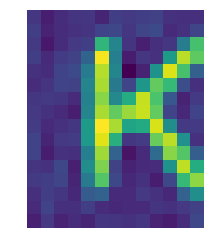

T1MsFiFntcXXXXXXXX_!!0-item_pic.jpg
A
(274.98, 306.97, 299.97, 341.8)


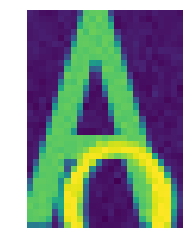

T1mt7zFXXcXXXXXXXX_!!2-item_pic.png
9
(20.99, 269.73, 47.69, 305.35)


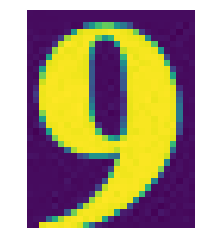

T1mtjCXiNjXXcYe.IS_010410.jpg
三相异步电动机
(505.95, 439.69, 514.98, 484.75)


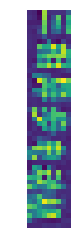

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
H
(565.62, 254.15, 575.31, 265.62)


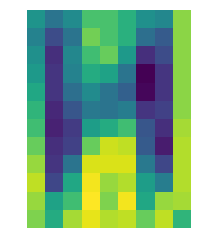

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
F
(597.85, 253.54, 606.46, 266.85)


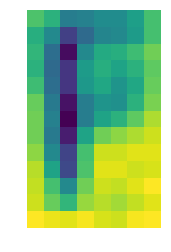

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
R
(630.08, 251.69, 641.92, 264.38)


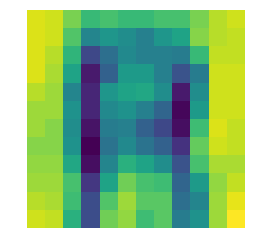

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
T
(631.31, 291.69, 642.54, 306.23)


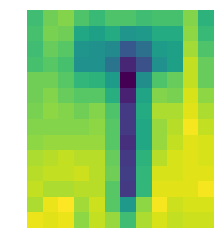

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
N
(595.38, 172.31, 606.23, 185.0)


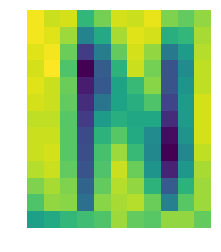

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
G
(627.62, 172.31, 637.23, 185.0)


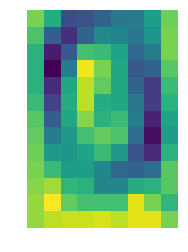

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
X
(564.23, 213.54, 574.23, 225.85)


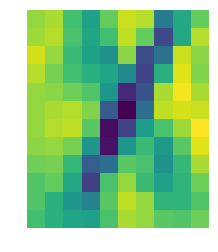

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
Y
(596.85, 211.69, 607.46, 224.0)


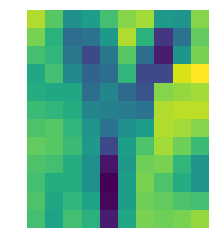

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
Z
(628.85, 210.46, 638.46, 223.77)


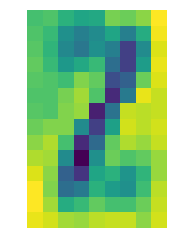

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
B
(568.08, 328.23, 579.54, 343.15)


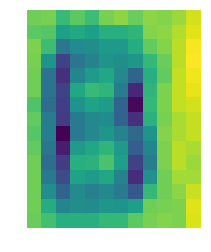

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
1
(566.46, 237.92, 574.23, 250.85)


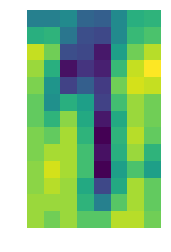

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
2
(595.62, 239.38, 605.85, 251.46)


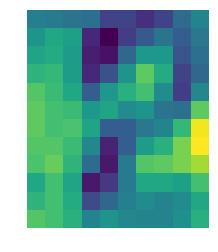

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
3
(629.46, 235.69, 641.31, 251.46)


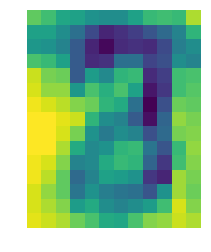

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
6
(626.38, 195.69, 638.85, 210.0)


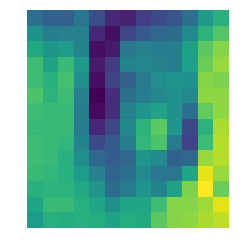

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
5
(598.85, 195.69, 608.69, 209.23)


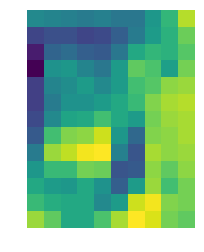

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
4
(563.62, 199.38, 574.46, 212.08)


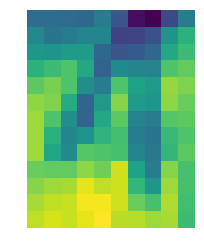

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
7
(563.0, 158.54, 572.85, 170.85)


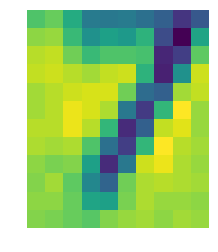

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
8
(596.62, 157.54, 605.62, 170.23)


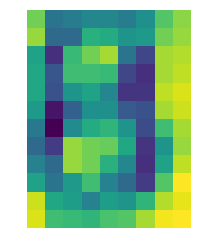

T1nGhjFjNfXXXXXXXX_!!0-item_pic.jpg
9
(628.0, 153.85, 638.23, 169.62)


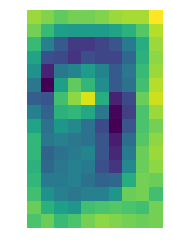

T1nnZ9Fs4dXXXXXXXX_!!0-item_pic.jpg
注意
(113.46, 239.83, 149.75, 360.56)


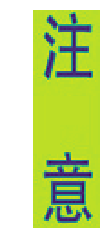

T1nnZ9Fs4dXXXXXXXX_!!0-item_pic.jpg
！
(129.76, 179.52, 137.67, 198.99)


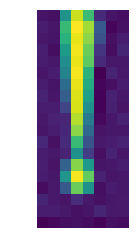

T1OtUmFjxbXXXXXXXX_!!0-item_pic.jpg
菜
(172.43, 259.47, 277.9, 389.6)


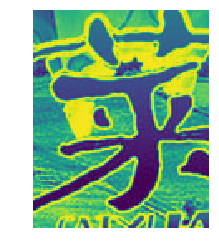

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
FOR
(415.48, 238.92, 433.12, 259.64)


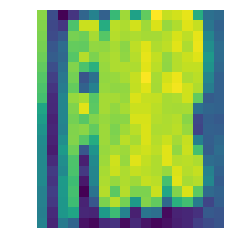

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
OF
(541.28, 234.2, 561.72, 257.64)


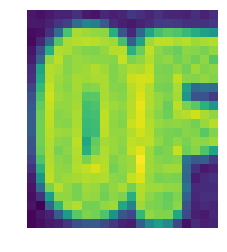

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
PA
(570.88, 237.56, 590.92, 259.68)


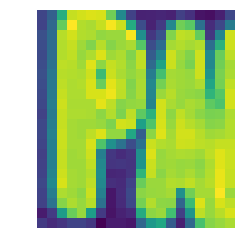

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
增
(534.52, 174.4, 573.56, 215.56)


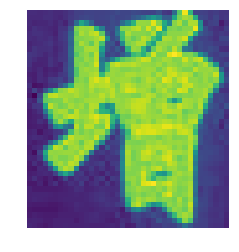

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
色
(577.64, 177.76, 596.76, 219.24)


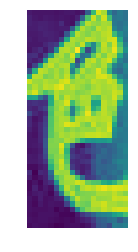

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
100
(410.77, 143.37, 472.66, 223.68)


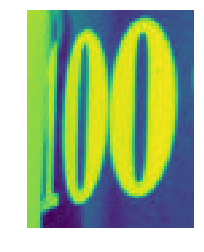

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
%
(472.11, 144.94, 524.06, 214.97)


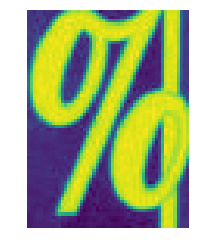

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
这个很不错
(341.46, 345.15, 371.63, 531.78)


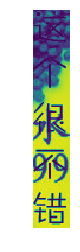

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
错
(593.42, 533.61, 674.18, 616.92)


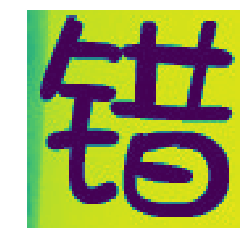

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
很
(592.84, 306.53, 670.2, 387.8)


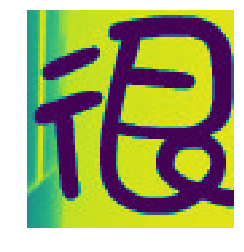

T1P6aiXtxbXXXXXXXX_!!0-item_pic.jpg
这
(595.91, 78.63, 670.67, 159.99)


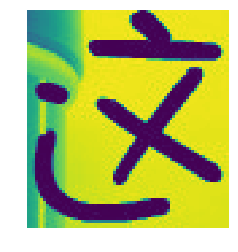

T1PeffFb4bXXXXXXXX_!!0-item_pic.jpg
长
(571.75, 526.91, 617.46, 586.34)


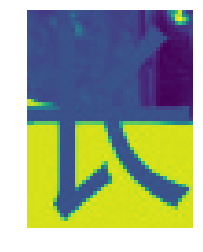

T1pNX6FqpXXXXXXXXX_!!0-item_pic.jpg
规格齐全
(466.68, 155.53, 622.02, 341.2)


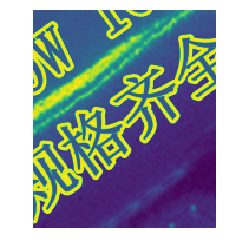

T1pNX6FqpXXXXXXXXX_!!0-item_pic.jpg
30W
(322.35, 234.53, 409.68, 323.2)


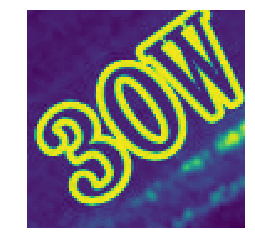

T1pNX6FqpXXXXXXXXX_!!0-item_pic.jpg
25W
(224.35, 296.87, 316.35, 392.87)


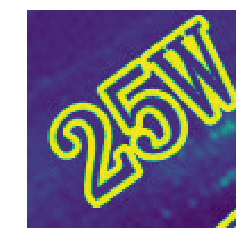

T1pNX6FqpXXXXXXXXX_!!0-item_pic.jpg
20W
(135.02, 359.87, 224.68, 460.2)


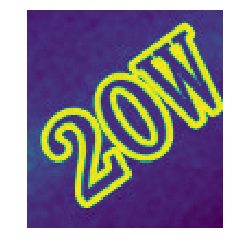

T1pPCUFjBhXXXXXXXX_!!0-item_pic.jpg
+
(93.7, 191.61, 101.02, 201.04)


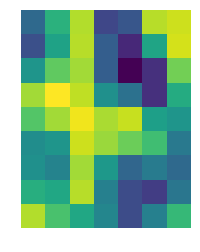

T1qVgPFG8eXXXXXXXX_!!0-item_pic.jpg
下单还有礼品
(7.8, 109.0, 101.0, 589.0)


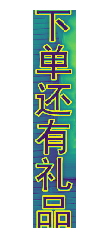

T1qVgPFG8eXXXXXXXX_!!0-item_pic.jpg
赠送
(100.0, 223.2, 193.2, 396.2)


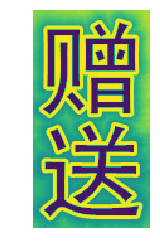

T1qVgPFG8eXXXXXXXX_!!0-item_pic.jpg
特厚
(661.6, 61.2, 776.6, 297.0)


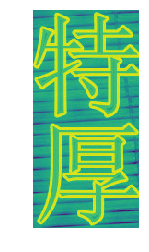

T1r3x5FhxhXXXXXXXX_!!0-item_pic.jpg
D
(467.47, 252.9, 491.43, 299.5)


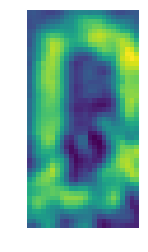

T1S73AXeNXXXXXXXXX_!!0-item_pic.jpg
最
(368.76, 376.39, 392.67, 403.45)


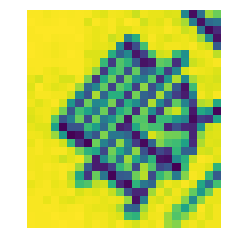

T1S73AXeNXXXXXXXXX_!!0-item_pic.jpg
畅销
(387.22, 347.94, 426.49, 388.21)


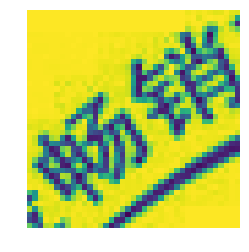

T1Sk6FXbFpXXahQrHb_092928.jpg
裝飾
(56.81, 8.61, 71.77, 45.09)


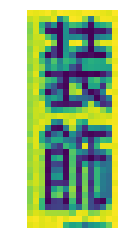

T1TK7PFgRfXXXXXXXX_!!2-item_pic.png
?
(254.86, 221.44, 262.19, 233.12)


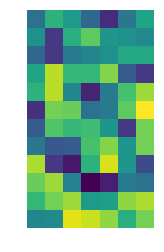

T1TQcSXkdcXXXXXXXX_!!0-item_pic.jpg
的
(169.36, 100.89, 186.69, 119.44)


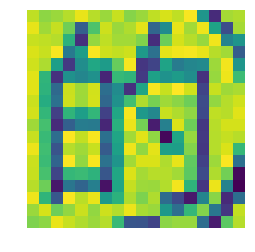

T1T_OcXsxXXXXXXXXX_!!0-item_pic.jpg
十倍光泽
(79.3, 334.9, 183.02, 769.24)


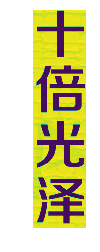

T1T_OcXsxXXXXXXXXX_!!0-item_pic.jpg
瞬间光亮
(200.88, 331.04, 290.47, 762.95)


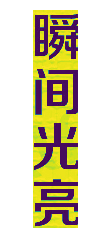

T1T_OcXsxXXXXXXXXX_!!0-item_pic.jpg
?
(901.26, 984.27, 917.11, 1003.27)


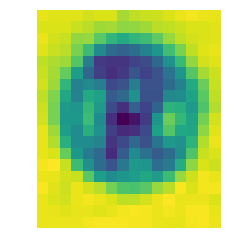

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
0
(31.07, 6.5, 39.2, 17.25)


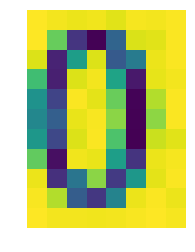

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
1
(84.79, 6.96, 92.3, 17.8)


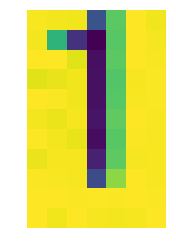

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
2
(134.73, 5.96, 146.48, 17.8)


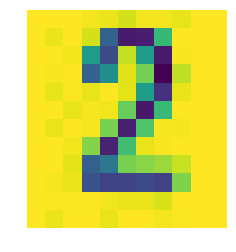

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
4
(243.46, 6.96, 251.13, 17.25)


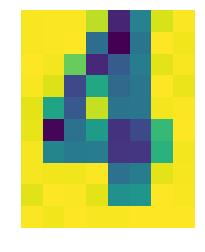

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
5
(295.1, 6.42, 304.23, 18.34)


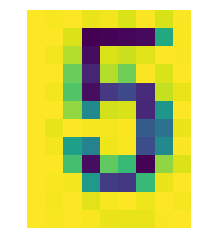

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
6
(348.74, 5.42, 359.41, 16.25)


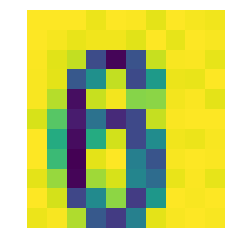

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
7
(402.84, 5.42, 410.43, 16.25)


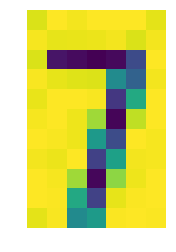

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
8
(456.4, 6.96, 462.53, 18.34)


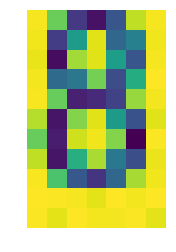

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
9
(508.04, 5.96, 516.62, 18.34)


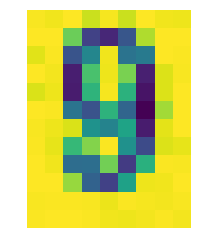

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
7
(5.69, 407.99, 14.27, 418.2)


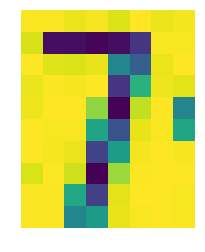

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
6
(4.15, 355.97, 13.82, 365.73)


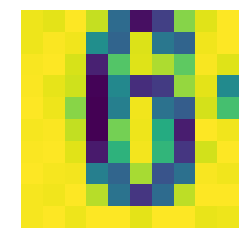

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
5
(5.23, 301.79, 10.65, 313.63)


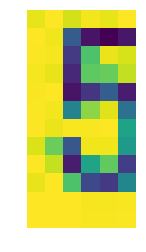

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
3
(5.15, 196.68, 14.27, 207.97)


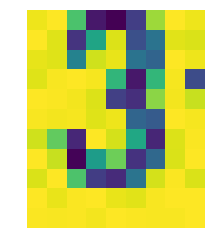

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
2
(5.69, 143.04, 14.82, 153.33)


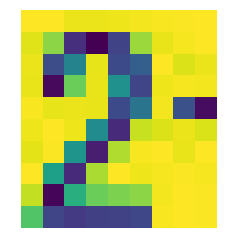

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
1
(7.23, 90.48, 12.73, 101.24)


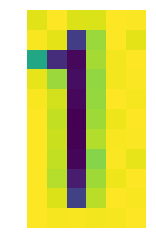

T1U7NdXCpfXXXXXXXX_!!0-item_pic.jpg
0
(6.15, 36.3, 12.82, 47.6)


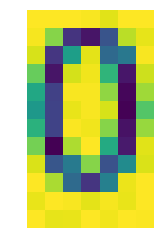

T1UuEHXXhdXXXXXXXX_!!0-item_pic.jpg
四线调速
(251.62, 98.58, 290.1, 244.32)


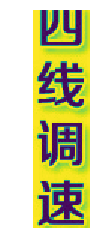

T1VvIKFa0eXXXXXXXX_!!0-item_pic.jpg
京
(220.58, 371.5, 229.42, 387.0)


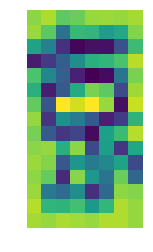

T1VvIKFa0eXXXXXXXX_!!0-item_pic.jpg
剧
(233.58, 374.17, 246.42, 388.67)


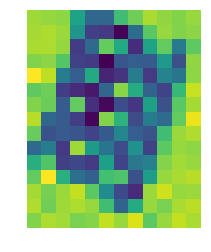

T1VvIKFa0eXXXXXXXX_!!0-item_pic.jpg
谱
(235.58, 392.5, 245.58, 405.83)


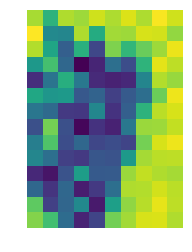

T1VvIKFa0eXXXXXXXX_!!0-item_pic.jpg
脸
(223.92, 393.5, 232.08, 406.83)


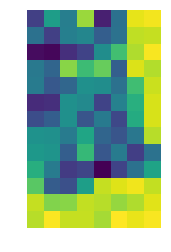

T1x3JMXxthXXXXXXXX_!!0-item_pic.jpg
鹏音正版
(52.18, 104.92, 307.78, 377.82)


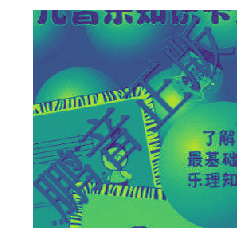

T1X3N_XtBaXXXXXXXX_!!0-item_pic.jpg
自
(293.98, 137.5, 330.18, 203.7)


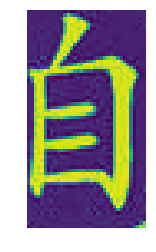

T1X3N_XtBaXXXXXXXX_!!0-item_pic.jpg
通
(375.78, 137.5, 434.78, 202.7)


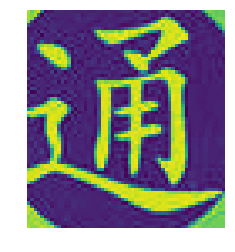

T1x5ZMFJ4dXXbgzd2a_120600.jpg
?
(172.65, 252.62, 189.36, 273.62)


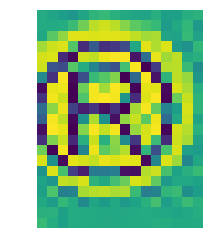

T1x5ZMFJ4dXXbgzd2a_120600.jpg
逍
(203.08, 308.62, 296.79, 402.91)


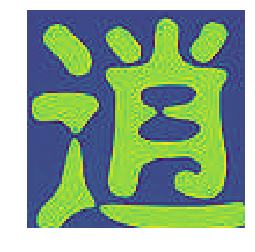

T1x5ZMFJ4dXXbgzd2a_120600.jpg
3
(353.22, 470.91, 379.08, 515.34)


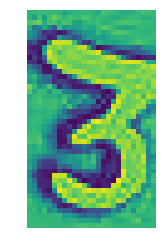

T1x5ZMFJ4dXXbgzd2a_120600.jpg
丸
(381.65, 484.34, 407.79, 513.19)


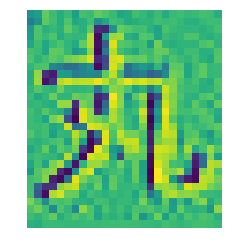

T1XJOAXBhcXXXXXXXX_!!0-item_pic.jpg
06
(177.57, 121.89, 198.0, 143.66)


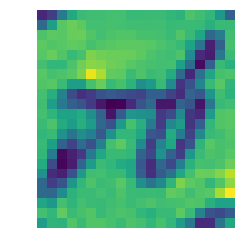

T1XKudFmVXXXXXXXXX_!!0-item_pic.jpg
5
(417.01, 404.12, 423.28, 410.39)


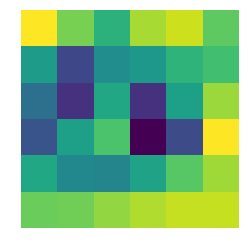

T1XMLAFyBcXXXXXXXX_!!0-item_pic.jpg
岁
(666.75, 91.87, 689.65, 116.77)


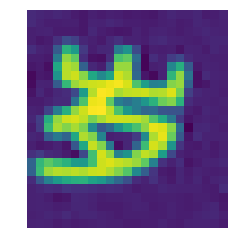

T1xoJQXwlbXXXXXXXX_!!0-item_pic.jpg
晨
(196.6, 120.42, 207.29, 134.11)


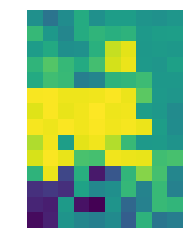

T1xoJQXwlbXXXXXXXX_!!0-item_pic.jpg
?
(234.05, 66.69, 242.71, 76.35)


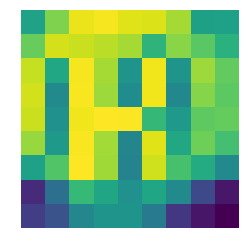

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
辉
(629.75, 341.5, 694.75, 448.5)


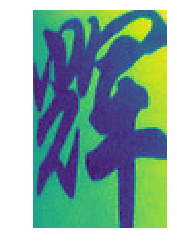

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
?
(190.25, 324.5, 209.25, 354.5)


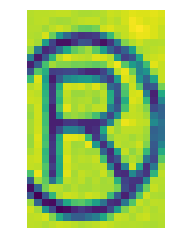

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
B
(886.75, 930.5, 916.75, 969.0)


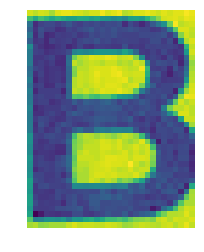

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
温
(832.75, 457.0, 939.75, 594.0)


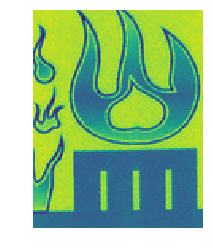

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
温
(222.75, 439.0, 361.25, 581.0)


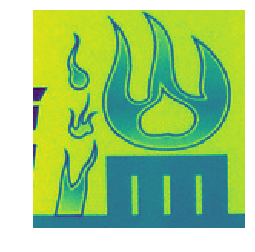

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
牌
(700.25, 378.0, 769.25, 456.5)


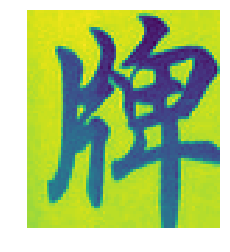

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
牌
(132.75, 356.5, 195.75, 437.0)


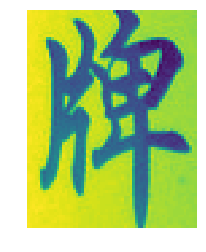

T1xPeiXu0XXXXXXXXX_!!0-item_pic.jpg
辉
(79.75, 317.0, 131.75, 426.5)


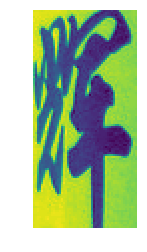

T1xrXpFRFXXXbuiRcY_030336.jpg
适
(326.08, 645.92, 341.85, 665.0)


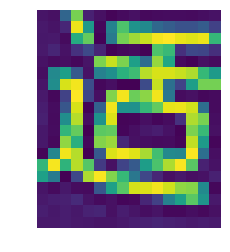

T1xrXpFRFXXXbuiRcY_030336.jpg
于
(375.92, 640.62, 391.31, 659.85)


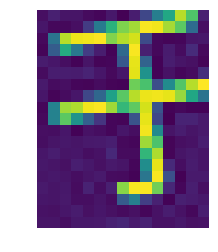

T1xrXpFRFXXXbuiRcY_030336.jpg
产
(426.38, 634.69, 444.38, 655.15)


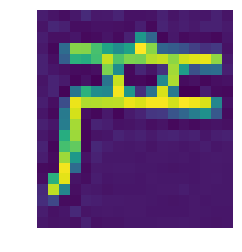

T1xrXpFRFXXXbuiRcY_030336.jpg
妇
(449.38, 637.15, 465.77, 658.23)


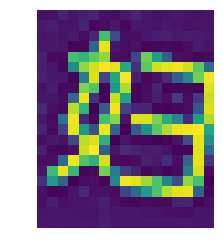

T1Xu.ZXf0eXXXXXXXX_!!0-item_pic.jpg
M
(71.18, 196.76, 79.51, 207.09)


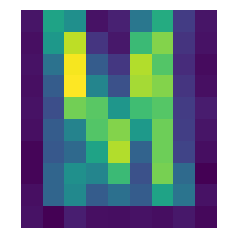

T1XxmFFvJcXXbfgvI8_100416.jpg
?
(158.53, 227.8, 177.87, 248.8)


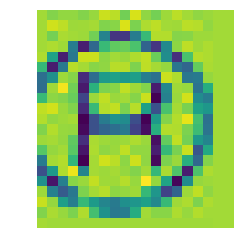

T1XxmFFvJcXXbfgvI8_100416.jpg
咳清胶囊
(627.2, 277.47, 705.53, 577.47)


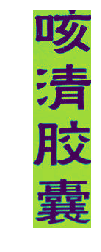

T1XxmFFvJcXXbfgvI8_100416.jpg
KEQING
(713.2, 304.8, 739.53, 400.47)


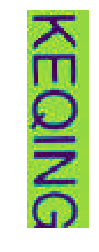

T1XxmFFvJcXXbfgvI8_100416.jpg
JIAONANG
(715.2, 405.8, 732.2, 538.47)


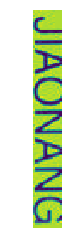

T1xZXNFiRcXXXXXXXX_!!0-item_pic.jpg
东
(5.0, 278.4, 24.54, 302.1)


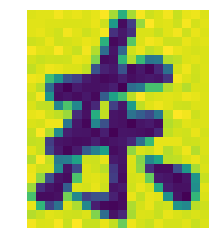

T1xZXNFiRcXXXXXXXX_!!0-item_pic.jpg
芝
(29.8, 276.88, 52.54, 302.61)


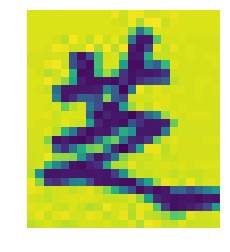

T1xZXNFiRcXXXXXXXX_!!0-item_pic.jpg
正品保证
(13.65, 9.15, 90.64, 89.23)


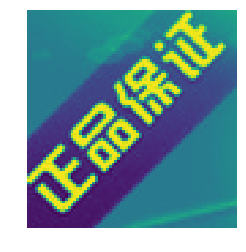

T1YlxpFfBcXXXXXXXX_!!0-item_pic.jpg
4
(196.53, 435.61, 241.06, 492.02)


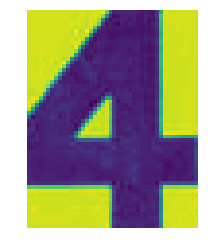

T1YlxpFfBcXXXXXXXX_!!0-item_pic.jpg
（黑）
(406.4, 434.6, 443.96, 481.19)


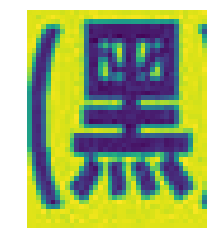

T1YmPLFkNdXXXXXXXX_!!0-item_pic.jpg
汪汪：
(471.82, 267.8, 489.0, 307.62)


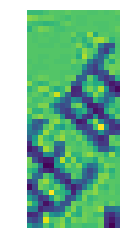

T1YmPLFkNdXXXXXXXX_!!0-item_pic.jpg
汪汪木甜水
(14.13, 7.84, 123.0, 118.73)


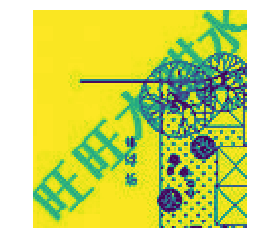

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
?
(242.72, 227.8, 254.5, 241.52)


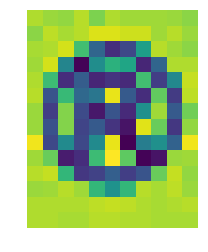

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
q
(166.25, 234.83, 192.75, 276.2)


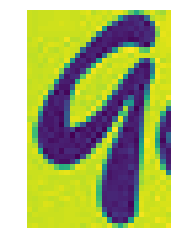

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
p
(213.06, 235.36, 241.5, 277.27)


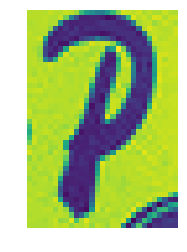

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
oo
(384.22, 446.04, 390.84, 459.16)


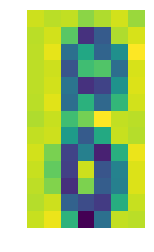

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
p
(382.94, 432.91, 390.31, 444.63)


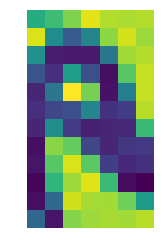

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
q
(381.47, 457.76, 394.25, 471.94)


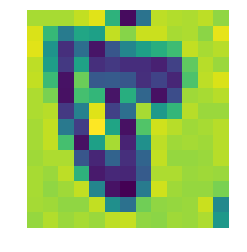

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
?
(198.12, 394.94, 206.22, 403.91)


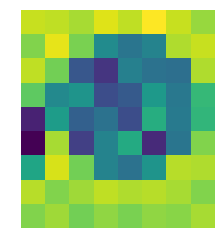

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
?
(578.34, 410.01, 584.72, 416.79)


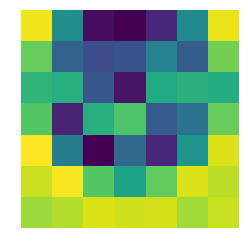

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
q
(539.72, 235.3, 566.16, 279.48)


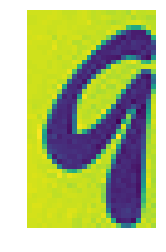

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
p
(591.47, 237.7, 615.44, 281.42)


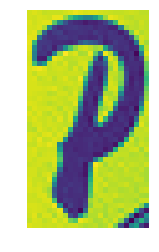

T1ZeKyXDxaXXXXXXXX_!!0-item_pic.jpg
?
(618.59, 233.55, 629.91, 245.2)


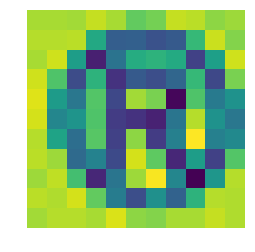

T1zFeGFzpdXXaRJWAZ_031327.jpg
?
(107.79, 173.33, 116.87, 183.56)


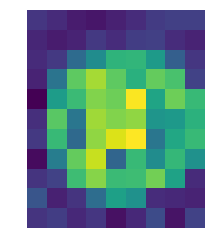

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
缩
(218.34, 279.81, 232.01, 295.14)


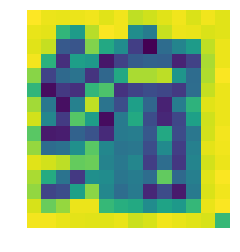

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
版
(259.34, 278.14, 272.84, 295.31)


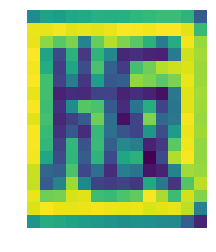

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
第
(219.68, 82.47, 235.84, 101.14)


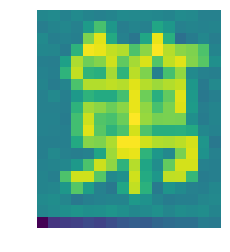

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
2
(236.51, 75.64, 253.68, 100.14)


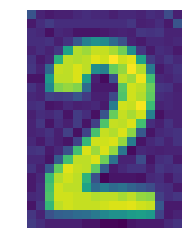

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
版
(258.68, 83.31, 272.84, 102.81)


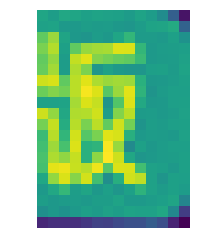

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
缩
(87.51, 415.14, 97.51, 429.14)


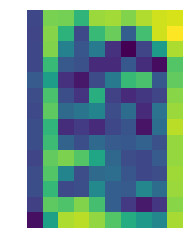

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
印
(101.51, 415.81, 110.01, 431.64)


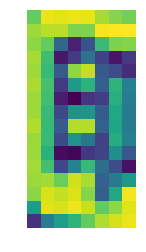

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
版
(115.01, 419.14, 125.18, 435.14)


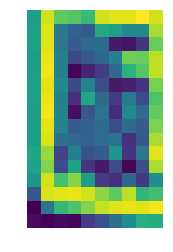

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
英汉汉英大词典
(99.84, 143.14, 124.18, 404.97)


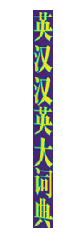

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
第
(90.01, 75.64, 101.84, 96.97)


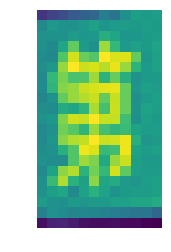

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
2
(102.68, 73.47, 112.51, 94.31)


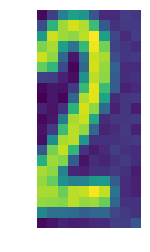

T1ZI_sFa0aXXXXXXXX_!!0-item_pic.jpg
版
(112.68, 75.14, 121.51, 95.14)


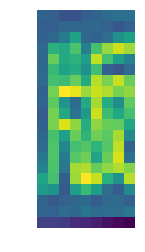

T1ZVl_FqldXXXXXXXX_!!0-item_pic.jpg
盗图必究
(376.25, 278.25, 428.0, 346.0)


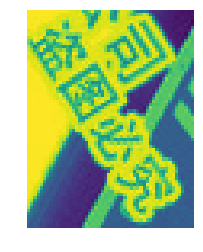

T1ZVl_FqldXXXXXXXX_!!0-item_pic.jpg
联系
(295.5, 155.5, 326.75, 192.25)


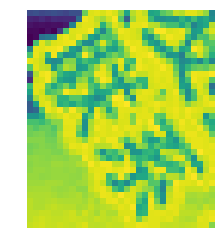

T259jXXy8aXXXXXXXX_!!731015746.jpg
三种规格可供选择
(139.11, 173.0, 172.77, 404.12)


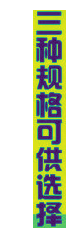

T2EahjXsFXXXXXXXXX_!!106702025.jpg
厂
(451.72, 121.11, 488.5, 157.89)


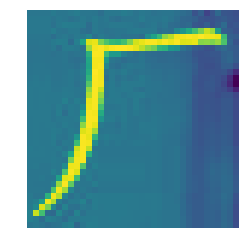

T2gkifXKxaXXXXXXXX_!!378296974.jpg
加厚耐用
(79.15, 59.14, 178.13, 395.14)


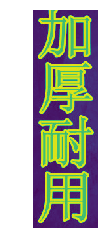

T2gkifXKxaXXXXXXXX_!!378296974.jpg
包
(691.56, 137.75, 761.97, 220.11)


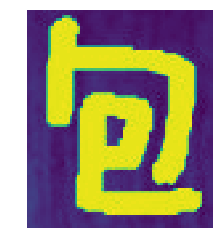

T2KFwQXuFXXXXXXXXX_!!774844952.jpg
811
(327.56, 374.13, 341.21, 400.28)


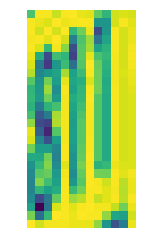

T2kOgtXmxXXXXXXXXX_!!384478842.jpg
4
(201.79, 78.17, 244.03, 130.21)


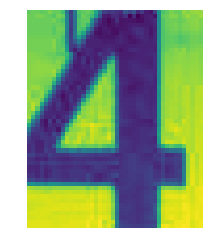

T2kOgtXmxXXXXXXXXX_!!384478842.jpg
9
(70.22, 146.72, 104.91, 202.63)


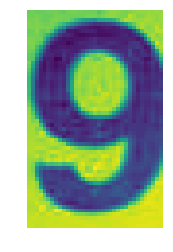

T2kOgtXmxXXXXXXXXX_!!384478842.jpg
1
(308.58, 151.27, 335.62, 199.77)


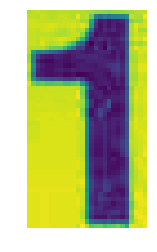

T2kOgtXmxXXXXXXXXX_!!384478842.jpg
2
(411.69, 150.69, 451.95, 204.33)


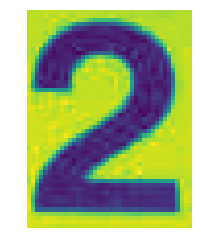

T2kOgtXmxXXXXXXXXX_!!384478842.jpg
3
(524.05, 157.11, 559.31, 205.61)


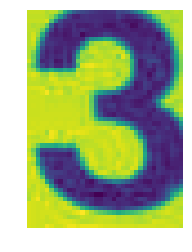

T2kOgtXmxXXXXXXXXX_!!384478842.jpg
5
(487.89, 81.2, 525.09, 138.52)


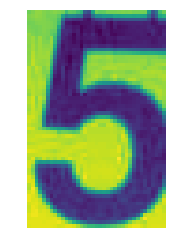

T2lYm3XgBaXXXXXXXX_!!1068688829.jpg
?
(363.56, 227.38, 388.23, 252.17)


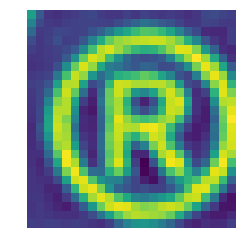

T2o2dVXDdXXXXXXXXX_!!61159080.jpg
型
(272.56, 49.58, 294.76, 73.11)


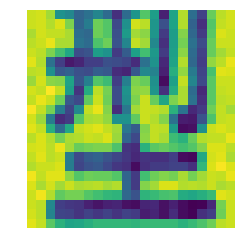

T2oiWPXApaXXXXXXXX-1031430019.jpg
5
(248.54, 387.0, 261.01, 400.61)


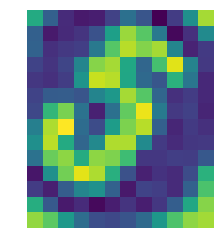

T2oiWPXApaXXXXXXXX-1031430019.jpg
！
(220.45, 361.2, 231.34, 378.25)


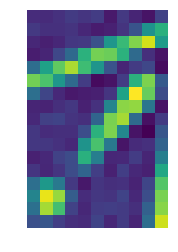

T2q.uCXhpcXXXXXXXX_!!1869960781.jpg
1
(0.74, 248.75, 32.61, 306.33)


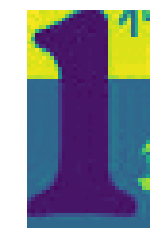

T2q.uCXhpcXXXXXXXX_!!1869960781.jpg
送笔记本电源线
(290.17, 67.47, 307.23, 266.19)


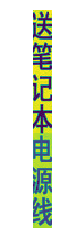

T2q.uCXhpcXXXXXXXX_!!1869960781.jpg
5
(49.12, 9.24, 66.69, 30.41)


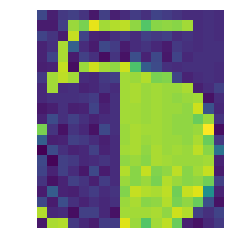

T2schAXwlaXXXXXXXX_!!80765364.jpg
kyOCERa
(53.19, 198.59, 91.7, 346.73)


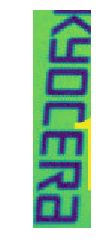

T2schAXwlaXXXXXXXX_!!80765364.jpg
INSPECTED
(27.1, 194.59, 37.55, 301.75)


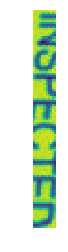

T2sTctXU0XXXXXXXXX_!!572692039.jpg
金
(213.38, 398.75, 252.13, 438.0)


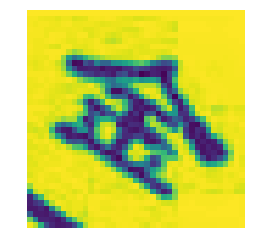

T2sTctXU0XXXXXXXXX_!!572692039.jpg
电
(462.13, 405.75, 498.63, 443.5)


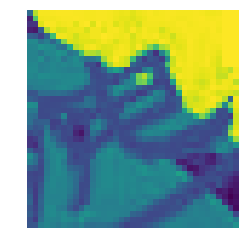

T2sTctXU0XXXXXXXXX_!!572692039.jpg
机
(426.38, 423.75, 448.13, 461.0)


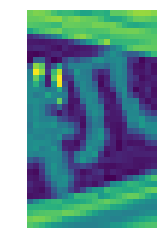

T2uNVzXyRaXXXXXXXX_!!61069038.jpg
4
(368.51, 543.45, 408.84, 590.79)


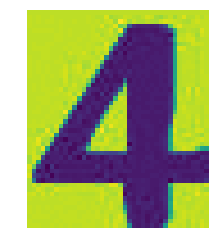

TB1..4ILXXXXXXtXFXXunYpLFXX
P9
(148.67, 189.33, 266.0, 331.33)


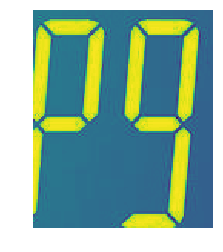

TB1..4ILXXXXXXtXFXXunYpLFXX
%
(622.67, 167.0, 663.0, 214.67)


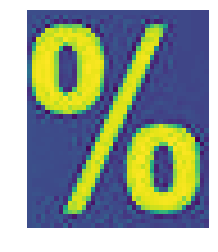

TB1..J2LpXXXXc5XVXXunYpLFXX
C
(30.74, 479.14, 43.14, 496.67)


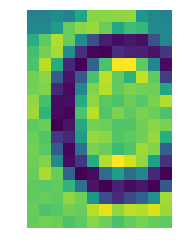

TB1..J2LpXXXXc5XVXXunYpLFXX
f
(77.21, 479.14, 84.0, 495.84)


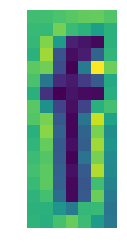

TB1..J2LpXXXXc5XVXXunYpLFXX
聖
(428.72, 479.14, 437.81, 490.71)


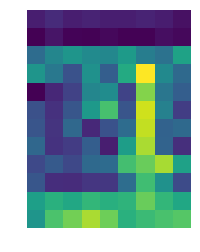

TB1..piLXXXXXX5aFXXunYpLFXX
舒阴除虱膏
(36.25, 51.0, 270.75, 1158.0)


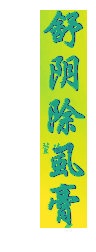

TB1..piLXXXXXX5aFXXunYpLFXX
涂搽疗法
(330.25, 403.0, 415.75, 787.0)


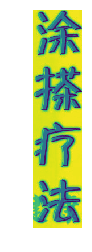

TB1..piLXXXXXX5aFXXunYpLFXX
古
(686.25, 123.0, 757.75, 214.0)


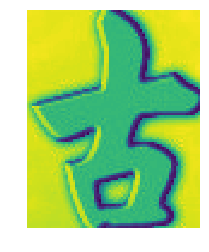

TB1..piLXXXXXX5aFXXunYpLFXX
方
(786.75, 127.0, 870.25, 215.0)


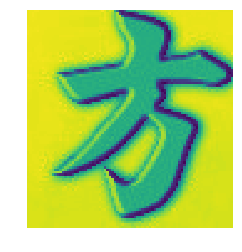

TB1.0.0PpXXXXanXVXXXXXXXXXX_!!0-item_pic.jpg
Balding
(663.06, 310.25, 705.06, 491.25)


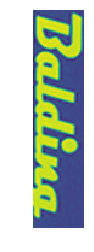

TB1.04vLXXXXXanaXXXunYpLFXX
送
(407.0, 474.0, 485.43, 559.29)


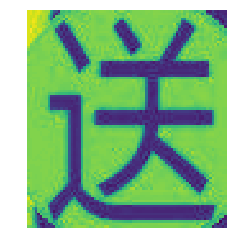

TB1.04vLXXXXXanaXXXunYpLFXX
蕲艾足浴包
(563.43, 586.71, 583.43, 668.86)


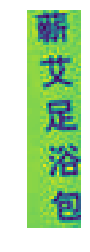

TB1.04vLXXXXXanaXXXunYpLFXX
时珍验方
(531.71, 565.71, 544.14, 599.0)


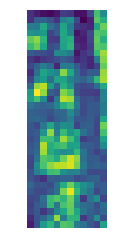

TB1.04vLXXXXXanaXXXunYpLFXX
时珍验方
(186.71, 187.71, 208.14, 259.0)


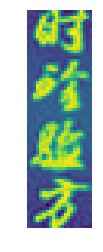

TB1.0hGPVXXXXbDaXXXXXXXXXXX_!!0-item_pic.jpg
?
(390.91, 373.47, 397.91, 386.47)


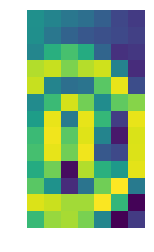

TB1.0hGPVXXXXbDaXXXXXXXXXXX_!!0-item_pic.jpg
?
(13.71, 712.27, 43.91, 748.67)


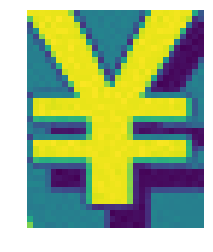

TB1.0hGPVXXXXbDaXXXXXXXXXXX_!!0-item_pic.jpg
9
(170.71, 697.67, 199.91, 754.67)


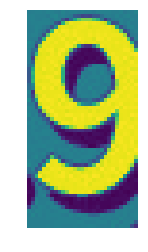

TB1.1JkhjuhSKJjSspmXXcQDpXa_!!0-item_pic.jpg
SPEC
(591.91, 208.47, 625.91, 248.27)


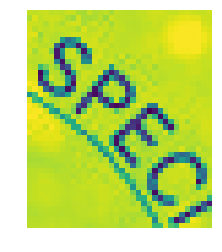

TB1.1JkhjuhSKJjSspmXXcQDpXa_!!0-item_pic.jpg
IALIY
(621.71, 241.07, 627.51, 286.67)


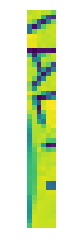

TB1.1JkhjuhSKJjSspmXXcQDpXa_!!0-item_pic.jpg
LOVE
(615.31, 292.07, 624.71, 333.67)


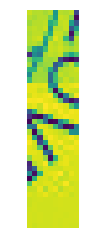

TB1.2pGLXXXXXayXFXXunYpLFXX
万家乐
(341.84, 793.45, 372.83, 836.12)


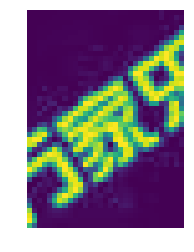

TB1.2pGLXXXXXayXFXXunYpLFXX
PICC
(475.09, 720.36, 490.17, 740.41)


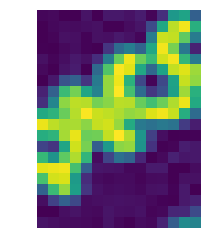

TB1.34TLXXXXXbgXXXXunYpLFXX
￥
(57.0, 739.0, 90.0, 778.67)


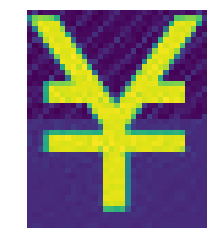

TB1.34TLXXXXXbgXXXXunYpLFXX
?
(292.33, 11.0, 311.33, 36.67)


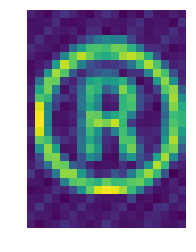

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
照片
(676.73, 561.45, 689.09, 585.45)


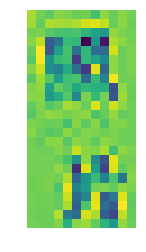

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
硬
(73.0, 599.55, 108.45, 647.36)


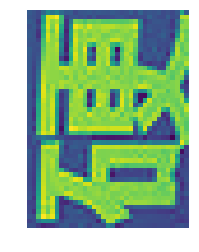

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
胶套
(87.09, 523.64, 106.36, 588.91)


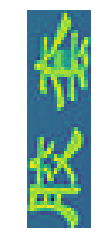

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
148×105mm
(120.36, 422.82, 127.18, 481.45)


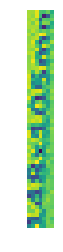

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
A6
(70.64, 419.09, 120.0, 482.73)


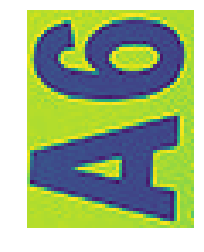

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
可加印定制
(6.0, 245.55, 51.27, 507.73)


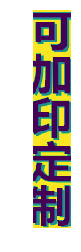

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
姓
(229.45, 550.55, 238.91, 561.0)


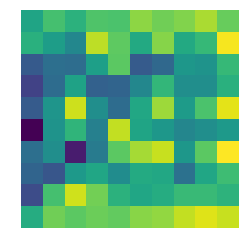

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
单
(229.45, 596.36, 238.18, 605.36)


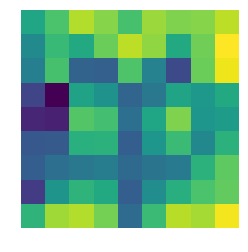

TB1.4WsSFXXXXcGaXXXXXXXXXXX_!!0-item_pic.jpg
编
(228.45, 528.0, 240.09, 540.18)


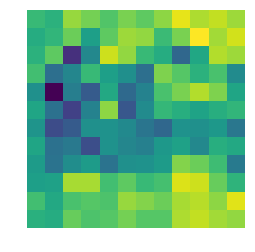

TB1.58.SXXXXXamXVXXXXXXXXXX_.jpg
1
(64.94, 585.25, 108.56, 731.25)


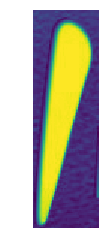

TB1.58.SXXXXXamXVXXXXXXXXXX_.jpg
?
(380.56, 90.0, 390.81, 102.88)


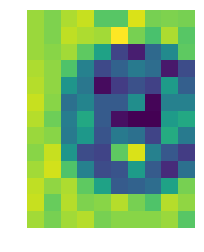

TB1.5dqLpXXXXXxXFXXXXXXXXXX_!!0-item_pic.jpg
NTN
(65.11, 378.67, 81.44, 407.11)


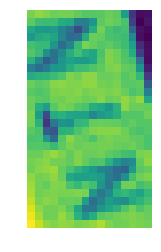

TB1.5dqLpXXXXXxXFXXXXXXXXXX_!!0-item_pic.jpg
15C-2
(373.67, 315.78, 390.89, 354.78)


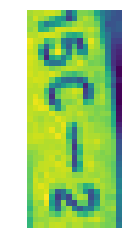

TB1.5dqLpXXXXXxXFXXXXXXXXXX_!!0-item_pic.jpg
JAPAN
(358.0, 273.78, 383.78, 310.33)


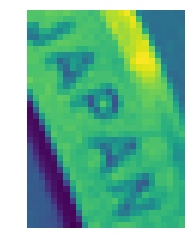

TB1.5dqLpXXXXXxXFXXXXXXXXXX_!!0-item_pic.jpg
NTN
(415.67, 266.56, 436.0, 296.11)


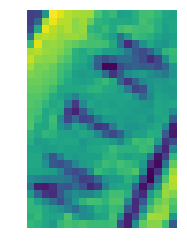

TB1.5dqLpXXXXXxXFXXXXXXXXXX_!!0-item_pic.jpg
JAPAN
(701.11, 387.44, 719.33, 428.67)


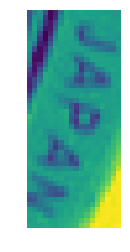

TB1.5dqLpXXXXXxXFXXXXXXXXXX_!!0-item_pic.jpg
15C-2
(678.78, 429.33, 691.78, 468.44)


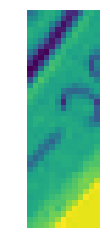

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
?
(180.0, 128.62, 190.92, 142.15)


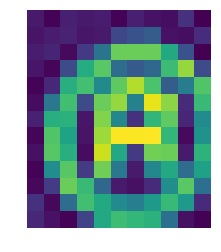

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
+
(713.85, 717.92, 753.23, 770.38)


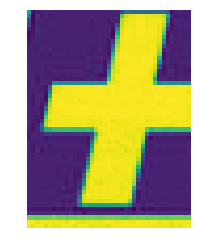

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
送达
(610.0, 714.85, 646.46, 776.38)


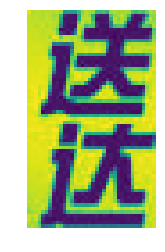

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
1
(348.85, 562.92, 420.85, 799.38)


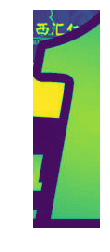

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
女金胶囊
(543.77, 171.15, 628.69, 556.46)


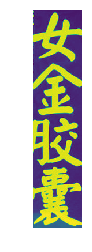

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
调经养血，理气止痛。用于月经量少、
(485.08, 263.54, 505.31, 561.6)


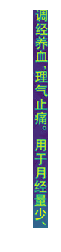

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
后错，痛经，小腹胀痛，腰腿酸痛。
(455.92, 261.92, 475.38, 523.23)


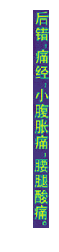

TB1.5wOgrsTMeJjSszhXXcGCFXa_.jpg
每盒8板，每板12粒
(429.85, 431.0, 443.62, 554.46)


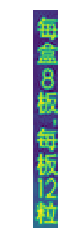

TB1.69waQfb_uJkSnaVXXXFmVXa_!!0-item_pic.jpg
MENONLY
(256.29, 346.43, 310.71, 624.29)


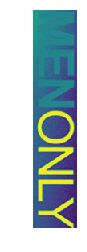

TB1.6GFn26H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
4
(386.71, 60.58, 395.79, 76.0)


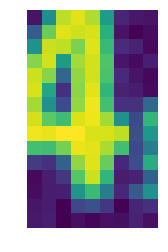

TB1.6GFn26H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
岁
(397.04, 67.92, 401.21, 75.58)


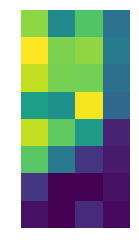

TB1.6VWnDTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
惟有时光
(61.13, 68.42, 79.04, 140.42)


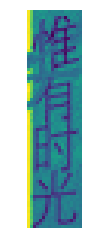

TB1.6VWnDTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
浩科文化
(19.96, 58.92, 90.54, 131.42)


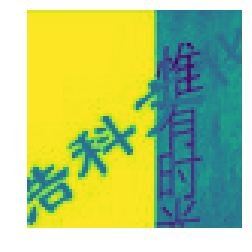

TB1.6VWnDTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
惟有
(207.13, 73.08, 242.21, 145.92)


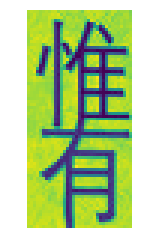

TB1.795FVXXXXayXFXXXXXXXXXX_!!0-item_pic.jpg
对
(86.57, 157.32, 132.27, 208.57)


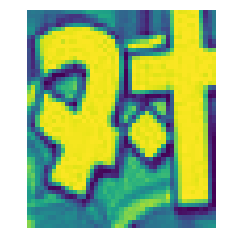

TB1.833nInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
正
(207.92, 217.21, 231.39, 241.21)


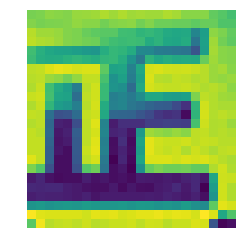

TB1.8dMLXXXXXbbXpXXunYpLFXX
轻
(97.46, 109.06, 126.17, 139.29)


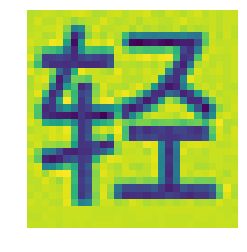

TB1.8dMLXXXXXbbXpXXunYpLFXX
棉
(178.17, 109.06, 205.89, 138.8)


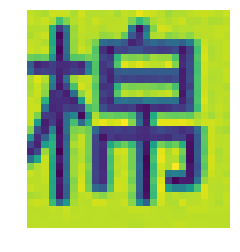

TB1.8JgnZnI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
与
(224.2, 321.6, 258.05, 357.33)


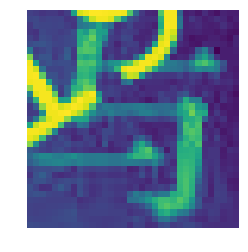

TB1.8mJGpXXXXaiXXXXXXXXXXXX_!!0-item_pic.jpg
爱
(81.36, 18.82, 91.45, 30.55)


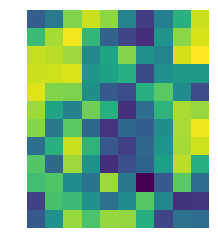

TB1.8mJGpXXXXaiXXXXXXXXXXXX_!!0-item_pic.jpg
作文
(104.45, 90.64, 130.45, 134.27)


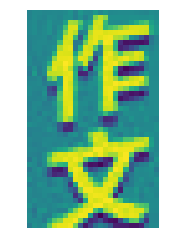

TB1.8U.RFXXXXacXVXXXXXXXXXX_!!0-item_pic.jpg
理
(313.12, 205.33, 380.69, 276.52)


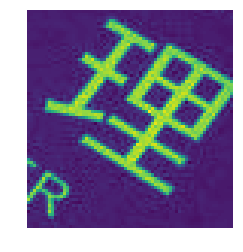

TB1.94BLXXXXXXEXVXXunYpLFXX
超级快
(71.47, 123.9, 109.82, 164.5)


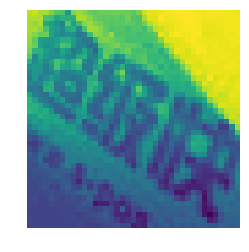

TB1.94BLXXXXXXEXVXXunYpLFXX
超级快
(92.32, 55.7, 136.07, 104.3)


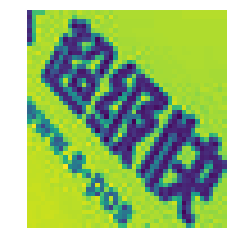

TB1.94BLXXXXXXEXVXXunYpLFXX
T
(136.72, 82.95, 145.47, 92.35)


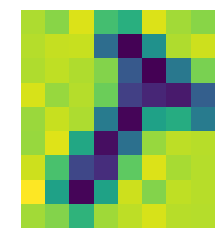

TB1.96IQpXXXXa8apXXXXXXXXXX_!!0-item_pic.jpg
越
(292.74, 297.12, 319.3, 325.4)


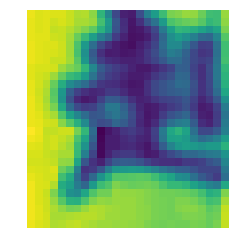

TB1.96IQpXXXXa8apXXXXXXXXXX_!!0-item_pic.jpg
免
(272.14, 345.2, 315.3, 403.76)


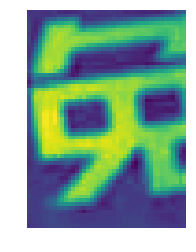

TB1.9Ovf63z9KJjy0FmXXXiwXXa_!!0-item_pic.jpg
送
(94.11, 547.78, 151.44, 609.33)


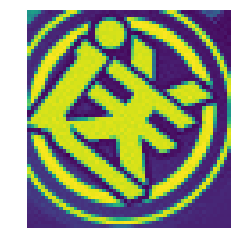

TB1.9Ovf63z9KJjy0FmXXXiwXXa_!!0-item_pic.jpg
片
(693.78, 497.67, 734.78, 547.0)


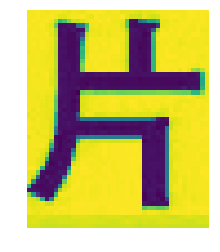

TB1.9pqhfBNTKJjy0FdXXcPpVXa_!!0-item_pic.jpg
4
(152.8, 315.6, 185.4, 358.4)


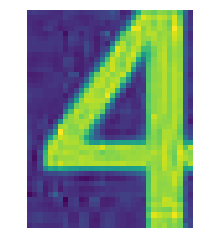

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
源
(1011.03, 1098.82, 1069.53, 1188.32)


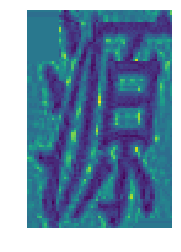

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
不负所拍
(6.03, 673.48, 108.03, 1086.98)


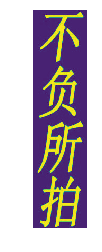

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
坚持正道
(10.03, 194.98, 107.03, 624.98)


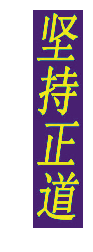

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
深圳
(780.53, 550.98, 867.03, 666.48)


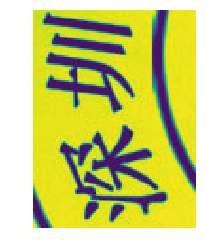

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
公司
(1104.53, 547.48, 1171.53, 666.48)


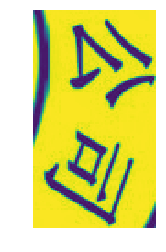

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
市汇
(787.03, 427.65, 880.03, 553.65)


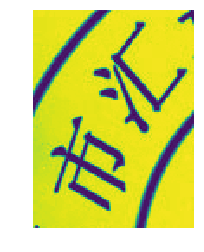

TB1.9PRRpXXXXX6XpXXXXXXXXXX_!!0-item_pic.jpg
有限
(1082.53, 429.15, 1177.03, 543.65)


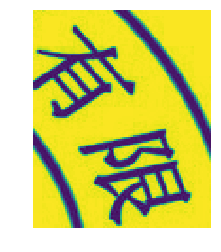

TB1.A1todzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
颜
(94.76, 161.71, 315.18, 435.82)


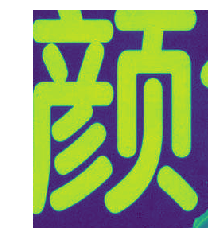

TB1.A1todzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
色
(301.24, 143.93, 488.54, 406.72)


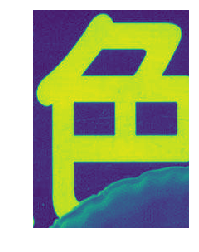

TB1.A1todzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
形
(517.7, 159.56, 726.48, 380.63)


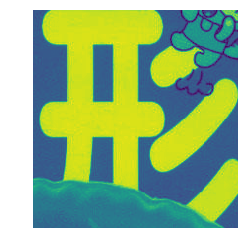

TB1.A1todzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
状
(725.54, 143.13, 965.55, 434.04)


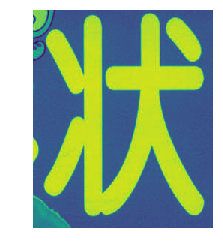

TB1.A7kcWagSKJjy0FhXXcrbFXa_!!0-item_pic.jpg
+
(513.24, 285.12, 534.35, 311.65)


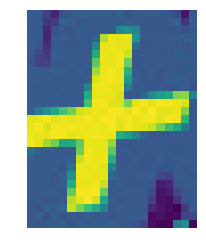

TB1.aJYLpXXXXclaXXXunYpLFXX
印美百货
(4.31, 50.63, 61.69, 277.38)


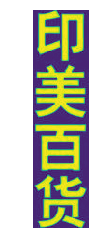

TB1.aJYLpXXXXclaXXXunYpLFXX
关
(614.31, 394.75, 620.94, 406.63)


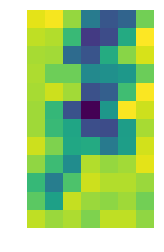

TB1.aJYLpXXXXclaXXXunYpLFXX
开
(592.56, 402.88, 600.94, 414.38)


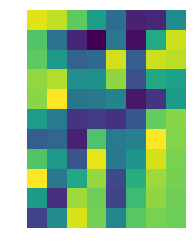

TB1.aJYLpXXXXclaXXXunYpLFXX
慢
(490.06, 455.88, 501.31, 467.13)


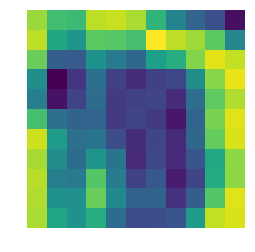

TB1.aJYLpXXXXclaXXXunYpLFXX
快
(519.31, 464.63, 532.56, 480.13)


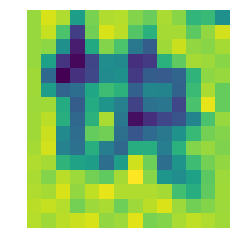

TB1.aKkLpXXXXagXFXX.NCL9XXX_035211.jpg
?
(554.22, 85.22, 568.33, 104.78)


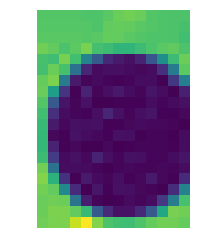

TB1.AxBLXXXXXXNXVXXunYpLFXX
?
(463.43, 468.57, 479.57, 485.43)


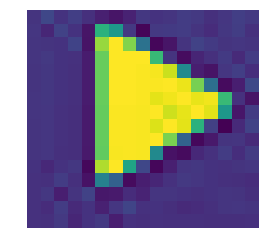

TB1.AxBLXXXXXXNXVXXunYpLFXX
导
(76.43, 101.0, 94.57, 120.29)


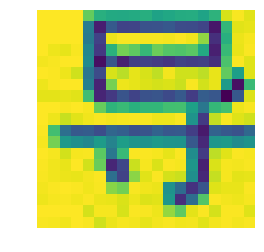

TB1.AxBLXXXXXXNXVXXunYpLFXX
航
(114.57, 102.57, 132.71, 120.86)


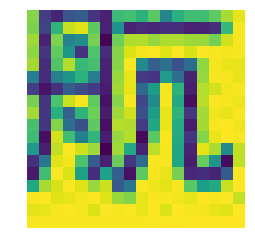

TB1.AxBLXXXXXXNXVXXunYpLFXX
路
(261.0, 100.0, 278.29, 119.71)


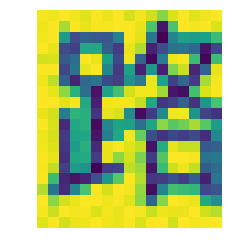

TB1.AXRlJfJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
赠
(313.4, 663.0, 373.0, 735.8)


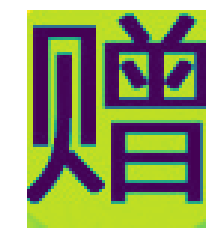

TB1.bFlmwDD8KJjy0FdXXcjvXXa_!!2-item_pic.png
送
(377.44, 279.26, 407.21, 311.73)


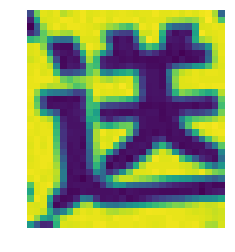

TB1.BGSkhPI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
让
(366.09, 271.23, 405.09, 312.89)


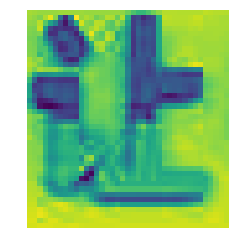

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
P
(67.95, 23.4, 82.11, 50.09)


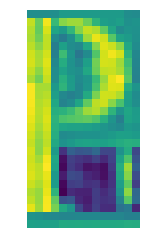

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
和
(292.2, 88.53, 308.53, 106.87)


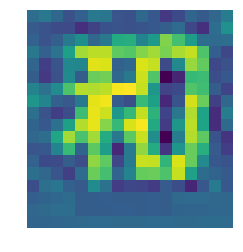

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
香
(235.41, 577.61, 261.57, 608.76)


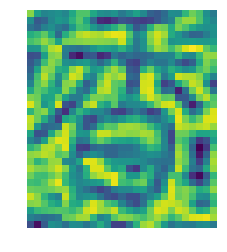

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
氛
(260.65, 576.22, 283.34, 604.46)


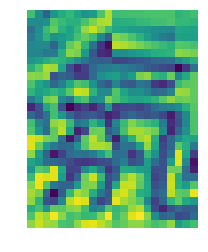

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
袋
(284.88, 584.22, 312.88, 614.07)


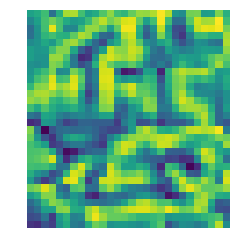

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
袋
(351.11, 582.38, 364.41, 610.69)


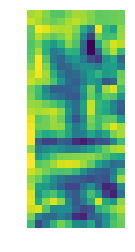

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
持
(404.41, 94.01, 423.34, 117.32)


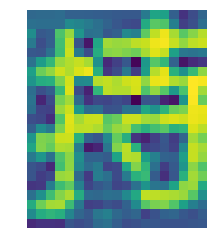

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
续
(430.8, 96.7, 443.18, 113.47)


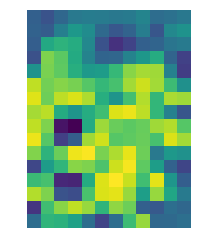

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
抽
(308.8, 87.24, 328.26, 108.93)


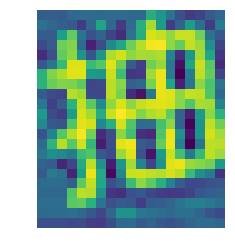

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
屉
(329.72, 88.7, 345.11, 107.09)


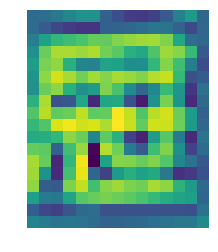

TB1.bhnhtqUQKJjSZFIXXcOkFXa_!!0-item_pic.jpg
的
(347.34, 91.78, 361.26, 108.55)


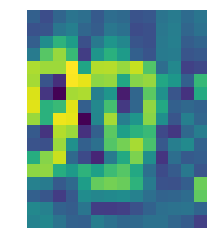

TB1.BuFg26H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
SMILE
(33.67, 445.67, 46.67, 491.33)


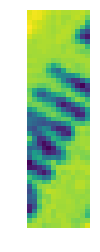

TB1.BuFg26H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
SMII
(77.0, 401.0, 97.33, 433.67)


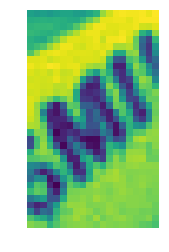

TB1.BuFg26H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
接
(235.0, 291.67, 263.0, 336.67)


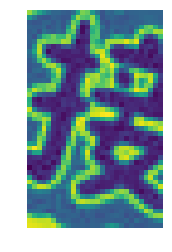

TB1.BuFg26H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
卡
(313.0, 302.33, 346.67, 336.67)


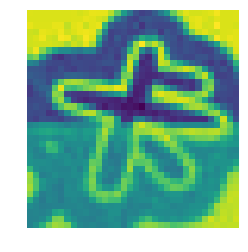

TB1.cBULpXXXXamapXXunYpLFXX
S
(432.2, 86.73, 462.67, 134.73)


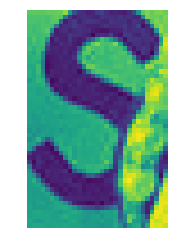

TB1.cBULpXXXXamapXXunYpLFXX
U
(526.4, 96.8, 575.0, 145.87)


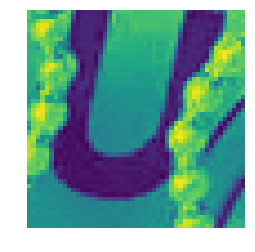

TB1.cBULpXXXXamapXXunYpLFXX
INSIDE
(110.27, 509.87, 156.67, 557.33)


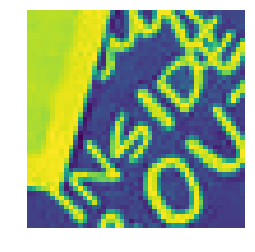

TB1.cBULpXXXXamapXXunYpLFXX
&OUT
(122.33, 516.33, 169.27, 573.93)


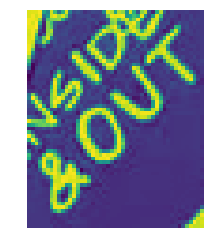

TB1.ChoLXXXXXa1apXXunYpLFXX
日
(322.37, 112.77, 342.27, 136.3)


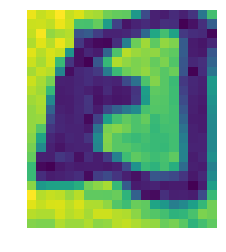

TB1.CiUXBLN8KJjSZFpXXbZaVXa_!!0-item_pic.jpg
N
(574.24, 118.36, 612.39, 165.36)


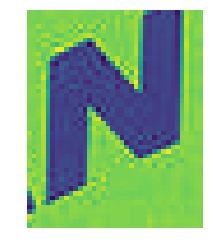

TB1.cMkeAfb_uJkSne1XXbE4XXa_!!0-item_pic.jpg
淘
(108.5, 22.0, 191.83, 109.33)


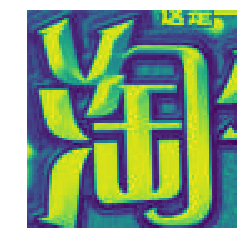

TB1.cMkeAfb_uJkSne1XXbE4XXa_!!0-item_pic.jpg
气
(182.5, 29.0, 248.17, 114.0)


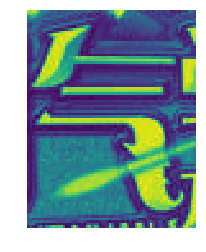

TB1.CxRLXXXXXbMXXXXunYpLFXX
|
(632.42, 128.81, 640.33, 139.23)


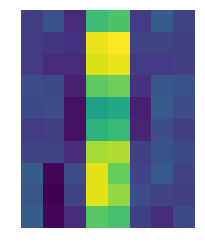

TB1.CxRLXXXXXbMXXXXunYpLFXX
\
(633.05, 142.0, 640.96, 151.17)


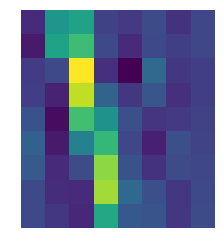

TB1.CxRLXXXXXbMXXXXunYpLFXX
}
(593.09, 129.44, 600.12, 138.86)


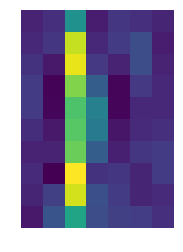

TB1.CxRLXXXXXbMXXXXunYpLFXX
]
(591.2, 142.0, 599.74, 152.43)


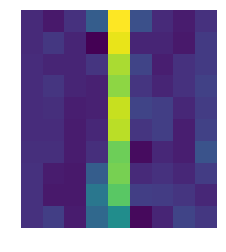

TB1.CxRLXXXXXbMXXXXunYpLFXX
{
(550.99, 129.81, 560.53, 139.86)


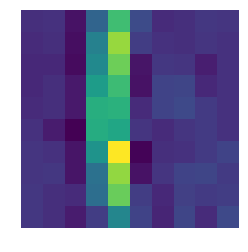

TB1.CxRLXXXXXbMXXXXunYpLFXX
[
(549.11, 142.38, 558.02, 152.43)


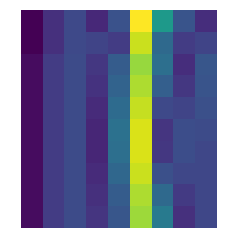

TB1.CxRLXXXXXbMXXXXunYpLFXX
:
(520.2, 167.51, 530.0, 179.45)


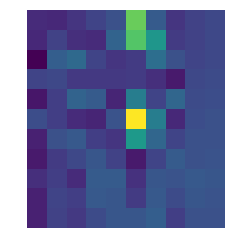

TB1.CxRLXXXXXbMXXXXunYpLFXX
;
(520.83, 181.59, 528.11, 191.38)


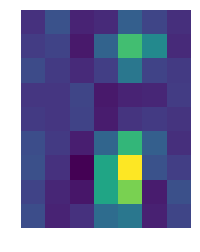

TB1.CxRLXXXXXbMXXXXunYpLFXX
2
(459.63, 168.39, 468.79, 179.45)


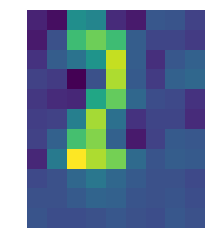

TB1.CxRLXXXXXbMXXXXunYpLFXX
4
(407.73, 128.81, 416.64, 139.23)


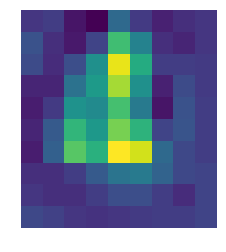

TB1.CxRLXXXXXbMXXXXunYpLFXX
6
(488.16, 129.44, 496.7, 138.6)


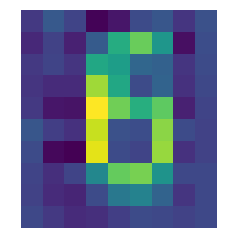

TB1.CxRLXXXXXbMXXXXunYpLFXX
*
(529.11, 127.55, 537.28, 136.09)


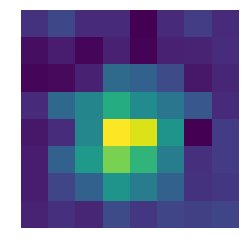

TB1.CxRLXXXXXbMXXXXunYpLFXX
F2
(162.42, 55.92, 170.59, 65.72)


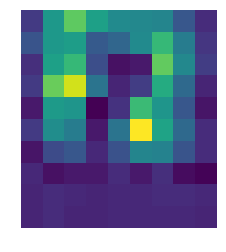

TB1.CxRLXXXXXbMXXXXunYpLFXX
!
(113.41, 88.97, 120.7, 97.76)


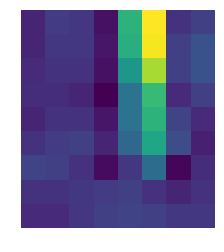

TB1.CxRLXXXXXbMXXXXunYpLFXX
~
(83.0, 87.97, 89.28, 94.62)


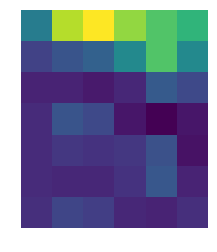

TB1.CxRLXXXXXbMXXXXunYpLFXX
1
(118.18, 101.79, 121.84, 109.96)


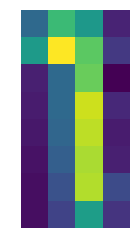

TB1.CxRLXXXXXbMXXXXunYpLFXX
2
(158.28, 103.05, 167.19, 113.56)


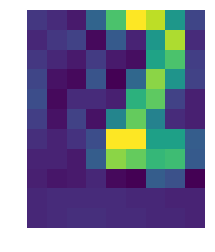

TB1.CxRLXXXXXbMXXXXunYpLFXX
4
(248.25, 103.05, 255.16, 112.21)


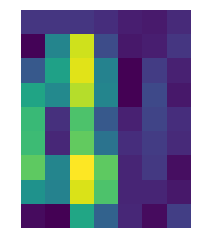

TB1.CxRLXXXXXbMXXXXunYpLFXX
$
(245.99, 88.59, 255.16, 98.65)


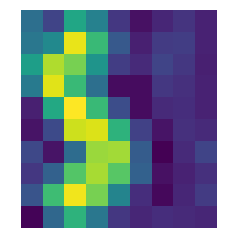

TB1.CxRLXXXXXbMXXXXunYpLFXX
6
(330.19, 104.93, 339.36, 117.24)


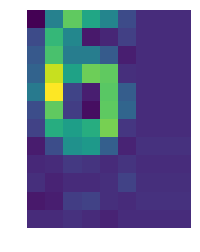

TB1.CxRLXXXXXbMXXXXunYpLFXX
&
(373.29, 90.48, 377.69, 98.39)


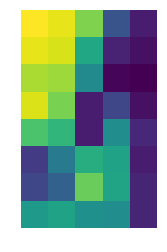

TB1.CxRLXXXXXbMXXXXunYpLFXX
7
(387.0, 89.22, 393.28, 99.02)


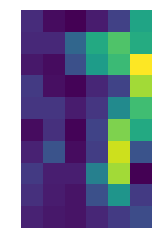

TB1.CxRLXXXXXbMXXXXunYpLFXX
*
(413.76, 90.48, 419.41, 99.02)


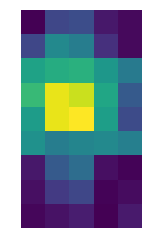

TB1.CxRLXXXXXbMXXXXunYpLFXX
(
(452.34, 90.85, 458.0, 100.91)


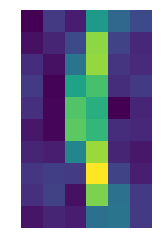

TB1.CxRLXXXXXbMXXXXunYpLFXX
9
(451.09, 104.3, 458.0, 112.47)


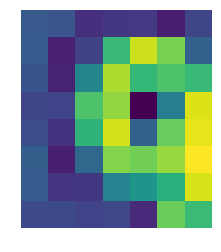

TB1.CxRLXXXXXbMXXXXunYpLFXX
0
(493.18, 103.67, 500.84, 112.47)


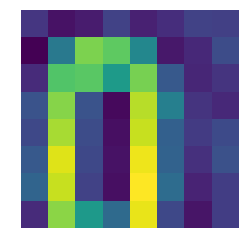

TB1.CxRLXXXXXbMXXXXunYpLFXX
Z
(173.36, 206.72, 181.65, 218.4)


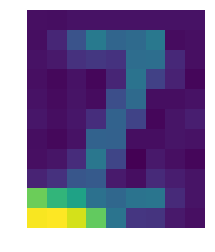

TB1.CxRLXXXXXbMXXXXunYpLFXX
X
(213.58, 207.09, 225.0, 220.92)


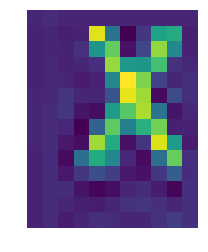

TB1.CxRLXXXXXbMXXXXunYpLFXX
C
(258.19, 206.09, 267.1, 220.29)


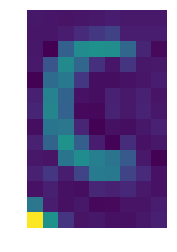

TB1.CxRLXXXXXbMXXXXunYpLFXX
V
(300.91, 206.09, 309.83, 217.15)


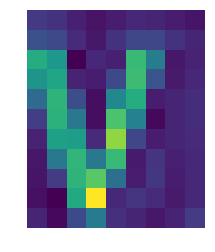

TB1.CxRLXXXXXbMXXXXunYpLFXX
B
(340.5, 207.35, 350.04, 219.03)


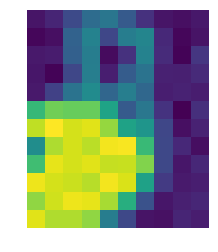

TB1.CxRLXXXXXbMXXXXunYpLFXX
N
(380.71, 205.46, 390.88, 217.77)


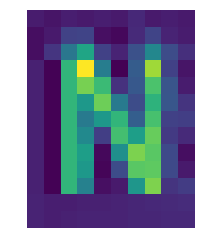

TB1.CxRLXXXXXbMXXXXunYpLFXX
Q
(142.06, 126.29, 147.97, 137.6)


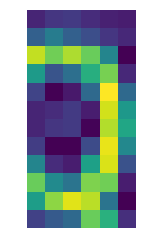

TB1.CxRLXXXXXbMXXXXunYpLFXX
A
(151.37, 168.39, 160.17, 179.07)


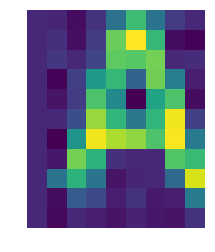

TB1.CxRLXXXXXbMXXXXunYpLFXX
S
(192.84, 167.14, 201.01, 178.19)


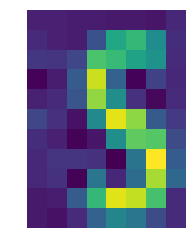

TB1.CxRLXXXXXbMXXXXunYpLFXX
W
(183.79, 128.18, 192.84, 137.98)


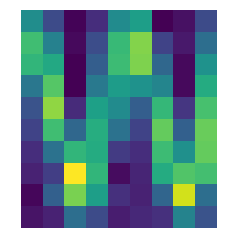

TB1.CxRLXXXXXbMXXXXunYpLFXX
E
(224.63, 127.55, 231.54, 138.6)


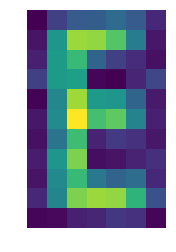

TB1.CxRLXXXXXbMXXXXunYpLFXX
D
(238.08, 170.02, 244.74, 179.07)


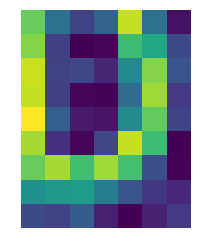

TB1.CxRLXXXXXbMXXXXunYpLFXX
F
(277.67, 167.76, 288.09, 178.19)


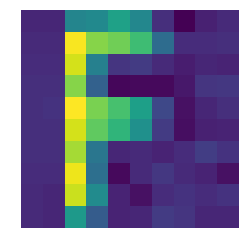

TB1.CxRLXXXXXbMXXXXunYpLFXX
T
(309.08, 126.92, 316.99, 138.23)


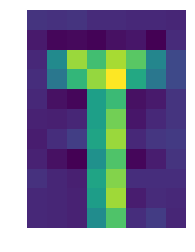

TB1.CxRLXXXXXbMXXXXunYpLFXX
G
(319.14, 167.76, 328.93, 179.45)


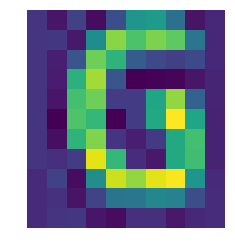

TB1.CxRLXXXXXbMXXXXunYpLFXX
Y
(350.55, 129.81, 358.21, 140.49)


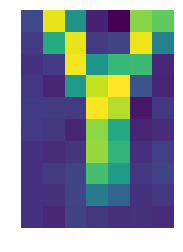

TB1.CxRLXXXXXbMXXXXunYpLFXX
H
(361.61, 167.51, 370.4, 180.07)


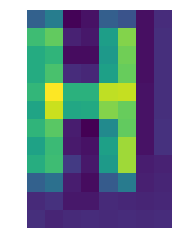

TB1.CxRLXXXXXbMXXXXunYpLFXX
J
(401.45, 166.51, 410.36, 178.19)


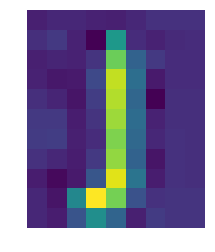

TB1.CxRLXXXXXbMXXXXunYpLFXX
三个月包换
(509.8, 227.54, 604.89, 408.25)


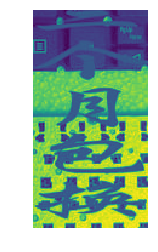

TB1.CxRLXXXXXbMXXXXunYpLFXX
9
(469.98, 91.02, 476.83, 99.1)


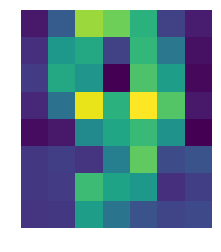

TB1.CxRLXXXXXbMXXXXunYpLFXX
I
(431.74, 127.64, 437.05, 141.57)


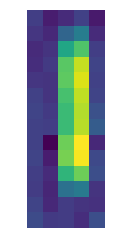

TB1.CxRLXXXXXbMXXXXunYpLFXX
O
(471.06, 129.72, 481.21, 140.49)


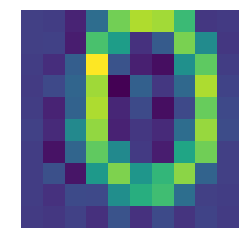

TB1.CxRLXXXXXbMXXXXunYpLFXX
L
(481.29, 168.5, 490.37, 179.27)


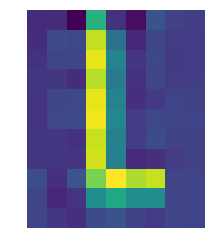

TB1.CxRLXXXXXbMXXXXunYpLFXX
K
(441.9, 166.42, 450.98, 179.27)


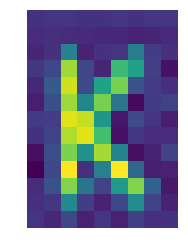

TB1.d6DX2jM8KJjSZFNXXbQjFXa_!!0-item_pic.jpg
！
(360.82, 674.26, 383.93, 732.15)


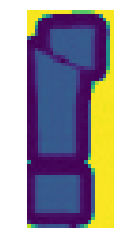

TB1.dBCLXXXXXXPXFXXunYpLFXX
BUGS
(390.04, 52.69, 421.46, 135.46)


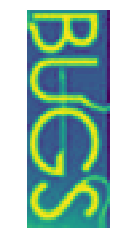

TB1.dBCLXXXXXXPXFXXunYpLFXX
2
(187.81, 703.04, 200.77, 720.62)


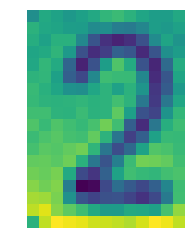

TB1.dBCLXXXXXXPXFXXunYpLFXX
1
(55.54, 591.54, 63.46, 605.81)


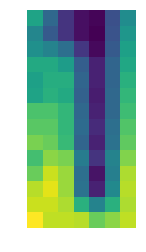

TB1.dBCLXXXXXXPXFXXunYpLFXX
4
(538.08, 705.19, 548.31, 718.88)


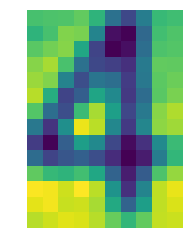

TB1.dBCLXXXXXXPXFXXunYpLFXX
5
(666.46, 591.15, 680.15, 607.58)


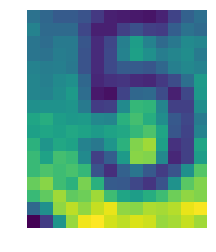

TB1.DcOQXXXXXbgXpXXXXXXXXXX_!!0-item_pic.jpg
乐亿多
(189.28, 578.88, 201.46, 594.61)


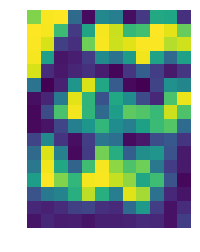

TB1.DcOQXXXXXbgXpXXXXXXXXXX_!!0-item_pic.jpg
S
(729.91, 567.7, 738.82, 579.07)


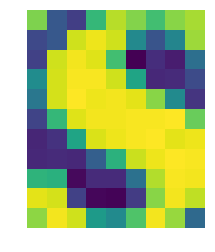

TB1.DcOQXXXXXbgXpXXXXXXXXXX_!!0-item_pic.jpg
S
(371.55, 490.61, 386.19, 508.61)


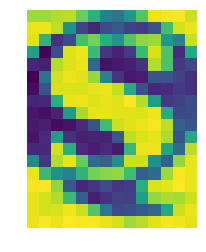

TB1.DcOQXXXXXbgXpXXXXXXXXXX_!!0-item_pic.jpg
.0
(685.44, 321.25, 737.58, 376.82)


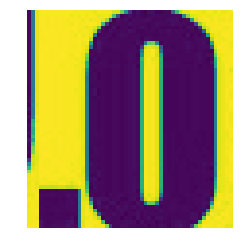

TB1.dhjFVXXXXc5XpXXXXXXXXXX_!!0-item_pic.jpg
sigmat
(680.33, 139.67, 711.67, 663.33)


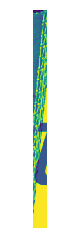

TB1.e4um9_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
勿
(473.25, 351.5, 490.25, 374.5)


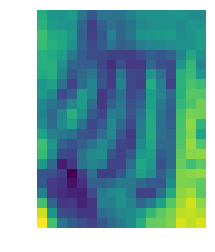

TB1.e5Gg3MPMeJjy1XdXXasrXXa_!!0-item_pic.jpg
+
(627.5, 486.0, 665.5, 525.0)


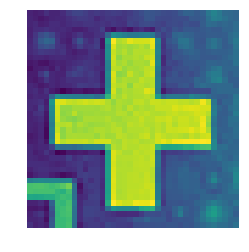

TB1.e5Gg3MPMeJjy1XdXXasrXXa_!!0-item_pic.jpg
N
(506.5, 528.0, 548.5, 596.0)


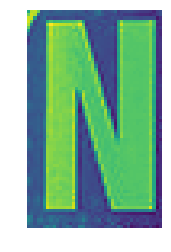

TB1.EbsQpXXXXboXVXXXXXXXXXX_!!0-item_pic.jpg
?
(223.33, 13.33, 240.0, 33.0)


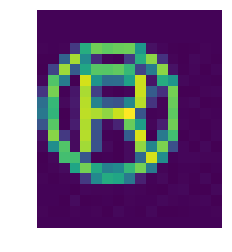

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
+
(119.22, 456.67, 159.78, 501.78)


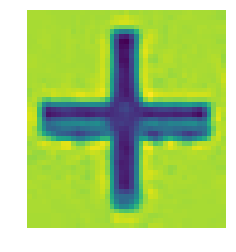

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
8
(298.33, 505.78, 341.11, 577.67)


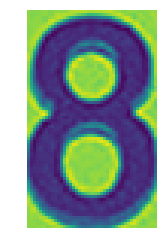

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
卡
(681.78, 243.67, 731.78, 308.0)


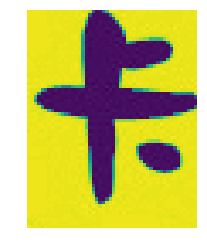

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
随
(484.22, 311.33, 551.56, 382.89)


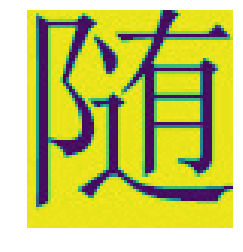

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
随
(633.11, 312.22, 702.44, 383.0)


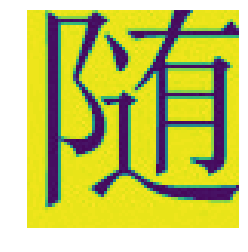

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
发
(708.44, 305.44, 780.89, 378.0)


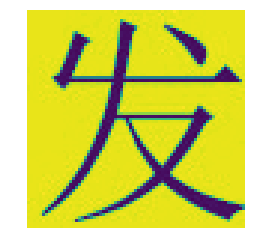

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
无
(188.56, 680.56, 255.67, 756.22)


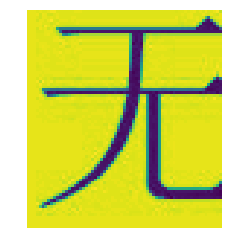

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
需
(273.89, 688.0, 336.22, 757.11)


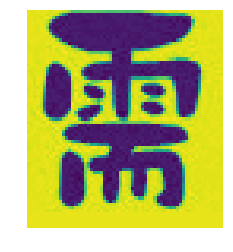

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
手
(353.0, 687.78, 408.11, 746.56)


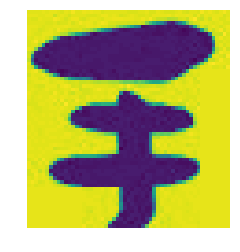

TB1.eoAQXXXXXbJXpXXXXXXXXXX_!!0-item_pic.jpg
量
(576.0, 685.89, 641.89, 758.89)


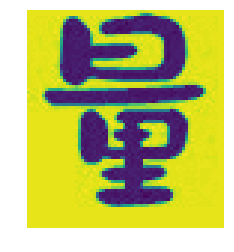

TB1.etzHFXXXXbXXpXXXXXXXXXX_!!0-item_pic.jpg
R
(259.35, 39.59, 267.74, 48.41)


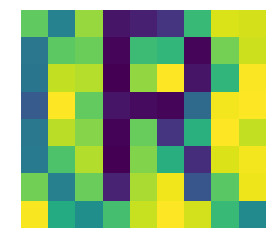

TB1.etzHFXXXXbXXpXXXXXXXXXX_!!0-item_pic.jpg
?
(39.5, 359.62, 57.9, 384.11)


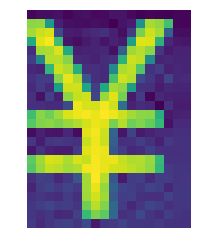

TB1.EYqhsLJ8KJjy0FnXXcFDpXa_!!0-item_pic.jpg
K
(29.33, 40.33, 46.67, 59.33)


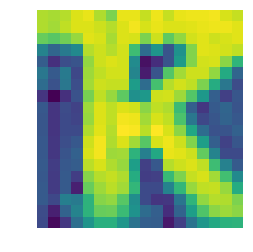

TB1.F8kaiIRMeJjy0FbXXbnqXXa_!!0-item_pic.jpg
送运费险
(742.44, 7.78, 784.78, 162.0)


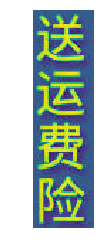

TB1.fL1XzuhSKJjSspdXXc11XXa_.jpg
1
(340.2, 556.6, 454.8, 796.0)


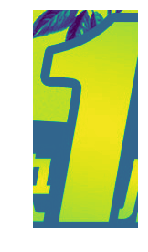

TB1.fL1XzuhSKJjSspdXXc11XXa_.jpg
送达
(611.4, 714.2, 648.0, 779.0)


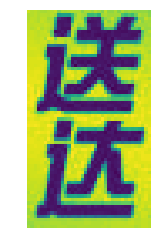

TB1.fL1XzuhSKJjSspdXXc11XXa_.jpg
+
(717.4, 717.0, 756.0, 768.2)


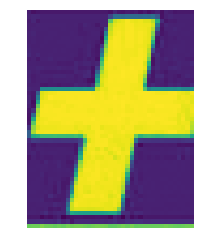

TB1.fL1XzuhSKJjSspdXXc11XXa_.jpg
牌
(413.6, 172.4, 430.0, 190.0)


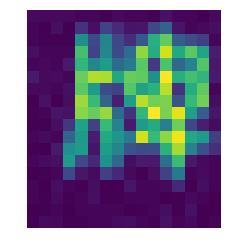

TB1.fL1XzuhSKJjSspdXXc11XXa_.jpg
?
(427.6, 133.4, 442.2, 150.6)


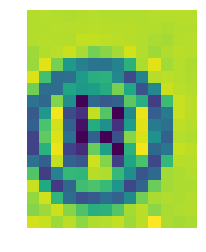

TB1.GoCRFXXXXcvaXXXXXXXXXXX_!!0-item_pic.jpg
￥
(627.33, 700.0, 648.33, 733.67)


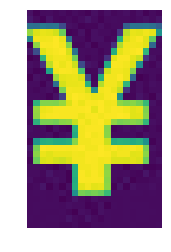

TB1.GOjix6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
减
(638.78, 128.22, 701.44, 197.11)


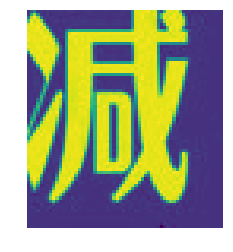

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
第
(622.01, 579.15, 635.01, 593.15)


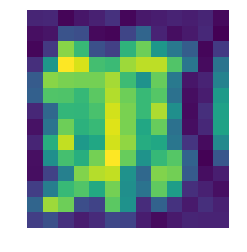

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
8
(631.01, 555.15, 671.01, 598.15)


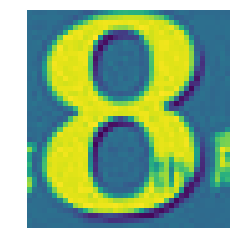

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
版
(329.01, 576.24, 344.01, 592.24)


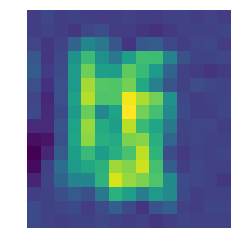

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
8
(308.01, 556.24, 335.01, 595.24)


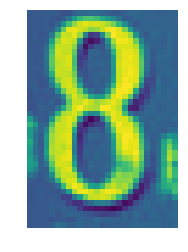

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
OxfordAdvancedLearner’s
(303.01, 169.42, 325.01, 539.42)


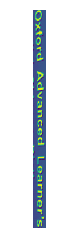

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
English-ChineseDictionary
(290.01, 175.42, 306.01, 529.42)


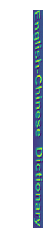

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
我们是正版
(149.01, 140.15, 258.01, 676.15)


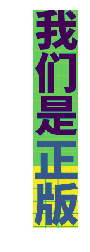

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
贵，
(20.01, 133.33, 132.01, 299.33)


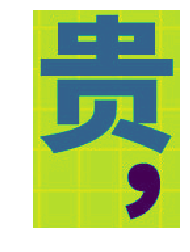

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
只因为
(21.01, 357.15, 124.01, 674.15)


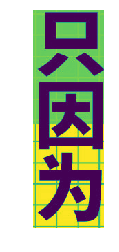

TB1.hytcMn.PuJjSZFkXXc_lpXa_!!0-item_pic.jpg
商
(308.01, 123.33, 324.01, 146.33)


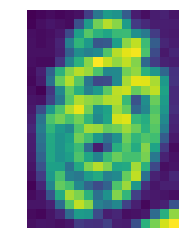

TB1.iBJLXXXXXcyXpXXunYpLFXX
Gillette
(342.8, 618.0, 359.0, 691.0)


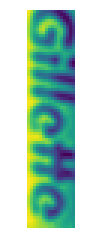

TB1.iBJLXXXXXcyXpXXunYpLFXX
1
(186.4, 750.8, 202.4, 783.6)


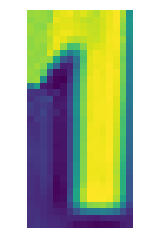

TB1.iBJLXXXXXcyXpXXunYpLFXX
2
(396.4, 409.6, 438.6, 470.2)


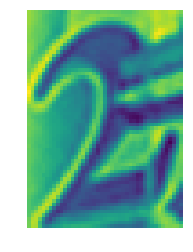

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
四季平安步步高
(13.0, 387.33, 66.67, 733.33)


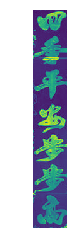

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
一帆風顺年年好
(90.33, 384.67, 149.0, 730.67)


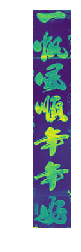

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
年年如意曾富貴
(168.33, 281.0, 236.67, 709.67)


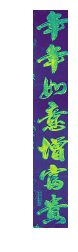

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
歳歳平安添美满
(279.0, 271.67, 346.33, 703.33)


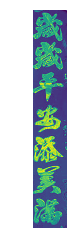

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
八方進寳福满門
(364.33, 276.67, 439.33, 700.67)


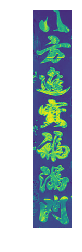

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
萬事如意幸福家
(574.0, 179.67, 653.67, 673.33)


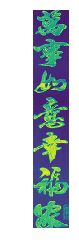

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
吉祥
(464.0, 708.0, 483.0, 740.67)


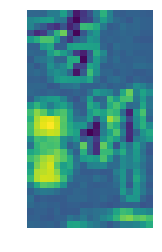

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
吉祥
(557.0, 686.0, 588.0, 731.33)


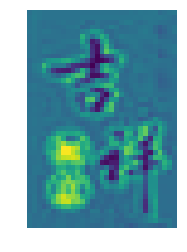

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
富贵
(420.33, 703.0, 452.0, 740.33)


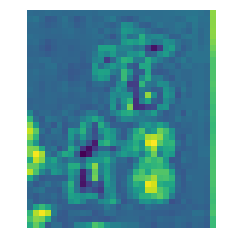

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
吉祥
(261.33, 702.67, 282.67, 733.0)


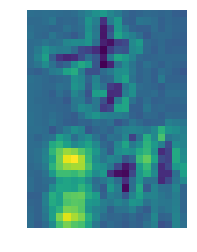

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
富贵
(223.0, 709.67, 247.0, 736.67)


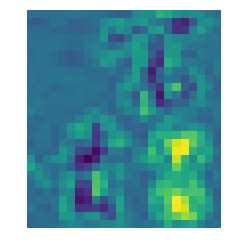

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
一帆風顺平安宅
(693.33, 190.0, 785.0, 691.0)


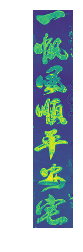

TB1.ImQmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
四季来財家興旺
(465.8, 279.27, 539.67, 697.33)


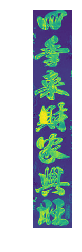

TB1.iNGLXXXXXX.XFXXunYpLFXX
克
(136.96, 50.41, 170.76, 88.21)


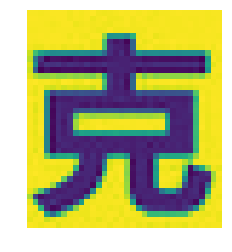

TB1.J0GLXXXXXa1XFXXunYpLFXX
权
(313.32, 370.58, 345.32, 406.25)


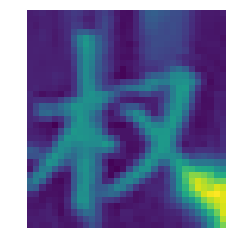

TB1.JdxLXXXXXctXVXXunYpLFXX
淘
(19.64, 882.04, 42.64, 906.04)


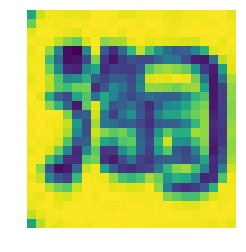

TB1.jqKhIbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
?
(298.66, 33.39, 315.89, 51.77)


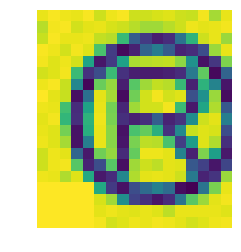

TB1.JXpLXXXXXXAapXXunYpLFXX
盘
(36.25, 141.0, 73.75, 182.67)


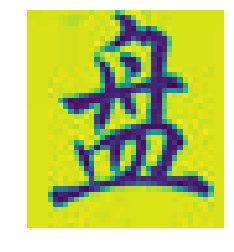

TB1.JXpLXXXXXXAapXXunYpLFXX
安
(99.08, 140.33, 137.42, 180.5)


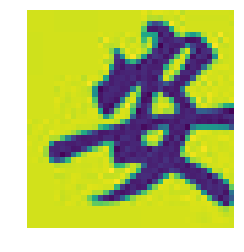

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
星期
(259.38, 113.0, 282.77, 137.0)


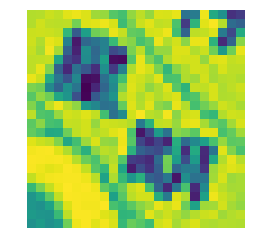

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
周一
(296.08, 141.54, 303.08, 153.62)


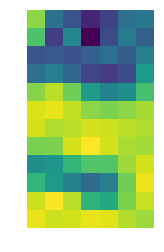

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
周三
(327.69, 146.46, 339.15, 161.62)


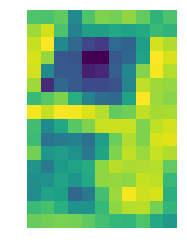

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
周四
(342.85, 148.31, 353.15, 163.08)


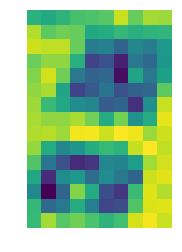

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
周五
(359.69, 152.0, 369.54, 166.54)


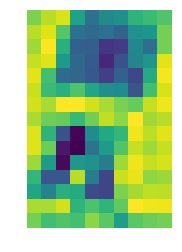

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
周六
(376.69, 154.46, 384.69, 169.0)


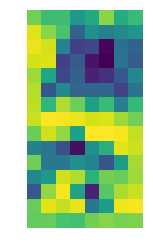

TB1.K9PgxHI8KJjy1zbXXaxdpXa_!!0-item_pic.jpg
日
(391.08, 157.54, 403.15, 172.69)


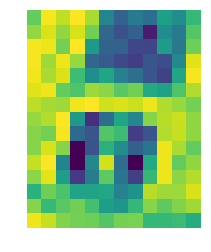

TB1.kfqQpXXXXXhXVXXXXXXXXXX_!!0-item_pic.jpg
DNWY
(428.17, 353.52, 575.42, 528.83)


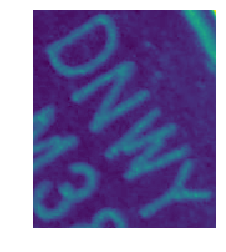

TB1.kfqQpXXXXXhXVXXXXXXXXXX_!!0-item_pic.jpg
LM386
(370.8, 399.14, 529.8, 605.2)


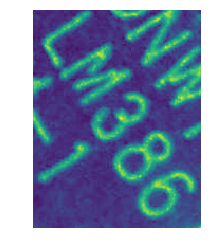

TB1.kfqQpXXXXXhXVXXXXXXXXXX_!!0-item_pic.jpg
全国运费
(646.36, 613.52, 778.8, 832.45)


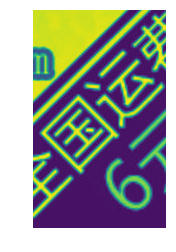

TB1.kfqQpXXXXXhXVXXXXXXXXXX_!!0-item_pic.jpg
6元
(742.67, 710.52, 783.61, 830.39)


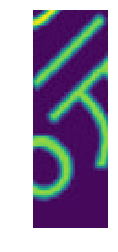

TB1.kfqQpXXXXXhXVXXXXXXXXXX_!!0-item_pic.jpg
M-1
(370.23, 434.39, 383.05, 563.08)


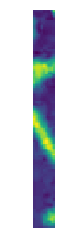

TB1.Ki2d3jN8KJjSZFgXXbjbVXa_!!0-item_pic.jpg
?
(217.0, 19.0, 232.67, 38.0)


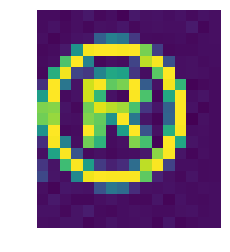

TB1.kJWLpXXXXcEaXXXunYpLFXX
附
(35.16, 46.83, 83.18, 97.37)


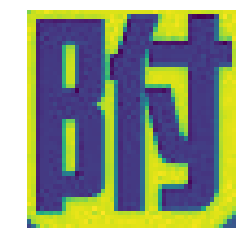

TB1.kJWLpXXXXcEaXXXunYpLFXX
1
(349.07, 110.86, 353.56, 117.79)


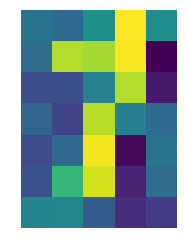

TB1.kJWLpXXXXcEaXXXunYpLFXX
UC28
(14.35, 295.58, 103.23, 384.56)


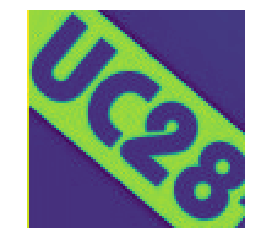

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(35.87, 211.18, 73.33, 306.68)


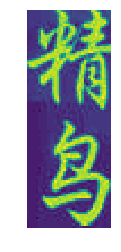

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(5.88, 50.43, 40.87, 127.29)


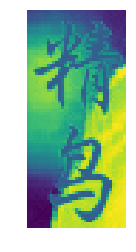

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(129.24, 113.01, 166.03, 189.06)


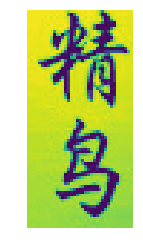

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(233.15, 176.65, 268.07, 253.58)


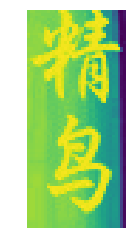

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(1.34, 365.59, 28.52, 437.71)


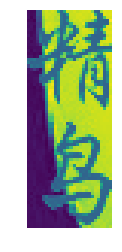

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
铭都
(410.06, 331.93, 440.05, 405.05)


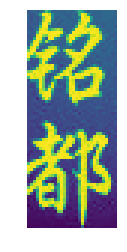

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(526.94, 358.04, 553.25, 430.17)


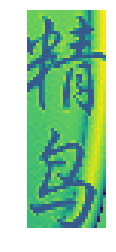

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(460.49, 209.57, 496.95, 306.88)


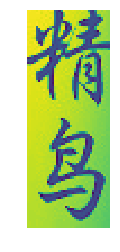

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(405.45, 165.43, 430.57, 239.49)


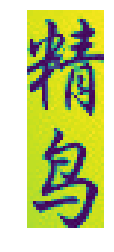

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
铭都工艺
(313.56, 107.4, 348.35, 261.06)


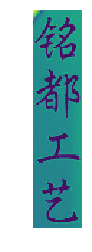

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(356.64, 51.36, 387.69, 127.36)


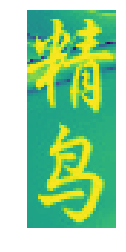

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(465.03, 75.8, 496.95, 149.67)


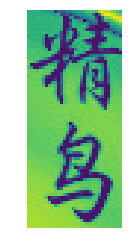

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
铭都
(241.57, 51.43, 274.49, 123.49)


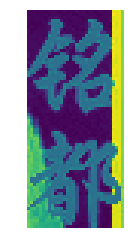

TB1.l4JkLBNTKJjy0FdXXcPpVXa_!!2-item_pic.png
精鸟
(281.97, 325.44, 312.95, 398.38)


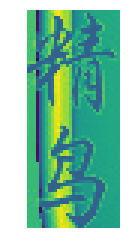

TB1.lmTiMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
双
(159.44, 38.89, 195.44, 79.44)


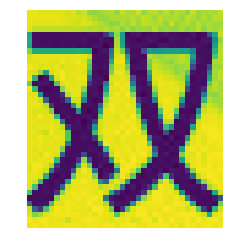

TB1.M0.dSfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
？
(612.63, 611.34, 667.63, 711.34)


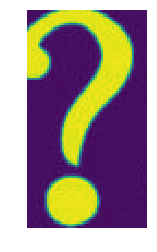

TB1.mJ_LpXXXXbBXFXXunYpLFXX
！
(774.46, 92.92, 785.31, 123.46)


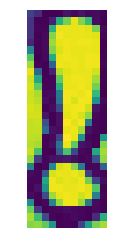

TB1.mlULpXXXXbOXXXX804ZFXXX
13.3
(672.0, 367.33, 719.33, 418.67)


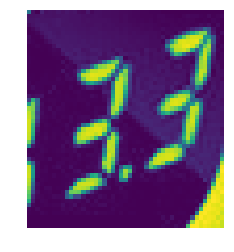

TB1.MnUm0bJ8KJjy1zjlMyqapXa
45
(374.49, 325.03, 389.78, 340.53)


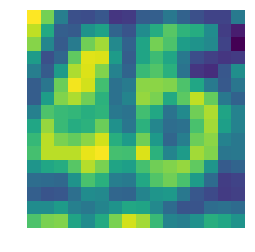

TB1.MRLLXXXXXb7XpXXunYpLFXX
企
(105.86, 208.36, 116.29, 220.78)


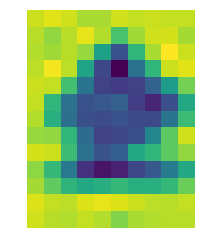

TB1.MRLLXXXXXb7XpXXunYpLFXX
业
(132.19, 209.27, 140.96, 218.5)


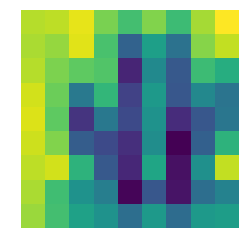

TB1.MRLLXXXXXb7XpXXunYpLFXX
期
(132.65, 228.92, 142.33, 239.97)


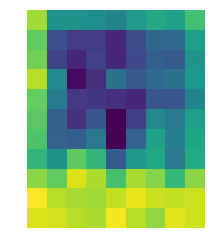

TB1.MSjbyP85uJjSZFKXXcw7FXa_!!0-item_pic.jpg
1
(295.33, 285.33, 305.67, 301.33)


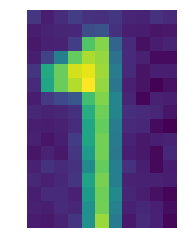

TB1.MSjbyP85uJjSZFKXXcw7FXa_!!0-item_pic.jpg
3
(361.0, 285.33, 379.0, 303.33)


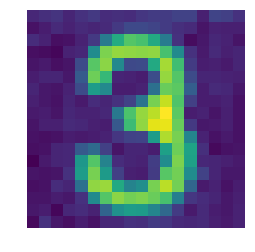

TB1.MSjbyP85uJjSZFKXXcw7FXa_!!0-item_pic.jpg
5
(433.0, 285.33, 443.0, 303.67)


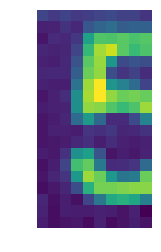

TB1.MsrGXXXXXa4XVXXXXXXXXXX_!!0-item_pic.jpg
HOT
(237.53, 551.02, 347.86, 704.68)


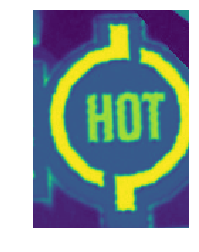

TB1.Mv_HVXXXXaHXVXXXXXXXXXX_!!0-item_pic.jpg
比例积分电动二通调节阀
(978.17, 96.11, 1045.83, 993.56)


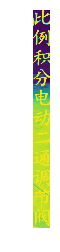

TB1.n0mLXXXXXahXFXXunYpLFXX
E
(222.64, 296.33, 237.67, 316.64)


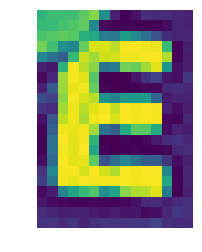

TB1.nA2RFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
?
(209.86, 25.75, 224.86, 43.41)


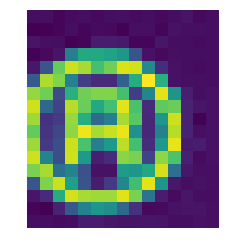

TB1.nObLpXXXXanXFXXunYpLFXX
店
(301.88, 86.68, 315.88, 103.82)


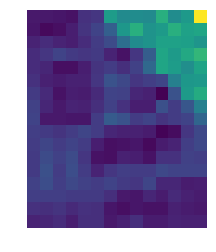

TB1.nTDRpXXXXa5aFXXXXXXXXXX_!!0-item_pic.jpg
DEL
(467.27, 364.36, 493.73, 404.18)


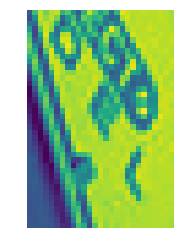

TB1.NW2KVXXXXbeaXXXXXXXXXXX_!!0-item_pic.jpg
惊爆价
(487.68, 661.63, 520.35, 753.29)


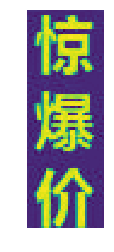

TB1.NW2KVXXXXbeaXXXXXXXXXXX_!!0-item_pic.jpg
LO
(311.68, 494.96, 324.35, 508.96)


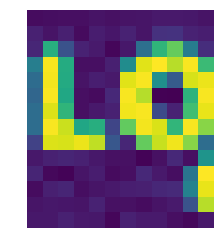

TB1.oIifbYI8KJjy0FaXXbAiVXa_!!0-item_pic.jpg
7
(176.63, 141.84, 196.63, 176.84)


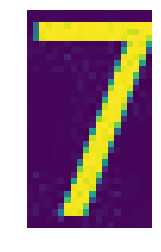

TB1.oIifbYI8KJjy0FaXXbAiVXa_!!0-item_pic.jpg
￥
(106.63, 303.84, 126.63, 331.84)


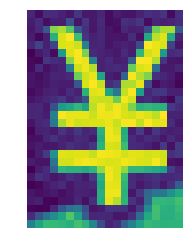

TB1.oYOSFXXXXcuXVXXXXXXXXXX_.jpg
1
(135.36, 500.75, 165.86, 562.0)


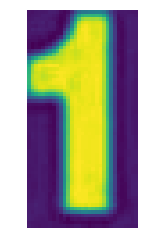

TB1.Py8bwjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
电机、致动器、步进电机
(115.05, 219.64, 146.96, 534.15)


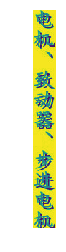

TB1.Py8bwjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
电子
(576.87, 416.75, 632.67, 485.69)


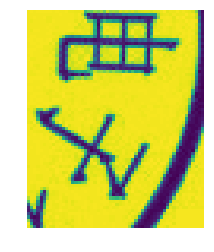

TB1.Py8bwjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
雷成
(563.73, 345.8, 624.98, 414.73)


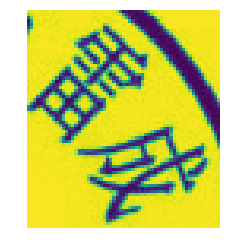

TB1.Py8bwjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
店铺
(378.42, 236.07, 475.67, 472.49)


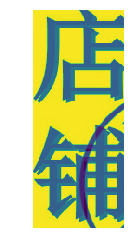

TB1.Q0hLXXXXXa8aFXXunYpLFXX
当当车贴
(386.14, 3.55, 409.95, 108.55)


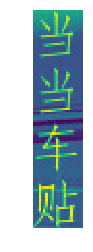

TB1.Q0hLXXXXXa8aFXXunYpLFXX
当当车贴
(383.59, 122.64, 409.5, 226.82)


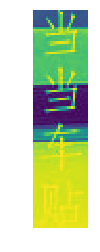

TB1.Q0hLXXXXXa8aFXXunYpLFXX
当当车贴
(386.14, 360.55, 410.95, 462.55)


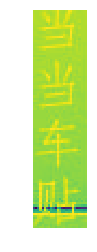

TB1.Q0hLXXXXXa8aFXXunYpLFXX
当车贴
(381.7, 266.76, 409.97, 345.12)


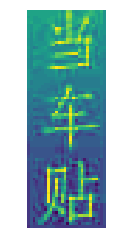

TB1.qKkk0zJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
次握笔涂
(368.06, 246.78, 427.72, 312.78)


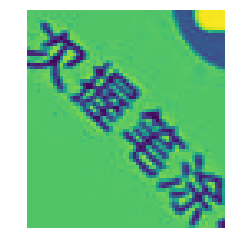

TB1.qKkk0zJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
鸦的宝贝
(421.94, 304.56, 464.39, 379.56)


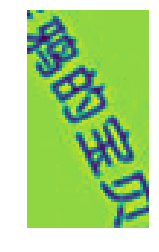

TB1.qKkk0zJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
4
(419.06, 222.33, 449.06, 261.44)


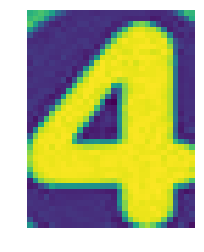

TB1.QRyLXXXXXX.XFXXunYpLFXX
特惠专享
(236.16, 600.34, 265.36, 693.74)


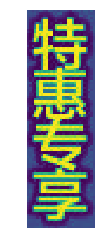

TB1.QRyLXXXXXX.XFXXunYpLFXX
S
(162.36, 521.64, 174.26, 535.94)


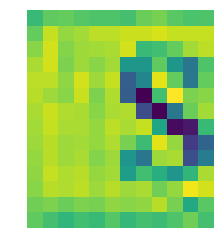

TB1.rBoLXXXXXaSapXXunYpLFXX
STORYOF
(105.44, 24.11, 135.44, 172.78)


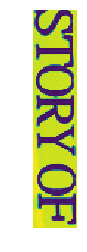

TB1.rBoLXXXXXaSapXXunYpLFXX
shanghai
(112.67, 188.44, 129.22, 312.22)


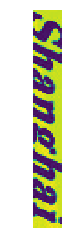

TB1.rBoLXXXXXaSapXXunYpLFXX
上海故事
(0.0, 5.67, 85.56, 322.67)


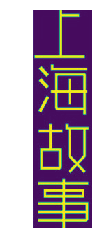

TB1.Rt4LpXXXXa8XVXXunYpLFXX
宁
(-2.56, 240.81, 29.78, 280.59)


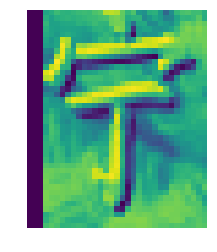

TB1.sBfj3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
幼儿园，宝妈首选
(605.38, 144.5, 667.88, 618.25)


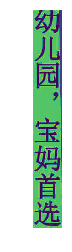

TB1.sBfj3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
全面升级四折新款
(541.88, 264.5, 597.88, 745.5)


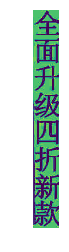

TB1.SdPLXXXXXXgXpXXunYpLFXX
南高黎
(219.84, 64.12, 330.51, 222.12)


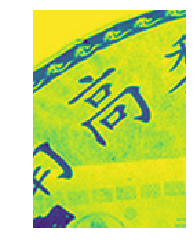

TB1.SdPLXXXXXXgXpXXunYpLFXX
普洱茶
(529.84, 100.45, 710.33, 291.45)


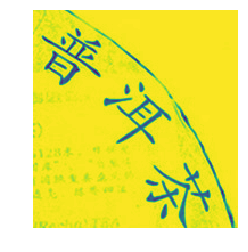

TB1.shMMpXXXXc1XpXXXXXXXXXX_!!0-item_pic.jpg
他的选择与别人不同
(237.59, 35.36, 271.41, 315.97)


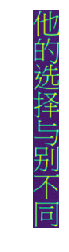

TB1.shMMpXXXXc1XpXXXXXXXXXX_!!0-item_pic.jpg
陆新之O著
(248.2, 329.93, 265.07, 411.81)


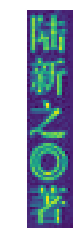

TB1.shMMpXXXXc1XpXXXXXXXXXX_!!0-item_pic.jpg
HIYOUYI
(201.41, 73.89, 222.0, 171.55)


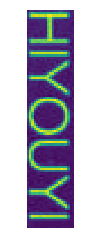

TB1.shMMpXXXXc1XpXXXXXXXXXX_!!0-item_pic.jpg
GEWANGSHI
(179.2, 76.8, 201.6, 215.69)


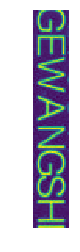

TB1.shMMpXXXXc1XpXXXXXXXXXX_!!0-item_pic.jpg
只有一个
(107.69, 27.92, 177.49, 258.04)


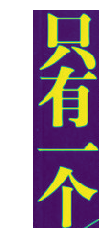

TB1.shMMpXXXXc1XpXXXXXXXXXX_!!0-item_pic.jpg
王石
(110.47, 280.71, 219.64, 508.01)


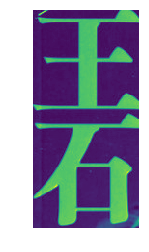

TB1.t4VLXXXXXX6XXXXunYpLFXX
6
(200.33, 111.67, 226.67, 157.0)


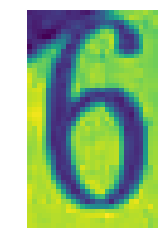

TB1.t4VLXXXXXX6XXXXunYpLFXX
斤
(228.33, 107.33, 279.33, 165.0)


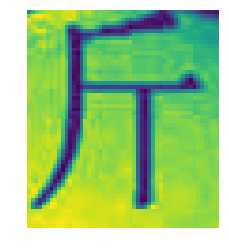

TB1.t4VLXXXXXX6XXXXunYpLFXX
卷
(327.33, 109.0, 378.33, 163.33)


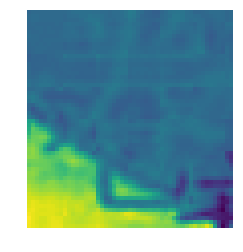

TB1.t4VLXXXXXX6XXXXunYpLFXX
9
(400.33, 145.33, 426.33, 185.0)


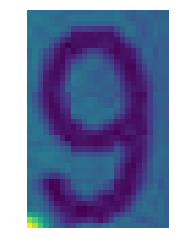

TB1.t4VLXXXXXX6XXXXunYpLFXX
6
(570.33, 145.67, 596.67, 186.67)


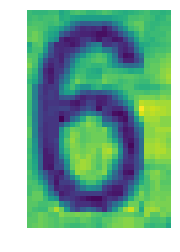

TB1.t4VLXXXXXX6XXXXunYpLFXX
6
(201.67, 256.0, 226.67, 297.67)


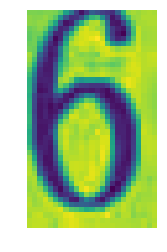

TB1.t4VLXXXXXX6XXXXunYpLFXX
斤
(222.67, 248.67, 269.0, 307.0)


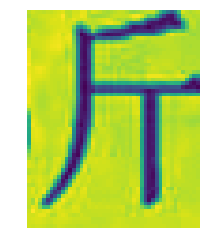

TB1.t4VLXXXXXX6XXXXunYpLFXX
卷
(330.0, 251.0, 377.33, 303.0)


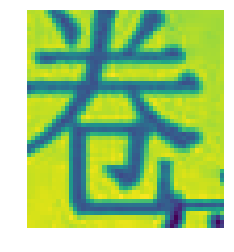

TB1.t4VLXXXXXX6XXXXunYpLFXX
7
(595.67, 293.67, 619.0, 329.33)


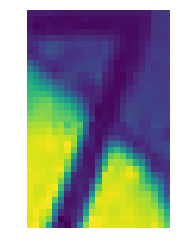

TB1.t4VLXXXXXX6XXXXunYpLFXX
12
(408.0, 437.0, 450.0, 479.33)


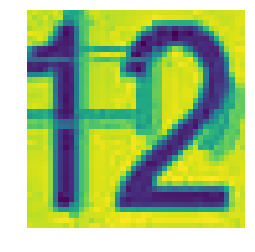

TB1.t4VLXXXXXX6XXXXunYpLFXX
9
(595.33, 441.67, 620.67, 479.0)


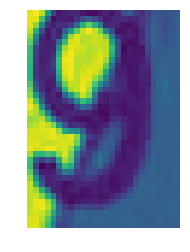

TB1.t4VLXXXXXX6XXXXunYpLFXX
6
(208.33, 400.0, 232.0, 443.67)


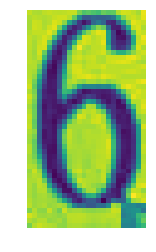

TB1.t4VLXXXXXX6XXXXunYpLFXX
斤
(238.33, 391.33, 283.33, 451.33)


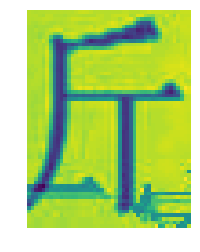

TB1.t4VLXXXXXX6XXXXunYpLFXX
卷
(337.67, 391.33, 383.33, 450.0)


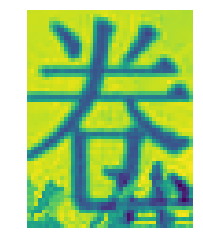

TB1.t4VLXXXXXX6XXXXunYpLFXX
6
(224.33, 552.67, 248.33, 591.67)


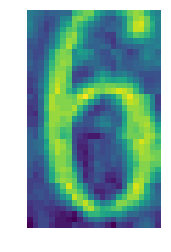

TB1.t4VLXXXXXX6XXXXunYpLFXX
斤
(255.0, 544.33, 304.0, 601.33)


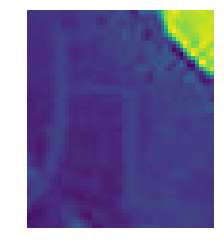

TB1.t4VLXXXXXX6XXXXunYpLFXX
卷
(352.67, 542.0, 406.67, 599.33)


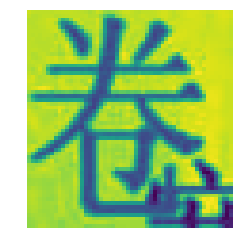

TB1.t4VLXXXXXX6XXXXunYpLFXX
6
(503.67, 696.33, 526.33, 745.67)


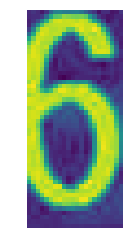

TB1.TlSLXXXXXbMXXXXunYpLFXX
￥
(64.6, 315.6, 115.0, 384.2)


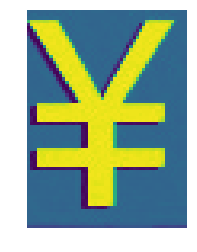

TB1.txzLXXXXXboXVXXunYpLFXX
』
(478.87, 567.54, 498.6, 588.31)


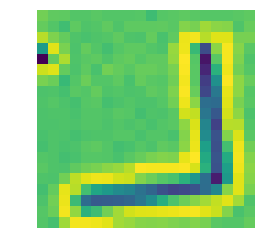

TB1.UG.HXXXXXXCaXXXXXXXXXXX_!!0-item_pic.jpg
?
(250.87, 14.67, 264.72, 29.53)


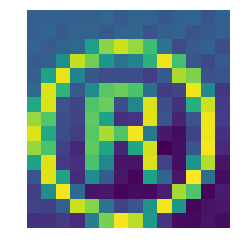

TB1.upCmL2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
社
(245.38, 215.55, 270.38, 245.18)


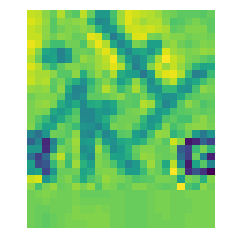

TB1.upCmL2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
金阔书社
(35.61, 39.51, 115.79, 135.6)


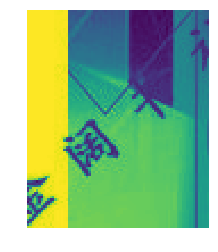

TB1.UqnLpXXXXaAXXXXunYpLFXX
A
(185.24, 203.9, 221.04, 244.7)


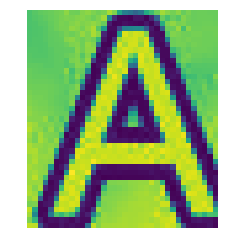

TB1.UqnLpXXXXaAXXXXunYpLFXX
B
(195.24, 609.26, 219.64, 647.46)


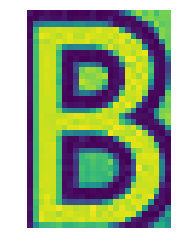

TB1.vddmInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
加配版
(300.8, 405.38, 363.94, 582.18)


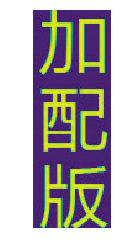

TB1.vddmInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
标准版
(651.27, 400.51, 716.8, 589.31)


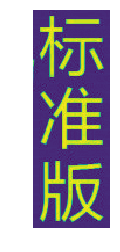

TB1.W9qOXXXXXaoXpXXXXXXXXXX_!!2-item_pic.png
RE
(302.89, 264.85, 327.85, 291.36)


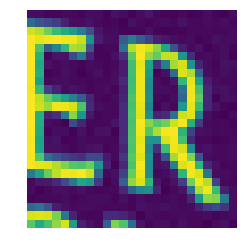

TB1.wJeLXXXXXcnXFXXunYpLFXX
HOT
(11.4, 14.87, 168.73, 173.2)


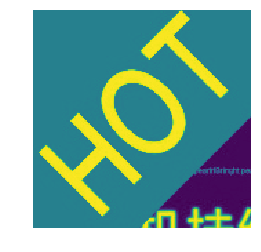

TB1.WlDLXXXXXboXFXXunYpLFXX
车载音频
(8.25, 215.38, 25.97, 355.67)


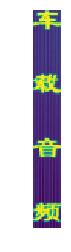

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
责
(333.0, 654.0, 404.8, 761.73)


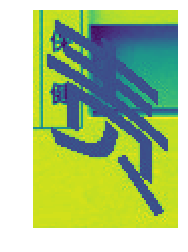

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
养生
(314.33, 662.33, 335.07, 706.53)


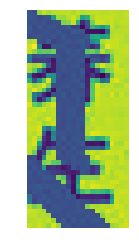

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
美体护理
(310.8, 489.6, 330.47, 636.67)


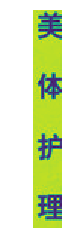

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
其他
(231.73, 629.2, 254.6, 674.0)


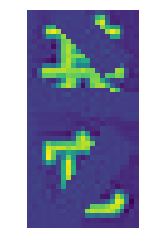

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
其他
(148.07, 570.13, 165.13, 615.4)


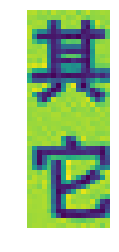

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
其他
(53.67, 528.0, 74.87, 574.33)


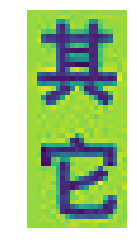

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
肤质护理
(339.0, 596.2, 352.33, 649.47)


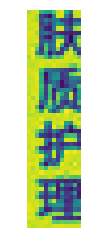

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
丰胸塑形
(339.0, 535.4, 354.4, 589.27)


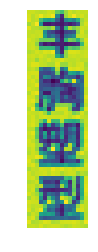

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
8
(475.53, 324.2, 489.2, 348.73)


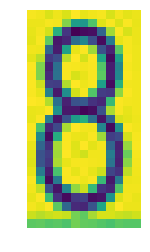

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
9
(528.8, 324.33, 540.47, 349.2)


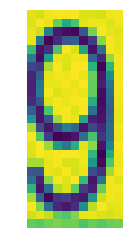

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
1
(569.27, 324.27, 579.93, 347.73)


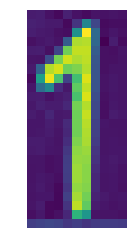

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
5
(616.93, 325.33, 631.67, 347.73)


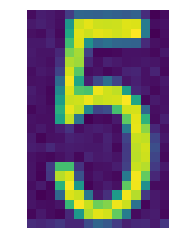

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
2
(648.4, 325.93, 663.73, 348.8)


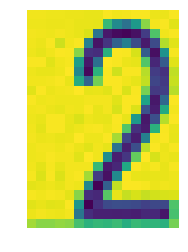

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
9
(459.4, 443.27, 471.67, 462.8)


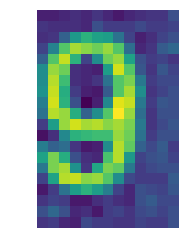

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
5
(549.67, 443.27, 568.2, 463.87)


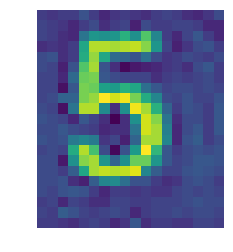

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
10
(601.8, 446.27, 619.4, 466.0)


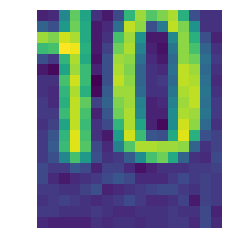

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
2
(473.93, 622.33, 489.8, 644.2)


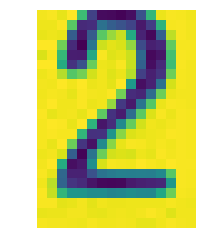

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
3
(501.67, 619.27, 522.8, 644.67)


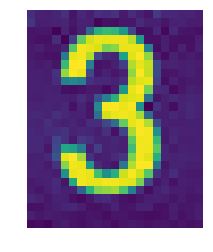

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
6
(538.93, 620.8, 553.33, 643.6)


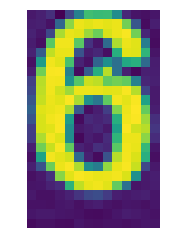

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
9
(575.2, 621.27, 592.2, 643.13)


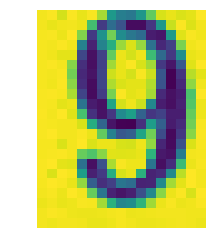

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
7
(615.73, 619.73, 632.73, 642.13)


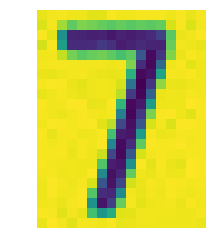

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
纤体瘦身
(339.0, 472.07, 356.4, 529.47)


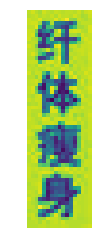

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
焗油
(245.2, 567.53, 264.87, 614.4)


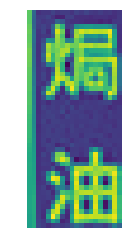

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
髪型師
(212.73, 213.8, 238.13, 360.93)


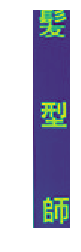

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
剪吹電髪
(243.0, 201.53, 259.6, 311.87)


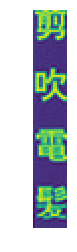

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
焗油
(242.47, 325.27, 265.2, 375.4)


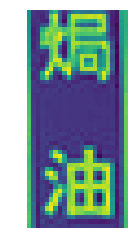

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
助
(135.67, 372.8, 151.6, 395.07)


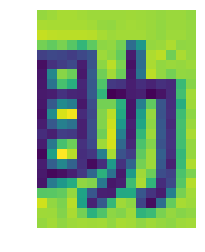

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
頭
(157.2, 403.13, 174.13, 421.8)


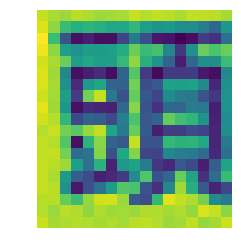

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
洗
(244.6, 402.07, 262.67, 422.8)


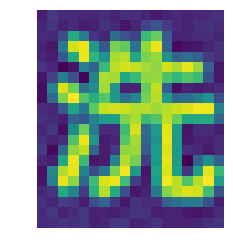

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
頭
(245.67, 457.13, 265.2, 479.93)


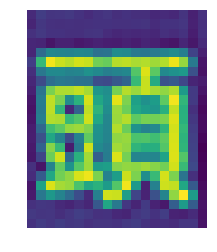

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
髪型師
(129.4, 168.4, 151.73, 308.67)


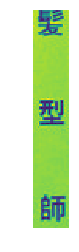

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
焗油
(156.67, 510.87, 179.87, 556.67)


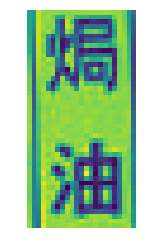

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
電
(158.2, 446.4, 177.27, 466.13)


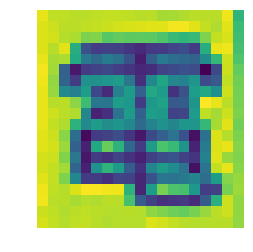

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
髪
(158.8, 475.8, 177.8, 497.6)


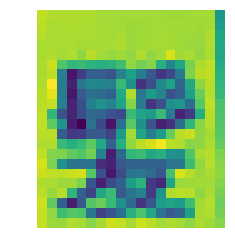

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
電
(246.2, 503.53, 263.27, 525.73)


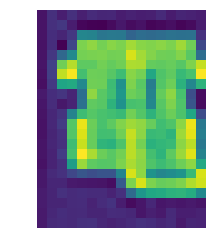

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
髪
(246.2, 535.47, 264.8, 558.8)


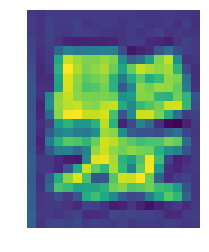

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
沐
(63.8, 117.33, 81.33, 138.07)


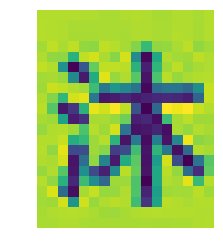

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
健
(67.4, 243.27, 83.93, 266.07)


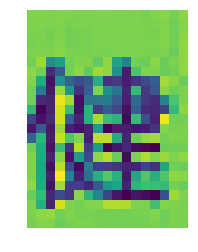

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
师
(37.67, 220.8, 61.0, 244.6)


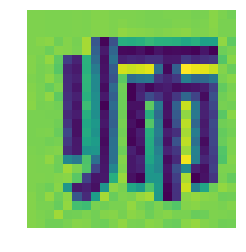

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
熏蒸
(68.07, 470.47, 89.27, 516.67)


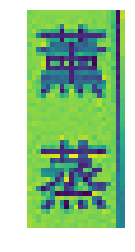

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
养生
(67.53, 409.07, 86.0, 454.27)


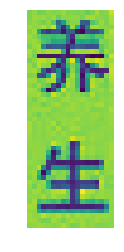

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
推拿
(65.4, 348.2, 85.6, 394.0)


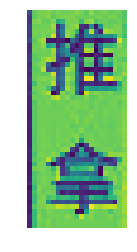

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
足疗
(64.4, 288.07, 87.07, 333.2)


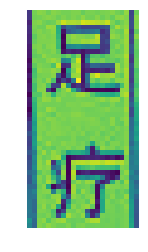

TB1.WNknx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
保
(40.8, 419.27, 63.6, 445.13)


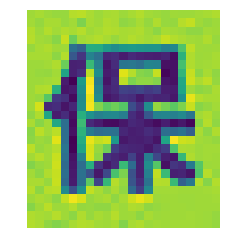

TB1.WO2XEgQMeJjy0FjXXaExFXa_!!0-item_pic.jpg
送
(525.0, 757.4, 553.6, 786.0)


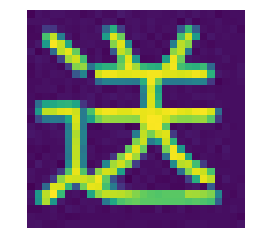

TB1.WO2XEgQMeJjy0FjXXaExFXa_!!0-item_pic.jpg
＋
(382.6, 485.6, 436.2, 548.8)


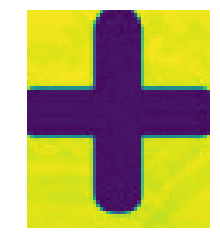

TB1.wpNLXXXXXcWXXXXunYpLFXX
TM
(189.27, 808.12, 203.94, 823.53)


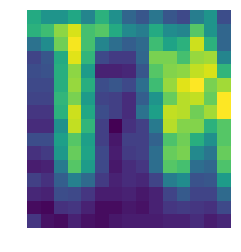

TB1.wpNLXXXXXcWXXXXunYpLFXX
T
(4.1, 428.74, 17.38, 446.79)


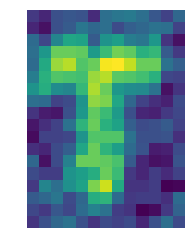

TB1.wpNLXXXXXcWXXXXunYpLFXX
T
(5.23, 721.23, 17.64, 740.03)


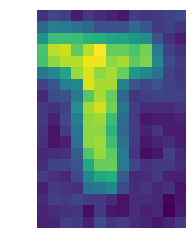

TB1.wY_Xh6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
￥
(553.11, 697.89, 580.33, 729.11)


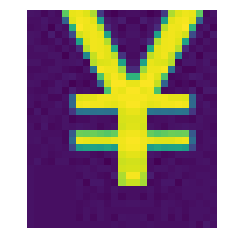

TB1.x43LpXXXXcUXVXXunYpLFXX
VORK
(174.92, 38.17, 210.42, 88.17)


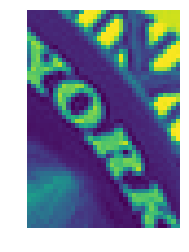

TB1.X5fLpXXXXaPXpXXunYpLFXX
?
(658.67, 664.0, 675.0, 691.33)


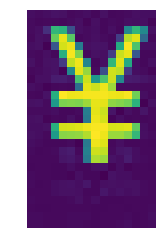

TB1.xdALXXXXXcUXFXXunYpLFXX
1
(566.67, 663.67, 574.0, 673.67)


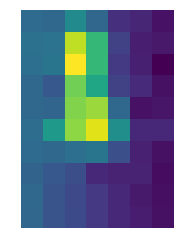

TB1.xdALXXXXXcUXFXXunYpLFXX
2
(567.0, 644.33, 573.0, 652.33)


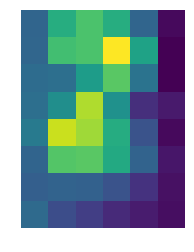

TB1.xdALXXXXXcUXFXXunYpLFXX
3
(566.33, 623.0, 573.0, 631.67)


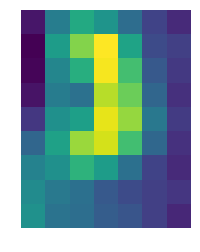

TB1.XRLLXXXXXcaXpXXunYpLFXX
运
(89.94, 154.29, 123.12, 190.36)


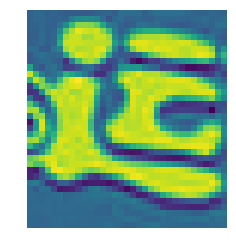

TB1.XRLLXXXXXcaXpXXunYpLFXX
智
(125.0, 155.29, 152.24, 186.73)


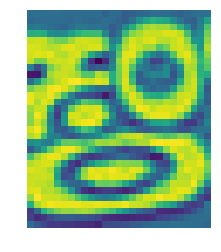

TB1.yBzLXXXXXarXVXXunYpLFXX
。
(408.23, 348.41, 412.81, 356.05)


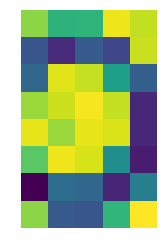

TB1.yBzLXXXXXarXVXXunYpLFXX
LO
(435.44, 257.32, 444.73, 280.22)


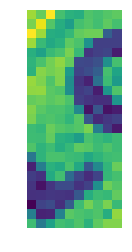

TB1.yBzLXXXXXarXVXXunYpLFXX
CK
(444.0, 232.69, 462.85, 259.18)


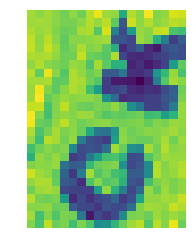

TB1.yBzLXXXXXarXVXXunYpLFXX
GM
(330.28, 206.54, 340.57, 225.93)


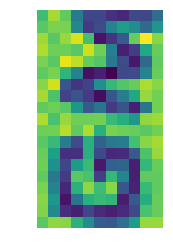

TB1.yBzLXXXXXarXVXXunYpLFXX
Direction
(335.2, 167.24, 369.46, 202.03)


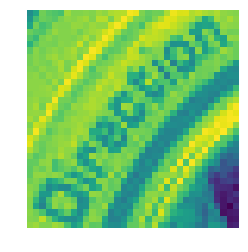

TB1.yBzLXXXXXarXVXXunYpLFXX
GM
(234.35, 184.5, 251.02, 203.88)


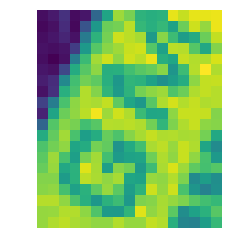

TB1.yBzLXXXXXarXVXXunYpLFXX
ACC
(128.79, 248.29, 161.12, 281.16)


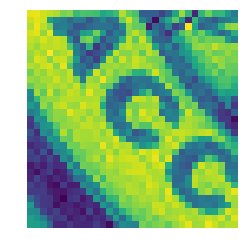

TB1.yBzLXXXXXarXVXXunYpLFXX
ACC
(31.53, 251.15, 64.72, 284.55)


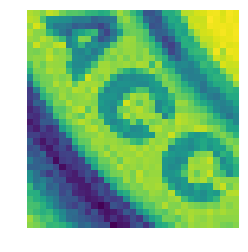

TB1.yBzLXXXXXarXVXXunYpLFXX
fo
(123.82, 166.5, 132.05, 175.74)


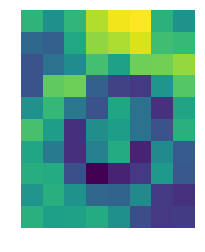

TB1.yImffjM8KJjSZFsXXXdZpXa_!!0-item_pic.jpg
?
(736.94, 592.13, 749.06, 609.13)


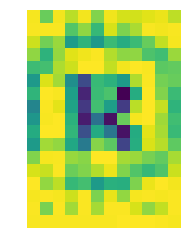

TB1.YLnlcbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
T
(471.55, 51.34, 531.01, 141.34)


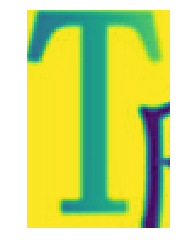

TB1.YLnlcbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
P
(597.91, 47.61, 658.01, 140.16)


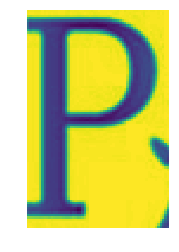

TB1.YLnlcbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
爆
(641.46, 76.79, 723.91, 164.7)


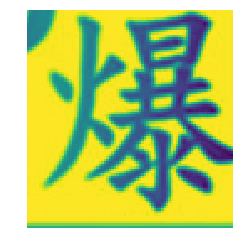

TB1.YLnlcbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
U
(718.01, 51.61, 788.28, 141.16)


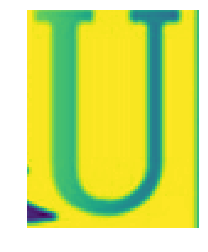

TB1.YLnlcbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
送
(473.19, 614.34, 610.28, 769.07)


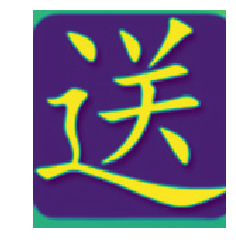

TB1.ymbfhk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
中医
(225.92, 37.85, 250.17, 97.25)


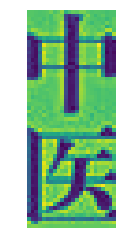

TB1.ymbfhk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
南京中医药大学
(112.57, 156.8, 120.57, 210.65)


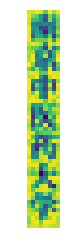

TB1.ymbfhk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
华浩明
(102.67, 157.85, 109.02, 180.55)


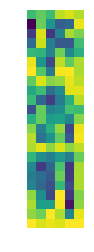

TB1.ymbfhk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
主编
(101.32, 187.9, 109.67, 201.9)


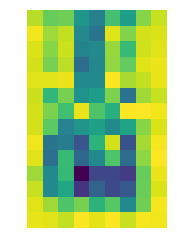

TB1.ymbfhk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
处方手册
(128.32, 173.85, 161.42, 291.05)


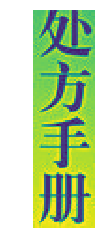

TB1.yNhaTnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
32
(87.96, 225.17, 100.04, 239.58)


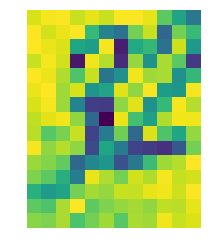

TB1.yR.LpXXXXbFXFXXunYpLFXX
Z
(816.47, 388.53, 859.29, 451.76)


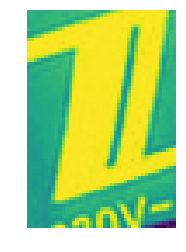

TB1.Z0PLXXXXXXdXpXXunYpLFXX
lle
(400.28, 316.86, 421.15, 338.65)


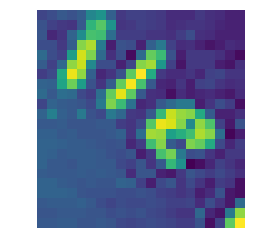

TB1.Z0PLXXXXXXdXpXXunYpLFXX
HOT
(46.08, 14.46, 96.36, 113.41)


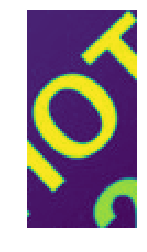

TB1.Z0PLXXXXXXdXpXXunYpLFXX
1212大促
(33.45, 4.45, 170.36, 201.73)


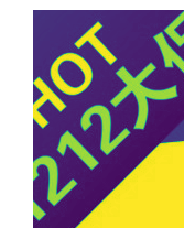

TB1.Z0PLXXXXXXdXpXXunYpLFXX
UP!
(286.09, 527.55, 312.27, 554.73)


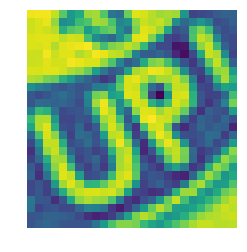

TB1.zh.QpXXXXcZaXXXXXXXXXXX_!!0-item_pic.jpg
CE
(374.6, 461.6, 401.0, 492.2)


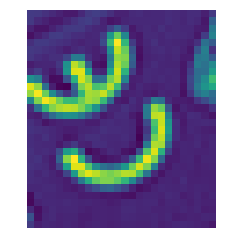

TB1.zh.QpXXXXcZaXXXXXXXXXXX_!!0-item_pic.jpg
N
(451.6, 529.6, 462.2, 541.8)


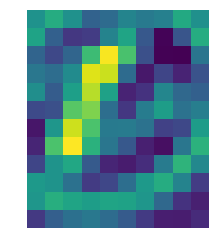

TB1.zRULpXXXXXmapXXunYpLFXX
送
(587.73, 554.5, 672.06, 651.5)


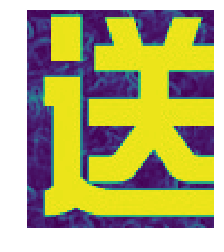

TB1.zRULpXXXXXmapXXunYpLFXX
ZONe
(162.6, 578.15, 206.04, 622.04)


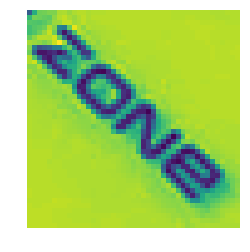

TB1.zRULpXXXXXmapXXunYpLFXX
4G
(460.93, 315.15, 486.82, 341.04)


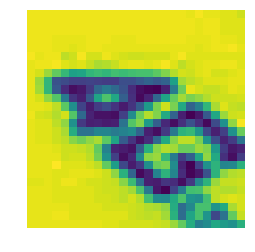

TB10.KXIVXXXXaCXXXXXXXXXXXX_!!0-item_pic.jpg
150
(70.56, 343.44, 92.92, 397.19)


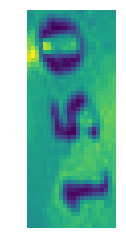

TB10.KXIVXXXXaCXXXXXXXXXXXX_!!0-item_pic.jpg
150
(73.46, 441.19, 78.77, 497.3)


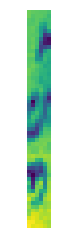

TB10.KXIVXXXXaCXXXXXXXXXXXX_!!0-item_pic.jpg
150
(205.42, 274.19, 233.06, 333.69)


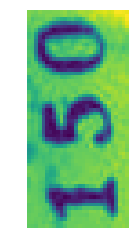

TB10.KXIVXXXXaCXXXXXXXXXXXX_!!0-item_pic.jpg
150
(264.06, 164.19, 289.31, 222.19)


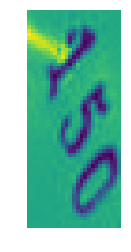

TB10.KXIVXXXXaCXXXXXXXXXXXX_!!0-item_pic.jpg
150
(570.31, 102.19, 609.06, 155.33)


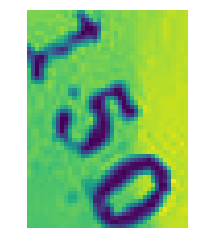

TB10.KXIVXXXXaCXXXXXXXXXXXX_!!0-item_pic.jpg
150
(703.31, 317.19, 741.56, 366.44)


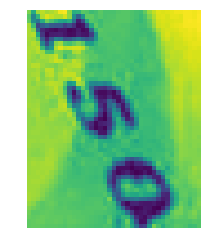

TB101PMfgnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
.cn
(9.9, 475.3, 39.4, 506.8)


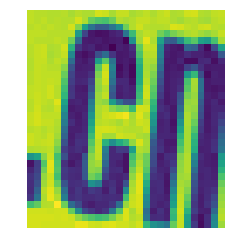

TB101PMfgnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
家
(-0.1, 404.3, 40.9, 477.3)


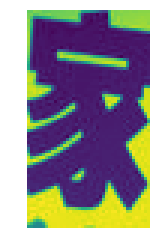

TB101V.LpXXXXcaXFXXunYpLFXX
R
(134.04, 7.0, 143.04, 16.33)


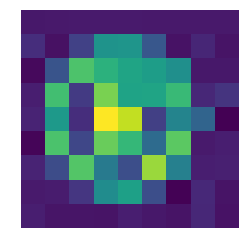

TB101V.LpXXXXcaXFXXunYpLFXX
送
(88.31, 178.67, 102.69, 194.11)


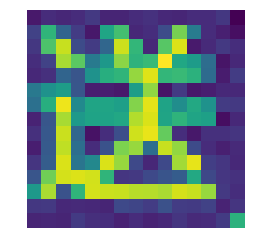

TB1020QLpXXXXbNapXXunYpLFXX
！
(138.22, 300.44, 149.0, 332.56)


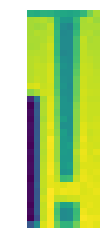

TB103buJFXXXXcNXXXXXXXXXXXX_!!0-item_pic.jpg
件长
(209.52, 147.68, 228.97, 185.39)


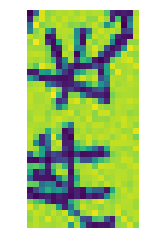

TB103buJFXXXXcNXXXXXXXXXXXX_!!0-item_pic.jpg
全新
(289.95, 160.81, 305.32, 194.79)


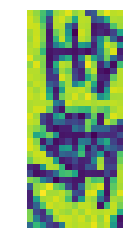

TB104CaMpXXXXXBXFXXXXXXXXXX_!!0-item_pic.jpg
谢
(387.24, 429.68, 395.74, 438.6)


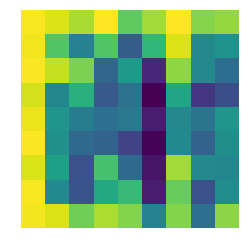

TB105dILXXXXXXJXFXXunYpLFXX
￥
(477.0, 591.47, 495.88, 617.82)


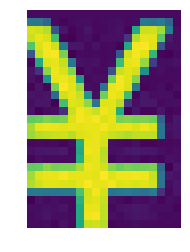

TB105KpLpXXXXXoXXXXunYpLFXX
E
(35.73, 171.44, 61.67, 201.54)


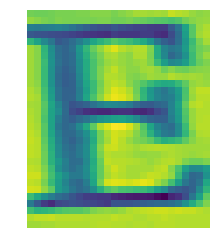

TB105KpLpXXXXXoXXXXunYpLFXX
R
(100.87, 171.86, 125.22, 201.03)


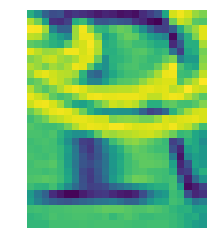

TB105KpLpXXXXXoXXXXunYpLFXX
B
(231.59, 166.49, 239.39, 188.86)


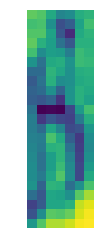

TB105KpLpXXXXXoXXXXunYpLFXX
er
(118.9, 84.16, 145.1, 112.39)


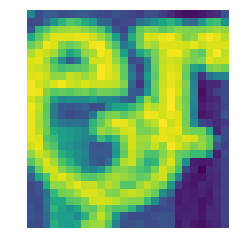

TB10995etHO8KJjSZFtXXchfXXa_!!0-item_pic.jpg
礼
(324.63, 40.58, 347.54, 71.67)


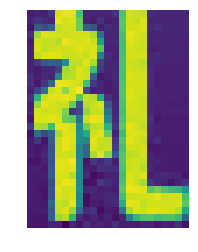

TB10995etHO8KJjSZFtXXchfXXa_!!0-item_pic.jpg
真
(426.96, 4.42, 455.96, 39.08)


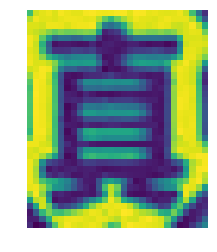

TB10995etHO8KJjSZFtXXchfXXa_!!0-item_pic.jpg
秋
(22.63, 373.83, 63.79, 415.33)


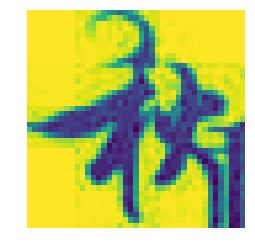

TB109tDLXXXXXb7XFXXunYpLFXX
C
(459.9, 1068.6, 474.3, 1092.0)


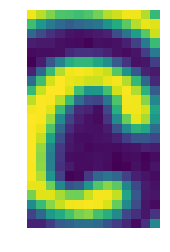

TB109tDLXXXXXb7XFXXunYpLFXX
N
(488.9, 1079.8, 508.3, 1106.6)


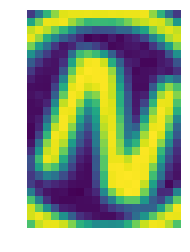

TB109tDLXXXXXb7XFXXunYpLFXX
A
(520.9, 1094.4, 543.5, 1120.6)


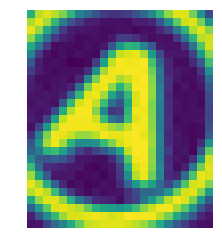

TB109tDLXXXXXb7XFXXunYpLFXX
S
(558.5, 1106.0, 575.7, 1131.8)


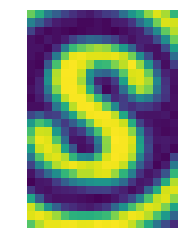

TB109tDLXXXXXb7XFXXunYpLFXX
！
(623.1, 1195.6, 646.5, 1232.6)


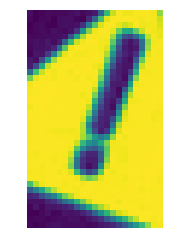

TB109tDLXXXXXb7XFXXunYpLFXX
CL:6933032800369
(369.3, 910.0, 423.9, 1109.2)


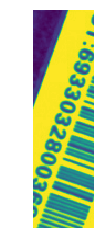

TB109tDLXXXXXb7XFXXunYpLFXX
免邮
(-3.0, 588.0, 97.0, 710.0)


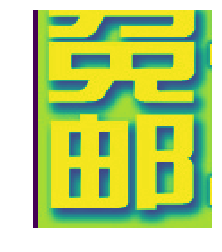

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
3
(304.5, 311.0, 330.5, 362.0)


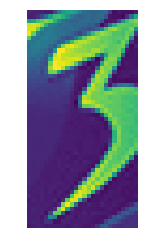

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
快
(268.5, 315.0, 298.5, 360.0)


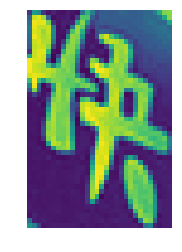

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(395.5, 366.0, 463.5, 448.0)


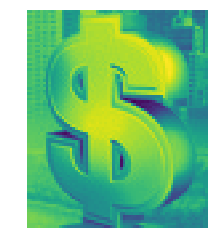

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(5.5, 326.0, 27.5, 365.0)


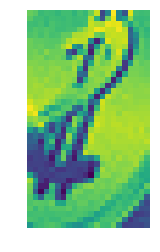

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(61.5, 326.0, 69.5, 345.0)


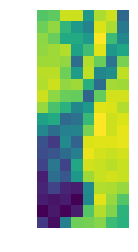

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
￥
(218.31, 375.31, 251.0, 430.15)


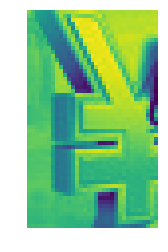

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(8.54, 288.69, 167.85, 489.23)


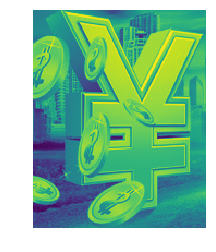

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(0.69, 513.23, 15.62, 549.38)


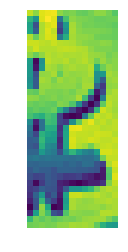

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(507.54, 505.0, 521.38, 523.0)


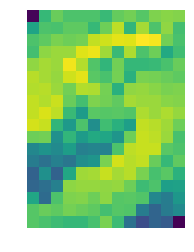

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(555.38, 344.85, 575.38, 382.23)


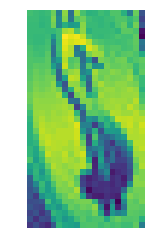

TB10BEikS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
$
(559.23, 273.77, 571.15, 296.85)


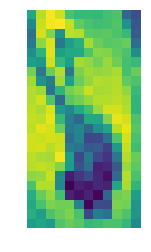

TB10BMLn8HH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
送
(49.67, 694.0, 144.22, 795.44)


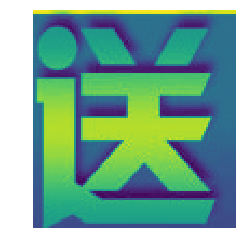

TB10cRsLXXXXXcDaXXXunYpLFXX
亲
(199.88, 498.6, 307.64, 635.25)


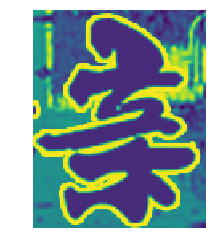

TB10cRsLXXXXXcDaXXXunYpLFXX
父
(101.63, 460.85, 201.63, 577.75)


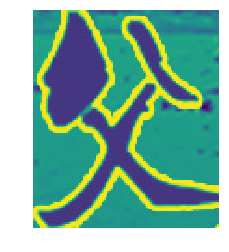

TB10cRsLXXXXXcDaXXXunYpLFXX
岭
(151.39, 105.35, 195.89, 162.35)


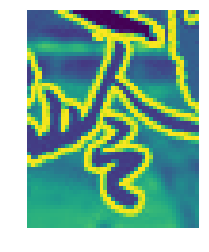

TB10cxXnPnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
6
(466.0, 543.0, 499.67, 577.0)


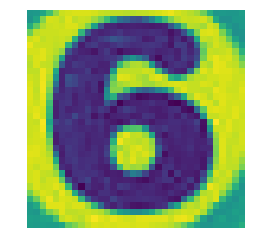

TB10cxXnPnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
幼
(38.33, 226.0, 142.33, 336.67)


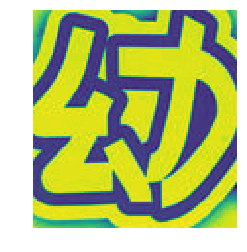

TB10dFMLXXXXXa0XpXXunYpLFXX
LOCK
(300.73, 328.27, 323.09, 391.36)


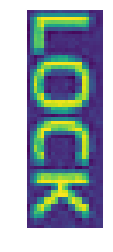

TB10dFMLXXXXXa0XpXXunYpLFXX
8
(365.82, 473.18, 425.91, 540.73)


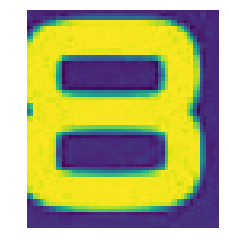

TB10f6zajgy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
5
(368.0, 474.33, 429.67, 538.0)


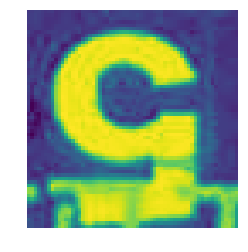

TB10f6zajgy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
3
(189.33, 629.0, 243.67, 694.33)


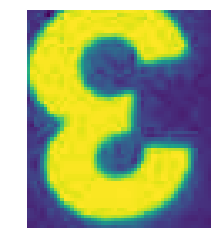

TB10f6zajgy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
1
(581.33, 590.0, 644.67, 656.0)


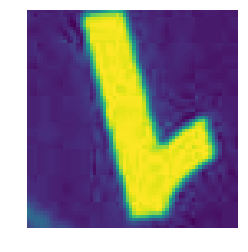

TB10FA7FFXXXXc0XVXXXXXXXXXX_!!0-item_pic.jpg
正品包邮
(3.58, 142.0, 134.75, 604.5)


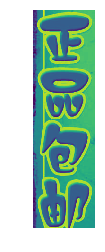

TB10FA7FFXXXXc0XVXXXXXXXXXX_!!0-item_pic.jpg
厂家直销
(613.25, 153.67, 735.58, 618.33)


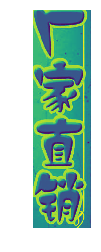

TB10FA7FFXXXXc0XVXXXXXXXXXX_!!0-item_pic.jpg
●
(525.25, 255.67, 537.75, 271.17)


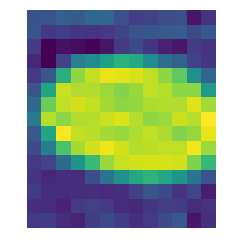

TB10gdRkNTI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
￥
(83.25, 481.5, 94.25, 497.0)


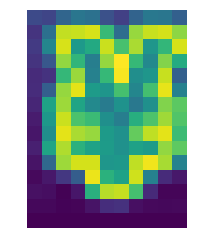

TB10gdRkNTI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
n
(428.25, 440.0, 466.25, 482.0)


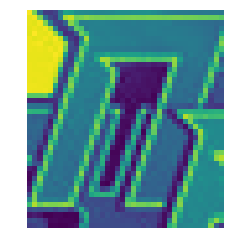

TB10gdRkNTI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
p
(447.25, 454.5, 492.25, 500.5)


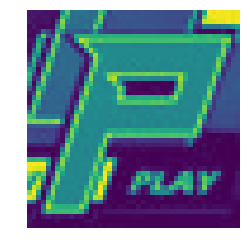

TB10glCLXXXXXXaXVXXunYpLFXX
正品包邮
(93.83, 187.33, 138.5, 357.78)


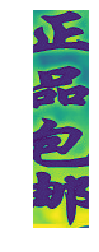

TB10glCLXXXXXXaXVXXunYpLFXX
买一送十五
(21.61, 10.0, 79.83, 351.0)


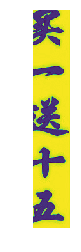

TB10glCLXXXXXXaXVXXunYpLFXX
学步带
(411.83, 9.11, 450.28, 161.78)


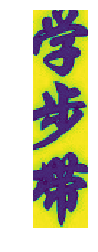

TB10glCLXXXXXXaXVXXunYpLFXX
妈咪包
(460.83, 4.44, 494.06, 158.67)


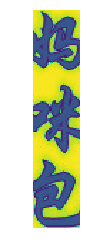

TB10glCLXXXXXXaXVXXunYpLFXX
洗发帽
(408.94, 180.67, 446.61, 335.67)


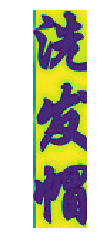

TB10glCLXXXXXXaXVXXunYpLFXX
玩具礼包
(458.61, 180.56, 500.5, 332.89)


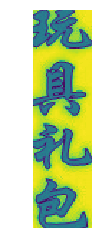

TB10glCLXXXXXXaXVXXunYpLFXX
+
(330.5, 21.0, 347.83, 48.89)


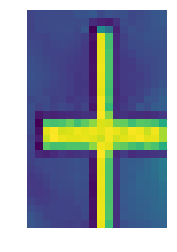

TB10glCLXXXXXXaXVXXunYpLFXX
靠
(354.94, 5.67, 379.94, 55.0)


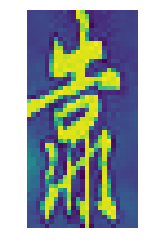

TB10glCLXXXXXXaXVXXunYpLFXX
背
(389.72, 7.78, 409.5, 58.11)


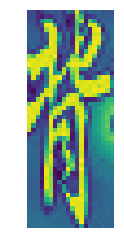

TB10GpULXXXXXaMXXXXunYpLFXX
DAVIER
(611.0, 591.56, 635.33, 735.56)


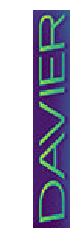

TB10GpULXXXXXaMXXXXunYpLFXX
R
(456.33, 373.56, 509.67, 431.56)


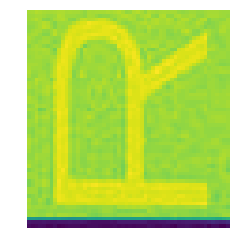

TB10hnYlmYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
11
(226.92, 109.17, 260.17, 146.92)


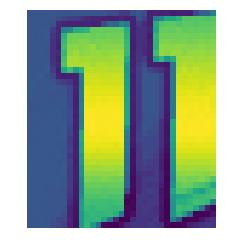

TB10hnYlmYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
选
(264.17, 99.67, 313.17, 159.17)


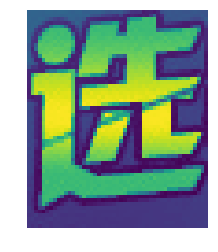

TB10hnYlmYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
5
(309.17, 99.92, 337.17, 142.92)


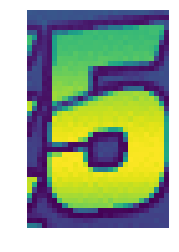

TB10hnYlmYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
5
(423.92, 103.67, 449.67, 145.17)


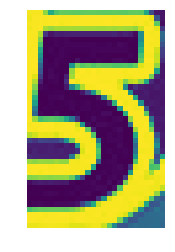

TB10ihyLXXXXXbjXVXXunYpLFXX
6+6
(198.38, 205.37, 240.79, 255.13)


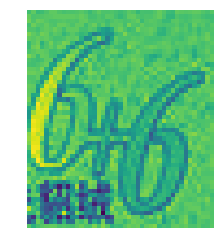

TB10ihyLXXXXXbjXVXXunYpLFXX
6+6
(318.04, 22.91, 392.8, 116.45)


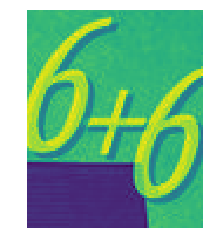

TB10io.JVXXXXXzXXXXXXXXXXXX_!!0-item_pic.jpg
四合一调焦
(20.58, 56.17, 78.42, 363.17)


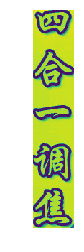

TB10ISMnIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
智祥书社
(231.89, 55.97, 300.39, 125.22)


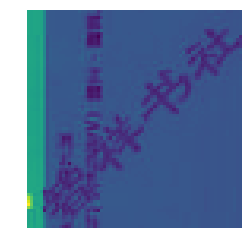

TB10iUSgNrI8KJjy0FpXXb5hVXa_!!0-item_pic.jpg
88
(560.99, 450.8, 575.72, 471.04)


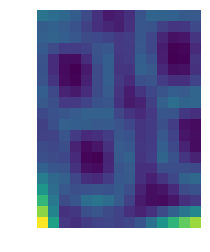

TB10iUSgNrI8KJjy0FpXXb5hVXa_!!0-item_pic.jpg
8
(621.23, 408.13, 634.94, 426.86)


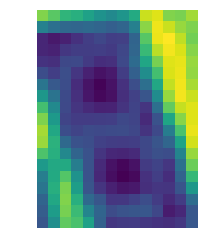

TB10iUSgNrI8KJjy0FpXXb5hVXa_!!0-item_pic.jpg
88
(550.78, 419.84, 567.51, 439.58)


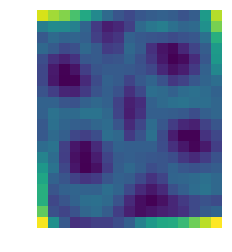

TB10iUSgNrI8KJjy0FpXXb5hVXa_!!0-item_pic.jpg
赏
(198.71, 220.72, 217.28, 239.96)


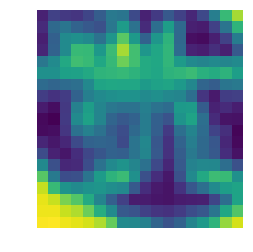

TB10jflKpXXXXa8XFXXXXXXXXXX_!!0-item_pic.jpg
彩
(197.82, 209.96, 296.63, 311.2)


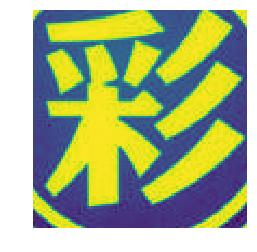

TB10jflKpXXXXa8XFXXXXXXXXXX_!!0-item_pic.jpg
选
(230.84, 364.36, 266.74, 407.43)


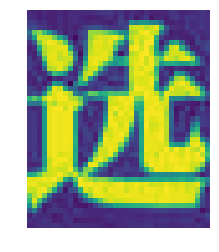

TB10jflKpXXXXa8XFXXXXXXXXXX_!!0-item_pic.jpg
R
(267.02, 355.9, 313.8, 411.6)


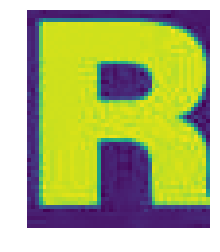

TB10jlFLXXXXXaBXFXXunYpLFXX
长春润华汽车
(1409.2, 61.62, 1497.2, 579.98)


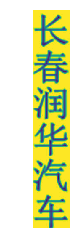

TB10jlFLXXXXXaBXFXXunYpLFXX
https://car-vw.taobao.com
(1414.02, 638.11, 1468.74, 1737.11)


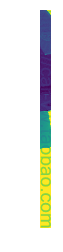

TB10jlFLXXXXXaBXFXXunYpLFXX
长春润华汽车
(434.74, 74.27, 502.65, 582.55)


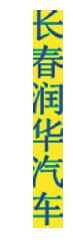

TB10jlFLXXXXXaBXFXXunYpLFXX
https://car-vw.taobao.com
(431.93, 637.95, 490.29, 1733.68)


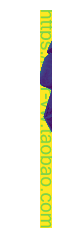

TB10KxLLXXXXXaUXpXXunYpLFXX
STARCOM
(122.7, 622.14, 173.2, 673.95)


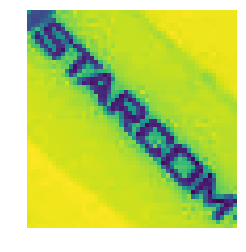

TB10KxLLXXXXXaUXpXXunYpLFXX
UT
(111.43, 602.41, 130.25, 626.55)


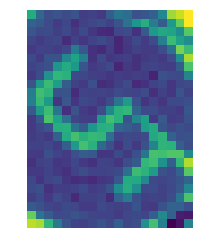

TB10KxLLXXXXXaUXpXXunYpLFXX
点播
(243.02, 537.91, 260.16, 556.73)


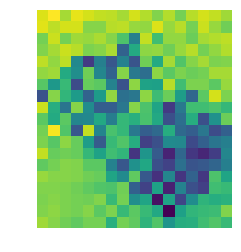

TB10KxLLXXXXXaUXpXXunYpLFXX
F4
(303.02, 540.36, 319.39, 558.09)


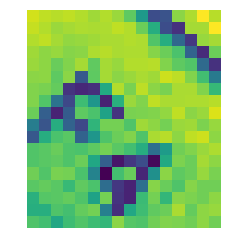

TB10KxLLXXXXXaUXpXXunYpLFXX
F3
(269.98, 513.41, 283.98, 529.77)


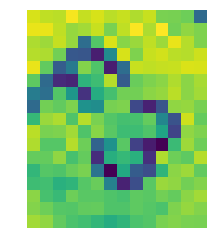

TB10KxLLXXXXXaUXpXXunYpLFXX
F2
(237.25, 481.36, 251.57, 499.09)


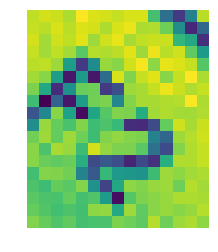

TB10KxLLXXXXXaUXpXXunYpLFXX
声道
(253.61, 454.45, 273.11, 481.32)


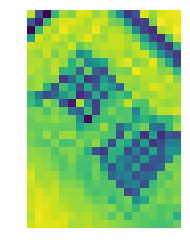

TB10KxLLXXXXXaUXpXXunYpLFXX
定位
(286.66, 486.5, 307.84, 510.0)


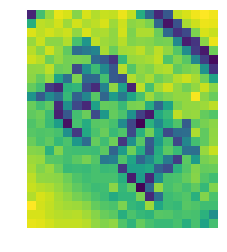

TB10KxLLXXXXXaUXpXXunYpLFXX
+
(376.7, 440.82, 394.11, 463.59)


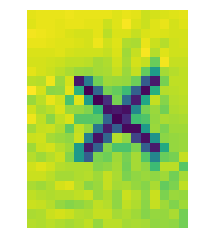

TB10KxLLXXXXXaUXpXXunYpLFXX
+
(293.52, 366.45, 309.25, 384.18)


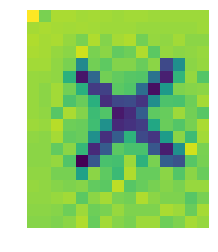

TB10KxLLXXXXXaUXpXXunYpLFXX
删除
(442.52, 389.68, 467.07, 418.59)


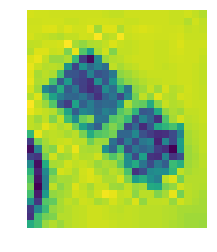

TB10KxLLXXXXXaUXpXXunYpLFXX
OK
(404.66, 322.18, 429.2, 347.73)


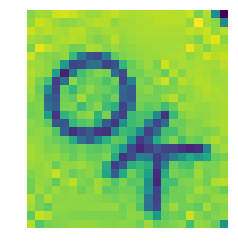

TB10KxLLXXXXXaUXpXXunYpLFXX
收藏
(486.8, 322.18, 514.39, 350.41)


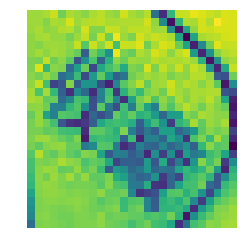

TB10KxLLXXXXXaUXpXXunYpLFXX
#
(516.16, 303.41, 527.02, 316.0)


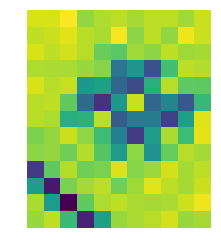

TB10KxLLXXXXXaUXpXXunYpLFXX
0
(478.61, 254.32, 492.93, 268.95)


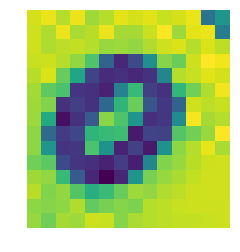

TB10KxLLXXXXXaUXpXXunYpLFXX
WXYZ
(537.89, 266.59, 563.84, 292.82)


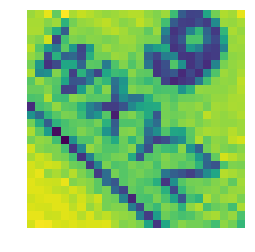

TB10KxLLXXXXXaUXpXXunYpLFXX
MNO
(567.61, 238.64, 587.39, 259.41)


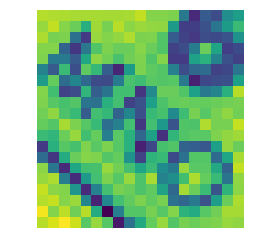

TB10KxLLXXXXXaUXpXXunYpLFXX
JKL
(525.34, 200.77, 541.7, 217.82)


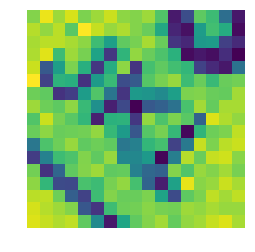

TB10KxLLXXXXXaUXpXXunYpLFXX
.
(510.02, 133.64, 521.25, 145.55)


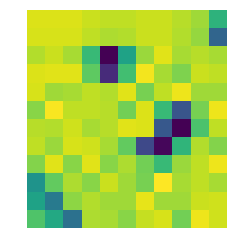

TB10KxLLXXXXXaUXpXXunYpLFXX
TV/AV
(531.73, 88.06, 563.57, 122.0)


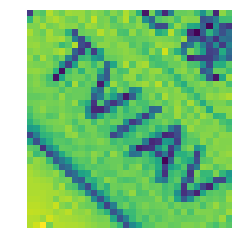

TB10KxLLXXXXXaUXpXXunYpLFXX
1
(523.3, 127.14, 524.98, 140.77)


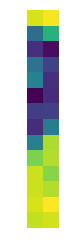

TB10KxLLXXXXXaUXpXXunYpLFXX
2
(566.93, 166.68, 567.61, 179.32)


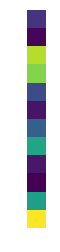

TB10KxLLXXXXXaUXpXXunYpLFXX
3
(613.3, 205.23, 613.98, 217.5)


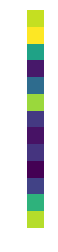

TB10KxLLXXXXXaUXpXXunYpLFXX
4
(493.66, 156.14, 499.75, 166.36)


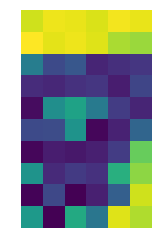

TB10KxLLXXXXXaUXpXXunYpLFXX
5
(537.98, 195.32, 543.39, 208.64)


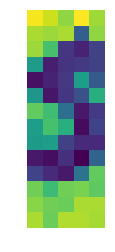

TB10KxLLXXXXXaUXpXXunYpLFXX
6
(583.3, 233.86, 586.7, 249.18)


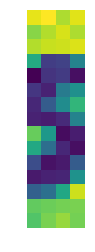

TB10KxLLXXXXXaUXpXXunYpLFXX
9
(557.39, 265.91, 557.7, 278.18)


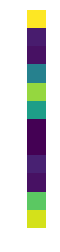

TB10KxLLXXXXXaUXpXXunYpLFXX
7
(468.75, 183.41, 470.43, 198.73)


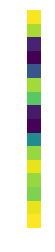

TB10KxLLXXXXXaUXpXXunYpLFXX
8
(511.02, 225.32, 514.75, 240.0)


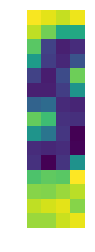

TB10lNmJVXXXXbrXXXXXXXXXXXX_!!2-item_pic.png
电
(258.31, 26.79, 275.11, 46.39)


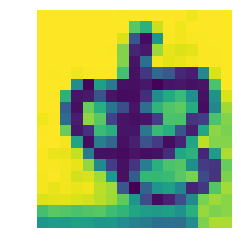

TB10lNmJVXXXXbrXXXXXXXXXXXX_!!2-item_pic.png
子
(286.1, 29.96, 300.74, 45.39)


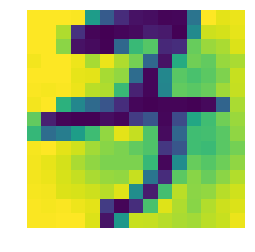

TB10lNmJVXXXXbrXXXXXXXXXXXX_!!2-item_pic.png
商
(309.92, 28.43, 326.44, 47.47)


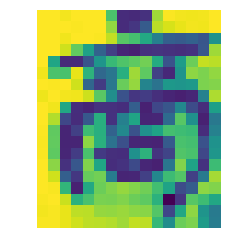

TB10lNmJVXXXXbrXXXXXXXXXXXX_!!2-item_pic.png
行
(337.19, 29.96, 351.43, 45.39)


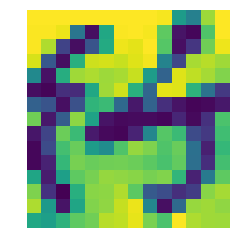

TB10MJMLXXXXXbMXpXXunYpLFXX
?
(557.21, 267.3, 569.6, 284.53)


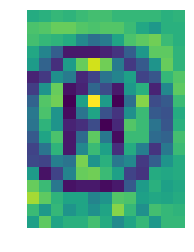

TB10MJMLXXXXXbMXpXXunYpLFXX
植
(366.68, 587.62, 390.92, 614.85)


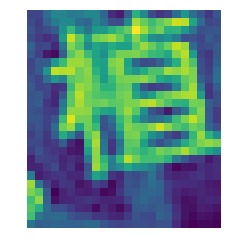

TB10MJMLXXXXXbMXpXXunYpLFXX
物
(400.54, 583.08, 410.38, 612.16)


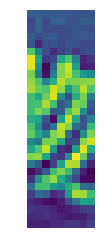

TB10MJMLXXXXXbMXpXXunYpLFXX
环境
(589.97, 599.16, 613.51, 638.24)


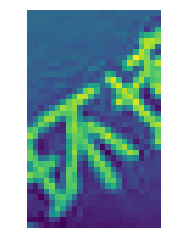

TB10MJMLXXXXXbMXpXXunYpLFXX
棉质
(716.08, 511.98, 746.39, 555.61)


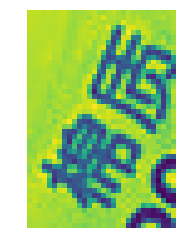

TB10MJMLXXXXXbMXpXXunYpLFXX
290MM
(742.62, 512.98, 755.47, 580.15)


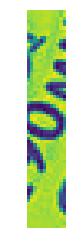

TB10MJMLXXXXXbMXpXXunYpLFXX
品?质
(230.42, 144.47, 264.81, 180.48)


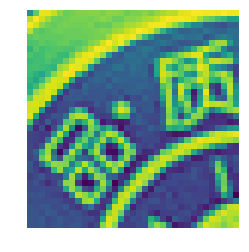

TB10MJMLXXXXXbMXpXXunYpLFXX
承?诺
(266.5, 147.32, 303.74, 185.4)


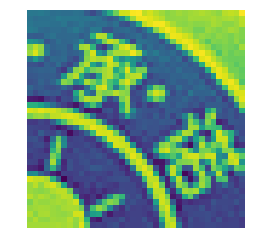

TB10MJMLXXXXXbMXpXXunYpLFXX
不含
(226.18, 203.87, 258.35, 236.34)


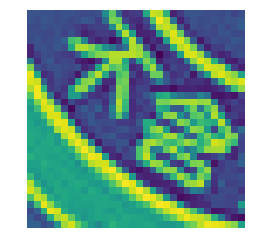

TB10MJMLXXXXXbMXpXXunYpLFXX
剂
(285.97, 206.41, 292.74, 227.03)


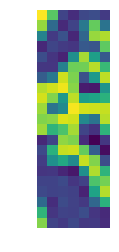

TB10mtxLXXXXXbEXVXXunYpLFXX
顺
(251.07, 260.33, 301.53, 311.27)


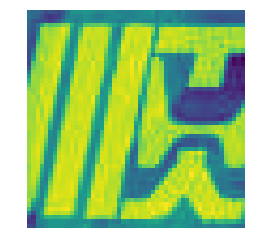

TB10odwLXXXXXcrXVXXunYpLFXX
11
(156.67, 138.89, 248.33, 260.89)


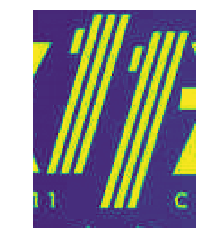

TB10oxuLXXXXXamaXXXunYpLFXX
石
(159.33, 81.0, 178.0, 102.67)


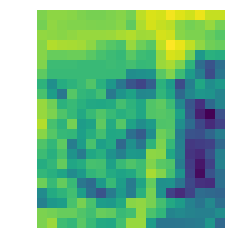

TB10oxuLXXXXXamaXXXunYpLFXX
北
(169.0, 121.0, 203.67, 156.0)


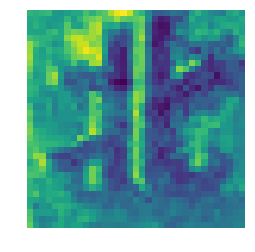

TB10oxuLXXXXXamaXXXunYpLFXX
大
(212.67, 120.0, 243.67, 153.0)


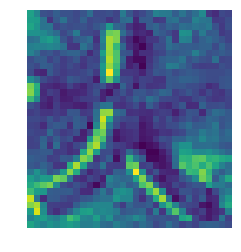

TB10oxuLXXXXXamaXXXunYpLFXX
东
(131.25, 244.0, 163.75, 279.5)


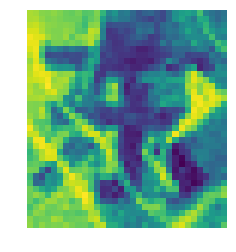

TB10oxuLXXXXXamaXXXunYpLFXX
北
(174.25, 245.5, 204.25, 277.0)


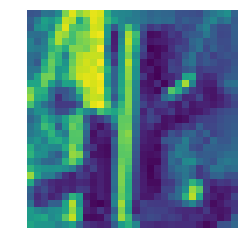

TB10oxuLXXXXXamaXXXunYpLFXX
大
(214.25, 250.0, 246.75, 283.5)


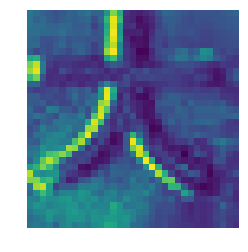

TB10oxuLXXXXXamaXXXunYpLFXX
板
(251.75, 247.5, 287.25, 284.5)


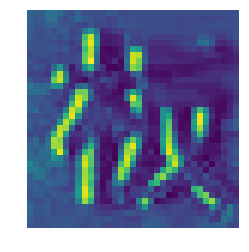

TB10P71bRcHL1JjSZJiXXcKcpXa_!!0-item_pic.jpg
：
(480.16, 67.52, 495.16, 103.52)


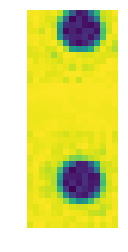

TB10P71bRcHL1JjSZJiXXcKcpXa_!!0-item_pic.jpg
，
(479.96, 187.72, 489.36, 205.52)


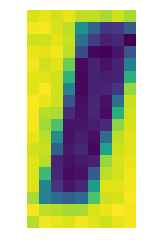

TB10pCKRFXXXXcfapXXXXXXXXXX_!!0-item_pic.jpg
6
(-1.74, 694.75, 72.66, 778.95)


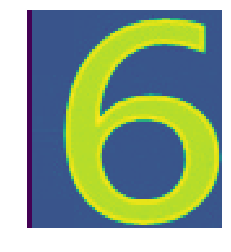

TB10qlmLXXXXXcsapXXunYpLFXX
t
(381.98, 174.62, 453.4, 249.65)


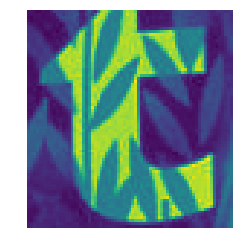

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
增
(233.2, 578.53, 246.2, 595.87)


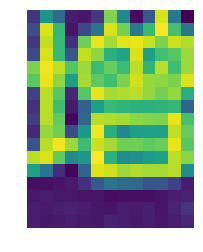

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
艳
(258.87, 574.2, 274.87, 593.87)


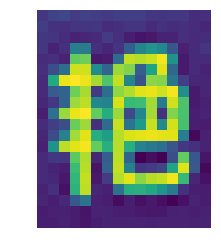

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
饲
(281.87, 573.87, 294.53, 593.2)


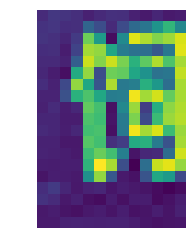

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
料
(304.2, 570.2, 315.53, 586.2)


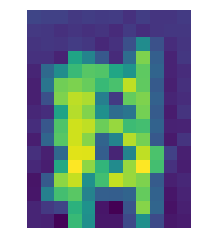

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
头
(185.2, 576.87, 197.2, 597.53)


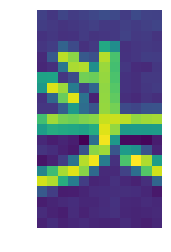

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
起
(154.87, 578.2, 168.87, 595.53)


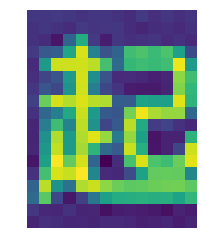

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
速
(126.43, 576.32, 143.87, 597.53)


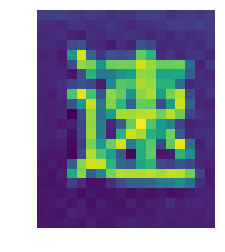

TB10QWvJFXXXXaAXXXXXXXXXXXX_!!0-item_pic.jpg
快
(106.49, 579.87, 118.53, 593.87)


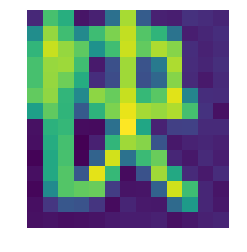

TB10R0SLXXXXXbjXXXXunYpLFXX
lmak
(168.91, 628.82, 188.73, 691.45)


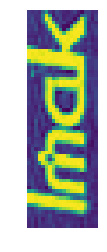

TB10R0SLXXXXXbjXXXXunYpLFXX
盘
(503.29, 128.86, 548.14, 183.0)


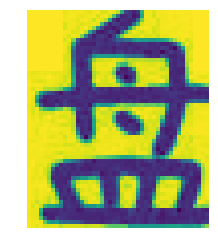

TB10R0SLXXXXXbjXXXXunYpLFXX
作
(662.57, 127.14, 717.86, 185.0)


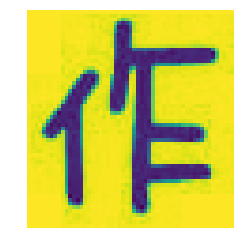

TB10R0SLXXXXXbjXXXXunYpLFXX
用
(732.71, 128.86, 780.71, 182.86)


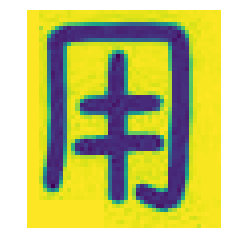

TB10R0SLXXXXXbjXXXXunYpLFXX
贵
(710.29, 8.71, 781.43, 93.57)


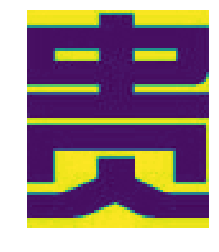

TB10R0SLXXXXXbjXXXXunYpLFXX
薄
(536.0, 10.86, 612.0, 101.0)


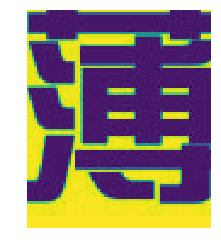

TB10R0SLXXXXXbjXXXXunYpLFXX
8
(588.11, 332.33, 601.44, 350.0)


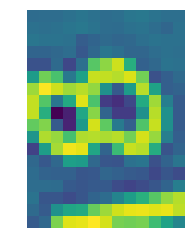

TB10RaVoL2H8KJjy1zkos0r7pXa
鸡翅根
(907.74, 112.72, 1016.42, 428.84)


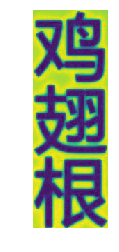

TB10RaVoL2H8KJjy1zkos0r7pXa
色
(147.86, 264.84, 278.38, 405.84)


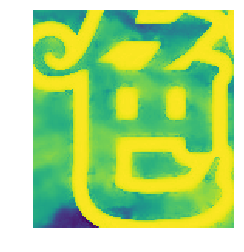

TB10RaVoL2H8KJjy1zkos0r7pXa
香
(282.38, 215.48, 420.42, 370.12)


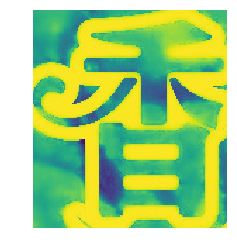

TB10RaVoL2H8KJjy1zkos0r7pXa
俱
(433.78, 333.48, 528.82, 443.4)


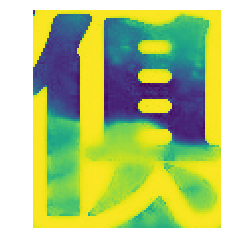

TB10RaVoL2H8KJjy1zkos0r7pXa
全
(543.02, 239.96, 685.38, 397.72)


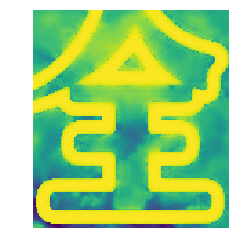

TB10RNALXXXXXX7XVXXunYpLFXX
7
(154.57, 390.81, 173.4, 426.48)


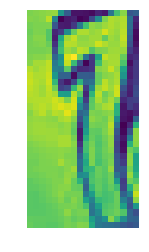

TB10RNALXXXXXX7XVXXunYpLFXX
Prac
(472.63, 351.0, 475.54, 373.17)


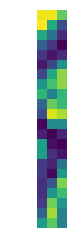

TB10rVlLXXXXXcDapXXunYpLFXX
特产
(937.87, 886.33, 967.0, 957.87)


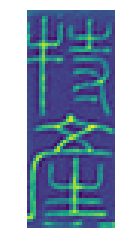

TB10rVlLXXXXXcDapXXunYpLFXX
武夷
(970.13, 886.33, 993.8, 960.87)


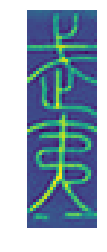

TB10rVlLXXXXXcDapXXunYpLFXX
大
(906.2, 399.93, 1030.67, 566.6)


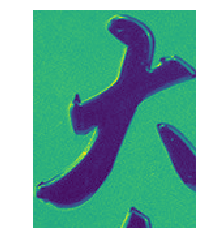

TB10rVlLXXXXXcDapXXunYpLFXX
红
(947.53, 560.47, 1071.27, 717.4)


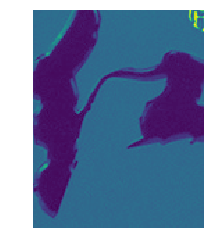

TB10rVlLXXXXXcDapXXunYpLFXX
袍
(901.87, 704.53, 1054.73, 874.47)


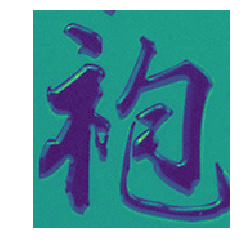

TB10rVlLXXXXXcDapXXunYpLFXX
岩骨花香九曲韵味
(856.33, 609.13, 897.93, 1003.6)


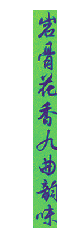

TB10rVlLXXXXXcDapXXunYpLFXX
大
(297.27, 738.4, 402.67, 859.2)


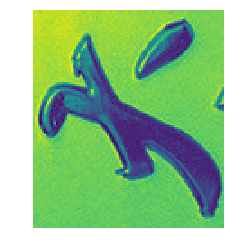

TB10rVlLXXXXXcDapXXunYpLFXX
红
(394.33, 707.2, 506.8, 827.33)


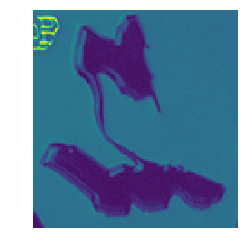

TB10rVlLXXXXXcDapXXunYpLFXX
袍
(499.07, 722.33, 579.33, 853.07)


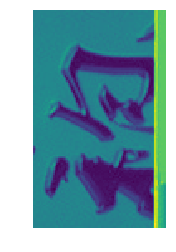

TB10rVlLXXXXXcDapXXunYpLFXX
珍品
(1056.67, 517.4, 1080.13, 577.07)


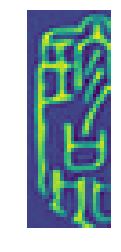

TB10SB6LpXXXXa5XVXXunYpLFXX
He
(107.44, 495.27, 121.73, 510.91)


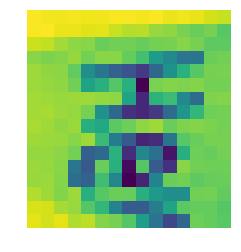

TB10SB6LpXXXXa5XVXXunYpLFXX
S
(305.09, 10.82, 329.64, 54.45)


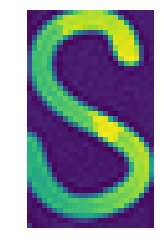

TB10sdNLXXXXXbhXpXXunYpLFXX
④
(83.0, 707.36, 109.55, 735.36)


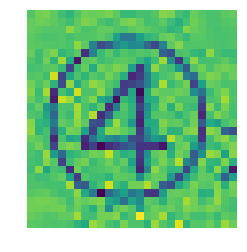

TB10sdNLXXXXXbhXpXXunYpLFXX
②
(382.91, 711.27, 403.73, 734.09)


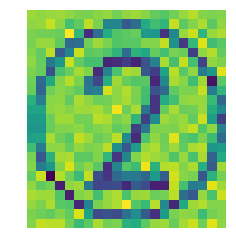

TB10sdNLXXXXXbhXpXXunYpLFXX
PERFECTCARE
(455.91, 149.09, 463.36, 195.91)


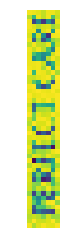

TB10sdNLXXXXXbhXpXXunYpLFXX
5个步骤
(607.09, 63.45, 672.18, 417.36)


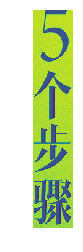

TB10sdNLXXXXXbhXpXXunYpLFXX
无死角护肤解决方案
(722.18, 55.45, 770.45, 481.73)


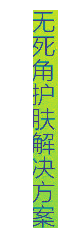

TB10tm7mdnJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
H
(565.91, 148.09, 579.0, 161.91)


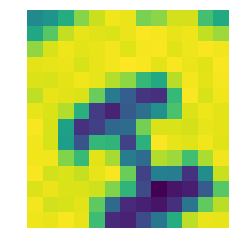

TB10tngnv6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
荣耀
(159.0, 39.2, 192.2, 98.6)


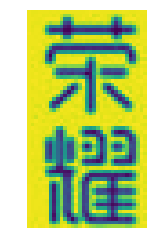

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
保留原图
(704.93, 442.14, 730.84, 558.36)


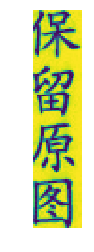

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
盗图投诉
(701.98, 573.09, 728.52, 696.41)


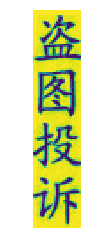

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
1
(201.06, 104.85, 212.02, 120.85)


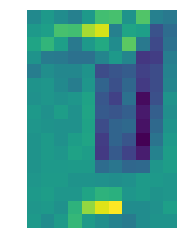

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
3
(221.98, 101.12, 238.98, 121.42)


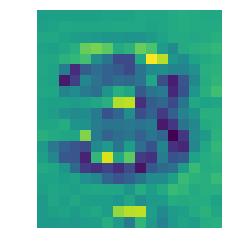

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
2
(193.13, 156.35, 211.87, 180.27)


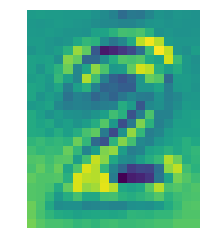

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
4
(216.79, 156.35, 236.52, 178.54)


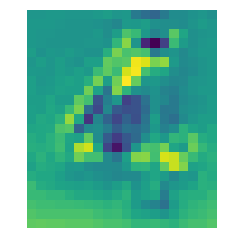

TB10tv7oIjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
6
(243.75, 157.08, 259.75, 179.85)


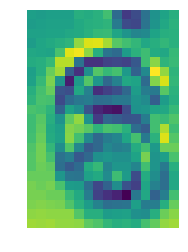

TB10UdNejgy_uJjSZLeXXaPlFXa_!!0-item_pic.jpg
？
(114.54, 68.51, 140.89, 124.6)


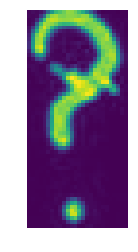

TB10UdNejgy_uJjSZLeXXaPlFXa_!!0-item_pic.jpg
？
(219.28, 113.72, 242.59, 162.37)


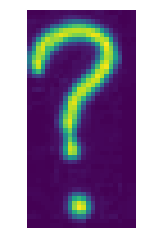

TB10UdNejgy_uJjSZLeXXaPlFXa_!!0-item_pic.jpg
？
(382.2, 398.85, 406.26, 452.09)


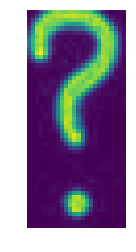

TB10UdNejgy_uJjSZLeXXaPlFXa_!!0-item_pic.jpg
？
(117.29, 392.36, 145.08, 452.28)


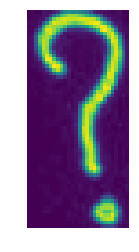

TB10UpPLXXXXXcLXXXXunYpLFXX
8
(142.95, 215.8, 160.85, 236.6)


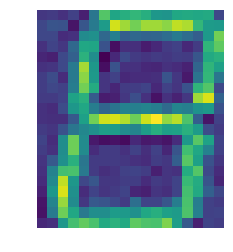

TB10UpPLXXXXXcLXXXXunYpLFXX
8
(168.35, 214.8, 187.25, 237.9)


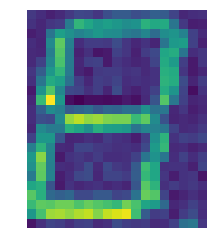

TB10utKLXXXXXcXXpXXunYpLFXX
P
(483.63, 117.5, 499.13, 135.75)


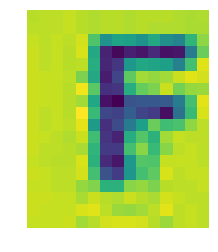

TB10utKLXXXXXcXXpXXunYpLFXX
ST
(211.38, 117.75, 222.13, 130.0)


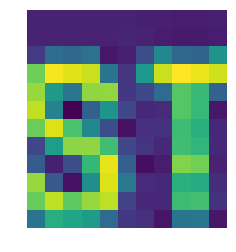

TB10U_pnkfb_uJjSsrbXXb6bVXa_!!0-item_pic.jpg
5
(37.43, 28.16, 90.45, 109.1)


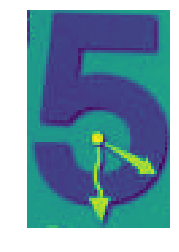

TB10U_pnkfb_uJjSsrbXXb6bVXa_!!0-item_pic.jpg
岁
(201.81, 203.97, 205.45, 211.85)


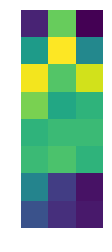

TB10vBxbNk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
MODBUS
(112.51, 209.51, 121.39, 246.08)


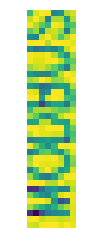

TB10vBxbNk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
5？
(110.18, 187.12, 119.73, 197.33)


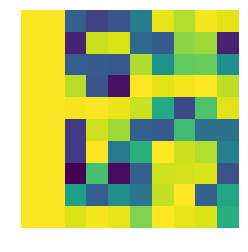

TB10vBxbNk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
人
(200.79, 88.29, 208.04, 99.49)


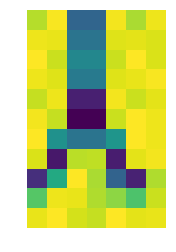

TB10vBxbNk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
由Autodesk教育版产品制作
(549.28, 148.58, 559.85, 264.2)


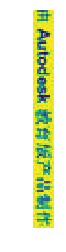

TB10vBxbNk98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
由Autodesk教育版产品制作
(1.49, 158.12, 10.72, 273.41)


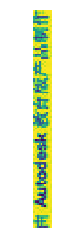

TB10VgSeEo09KJjSZFDXXb9npXa_!!0-item_pic.jpg
智祥书社
(242.72, 268.45, 282.72, 332.4)


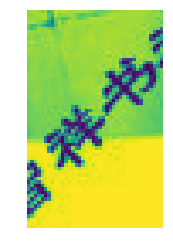

TB10VgSeEo09KJjSZFDXXb9npXa_!!0-item_pic.jpg
通风如何
(55.22, 100.85, 70.42, 159.9)


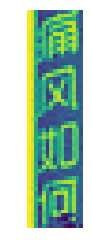

TB10VgSeEo09KJjSZFDXXb9npXa_!!0-item_pic.jpg
智祥书社
(245.42, 60.6, 286.52, 122.55)


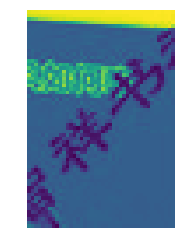

TB10VlULpXXXXcmaXXXunYpLFXX
￥
(30.0, 545.73, 52.55, 575.55)


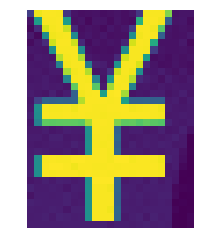

TB10VlULpXXXXcmaXXXunYpLFXX
2
(593.09, 623.55, 602.09, 635.91)


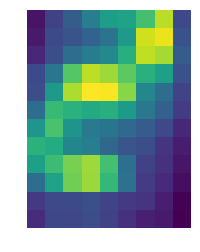

TB10W4JLXXXXXXaXFXXunYpLFXX
买
(-1.85, 39.46, 69.15, 110.64)


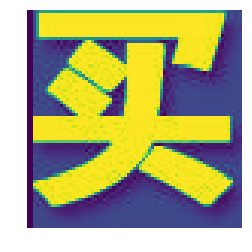

TB10W4JLXXXXXXaXFXXunYpLFXX
1
(71.78, 12.82, 112.24, 103.09)


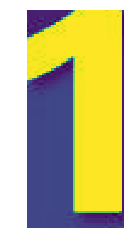

TB10X3OltnJ8KJjSszdXXaxuFXa_!!2-item_pic.png
S
(75.67, 7.78, 111.79, 64.07)


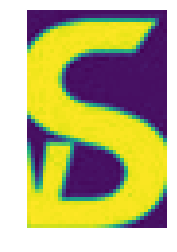

TB10X3OltnJ8KJjSszdXXaxuFXa_!!2-item_pic.png
185CM
(360.05, 261.13, 467.85, 388.27)


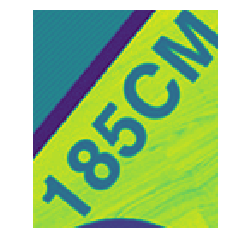

TB10XgjlJfJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
SF
(18.9, 29.0, 41.9, 52.4)


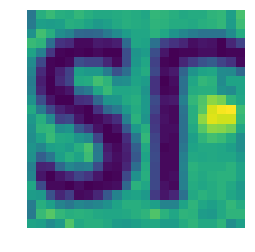

TB10XgjlJfJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
满意再发货
(37.7, 91.8, 117.1, 487.2)


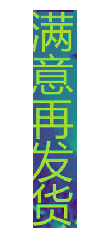

TB10XgsKVXXXXaSXXXXXXXXXXXX_!!0-item_pic.jpg
亲子入门创意折纸
(32.5, 229.33, 51.83, 413.67)


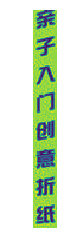

TB10XgsKVXXXXaSXXXXXXXXXXXX_!!0-item_pic.jpg
入门篇
(30.5, 435.0, 55.5, 504.67)


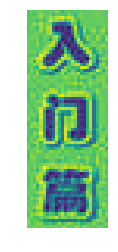

TB10XgsKVXXXXaSXXXXXXXXXXXX_!!0-item_pic.jpg
新时代出版社
(33.17, 670.0, 50.5, 805.0)


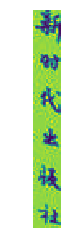

TB10XgsKVXXXXaSXXXXXXXXXXXX_!!0-item_pic.jpg
新时代出版社
(6.5, 664.0, 26.83, 794.33)


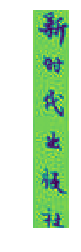

TB10XgsKVXXXXaSXXXXXXXXXXXX_!!0-item_pic.jpg
亲子入门创意折纸
(4.5, 235.67, 30.5, 414.33)


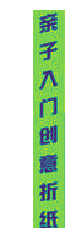

TB10xJMLXXXXXbkXpXXunYpLFXX
折
(683.33, 731.56, 732.33, 780.56)


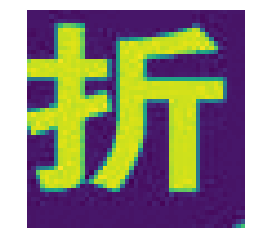

TB10XQEd97PL1JjSZFHXXcciXXa_!!2-item_pic.png
高
(3.12, 16.66, 56.65, 86.46)


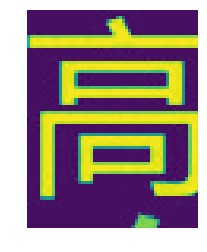

TB10xUQJFXXXXbXXFXXXXXXXXXX_!!0-item_pic.jpg
生活红
(496.97, 562.91, 567.93, 678.07)


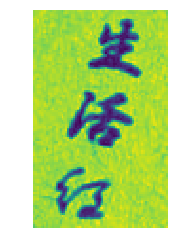

TB10xUQJFXXXXbXXFXXXXXXXXXX_!!0-item_pic.jpg
配料：辣椒、糖、蒜泥等
(656.5, 413.32, 685.96, 686.98)


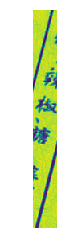

TB10xUQJFXXXXbXXFXXXXXXXXXX_!!0-item_pic.jpg
保质期:十二个月
(691.9, 428.16, 761.73, 624.93)


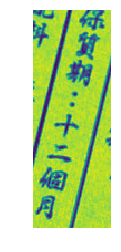

TB10xUQJFXXXXbXXFXXXXXXXXXX_!!0-item_pic.jpg
生产日期：
(754.89, 433.06, 809.0, 589.5)


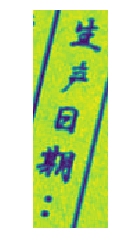

TB10xUQJFXXXXbXXFXXXXXXXXXX_!!0-item_pic.jpg
生活红
(1052.11, 1079.68, 1111.12, 1168.25)


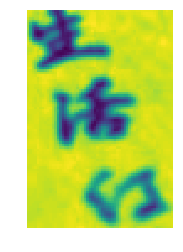

TB10yFuLXXXXXa7aXXXunYpLFXX
改善干枯水润滋养
(593.36, 39.18, 675.73, 651.36)


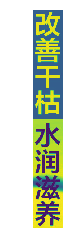

TB10yFuLXXXXXa7aXXXunYpLFXX
天然睡莲精华洗发水
(701.27, 34.82, 765.36, 520.55)


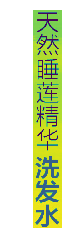

TB10Y_4lY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
实惠实用
(634.08, 143.33, 695.25, 406.0)


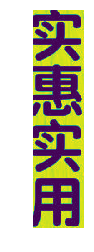

TB10Y_4lY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
式
(261.42, 470.67, 327.92, 543.67)


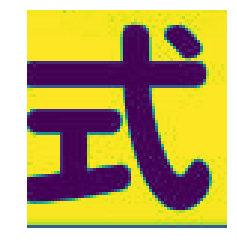

TB10Y_4lY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
2
(-6.58, 550.0, 55.58, 630.67)


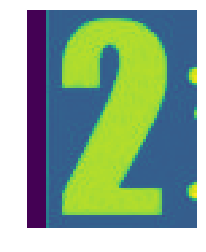

TB10Y_4lY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
支
(58.08, 564.17, 113.08, 630.17)


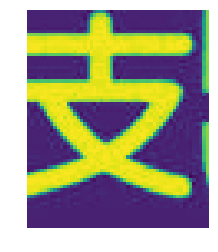

TB10Y_4lY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
还
(332.92, 568.5, 379.25, 622.33)


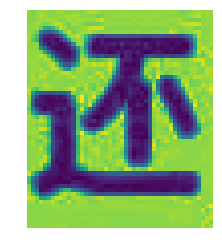

TB11.0xgC3PL1JjSZFtXXclRVXa_!!0-item_pic.jpg
?
(74.53, 508.08, 99.87, 550.96)


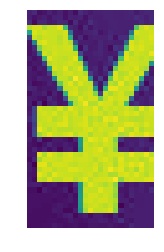

TB110fUkOqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
七之莲
(679.5, 4.0, 794.5, 121.0)


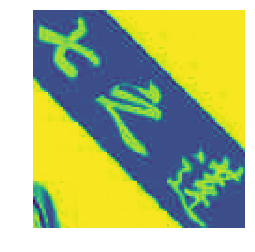

TB1114TLXXXXXaBXXXXunYpLFXX
懋隆
(101.27, 29.82, 151.0, 198.09)


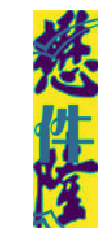

TB1114TLXXXXXaBXXXXunYpLFXX
珠寶
(106.91, 217.0, 144.91, 328.55)


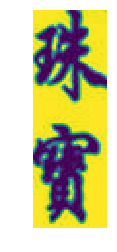

TB111JDLXXXXXcNXFXXunYpLFXX
209685
(328.82, 290.97, 341.53, 336.27)


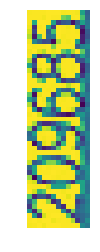

TB116tTLpXXXXatapXXunYpLFXX
元
(46.81, 111.08, 66.6, 133.39)


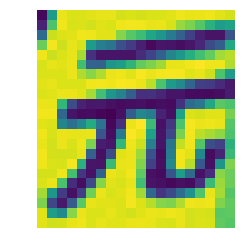

TB116tTLpXXXXatapXXunYpLFXX
表
(177.53, 83.7, 225.65, 132.05)


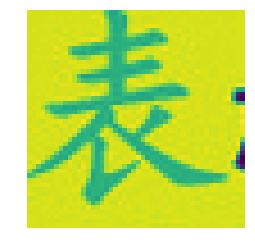

TB11aRCLXXXXXXiXVXXunYpLFXX
Happy
(273.0, 338.33, 360.33, 429.0)


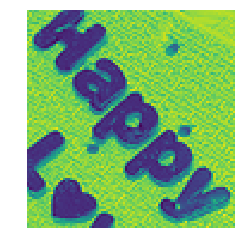

TB11aRCLXXXXXXiXVXXunYpLFXX
?
(243.67, 30.33, 264.33, 52.67)


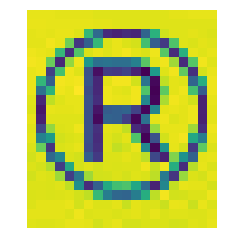

TB11cBELXXXXXb1XFXXunYpLFXX
白
(196.73, 692.64, 207.18, 703.55)


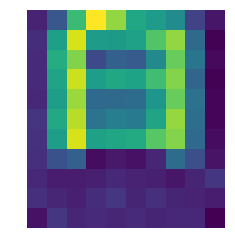

TB11cBELXXXXXb1XFXXunYpLFXX
NO!
(117.91, 64.45, 228.64, 182.64)


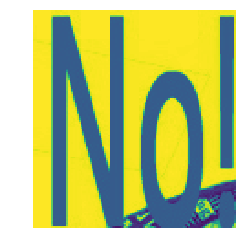

TB11ClSLXXXXXX8XXXXunYpLFXX
3
(534.63, 475.85, 568.89, 540.0)


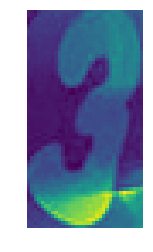

TB11cRVLXXXXXXUXXXXunYpLFXX
4G
(323.89, 646.22, 339.33, 666.89)


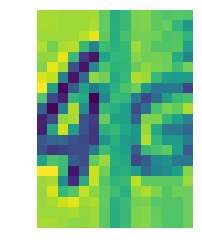

TB11DhxLXXXXXckXVXXunYpLFXX
F3
(171.62, 121.6, 181.52, 135.1)


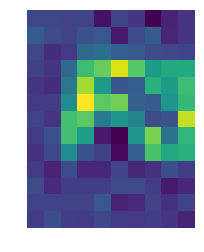

TB11DhxLXXXXXckXVXXunYpLFXX
！
(81.62, 149.4, 90.82, 163.9)


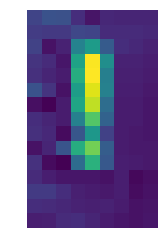

TB11DhxLXXXXXckXVXXunYpLFXX
1
(81.72, 166.5, 89.92, 176.5)


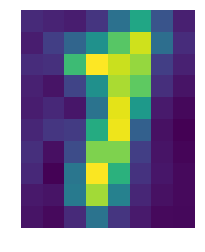

TB11DhxLXXXXXckXVXXunYpLFXX
2
(123.92, 163.7, 137.72, 179.3)


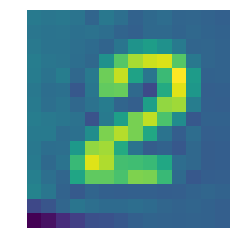

TB11DhxLXXXXXckXVXXunYpLFXX
#
(168.02, 150.3, 178.92, 161.2)


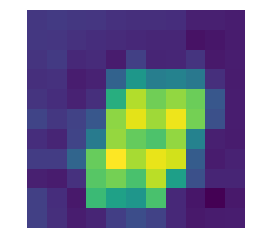

TB11DhxLXXXXXckXVXXunYpLFXX
$
(213.92, 149.4, 223.12, 160.2)


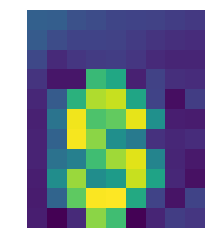

TB11DhxLXXXXXckXVXXunYpLFXX
4
(211.32, 166.5, 221.32, 182.8)


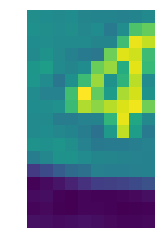

TB11DhxLXXXXXckXVXXunYpLFXX
%
(252.52, 147.5, 266.12, 162.9)


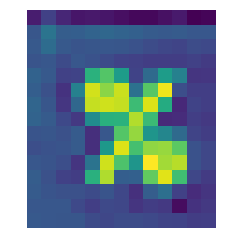

TB11DhxLXXXXXckXVXXunYpLFXX
7
(339.92, 164.8, 349.12, 176.5)


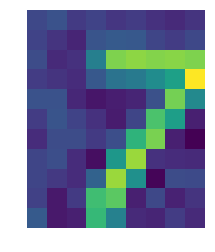

TB11DhxLXXXXXckXVXXunYpLFXX
（
(426.32, 146.7, 436.32, 165.7)


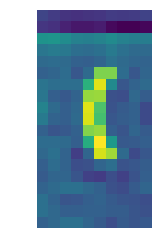

TB11DhxLXXXXXckXVXXunYpLFXX
9
(425.52, 163.8, 436.42, 178.3)


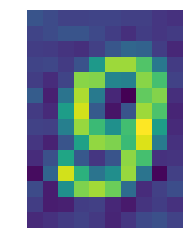

TB11DhxLXXXXXckXVXXunYpLFXX
）
(469.52, 149.5, 477.72, 162.9)


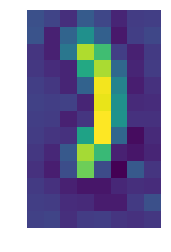

TB11DhxLXXXXXckXVXXunYpLFXX
0
(467.92, 166.5, 477.72, 179.3)


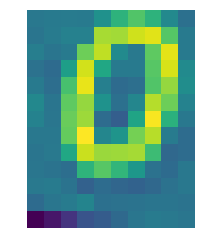

TB11DhxLXXXXXckXVXXunYpLFXX
/
(485.72, 168.4, 494.72, 178.2)


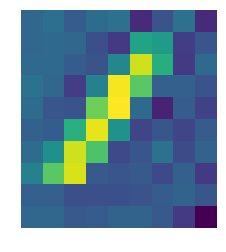

TB11DhxLXXXXXckXVXXunYpLFXX
+
(553.32, 152.1, 563.32, 162.1)


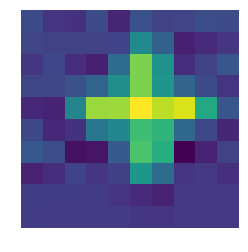

TB11DhxLXXXXXckXVXXunYpLFXX
E
(191.32, 189.9, 205.92, 207.1)


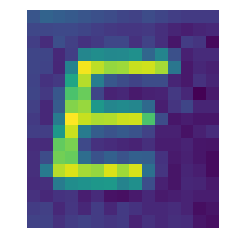

TB11DhxLXXXXXckXVXXunYpLFXX
R
(231.82, 191.6, 247.52, 209.0)


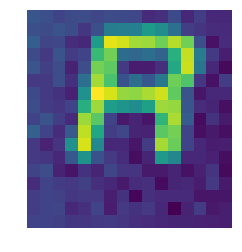

TB11DhxLXXXXXckXVXXunYpLFXX
T
(276.92, 188.1, 287.92, 205.3)


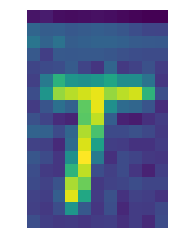

TB11DhxLXXXXXckXVXXunYpLFXX
Y
(320.22, 190.0, 330.12, 207.1)


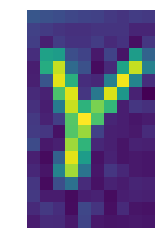

TB11DhxLXXXXXckXVXXunYpLFXX
U
(364.52, 189.9, 377.12, 205.3)


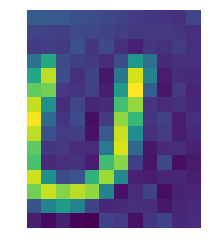

TB11DhxLXXXXXckXVXXunYpLFXX
I
(401.92, 189.9, 415.72, 206.1)


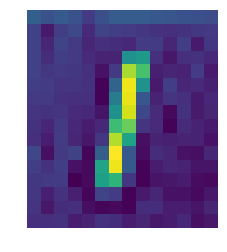

TB11DhxLXXXXXckXVXXunYpLFXX
O
(493.12, 192.5, 502.92, 207.1)


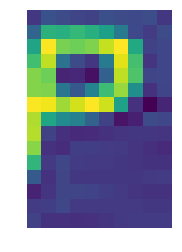

TB11DhxLXXXXXckXVXXunYpLFXX
{
(532.62, 189.9, 541.52, 203.5)


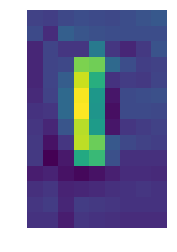

TB11DhxLXXXXXckXVXXunYpLFXX
【
(534.32, 204.3, 543.52, 215.2)


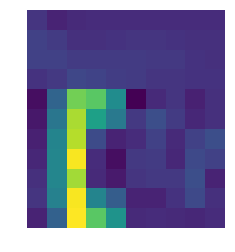

TB11DhxLXXXXXckXVXXunYpLFXX
】
(573.92, 204.3, 587.72, 218.8)


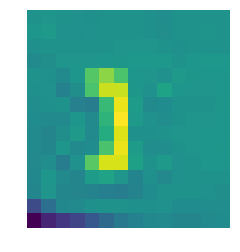

TB11DhxLXXXXXckXVXXunYpLFXX
A
(115.92, 233.9, 131.42, 250.3)


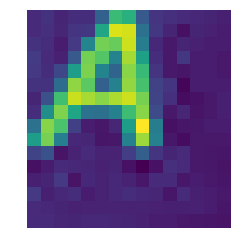

TB11DhxLXXXXXckXVXXunYpLFXX
D
(201.52, 233.2, 212.12, 244.9)


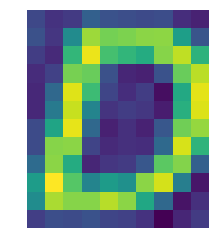

TB11DhxLXXXXXckXVXXunYpLFXX
F
(244.62, 228.5, 260.12, 246.7)


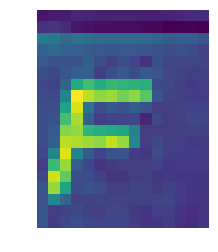

TB11DhxLXXXXXckXVXXunYpLFXX
G
(286.92, 232.3, 301.32, 246.7)


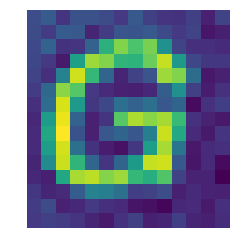

TB11DhxLXXXXXckXVXXunYpLFXX
H
(331.12, 233.2, 340.72, 248.6)


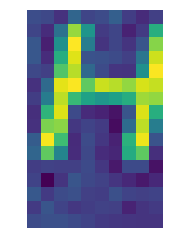

TB11DhxLXXXXXckXVXXunYpLFXX
J
(367.72, 230.3, 383.12, 247.7)


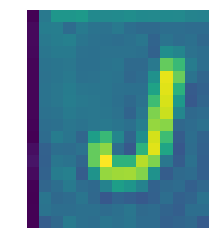

TB11DhxLXXXXXckXVXXunYpLFXX
L
(458.72, 226.7, 472.52, 251.3)


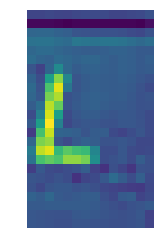

TB11DhxLXXXXXckXVXXunYpLFXX
:
(499.32, 227.6, 512.12, 245.0)


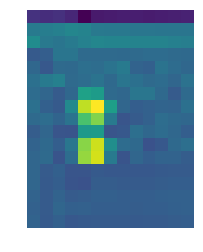

TB11DhxLXXXXXckXVXXunYpLFXX
;
(499.22, 246.6, 508.32, 258.3)


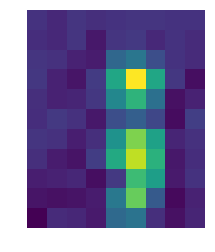

TB11DhxLXXXXXckXVXXunYpLFXX
'
(546.12, 246.6, 553.32, 257.4)


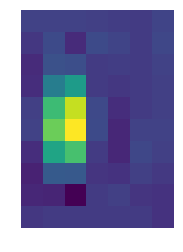

TB11DhxLXXXXXckXVXXunYpLFXX
C
(220.12, 272.8, 234.92, 288.2)


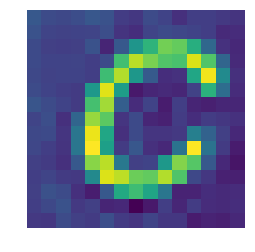

TB11DhxLXXXXXckXVXXunYpLFXX
B
(310.42, 271.7, 324.92, 287.2)


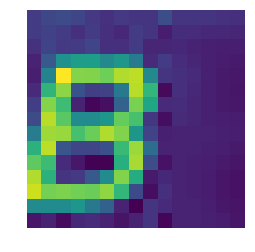

TB11DhxLXXXXXckXVXXunYpLFXX
<
(437.12, 271.8, 446.92, 284.5)


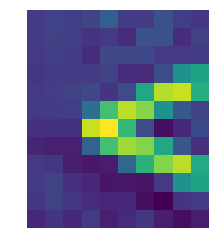

TB11DhxLXXXXXckXVXXunYpLFXX
>
(483.32, 272.8, 494.12, 284.6)


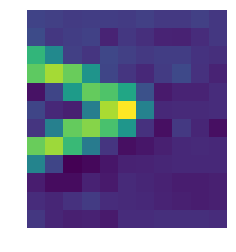

TB11DhxLXXXXXckXVXXunYpLFXX
.
(477.72, 291.5, 488.52, 302.3)


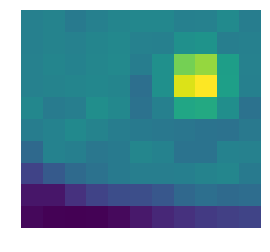

TB11DhxLXXXXXckXVXXunYpLFXX
?
(523.82, 271.7, 535.52, 284.3)


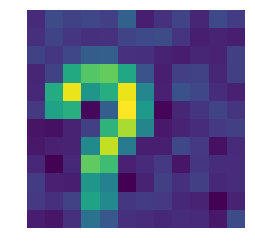

TB11DhxLXXXXXckXVXXunYpLFXX
+
(539.72, 289.8, 549.72, 301.6)


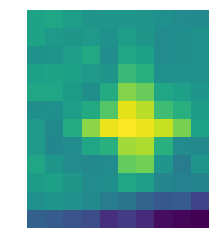

TB11DhxLXXXXXckXVXXunYpLFXX
↑
(628.12, 272.7, 644.32, 290.8)


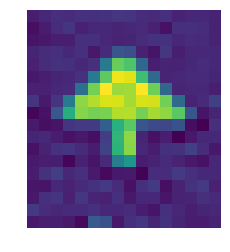

TB11DVILXXXXXXUXFXXunYpLFXX
X
(367.88, 68.35, 424.26, 135.43)


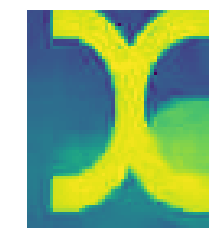

TB11DVILXXXXXXUXFXXunYpLFXX
X
(422.98, 624.77, 469.83, 686.86)


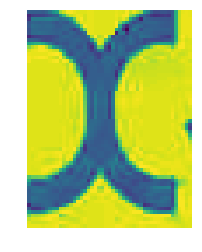

TB11E4tLXXXXXawaXXXunYpLFXX
￥0
(698.0, 192.33, 718.0, 258.67)


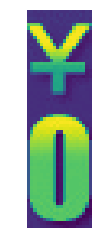

TB11EKbotrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
精
(10.09, 61.97, 34.99, 92.56)


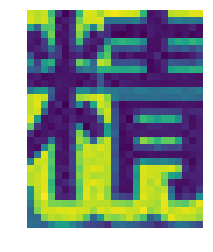

TB11EKbotrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
装
(5.78, 243.18, 34.68, 274.42)


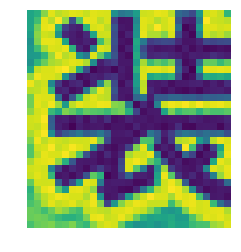

TB11EKbotrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
卡
(270.32, 240.73, 297.81, 271.42)


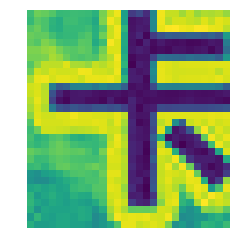

TB11EKbotrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
写
(268.59, 120.56, 298.53, 151.8)


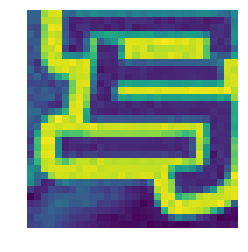

TB11EKbotrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
代
(277.76, 57.21, 298.87, 89.49)


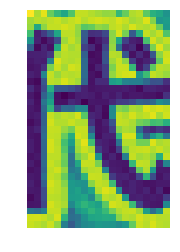

TB11FE1qYsTMeJjSsziSuwdwXXa.jpg
真心话大冒险
(591.08, 175.53, 602.35, 272.57)


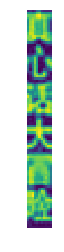

TB11FE1qYsTMeJjSsziSuwdwXXa.jpg
王中磊&威廉弟弟
(567.73, 162.11, 584.0, 282.96)


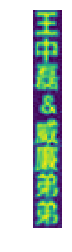

TB11gROLXXXXXXbXpXXunYpLFXX
新品上市
(29.33, 33.67, 81.67, 127.33)


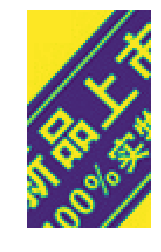

TB11gROLXXXXXXbXpXXunYpLFXX
100%实物拍摄
(43.0, 47.0, 105.33, 138.0)


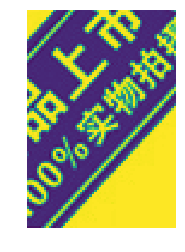

TB11gROLXXXXXXbXpXXunYpLFXX
KANGNAI
(565.33, 434.0, 595.33, 511.67)


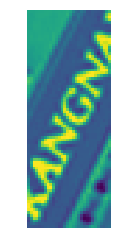

TB11gROLXXXXXXbXpXXunYpLFXX
?
(227.67, 187.0, 253.33, 212.67)


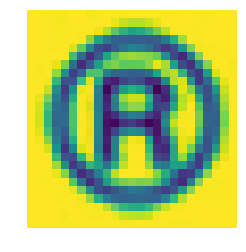

TB11H4OLXXXXXXIXpXXunYpLFXX
2
(206.33, 234.67, 215.33, 249.33)


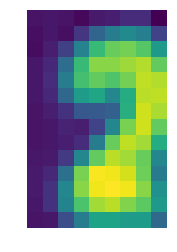

TB11HFCLXXXXXb7XFXXunYpLFXX
貂绒
(509.69, 481.62, 526.23, 509.69)


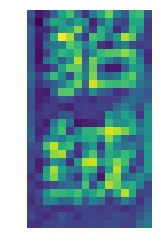

TB11HFCLXXXXXb7XFXXunYpLFXX
免
(150.62, 627.31, 160.08, 639.38)


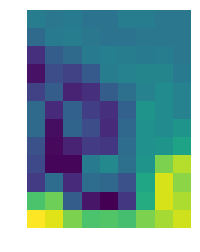

TB11HFCLXXXXXb7XFXXunYpLFXX
貂绒
(293.62, 536.85, 305.31, 563.69)


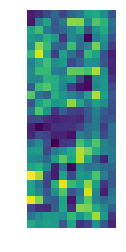

TB11HFCLXXXXXb7XFXXunYpLFXX
貂绒
(295.46, 53.92, 300.38, 77.92)


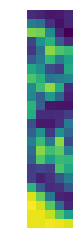

TB11HhOLXXXXXcSXXXXunYpLFXX
新装
(721.36, 363.36, 739.55, 392.55)


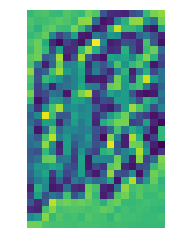

TB11HhOLXXXXXcSXXXXunYpLFXX
上市
(737.27, 345.73, 762.36, 381.64)


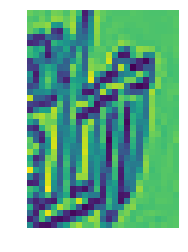

TB11HhOLXXXXXcSXXXXunYpLFXX
10
(216.18, 681.27, 228.18, 699.36)


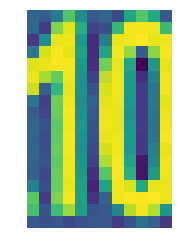

TB11HhOLXXXXXcSXXXXunYpLFXX
10
(272.91, 697.18, 291.91, 718.36)


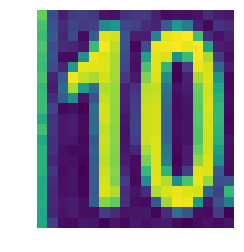

TB11HhOLXXXXXcSXXXXunYpLFXX
M
(295.27, 698.45, 310.36, 714.45)


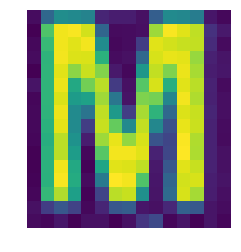

TB11HhOLXXXXXcSXXXXunYpLFXX
3
(274.45, 656.45, 294.36, 681.45)


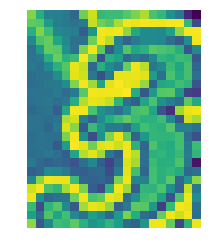

TB11HhOLXXXXXcSXXXXunYpLFXX
包大人
(663.64, 418.91, 711.09, 478.0)


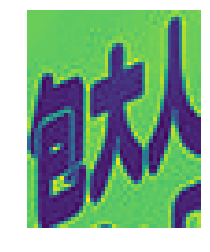

TB11HhOLXXXXXcSXXXXunYpLFXX
Dr.p
(673.55, 466.27, 715.09, 515.0)


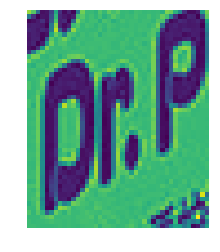

TB11HxBLXXXXXXVXVXXunYpLFXX
能
(205.6, 525.6, 220.0, 540.8)


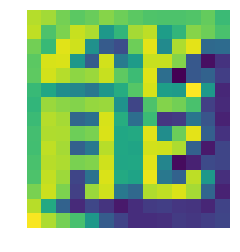

TB11HxBLXXXXXXVXVXXunYpLFXX
免费拿样
(34.2, 264.4, 111.4, 559.6)


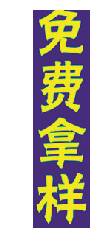

TB11HxBLXXXXXXVXVXXunYpLFXX
免费设计
(670.8, 257.6, 746.6, 562.2)


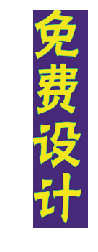

TB11hZ6gamgSKJjSsphXXcy1VXa_!!0-item_pic.jpg
送
(157.51, 596.12, 190.51, 643.45)


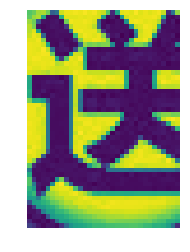

TB11hZ6gamgSKJjSsphXXcy1VXa_!!0-item_pic.jpg
?
(696.18, 698.12, 711.18, 724.79)


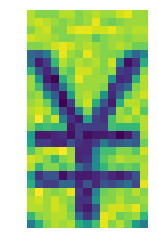

TB11hZ6gamgSKJjSsphXXcy1VXa_!!0-item_pic.jpg
5
(686.84, 729.45, 717.18, 774.79)


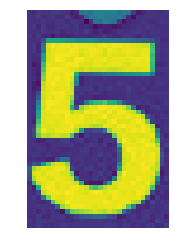

TB11hZ6gamgSKJjSsphXXcy1VXa_!!0-item_pic.jpg
元
(716.51, 756.45, 732.18, 774.45)


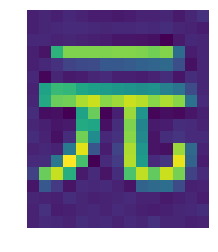

TB11jSdaRLN8KJjSZFpXXbZaVXa_!!0-item_pic.jpg
4
(395.47, 225.07, 466.55, 310.67)


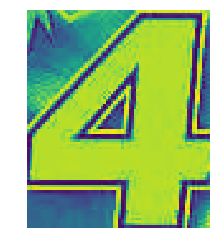

TB11jVmLXXXXXcoapXXunYpLFXX
1
(356.27, 347.31, 366.88, 361.77)


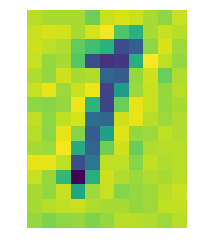

TB11jVmLXXXXXcoapXXunYpLFXX
ml
(363.04, 318.85, 379.35, 337.0)


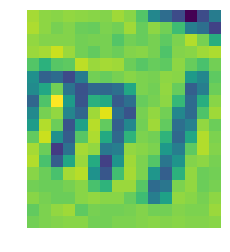

TB11jVmLXXXXXcoapXXunYpLFXX
2
(386.96, 258.92, 398.73, 272.46)


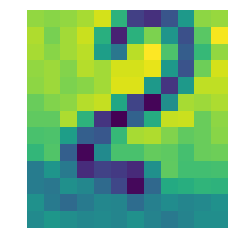

TB11KFILXXXXXbaXpXXunYpLFXX
腰腹部
(27.88, 418.0, 95.63, 607.5)


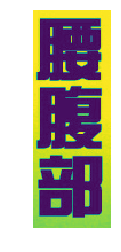

TB11KxxdMfH8KJjy1zcXXcTzpXa_!!0-item_pic.jpg
比
(661.11, 436.43, 691.33, 467.65)


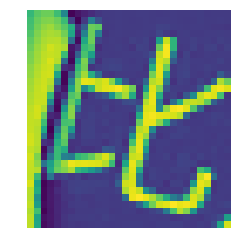

TB11KxxdMfH8KJjy1zcXXcTzpXa_!!0-item_pic.jpg
气
(756.67, 462.63, 786.0, 495.96)


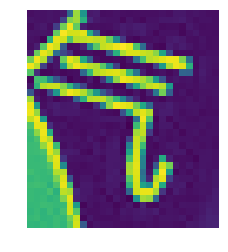

TB11KxxdMfH8KJjy1zcXXcTzpXa_!!0-item_pic.jpg
亮
(727.61, 620.44, 755.11, 650.94)


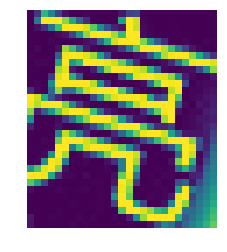

TB11KxxdMfH8KJjy1zcXXcTzpXa_!!0-item_pic.jpg
送
(3.11, 669.78, 133.11, 802.28)


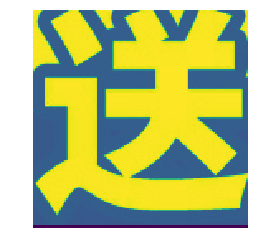

TB11LRBLXXXXXXOXVXXunYpLFXX
中國風
(288.59, 170.81, 308.35, 236.38)


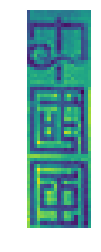

TB11LRBLXXXXXXOXVXXunYpLFXX
?
(249.53, 20.26, 264.01, 34.74)


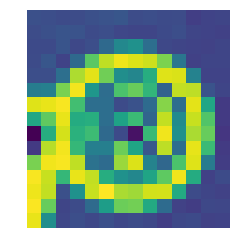

TB11MqwayIRMeJjy0FbXXbnqXXa_!!0-item_pic.jpg
快
(460.5, 457.0, 495.5, 504.0)


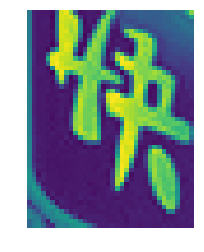

TB11MqwayIRMeJjy0FbXXbnqXXa_!!0-item_pic.jpg
了
(503.5, 452.0, 531.5, 501.0)


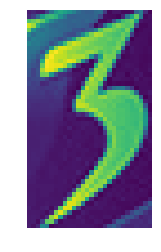

TB11MXnoDTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
p
(178.35, 79.81, 213.5, 125.31)


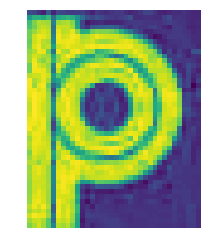

TB11NiVm3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
Red
(363.0, 421.22, 386.89, 455.22)


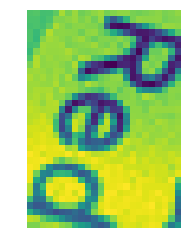

TB11NiVm3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
纯白
(462.56, 309.33, 497.11, 350.44)


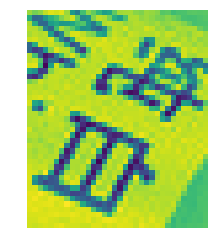

TB11NiVm3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
大红
(382.44, 424.89, 411.33, 468.56)


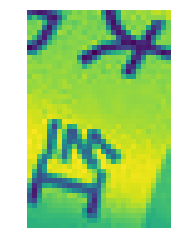

TB11NiVm3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
银灰
(492.89, 271.0, 494.89, 305.78)


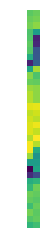

TB11NiVm3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
一
(516.67, 225.89, 530.33, 250.78)


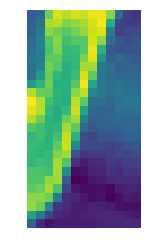

TB11NiVm3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
Hot
(8.78, 104.11, 94.22, 195.78)


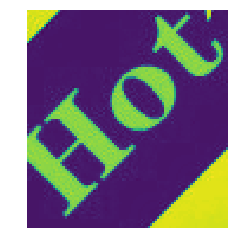

TB11OxMLXXXXXbpXpXXunYpLFXX
8
(247.84, 257.32, 291.24, 317.12)


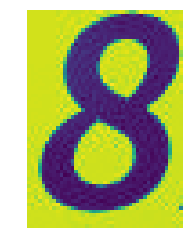

TB11OxMLXXXXXbpXpXXunYpLFXX
片
(708.04, 248.12, 772.64, 320.52)


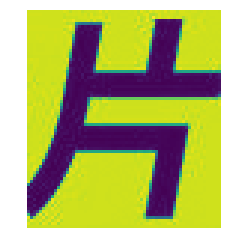

TB11OxMLXXXXXbpXpXXunYpLFXX
6
(402.04, 468.16, 444.04, 510.16)


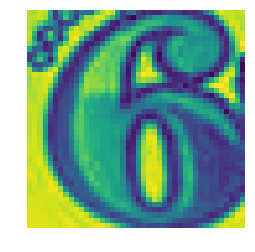

TB11OxMLXXXXXbpXpXXunYpLFXX
新
(441.84, 472.76, 463.84, 494.96)


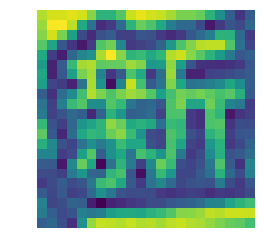

TB11OxMLXXXXXbpXpXXunYpLFXX
?
(355.04, 524.76, 370.24, 540.56)


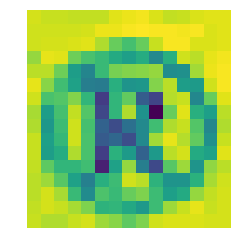

TB11OxMLXXXXXbpXpXXunYpLFXX
防
(324.04, 587.76, 386.04, 651.16)


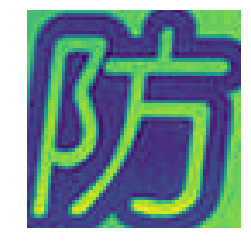

TB11OxMLXXXXXbpXpXXunYpLFXX
￥
(567.24, 748.36, 599.24, 794.36)


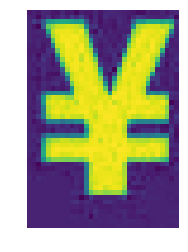

TB11OXRLpXXXXboapXXunYpLFXX
?
(539.88, 354.75, 549.63, 366.25)


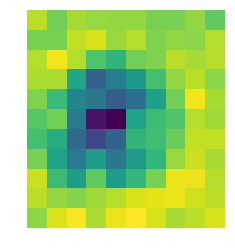

TB11OXRLpXXXXboapXXunYpLFXX
Toolbox
(268.38, 372.0, 281.38, 440.25)


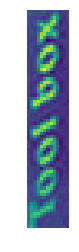

TB11qhyLXXXXXchXVXXunYpLFXX
图
(77.45, 210.15, 97.15, 231.34)


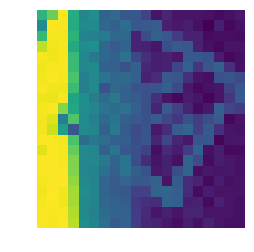

TB11qhyLXXXXXchXVXXunYpLFXX
实
(110.48, 181.29, 129.6, 204.47)


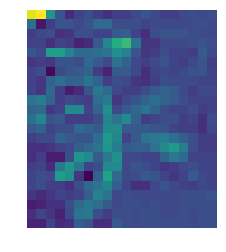

TB11qhyLXXXXXchXVXXunYpLFXX
盗
(152.33, 175.6, 173.0, 197.82)


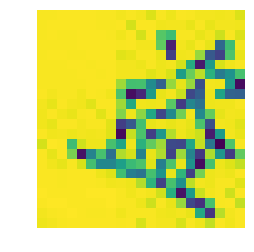

TB11qhyLXXXXXchXVXXunYpLFXX
图
(173.03, 181.84, 192.22, 203.99)


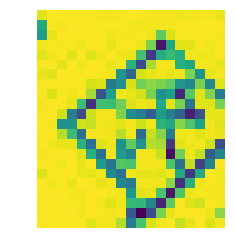

TB11qhyLXXXXXchXVXXunYpLFXX
必
(194.67, 194.72, 213.33, 214.29)


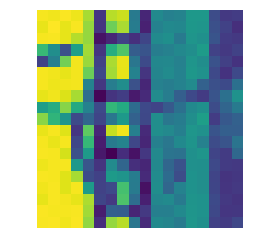

TB11qhyLXXXXXchXVXXunYpLFXX
加厚木质滚轮机柜
(23.92, 105.71, 51.03, 294.6)


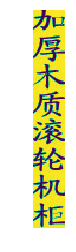

TB11qNtLXXXXXaJaXXXunYpLFXX
俏美
(17.58, 2.33, 147.58, 136.83)


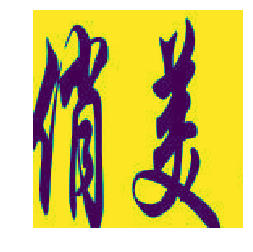

TB11qNtLXXXXXaJaXXXunYpLFXX
人
(143.58, 29.0, 211.75, 111.33)


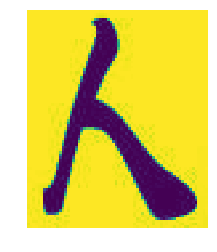

TB11rBKLXXXXXcRXpXXunYpLFXX
吃货
(47.25, 47.33, 81.75, 140.0)


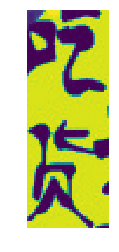

TB11rBKLXXXXXcRXpXXunYpLFXX
天下
(77.58, 88.0, 110.58, 182.5)


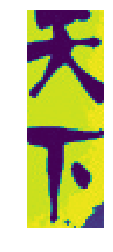

TB11rBKLXXXXXcRXpXXunYpLFXX
纯手工
(248.08, 140.0, 269.92, 197.0)


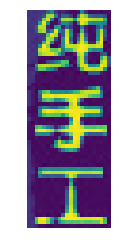

TB11rBKLXXXXXcRXpXXunYpLFXX
炒制
(276.08, 162.0, 295.75, 197.17)


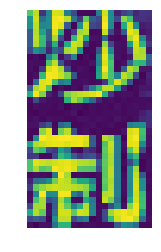

TB11rBKLXXXXXcRXpXXunYpLFXX
冷吃
(300.42, 28.33, 365.92, 167.0)


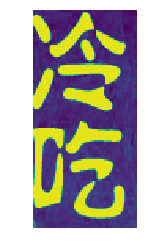

TB11rBKLXXXXXcRXpXXunYpLFXX
牛肉沫
(363.92, 113.33, 412.92, 258.17)


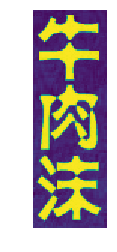

TB11rxILXXXXXcWXpXXunYpLFXX
4
(482.0, 476.6, 492.2, 490.8)


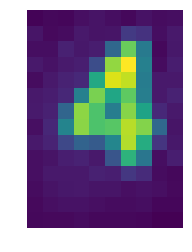

TB11rxILXXXXXcWXpXXunYpLFXX
8
(512.2, 477.8, 523.8, 489.6)


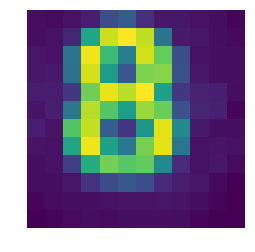

TB11SVnNpXXXXbeXVXXXXXXXXXX_!!0-item_pic.jpg
3
(100.84, 211.51, 135.62, 266.79)


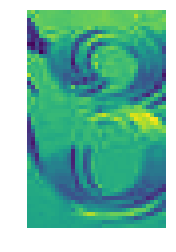

TB11SVnNpXXXXbeXVXXXXXXXXXX_!!0-item_pic.jpg
字
(247.51, 220.45, 257.84, 230.95)


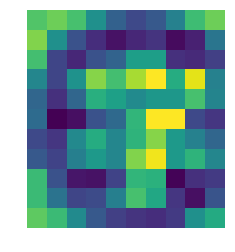

TB11SVnNpXXXXbeXVXXXXXXXXXX_!!0-item_pic.jpg
楷
(139.06, 104.74, 182.4, 149.74)


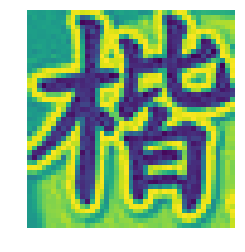

TB11SxbLXXXXXb5XFXXunYpLFXX
足下排毒贴
(507.67, 204.44, 537.67, 366.78)


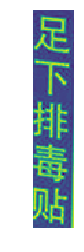

TB11SxbLXXXXXb5XFXXunYpLFXX
参
(397.67, 209.11, 484.0, 304.78)


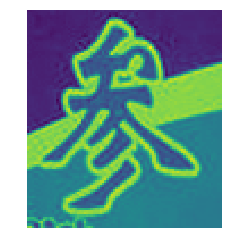

TB11T4FLXXXXXaGXFXXunYpLFXX
Q.C
(438.4, 178.65, 446.76, 190.34)


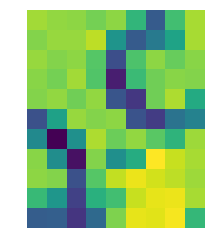

TB11T79b4k98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
2
(246.14, 727.43, 289.71, 791.43)


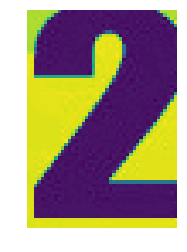

TB11T79b4k98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
?
(262.69, 588.31, 270.92, 599.46)


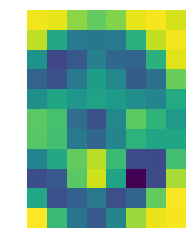

TB11T79b4k98KJjSZFoXXXS6pXa_!!0-item_pic.jpg
?
(632.69, 610.77, 643.54, 622.85)


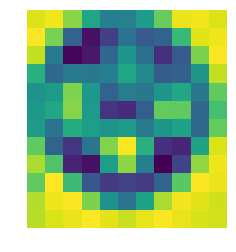

TB11tElNXXXXXafapXXXXXXXXXX_!!0-item_pic.jpg
SPORTS
(738.5, 30.0, 787.5, 245.0)


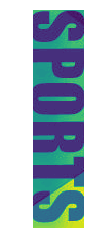

TB11tElNXXXXXafapXXXXXXXXXX_!!0-item_pic.jpg
6
(490.5, 17.0, 543.5, 108.0)


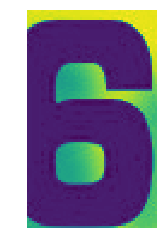

TB11TGXLpXXXXaOXFXXunYpLFXX
MOOULE
(66.12, 111.74, 79.45, 141.18)


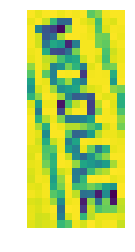

TB11TGXLpXXXXaOXFXXunYpLFXX
0
(202.34, 98.01, 208.45, 105.12)


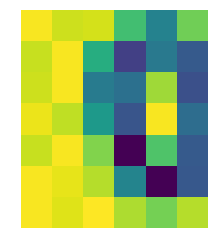

TB11TGXLpXXXXaOXFXXunYpLFXX
2
(219.9, 91.34, 225.01, 98.46)


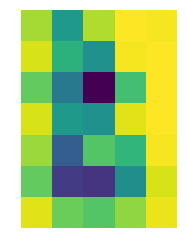

TB11TGXLpXXXXaOXFXXunYpLFXX
新品
(361.23, 35.69, 473.45, 153.24)


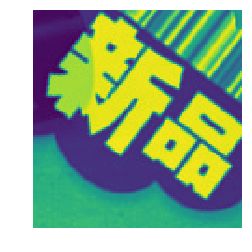

TB11upQLXXXXXc2XXXXunYpLFXX
飴
(149.11, 122.56, 281.67, 276.89)


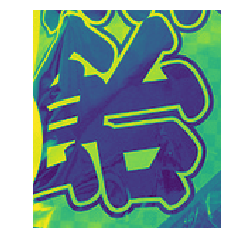

TB11V2bRVXXXXbhapXXXXXXXXXX_.jpg
8
(389.8, 442.4, 402.2, 455.4)


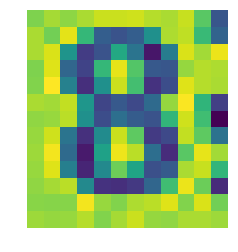

TB11V2bRVXXXXbhapXXXXXXXXXX_.jpg
1
(360.2, 562.2, 458.4, 801.6)


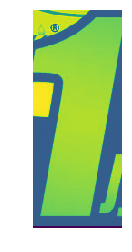

TB11V2bRVXXXXbhapXXXXXXXXXX_.jpg
送达
(616.0, 717.2, 643.4, 778.6)


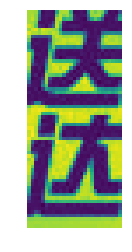

TB11wluLXXXXXaiaXXXunYpLFXX
韩后
(339.54, 395.48, 365.63, 449.46)


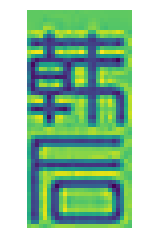

TB11wluLXXXXXaiaXXXunYpLFXX
韩后
(505.34, 434.35, 539.55, 485.33)


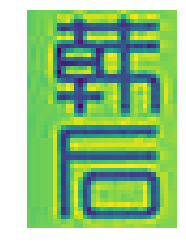

TB11wluLXXXXXaiaXXXunYpLFXX
hanhoo
(206.26, 296.36, 221.37, 386.15)


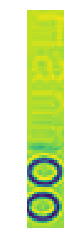

TB11wluLXXXXXaiaXXXunYpLFXX
毛孔清透洁面乳
(176.89, 396.48, 190.22, 479.66)


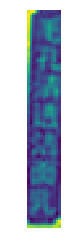

TB11wluLXXXXXaiaXXXunYpLFXX
H
(92.87, 621.21, 118.53, 647.64)


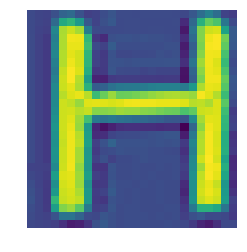

TB11wluLXXXXXaiaXXXunYpLFXX
P
(94.04, 283.14, 120.47, 338.9)


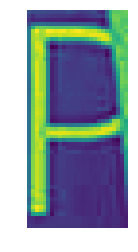

TB11wluLXXXXXaiaXXXunYpLFXX
g
(305.33, 290.75, 319.54, 314.3)


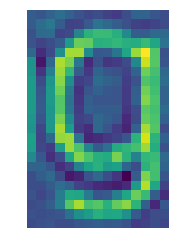

TB11XRcLXXXXXbnXFXXunYpLFXX
冰肌如玉
(388.0, 334.67, 409.0, 427.67)


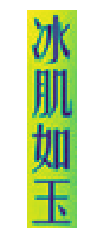

TB11YsYcI2vU1JjSZFwXXX2cpXa_!!0-item_pic.jpg
具
(665.18, 308.79, 780.18, 473.79)


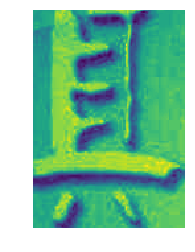

TB11YsYcI2vU1JjSZFwXXX2cpXa_!!0-item_pic.jpg
匠
(29.84, 316.12, 143.51, 449.45)


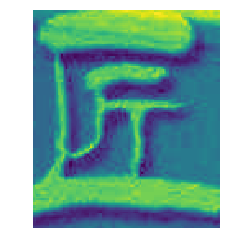

TB11zvwRVXXXXcKapXXXXXXXXXX_!!0-item_pic.jpg
一生
(163.87, 473.07, 190.5, 513.22)


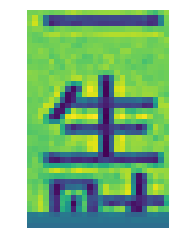

TB11zvwRVXXXXcKapXXXXXXXXXX_!!0-item_pic.jpg
一本
(284.44, 471.13, 311.08, 512.57)


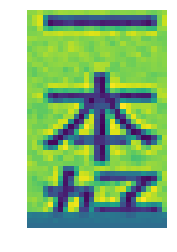

TB11zvwRVXXXXcKapXXXXXXXXXX_!!0-item_pic.jpg
个
(149.06, 169.37, 182.39, 211.58)


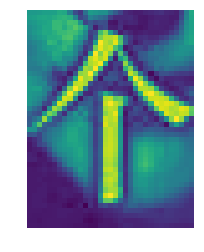

TB11zvwRVXXXXcKapXXXXXXXXXX_!!0-item_pic.jpg
的
(253.7, 100.82, 299.5, 148.21)


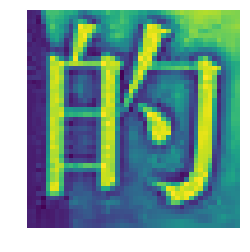

TB11zvwRVXXXXcKapXXXXXXXXXX_!!0-item_pic.jpg
一本好书
(210.43, 22.28, 232.83, 54.67)


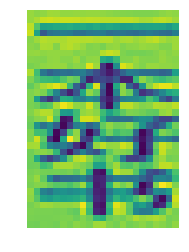

TB11zvwRVXXXXcKapXXXXXXXXXX_!!0-item_pic.jpg
木草草21
(323.85, 3.0, 358.65, 43.68)


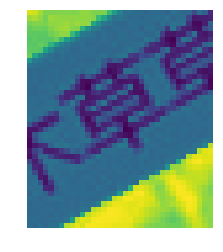

TB11zxuLXXXXXaiaXXXunYpLFXX
旗
(191.8, 82.4, 220.8, 111.4)


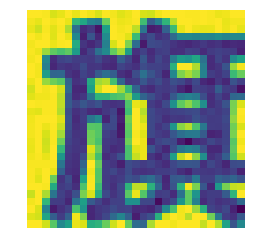

TB11zxuLXXXXXaiaXXXunYpLFXX
店
(275.8, 85.4, 303.8, 114.4)


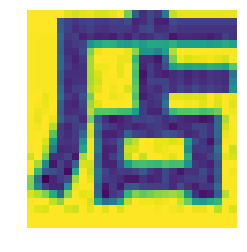

TB11zxuLXXXXXaiaXXXunYpLFXX
蒸
(426.8, 513.2, 439.8, 526.2)


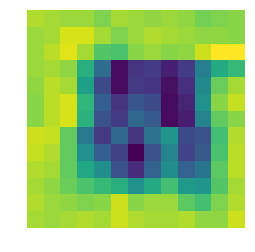

TB11_XPLXXXXXc8XXXXunYpLFXX
P
(428.58, 311.82, 449.01, 346.97)


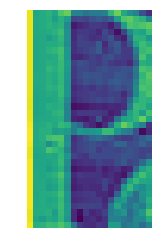

TB12.WOl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
福州老街
(496.48, 109.26, 558.55, 275.74)


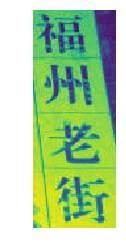

TB121nGezgy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
定时
(745.6, 629.4, 748.0, 651.2)


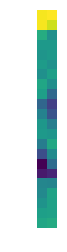

TB122JPLpXXXXbmapXXunYpLFXX
唯一QQ
(118.92, 85.11, 230.44, 210.27)


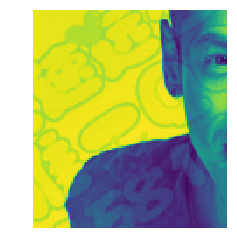

TB122JPLpXXXXbmapXXunYpLFXX
光速远营
(92.34, 52.01, 207.88, 175.02)


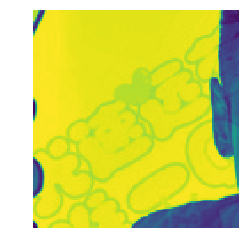

TB122JPLpXXXXbmapXXunYpLFXX
大星冠梦想
(391.63, 93.96, 497.59, 505.83)


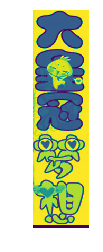

TB122JPLpXXXXbmapXXunYpLFXX
扫二维码套餐
(-6.16, -1.71, 108.08, 501.97)


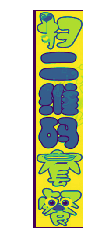

TB122zwdukJL1JjSZFmXXcw0XXa_!!0-item_pic.jpg
CGB
(570.25, 502.5, 579.75, 521.0)


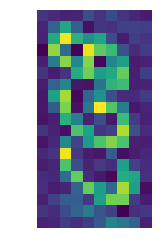

TB127VILXXXXXXmXFXXunYpLFXX
新店0利润
(5.38, 83.7, 50.24, 365.35)


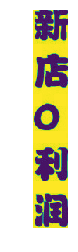

TB127VILXXXXXXmXFXXunYpLFXX
木品
(333.61, 208.27, 345.64, 234.2)


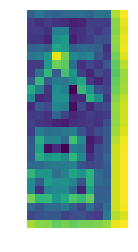

TB127VILXXXXXXmXFXXunYpLFXX
本品
(330.18, 270.18, 342.64, 293.83)


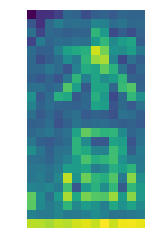

TB1296ugjnD8KJjSspbXXbbEXXa_!!2-item_pic.png
奖
(299.67, 422.11, 329.11, 453.67)


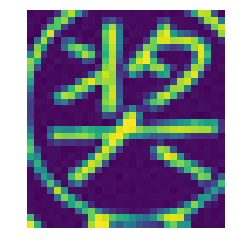

TB1296ugjnD8KJjSspbXXbbEXXa_!!2-item_pic.png
Prize
(337.89, 415.0, 362.22, 480.11)


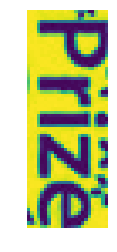

TB1296ugjnD8KJjSspbXXbbEXXa_!!2-item_pic.png
L
(392.56, 677.22, 414.0, 721.0)


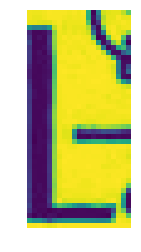

TB1297Te_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
K
(435.38, 163.66, 464.62, 200.11)


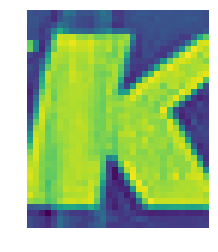

TB1297Te_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
K
(458.31, 540.84, 491.66, 585.8)


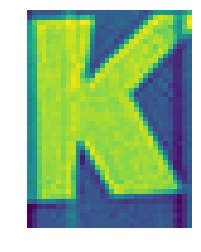

TB1297Te_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
T
(338.46, 548.75, 373.3, 596.99)


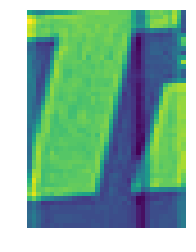

TB1297Te_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
T
(329.32, 163.58, 344.55, 201.72)


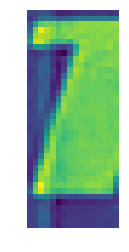

TB1297Te_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
!
(326.59, 258.52, 333.75, 276.09)


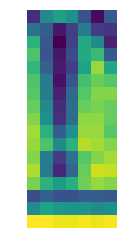

TB1297Te_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
!
(332.1, 675.85, 341.56, 696.67)


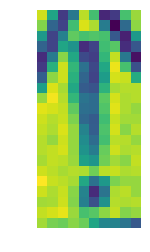

TB12A0PLXXXXXc3XXXXunYpLFXX
3
(136.43, 344.68, 166.66, 378.68)


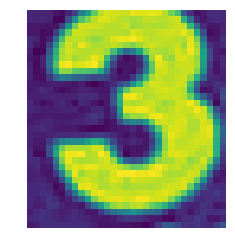

TB12A0PLXXXXXc3XXXXunYpLFXX
4
(167.02, 341.91, 194.61, 369.55)


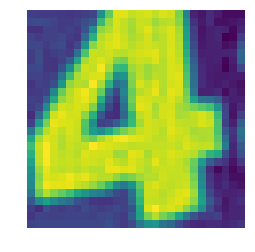

TB12A0PLXXXXXc3XXXXunYpLFXX
130
(478.61, 361.68, 482.7, 379.77)


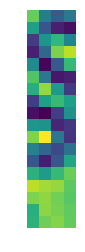

TB12A0PLXXXXXc3XXXXunYpLFXX
140
(460.61, 377.05, 469.39, 396.5)


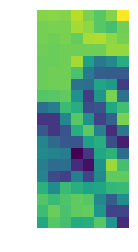

TB12A0PLXXXXXc3XXXXunYpLFXX
110
(483.75, 314.64, 499.07, 332.05)


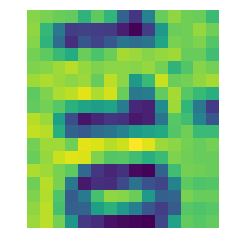

TB12A0PLXXXXXc3XXXXunYpLFXX
120
(485.43, 337.86, 498.39, 358.59)


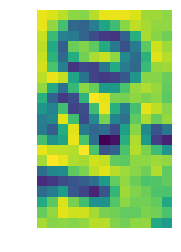

TB12AtwLXXXXXc9XVXXunYpLFXX
Jordan*
(51.57, 555.43, 83.86, 671.86)


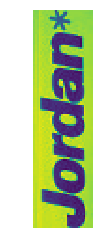

TB12AtwLXXXXXc9XVXXunYpLFXX
S
(157.57, 337.57, 166.0, 346.14)


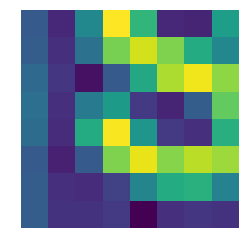

TB12bBvLXXXXXXYaXXXunYpLFXX
ORMAN
(52.82, 125.73, 228.55, 316.82)


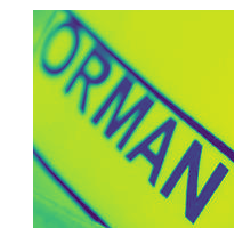

TB12BXSLXXXXXbQXXXXunYpLFXX
两瓶包邮
(19.85, 13.64, 78.97, 234.22)


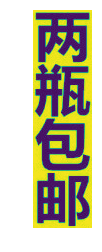

TB12BXSLXXXXXbQXXXXunYpLFXX
裹馒头
(442.37, 375.36, 483.31, 495.74)


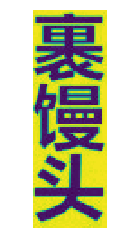

TB12BXSLXXXXXbQXXXXunYpLFXX
、
(468.59, 349.52, 480.63, 362.56)


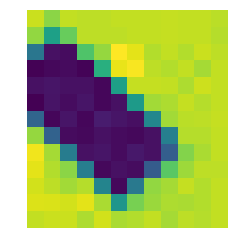

TB12BXSLXXXXXbQXXXXunYpLFXX
蒸菜
(438.29, 249.4, 483.31, 342.18)


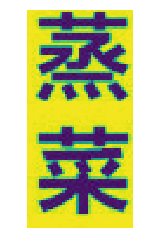

TB12BXSLXXXXXbQXXXXunYpLFXX
拌面
(444.29, 132.94, 480.85, 212.14)


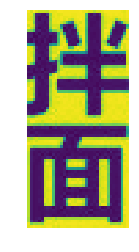

TB12BXSLXXXXXbQXXXXunYpLFXX
、
(465.75, 107.1, 477.17, 121.6)


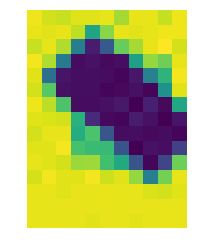

TB12BXSLXXXXXbQXXXXunYpLFXX
下饭
(438.29, 16.94, 485.39, 97.84)


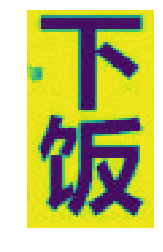

TB12C0KLXXXXXcbXpXXunYpLFXX
E
(624.33, 267.33, 632.67, 278.0)


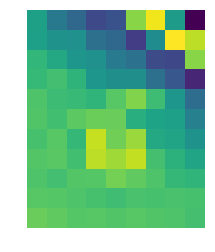

TB12C0KLXXXXXcbXpXXunYpLFXX
送
(17.67, 155.67, 112.67, 251.0)


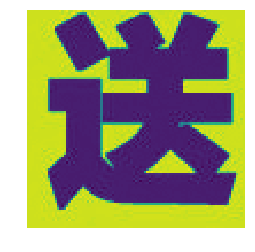

TB12Ct5d_J_SKJjSZPiSFP3LpXa
`s
(310.28, 11.62, 361.55, 79.73)


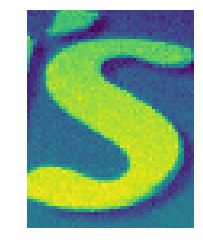

TB12cXELXXXXXcuXFXXunYpLFXX
正品保证
(34.5, 31.09, 87.05, 201.36)


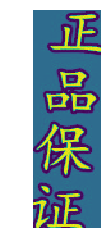

TB12cXELXXXXXcuXFXXunYpLFXX
最新日期
(-2.68, 232.18, 64.23, 421.45)


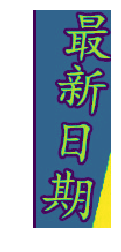

TB12cXELXXXXXcuXFXXunYpLFXX
醇
(333.45, 380.58, 349.45, 397.79)


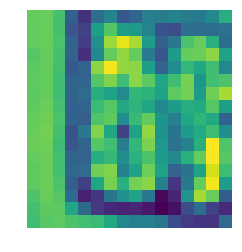

TB12cXELXXXXXcuXFXXunYpLFXX
纯
(362.71, 380.58, 377.71, 398.05)


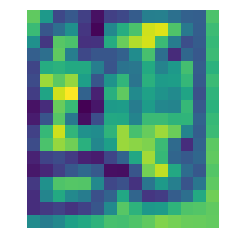

TB12DhCLXXXXXclXFXXunYpLFXX
Gateway
(548.38, 174.0, 570.13, 277.0)


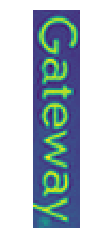

TB12DhCLXXXXXclXFXXunYpLFXX
7300405033
(295.88, 136.25, 310.13, 206.25)


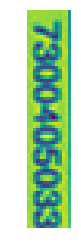

TB12DhCLXXXXXclXFXXunYpLFXX
GR
(299.73, 222.86, 307.3, 241.0)


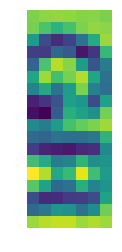

TB12DhCLXXXXXclXFXXunYpLFXX
RFV:A02
(299.13, 250.0, 307.88, 288.5)


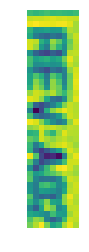

TB12DhCLXXXXXclXFXXunYpLFXX
N136
(439.63, 238.39, 449.66, 259.29)


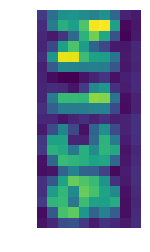

TB12DhCLXXXXXclXFXXunYpLFXX
N20757
(439.09, 269.46, 447.13, 300.46)


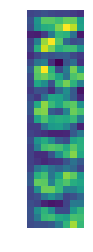

TB12DhCLXXXXXclXFXXunYpLFXX
041200-00
(373.13, 122.68, 382.23, 188.04)


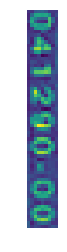

TB12DhCLXXXXXclXFXXunYpLFXX
D
(323.84, 259.89, 337.09, 274.68)


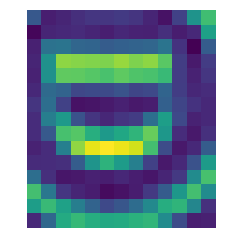

TB12EJDLXXXXXccXFXXunYpLFXX
萱姿
(439.0, 414.33, 447.33, 440.0)


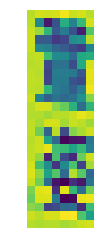

TB12EJDLXXXXXccXFXXunYpLFXX
GL1256
(453.45, 534.09, 463.36, 599.82)


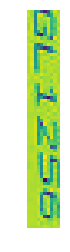

TB12FhxLXXXXXb6XVXXunYpLFXX
益味清香体露
(579.45, 181.18, 630.27, 482.55)


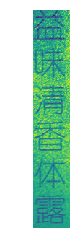

TB12FhxLXXXXXb6XVXXunYpLFXX
香体洁肤
(477.2, 410.53, 496.8, 473.13)


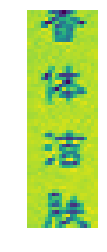

TB12FhxLXXXXXb6XVXXunYpLFXX
香尊
(460.4, 183.93, 522.8, 352.93)


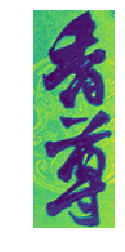

TB12FhxLXXXXXb6XVXXunYpLFXX
?
(518.13, 180.8, 527.73, 191.4)


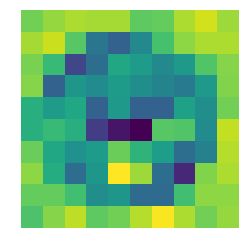

TB12FhxLXXXXXb6XVXXunYpLFXX
?
(401.8, 151.4, 407.27, 159.4)


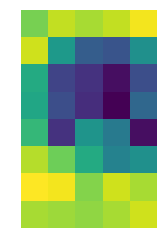

TB12FhxLXXXXXb6XVXXunYpLFXX
香尊
(262.2, 370.67, 293.47, 459.2)


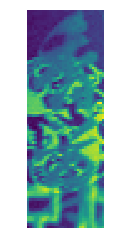

TB12FhxLXXXXXb6XVXXunYpLFXX
?
(294.53, 365.93, 302.2, 380.73)


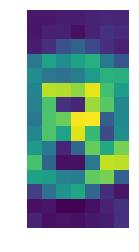

TB12FhxLXXXXXb6XVXXunYpLFXX
香尊
(117.13, 364.33, 150.47, 461.73)


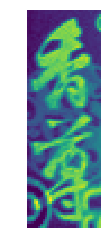

TB12FhxLXXXXXb6XVXXunYpLFXX
?
(149.47, 362.2, 157.2, 374.93)


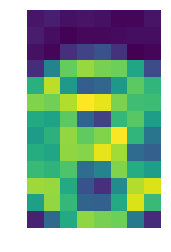

TB12FhxLXXXXXb6XVXXunYpLFXX
抑香除臭
(501.67, 408.67, 521.0, 476.67)


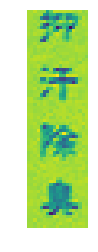

TB12FJkLXXXXXXgaFXXunYpLFXX
元
(214.37, 756.07, 261.21, 806.82)


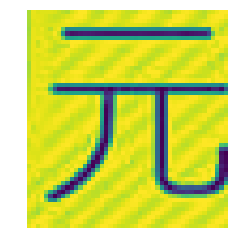

TB12FJkLXXXXXXgaFXXunYpLFXX
kg
(455.75, 254.73, 469.37, 268.69)


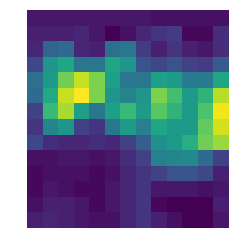

TB12FlCLXXXXXX9XVXXunYpLFXX
！
(635.13, 17.5, 666.13, 65.25)


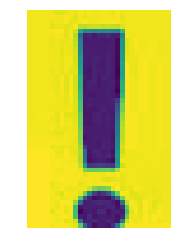

TB12FlCLXXXXXX9XVXXunYpLFXX
？
(696.63, 17.75, 734.63, 66.0)


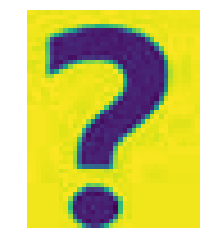

TB12FlCLXXXXXX9XVXXunYpLFXX
灸
(528.84, 441.5, 560.2, 482.05)


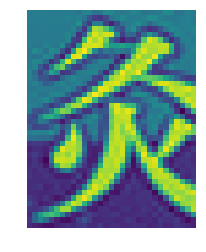

TB12FlCLXXXXXX9XVXXunYpLFXX
怕打针
(544.48, 363.77, 566.89, 411.14)


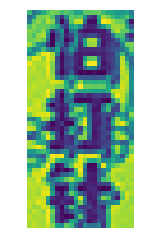

TB12FlCLXXXXXX9XVXXunYpLFXX
怕吃药
(564.2, 322.86, 580.57, 371.23)


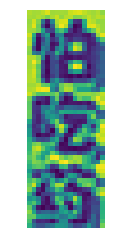

TB12FlCLXXXXXX9XVXXunYpLFXX
怕吃药
(677.75, 331.36, 694.75, 377.0)


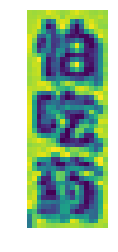

TB12FlCLXXXXXX9XVXXunYpLFXX
怕打针
(663.75, 368.86, 680.75, 411.09)


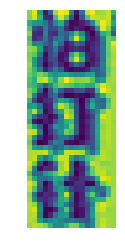

TB12FlCLXXXXXX9XVXXunYpLFXX
灸
(647.11, 438.09, 682.43, 474.82)


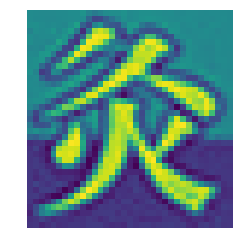

TB12FlCLXXXXXX9XVXXunYpLFXX
艾
(412.48, 260.77, 434.3, 284.32)


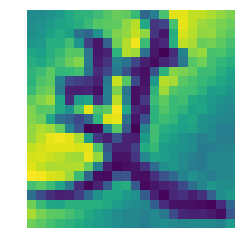

TB12FlCLXXXXXX9XVXXunYpLFXX
针
(411.8, 294.23, 427.89, 322.45)


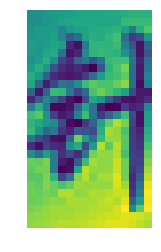

TB12FlCLXXXXXX9XVXXunYpLFXX
中
(467.02, 361.36, 473.52, 369.86)


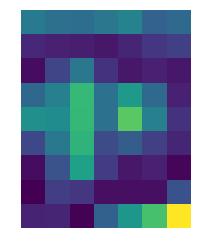

TB12FlCLXXXXXX9XVXXunYpLFXX
4
(593.24, 412.85, 604.05, 430.73)


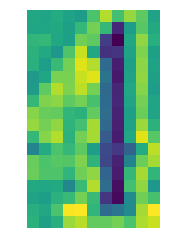

TB12FlCLXXXXXX9XVXXunYpLFXX
4
(704.01, 411.17, 714.24, 428.48)


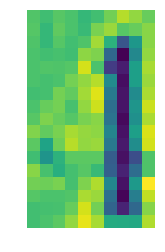

TB12GfbXHWi31JjSZJiXXbRspXa_!!0-item_pic.jpg
贝亲
(254.2, 38.8, 291.6, 107.8)


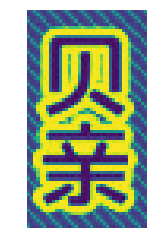

TB12GfbXHWi31JjSZJiXXbRspXa_!!0-item_pic.jpg
彩绘奶瓶
(516.4, 246.2, 600.0, 545.6)


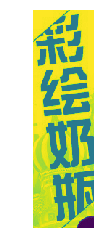

TB12GfbXHWi31JjSZJiXXbRspXa_!!0-item_pic.jpg
迪士尼
(603.4, 245.8, 692.6, 461.0)


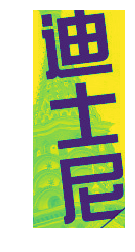

TB12h0ELXXXXXb2XFXXunYpLFXX
1
(66.16, 445.72, 78.4, 470.4)


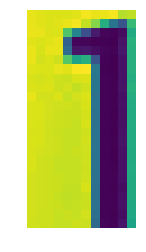

TB12h0ELXXXXXb2XFXXunYpLFXX
2
(130.52, 447.08, 151.64, 472.04)


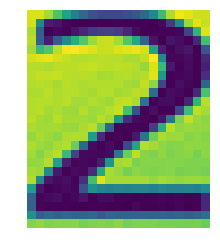

TB12h0ELXXXXXb2XFXXunYpLFXX
3
(198.0, 445.08, 220.48, 473.4)


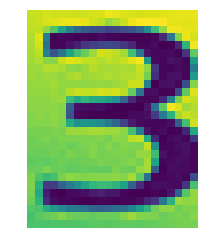

TB12h0ELXXXXXb2XFXXunYpLFXX
4
(61.68, 482.92, 83.52, 506.88)


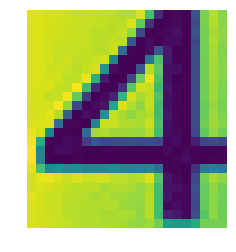

TB12h0ELXXXXXb2XFXXunYpLFXX
5
(133.52, 481.56, 152.36, 508.88)


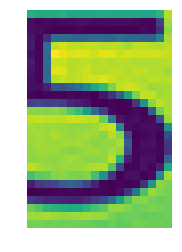

TB12h0ELXXXXXb2XFXXunYpLFXX
7
(62.4, 516.2, 85.52, 542.8)


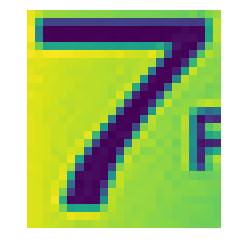

TB12h0ELXXXXXb2XFXXunYpLFXX
8
(131.16, 515.48, 153.0, 540.8)


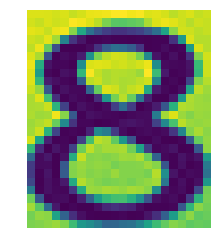

TB12h0ELXXXXXb2XFXXunYpLFXX
9
(201.0, 516.84, 222.48, 543.44)


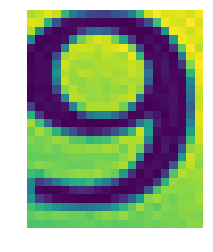

TB12h0ELXXXXXb2XFXXunYpLFXX
0
(131.6, 552.4, 156.28, 579.0)


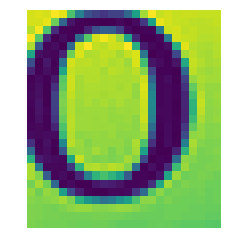

TB12h0ELXXXXXb2XFXXunYpLFXX
#
(198.44, 548.76, 224.76, 577.64)


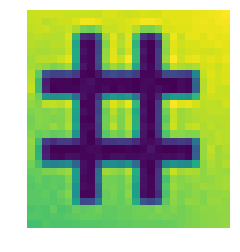

TB12h0ELXXXXXb2XFXXunYpLFXX
振动马达
(623.32, 456.32, 641.68, 508.16)


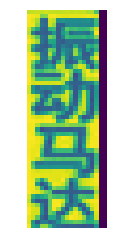

TB12h0ELXXXXXb2XFXXunYpLFXX
强
(616.2, 384.36, 640.68, 412.24)


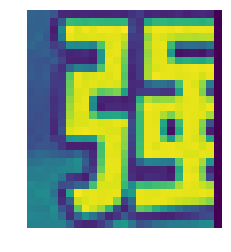

TB12h0ELXXXXXb2XFXXunYpLFXX
时
(621.2, 343.4, 642.68, 371.92)


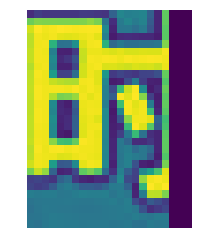

TB12h0ELXXXXXb2XFXXunYpLFXX
纳
(619.56, 298.32, 637.68, 327.12)


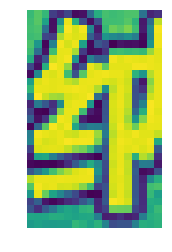

TB12h0ELXXXXXb2XFXXunYpLFXX
1
(585.6, 216.2, 588.4, 223.4)


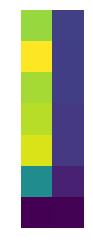

TB12h0ELXXXXXb2XFXXunYpLFXX
2
(600.0, 215.6, 606.0, 223.8)


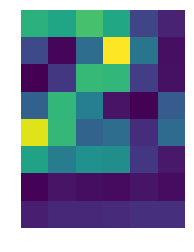

TB12h0ELXXXXXb2XFXXunYpLFXX
3
(615.0, 216.6, 620.2, 223.8)


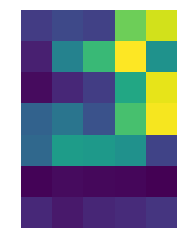

TB12h0ELXXXXXb2XFXXunYpLFXX
5
(599.4, 224.0, 603.8, 230.0)


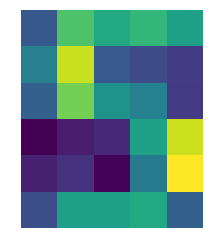

TB12h0ELXXXXXb2XFXXunYpLFXX
0
(599.0, 241.0, 604.6, 247.4)


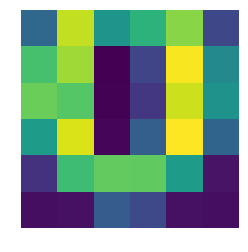

TB12h0ELXXXXXb2XFXXunYpLFXX
#
(614.6, 240.0, 620.8, 247.0)


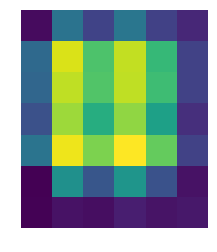

TB12J8ELXXXXXb6XFXXunYpLFXX
效
(387.7, 341.08, 397.5, 351.48)


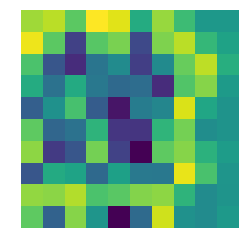

TB12J8ELXXXXXb6XFXXunYpLFXX
持续控油
(126.94, 152.4, 209.46, 365.52)


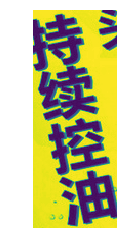

TB12J8ELXXXXXb6XFXXunYpLFXX
抗痘
(-1.26, 84.2, 106.06, 251.96)


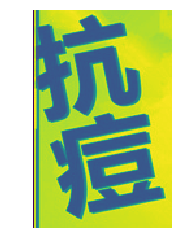

TB12J8ELXXXXXb6XFXXunYpLFXX
去黑头
(167.82, 60.28, 237.86, 196.36)


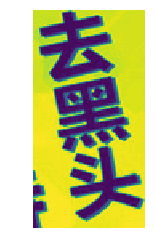

TB12k6LhN6I8KJjy0FgXXXXzVXa_!!2-item_pic.png
送赠品
(109.0, 502.67, 166.0, 708.0)


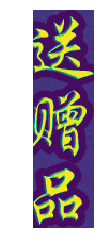

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
7
(500.5, 209.0, 510.5, 221.0)


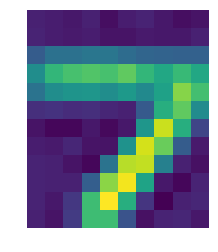

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
8
(540.5, 213.0, 551.5, 226.0)


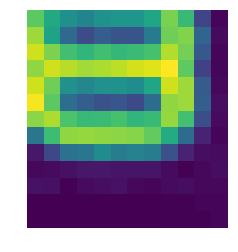

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
6
(580.5, 168.0, 589.5, 184.0)


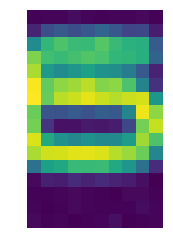

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
2
(538.5, 128.0, 549.5, 141.0)


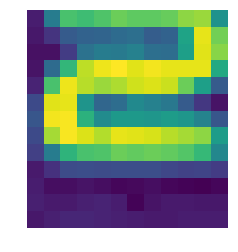

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
3
(575.5, 125.0, 589.5, 144.0)


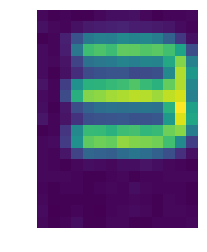

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
服
(151.5, 618.0, 174.5, 644.0)


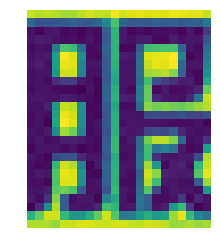

TB12K7bl_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
城
(148.5, 578.0, 174.5, 604.0)


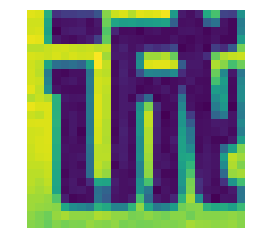

TB12K8PLXXXXXb9XXXXunYpLFXX
小号
(3.0, 1.0, 42.8, 45.4)


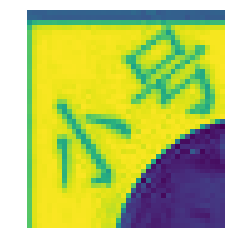

TB12K8PLXXXXXb9XXXXunYpLFXX
大号
(144.0, 140.67, 210.67, 209.2)


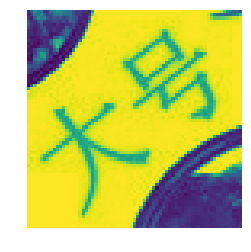

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
VE194
(387.52, 469.42, 412.75, 509.42)


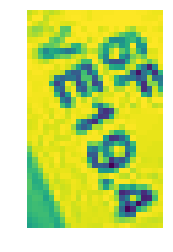

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
6F
(400.28, 470.84, 414.17, 488.85)


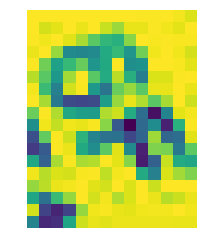

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
V0.8
(409.5, 459.49, 429.35, 489.27)


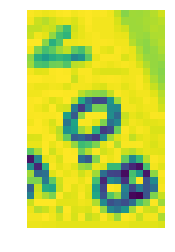

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
525A1C35A
(367.25, 420.78, 400.99, 465.45)


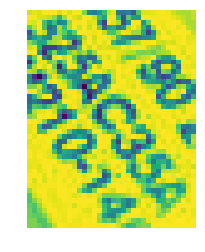

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
100%
(610.05, 619.75, 632.57, 655.91)


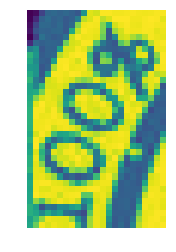

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
0%
(611.59, 664.42, 621.23, 684.27)


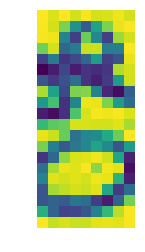

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
100%
(643.08, 614.07, 687.75, 668.38)


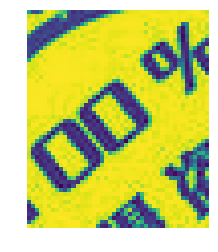

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
100%
(674.7, 655.2, 722.08, 710.09)


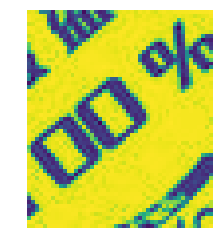

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
100%
(733.97, 649.53, 744.48, 685.98)


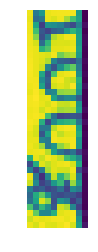

TB12KdJNVXXXXbwXpXXXXXXXXXX_!!0-item_pic.jpg
100%
(714.54, 688.53, 728.72, 722.56)


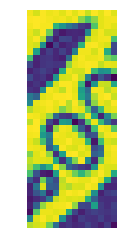

TB12KLkkxPI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
V474
(434.5, 153.0, 508.5, 242.0)


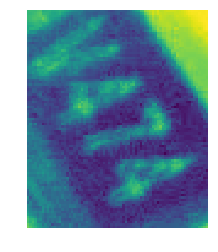

TB12KLkkxPI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
V474
(272.5, 240.0, 349.5, 331.0)


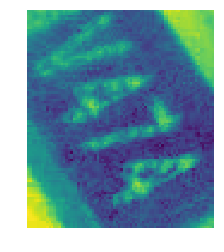

TB12KLkkxPI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
3
(449.6, 684.6, 481.6, 727.0)


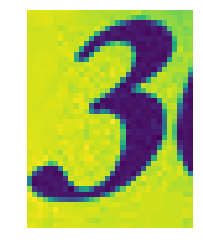

TB12KLkkxPI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
6
(473.4, 680.6, 508.6, 723.0)


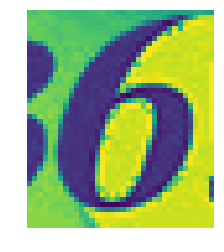

TB12KLkkxPI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
5
(510.0, 692.4, 531.2, 724.4)


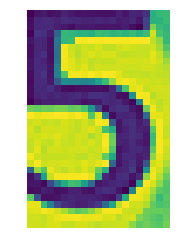

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
辫子姐姐
(630.18, 244.36, 645.36, 291.18)


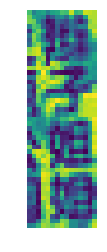

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
主题公园
(619.18, 245.55, 636.36, 293.27)


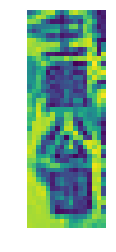

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
2
(625.73, 293.45, 644.36, 326.0)


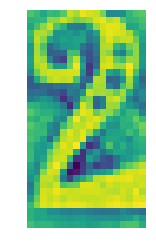

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
郁雨君作品
(641.0, 561.91, 658.18, 621.82)


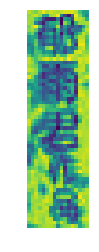

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
梭梭拉拉最要好
(625.82, 353.36, 655.18, 515.91)


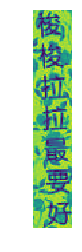

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
18cm
(1073.09, 206.18, 1107.55, 309.55)


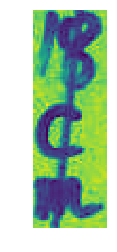

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
20cm
(1112.55, 212.91, 1145.18, 310.55)


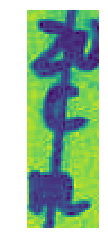

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
26.5cm
(1164.36, 217.09, 1192.09, 314.0)


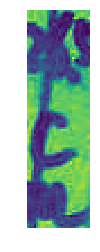

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
辫子姐姐
(726.0, 300.0, 748.73, 356.64)


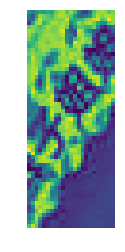

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
主题公园
(757.45, 266.27, 786.0, 312.91)


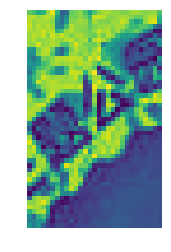

TB12KnKdkfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
2号
(790.45, 258.45, 808.73, 282.45)


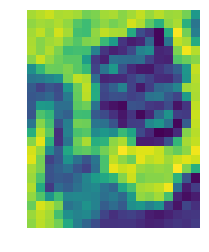

TB12kNsLXXXXXbNaXXXunYpLFXX
强效
(127.54, 85.85, 150.23, 127.61)


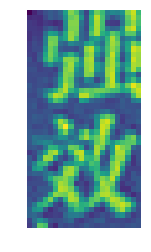

TB12kNsLXXXXXbNaXXXunYpLFXX
药王
(268.35, 132.77, 394.63, 408.83)


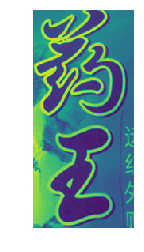

TB12kNsLXXXXXbNaXXXunYpLFXX
远红外贴
(380.37, 279.32, 414.28, 418.03)


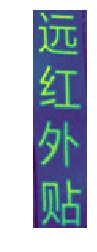

TB12MRFLXXXXXaWXFXXunYpLFXX
1
(202.33, 214.67, 211.33, 225.0)


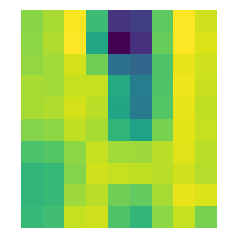

TB12MRFLXXXXXaWXFXXunYpLFXX
2
(211.67, 210.67, 223.0, 223.67)


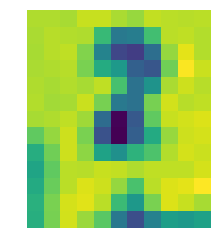

TB12MRFLXXXXXaWXFXXunYpLFXX
5
(256.67, 209.33, 265.0, 222.67)


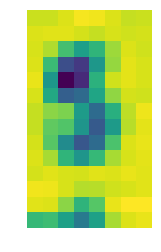

TB12MRFLXXXXXaWXFXXunYpLFXX
6
(269.0, 213.0, 279.0, 225.0)


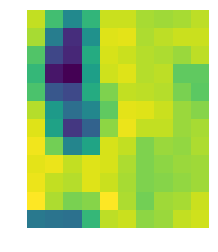

TB12P4QLpXXXXcCapXXunYpLFXX
正品保障
(74.84, 20.45, 154.51, 157.45)


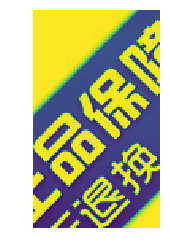

TB12P4QLpXXXXcCapXXunYpLFXX
天退换
(91.18, 102.12, 144.18, 185.45)


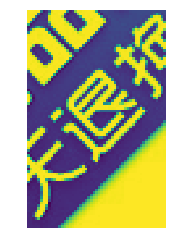

TB12pMzQFXXXXX4XVXXXXXXXXXX_!!0-item_pic.jpg
4
(5.14, 720.94, 64.86, 782.37)


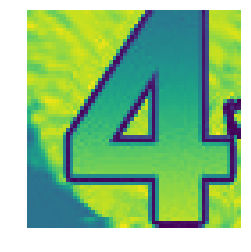

TB12pMzQFXXXXX4XVXXXXXXXXXX_!!0-item_pic.jpg
:
(113.24, 672.35, 130.44, 705.35)


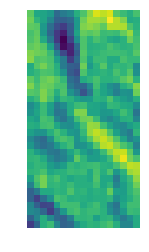

TB12q0VLpXXXXa3aXXXunYpLFXX
adidas
(641.5, 372.0, 686.5, 457.0)


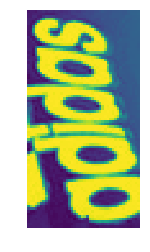

TB12q0VLpXXXXa3aXXXunYpLFXX
kg
(249.5, 313.0, 267.5, 334.0)


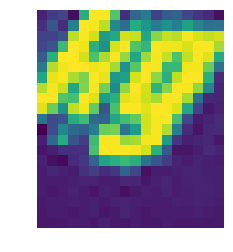

TB12q8FLXXXXXarXFXXunYpLFXX
麻
(591.5, 42.0, 629.5, 81.0)


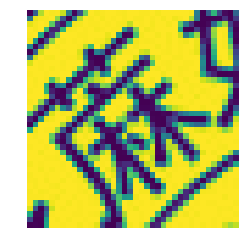

TB12q8FLXXXXXarXFXXunYpLFXX
馆
(718.5, 64.0, 756.5, 105.0)


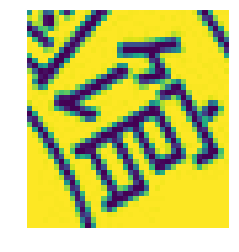

TB12q8FLXXXXXarXFXXunYpLFXX
zhima
(572.5, 145.0, 609.5, 197.0)


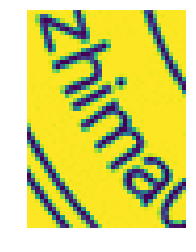

TB12qtDLXXXXXc.XFXXunYpLFXX
?
(739.02, 545.71, 772.55, 593.71)


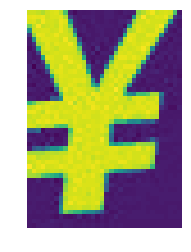

TB12R4VLXXXXXXLXXXXunYpLFXX
3
(15.79, 58.86, 60.79, 128.98)


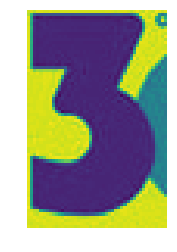

TB12R4VLXXXXXXLXXXXunYpLFXX
Q
(46.12, 63.87, 109.77, 137.98)


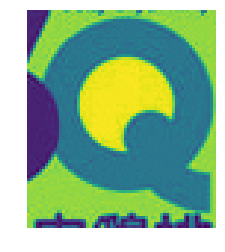

TB12rJsLXXXXXaNaXXXunYpLFXX
82
(603.43, 765.48, 655.76, 819.14)


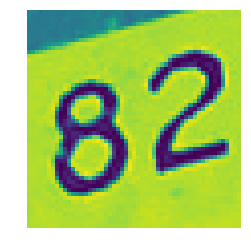

TB12rJsLXXXXXaNaXXXunYpLFXX
1
(883.4, 699.81, 906.43, 747.6)


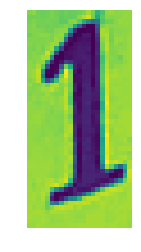

TB12sRHLXXXXXc5XpXXunYpLFXX
2
(537.0, 640.8, 547.6, 658.6)


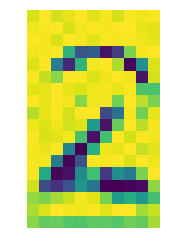

TB12sRHLXXXXXc5XpXXunYpLFXX
4
(539.6, 562.4, 549.8, 572.8)


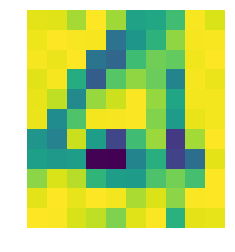

TB12t03aGagSKJjy0FhXXcrbFXa_!!0-item_pic.jpg
3
(382.44, 310.66, 422.87, 359.78)


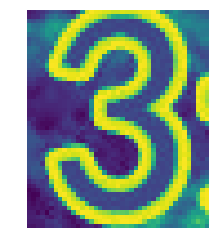

TB12TFyLXXXXXbwXVXXunYpLFXX
1
(221.95, 302.55, 247.58, 357.91)


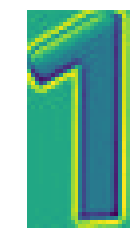

TB12tHylSfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
保量
(401.67, 38.32, 438.17, 75.73)


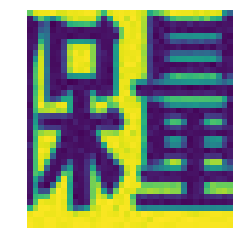

TB12tHylSfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
杭州南颜贸易有限公司
(3.06, 111.01, 65.7, 265.78)


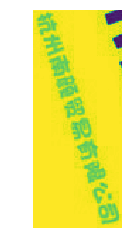

TB12tHylSfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
杭州南颜贸易有限公司
(31.67, 32.06, 269.31, 517.78)


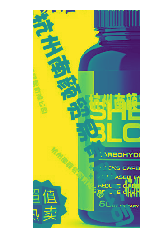

TB12tHylSfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
热
(12.09, 470.65, 44.91, 503.84)


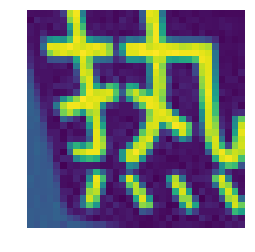

TB12tVzLXXXXXbqXFXXunYpLFXX
5
(328.96, 92.95, 397.57, 172.53)


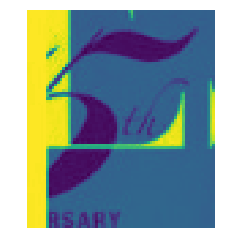

TB12ulHj_vI8KJjSspjXXcgjXXa_!!0-item_pic.jpg
领劵价
(622.33, 670.0, 642.0, 717.33)


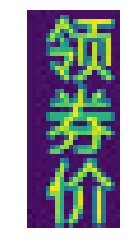

TB12ulHj_vI8KJjSspjXXcgjXXa_!!0-item_pic.jpg
?
(622.33, 722.33, 643.67, 743.67)


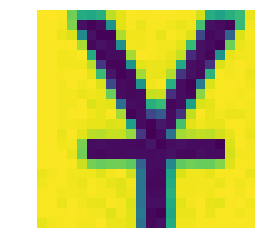

TB12vdCLXXXXXXXXVXXunYpLFXX
铺
(3.11, 8.11, 14.74, 21.27)


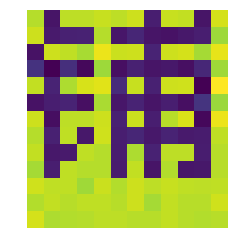

TB12vdCLXXXXXXXXVXXunYpLFXX
宝
(1.77, 98.7, 9.1, 110.45)


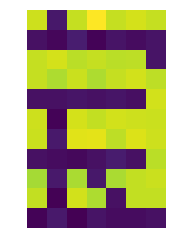

TB12vdCLXXXXXXXXVXXunYpLFXX
联
(103.45, 39.42, 127.13, 65.51)


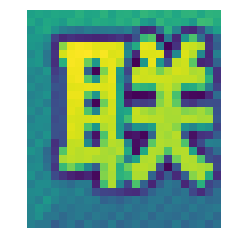

TB12vdCLXXXXXXXXVXXunYpLFXX
元
(492.67, 59.16, 505.48, 74.38)


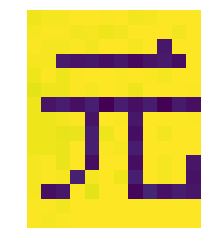

TB12VXyLXXXXXb5XVXXunYpLFXX
￥
(363.89, 716.44, 379.22, 736.22)


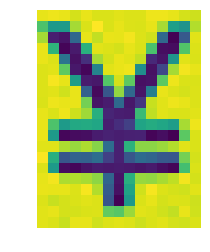

TB12wFDLXXXXXaZXFXXunYpLFXX
麻
(515.12, 273.54, 525.81, 284.77)


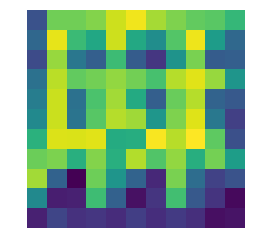

TB12wFDLXXXXXaZXFXXunYpLFXX
辣
(513.81, 302.15, 523.04, 317.0)


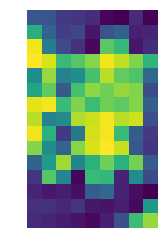

TB12wFDLXXXXXaZXFXXunYpLFXX
辣
(508.04, 363.54, 519.42, 377.85)


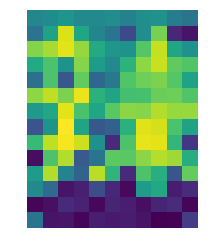

TB12wFDLXXXXXaZXFXXunYpLFXX
辣
(505.88, 421.15, 519.73, 436.54)


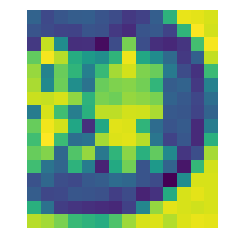

TB12wFDLXXXXXaZXFXXunYpLFXX
辣
(502.19, 479.85, 514.96, 494.23)


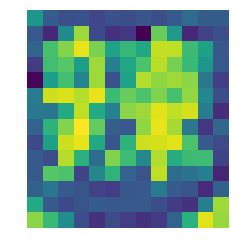

TB12wFDLXXXXXaZXFXXunYpLFXX
S
(429.12, 496.31, 452.65, 526.38)


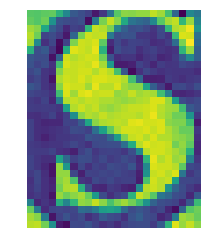

TB12wFDLXXXXXaZXFXXunYpLFXX
辣
(177.5, 364.0, 191.88, 378.38)


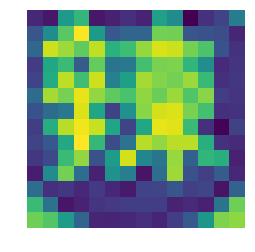

TB12wFDLXXXXXaZXFXXunYpLFXX
麻
(178.58, 393.69, 190.96, 407.0)


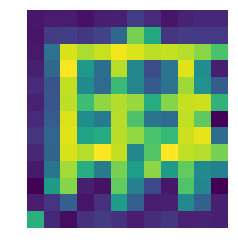

TB12wFDLXXXXXaZXFXXunYpLFXX
麻
(182.27, 452.92, 193.65, 469.38)


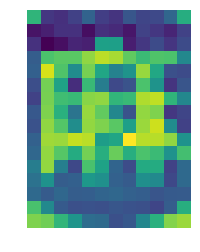

TB12wFDLXXXXXaZXFXXunYpLFXX
辣
(183.96, 541.77, 199.35, 557.69)


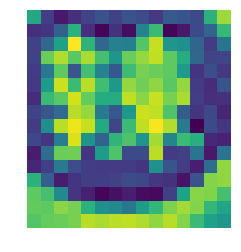

TB12wFDLXXXXXaZXFXXunYpLFXX
重
(177.91, 101.69, 220.66, 154.06)


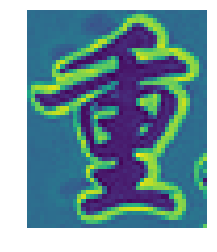

TB12wFDLXXXXXaZXFXXunYpLFXX
庆
(215.09, 123.13, 248.28, 174.06)


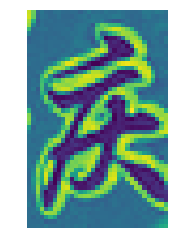

TB12wFDLXXXXXaZXFXXunYpLFXX
味
(200.41, 173.0, 242.97, 223.31)


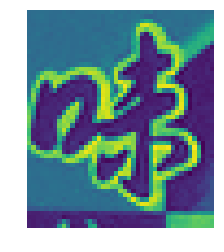

TB12WVALXXXXXaPXVXXunYpLFXX
?
(597.0, 751.8, 623.8, 784.4)


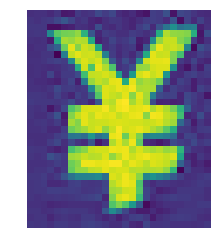

TB12xPQfffM8KJjSZPfXXbklXXa_!!0-item_pic.jpg
著
(196.58, 135.33, 205.53, 146.06)


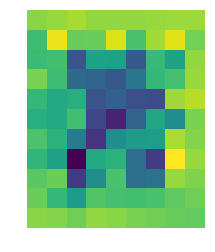

TB12YtVLXXXXXX_XXXXunYpLFXX
质量保证
(615.36, 478.68, 694.44, 831.0)


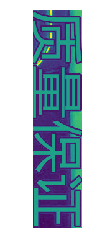

TB12YtVLXXXXXX_XXXXunYpLFXX
三年保修
(614.64, 80.08, 702.44, 434.52)


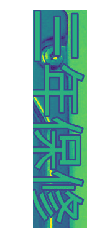

TB12YtVLXXXXXX_XXXXunYpLFXX
希捷原厂服务器硬盘
(22.52, 47.76, 126.8, 838.44)


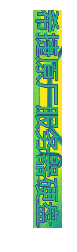

TB12zbNNXXXXXamaXXXQtxZ7VXX
35
(38.54, 17.64, 189.06, 170.94)


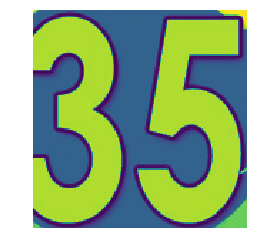

TB12_0yLXXXXXbpXVXXunYpLFXX
手工精制传统清素糕点
(278.0, 157.33, 311.0, 577.33)


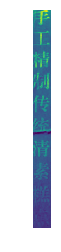

TB12_0yLXXXXXbpXVXXunYpLFXX
青州市隆盛糕点厂制
(518.33, 137.67, 564.0, 444.33)


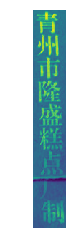

TB12_0yLXXXXXbpXVXXunYpLFXX
云门山南路五000七号
(530.33, 454.0, 570.67, 784.0)


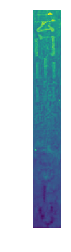

TB12_0yLXXXXXbpXVXXunYpLFXX
长寿糕
(347.0, 147.33, 481.0, 589.33)


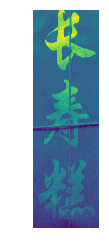

TB12_0yLXXXXXbpXVXXunYpLFXX
长
(673.67, 276.0, 713.33, 356.33)


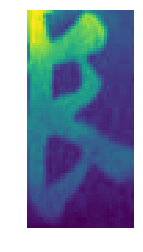

TB12_0yLXXXXXbpXVXXunYpLFXX
寿
(660.0, 369.0, 720.33, 456.33)


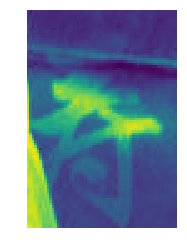

TB12_6edkfb_uJkSnb4XXXCrXXa_!!0-item_pic.jpg
CAMOZZI
(250.11, 121.89, 264.11, 156.56)


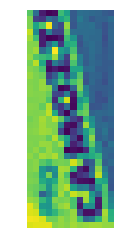

TB12_6edkfb_uJkSnb4XXXCrXXa_!!0-item_pic.jpg
CAMOZZI
(248.78, 50.89, 261.11, 83.89)


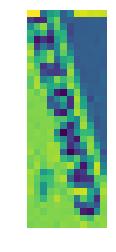

TB12_8tLXXXXXboaXXXunYpLFXX
?
(329.0, 560.43, 337.57, 571.29)


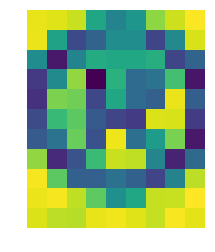

TB12_8tLXXXXXboaXXXunYpLFXX
STRAIN
(330.43, 550.14, 364.71, 613.29)


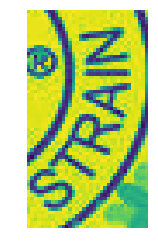

TB12_8tLXXXXXboaXXXunYpLFXX
RESE
(247.14, 550.43, 272.57, 598.0)


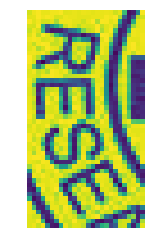

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
7
(482.9, 442.77, 507.36, 468.77)


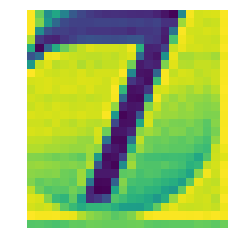

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
8
(519.45, 442.04, 539.09, 466.77)


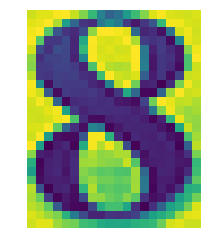

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
9
(553.9, 440.77, 573.45, 470.22)


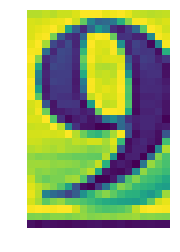

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
5
(516.72, 476.68, 538.54, 503.13)


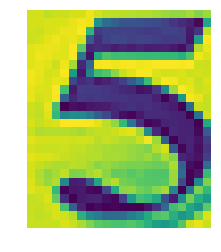

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
6
(555.81, 475.68, 577.45, 504.86)


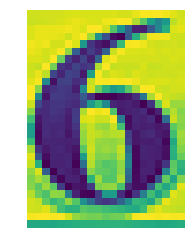

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
1
(485.81, 514.77, 506.18, 541.22)


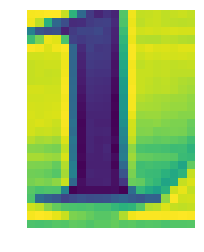

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
3
(556.81, 512.77, 577.18, 539.5)


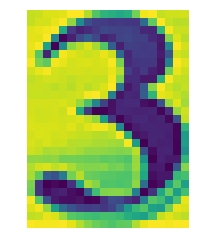

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
0
(481.54, 547.95, 506.9, 575.86)


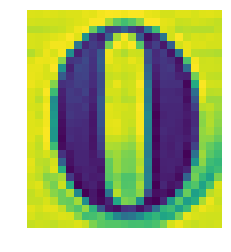

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
.
(525.27, 557.41, 535.45, 567.86)


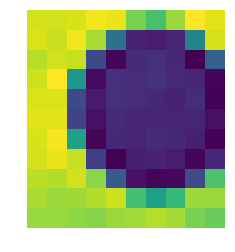

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
?
(255.72, 173.43, 318.63, 241.79)


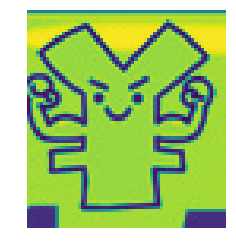

TB12_cESXXXXXXIaVXXXXXXXXXX_!!0-item_pic.jpg
?
(157.72, 511.59, 167.45, 522.77)


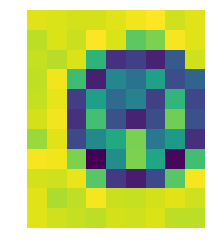

TB12_lOLXXXXXXPXpXXunYpLFXX
淘宝店
(175.13, 788.0, 203.63, 872.75)


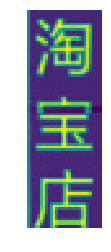

TB12_lOLXXXXXXPXpXXunYpLFXX
盛業機械
(70.63, 447.25, 167.88, 903.25)


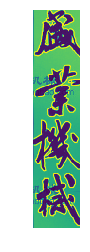

TB12_ppLXXXXXXpapXXunYpLFXX
正
(552.78, 763.85, 606.57, 827.97)


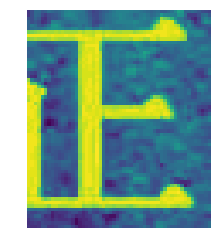

TB12_ppLXXXXXXpapXXunYpLFXX
品
(649.68, 764.85, 708.29, 825.97)


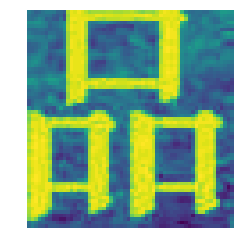

TB12_ppLXXXXXXpapXXunYpLFXX
京
(397.46, 278.28, 455.58, 345.08)


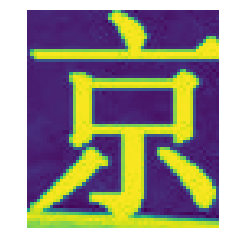

TB12_ppLXXXXXXpapXXunYpLFXX
黑
(498.35, 278.45, 557.82, 343.91)


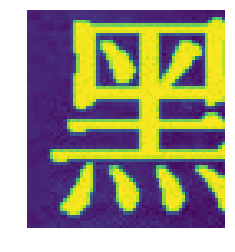

TB12_ppLXXXXXXpapXXunYpLFXX
美
(606.75, 277.28, 669.23, 344.58)


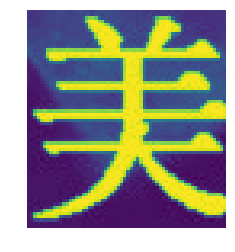

TB12_ppLXXXXXXpapXXunYpLFXX
人
(716.15, 279.62, 779.46, 343.42)


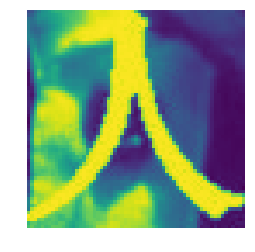

TB13.qCjgMPMeJjy1XdXXasrXXa_!!0-item_pic.jpg
聖
(58.78, 466.11, 106.89, 527.67)


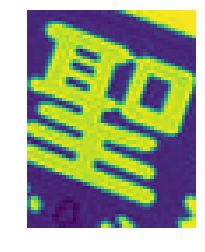

TB130dvLXXXXXXGaXXXunYpLFXX
A
(178.4, 85.2, 241.4, 155.8)


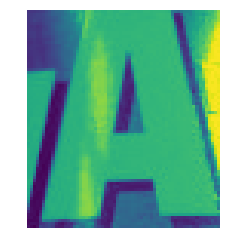

TB130kDfYsTMeJjy1zbXXchlVXa_!!0-item_pic.jpg
看
(229.0, 189.0, 306.0, 279.78)


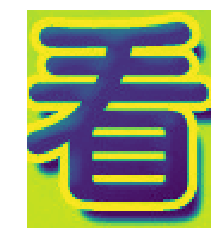

TB132hBLXXXXXXzXVXXunYpLFXX
宝文妈代购
(22.27, 17.55, 37.82, 122.0)


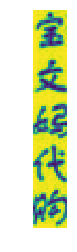

TB132hBLXXXXXXzXVXXunYpLFXX
1
(135.73, 310.45, 144.09, 325.0)


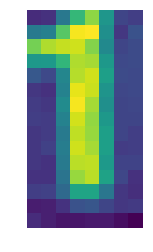

TB132hBLXXXXXXzXVXXunYpLFXX
2
(154.73, 313.36, 163.73, 323.18)


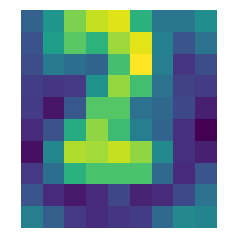

TB132hBLXXXXXXzXVXXunYpLFXX
3
(170.09, 313.09, 178.27, 322.18)


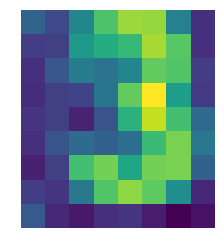

TB132hBLXXXXXXzXVXXunYpLFXX
1
(185.73, 312.73, 193.55, 323.91)


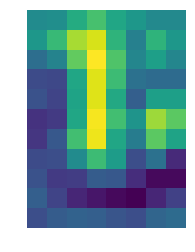

TB132hBLXXXXXXzXVXXunYpLFXX
1
(243.27, 179.73, 262.0, 210.73)


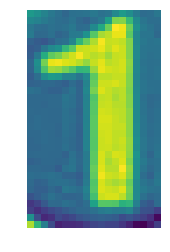

TB133dSalbM8KJjSZFFXXaynpXa_!!0-item_pic.jpg
C
(536.71, 557.83, 557.15, 581.05)


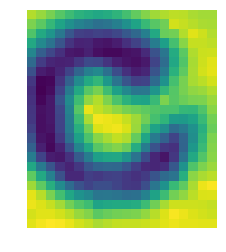

TB136SKlcbI8KJjy1zdXXbe1VXa_!!0-item_pic.jpg
？
(316.82, 133.92, 346.82, 188.92)


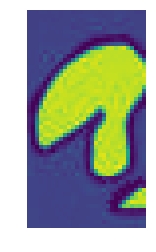

TB136SrQVXXXXb_XVXXXXXXXXXX_!!0-item_pic.jpg
B
(565.35, 829.07, 597.01, 882.4)


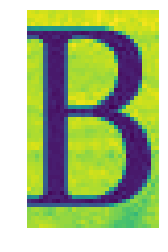

TB1384jLXXXXXabXFXXunYpLFXX
屁
(384.64, 512.97, 409.41, 545.43)


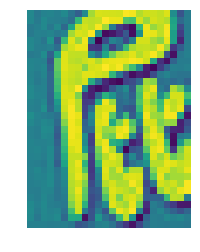

TB1384jLXXXXXabXFXXunYpLFXX
屁
(427.1, 513.04, 456.33, 547.43)


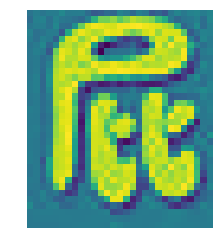

TB1384jLXXXXXabXFXXunYpLFXX
乐
(475.64, 513.66, 507.48, 547.04)


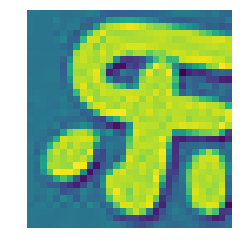

TB1384jLXXXXXabXFXXunYpLFXX
20150322
(314.64, 572.51, 325.48, 611.04)


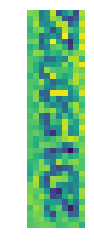

TB1384jLXXXXXabXFXXunYpLFXX
20150322
(299.87, 506.28, 315.79, 552.35)


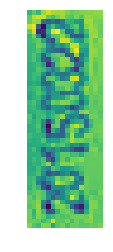

TB1384jLXXXXXabXFXXunYpLFXX
皂
(288.18, 522.66, 298.79, 533.74)


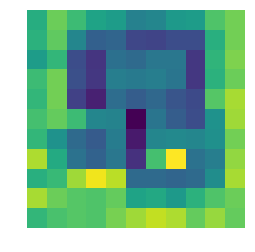

TB1384jLXXXXXabXFXXunYpLFXX
20150322
(136.79, 432.2, 150.33, 478.97)


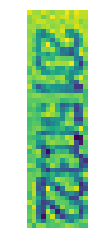

TB13apuevDH8KJjy1XcXXcpdXXa_!!0-item_pic.jpg
?
(630.71, 417.71, 641.0, 429.57)


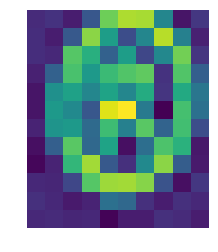

TB13apuevDH8KJjy1XcXXcpdXXa_!!0-item_pic.jpg
ZHONGXIN
(347.29, 638.29, 356.29, 681.14)


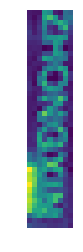

TB13aukicnI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
1
(19.5, 636.0, 59.5, 705.0)


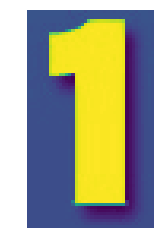

TB13aukicnI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
台
(93.5, 624.0, 183.5, 716.0)


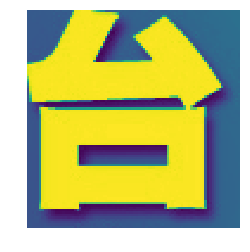

TB13b4CLXXXXXXhXVXXunYpLFXX
足
(392.56, 633.44, 463.44, 712.67)


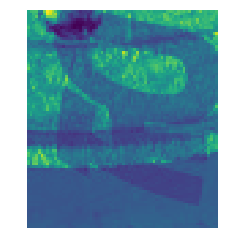

TB13b4CLXXXXXXhXVXXunYpLFXX
下
(478.89, 629.0, 543.33, 702.67)


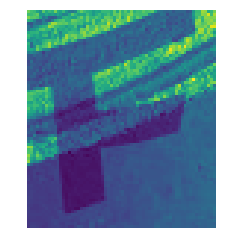

TB13b4CLXXXXXXhXVXXunYpLFXX
距
(615.56, 598.44, 679.67, 680.44)


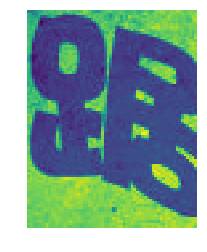

TB13bFtLXXXXXbgaXXXunYpLFXX
9
(121.86, 414.65, 130.66, 424.7)


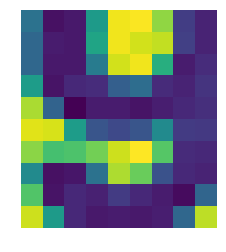

TB13bJQLXXXXXczXXXXunYpLFXX
四川
(17.6, 528.38, 88.83, 676.85)


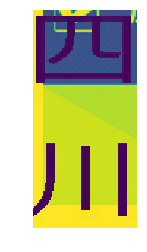

TB13bJQLXXXXXczXXXXunYpLFXX
总代
(585.17, 531.23, 688.48, 685.0)


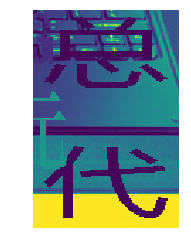

TB13bNuLXXXXXXVaXXXunYpLFXX
HelloIamBoymax
(252.53, 609.0, 261.6, 696.47)


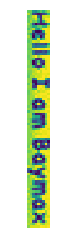

TB13bNuLXXXXXXVaXXXunYpLFXX
6
(131.07, 524.8, 176.6, 575.53)


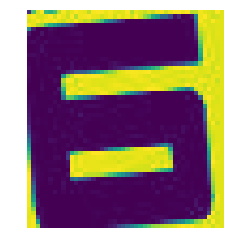

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
量
(713.5, 163.0, 784.5, 247.0)


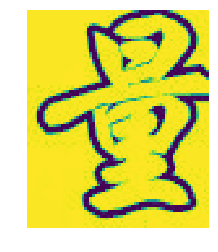

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
便
(249.5, 325.0, 388.5, 495.0)


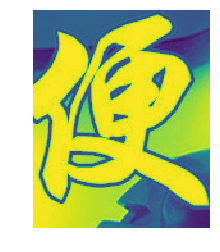

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
神
(412.5, 323.0, 573.5, 499.0)


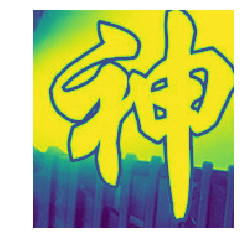

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
器
(598.5, 332.0, 745.5, 489.0)


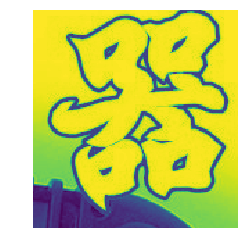

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
2.
(48.43, 667.43, 115.57, 736.57)


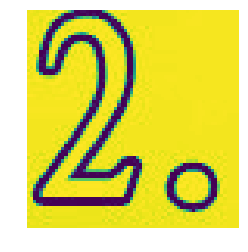

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
8
(144.14, 669.71, 178.43, 728.29)


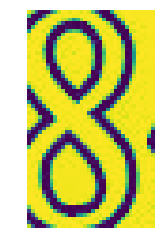

TB13cqpXbwTMeJjSszfXXXbtFXa_!!0-item_pic.jpg
米
(176.14, 656.43, 253.29, 742.71)


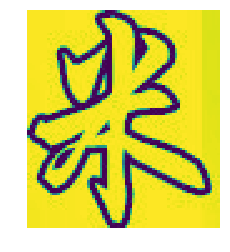

TB13F8NLXXXXXa3XpXXunYpLFXX
年
(643.67, 496.67, 683.67, 549.0)


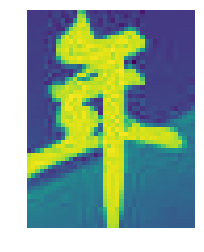

TB13F8NLXXXXXa3XpXXunYpLFXX
费
(717.33, 494.0, 760.33, 558.67)


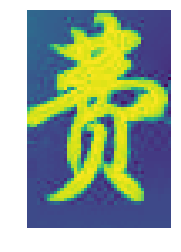

TB13F8NLXXXXXa3XpXXunYpLFXX
新
(707.0, 704.67, 755.33, 753.33)


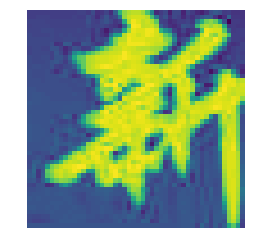

TB13G0ILXXXXXaRXpXXunYpLFXX
￥
(88.8, 621.6, 134.2, 671.6)


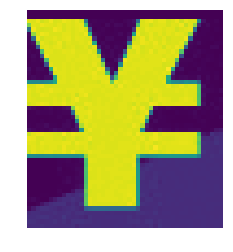

TB13G0ILXXXXXaRXpXXunYpLFXX
N
(445.0, 450.4, 465.4, 473.8)


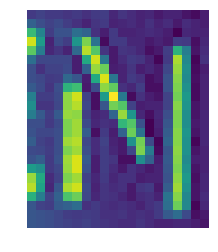

TB13G0ILXXXXXaRXpXXunYpLFXX
SR
(617.4, 206.4, 633.8, 227.6)


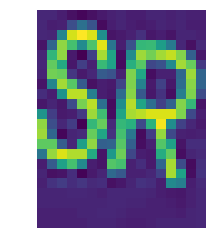

TB13g8FLXXXXXaPXFXXunYpLFXX
R
(84.18, 301.28, 95.78, 323.48)


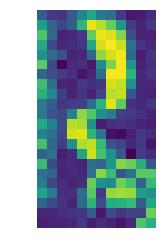

TB13g8FLXXXXXaPXFXXunYpLFXX
H
(99.9, 53.47, 109.45, 67.67)


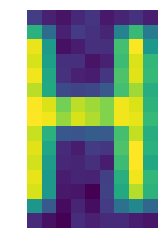

TB13g8FLXXXXXaPXFXXunYpLFXX
：
(1.76, 138.33, 5.82, 162.56)


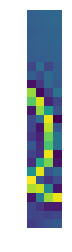

TB13Gh5LpXXXXbiXVXXunYpLFXX
购
(310.19, 546.53, 310.69, 596.92)


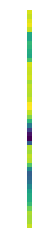

TB13Gh5LpXXXXbiXVXXunYpLFXX
品
(104.65, 238.96, 157.27, 306.32)


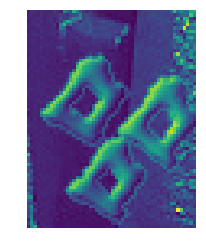

TB13Gh5LpXXXXbiXVXXunYpLFXX
牌
(159.52, 175.36, 232.35, 255.43)


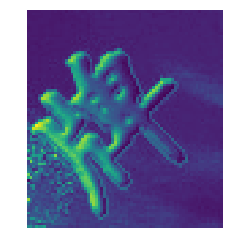

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
慧
(410.3, 160.4, 519.1, 271.8)


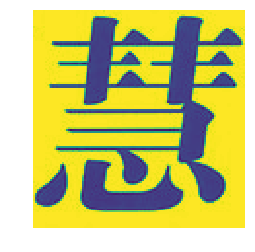

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
主
(445.3, 440.6, 457.7, 453.4)


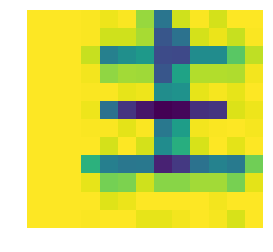

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
助
(507.9, 441.6, 518.1, 453.8)


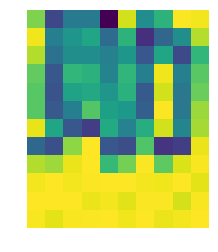

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
涛
(507.5, 428.4, 518.7, 441.2)


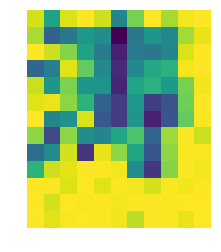

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
第
(162.6, 598.2, 179.4, 616.4)


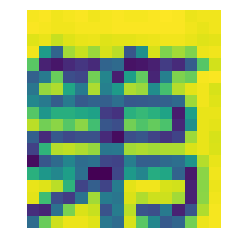

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
1
(188.8, 595.0, 202.6, 623.6)


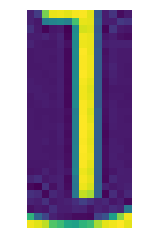

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
/
(230.4, 600.6, 237.0, 626.8)


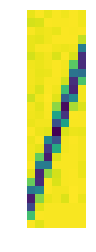

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
的
(401.8, 603.0, 423.6, 625.8)


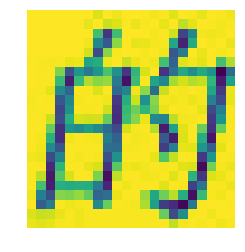

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
最丰富的创新素材为写作插上翅膀
(71.4, 582.8, 85.4, 792.2)


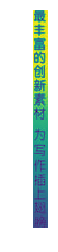

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
.....
(72.8, 796.2, 79.8, 817.4)


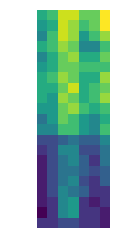

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
最真切的心灵感悟让成长充满智慧
(45.8, 582.6, 63.0, 792.8)


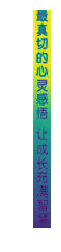

TB13gh5ltzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
.....
(51.6, 794.8, 56.8, 818.4)


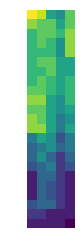

TB13gjNnr_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
去
(131.65, 79.15, 224.65, 189.15)


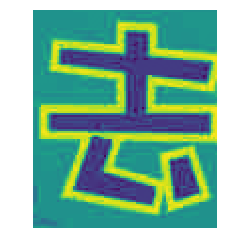

TB13gjNnr_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
外
(237.65, 73.15, 331.65, 176.15)


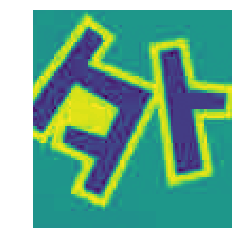

TB13GpYLXXXXXXaXXXXunYpLFXX
tao
(687.5, 171.0, 713.5, 217.0)


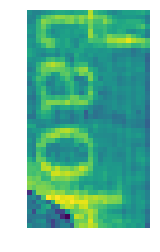

TB13GVuLXXXXXbdaXXXunYpLFXX
需
(4.93, 173.37, 71.58, 245.36)


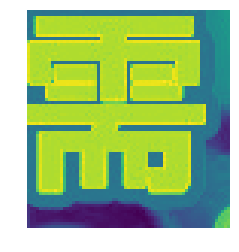

TB13GVuLXXXXXbdaXXXunYpLFXX
脑
(-4.02, 330.72, 65.87, 404.95)


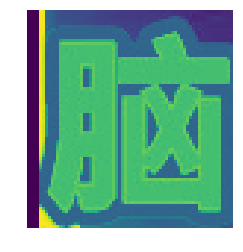

TB13gYSXm_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
帮
(71.66, 161.79, 136.04, 237.47)


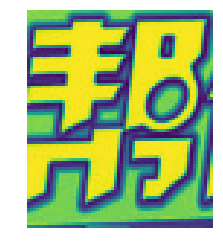

TB13gYSXm_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
你
(138.04, 173.38, 191.7, 233.74)


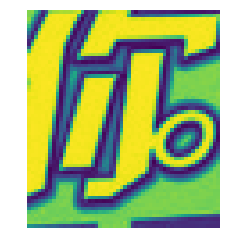

TB13gYSXm_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
学
(198.27, 162.22, 248.35, 229.46)


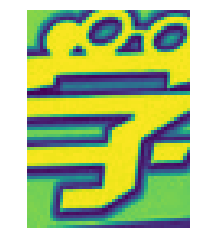

TB13gYSXm_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
上
(329.46, 426.59, 351.35, 451.19)


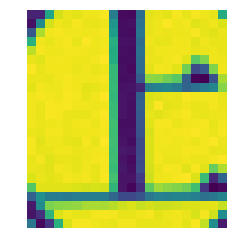

TB13gYSXm_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
4
(357.22, 450.2, 456.49, 593.97)


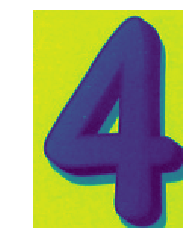

TB13h8URFXXXXciXVXXXXXXXXXX_!!0-item_pic.jpg
元
(675.51, 373.77, 788.74, 500.46)


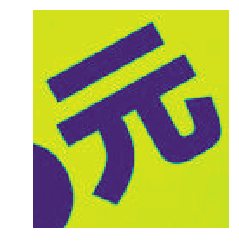

TB13iBwLXXXXXcIXVXXunYpLFXX
T
(477.87, 390.8, 521.07, 437.13)


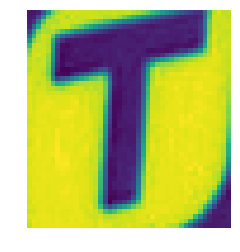

TB13iohRpXXXXbXaFXXXXXXXXXX_!!0-item_pic.jpg
满
(427.05, 668.52, 479.33, 732.1)


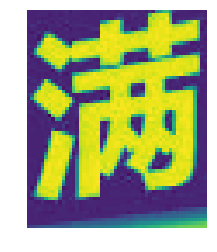

TB13J42LpXXXXXEaXXXunYpLFXX
?
(560.77, 748.69, 590.0, 785.23)


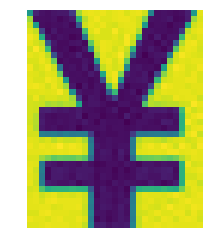

TB13J42LpXXXXXEaXXXunYpLFXX
OUMI
(284.15, 295.08, 352.0, 411.31)


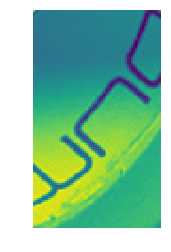

TB13JcLSXXXXXaJXVXXXXXXXXXX_!!0-item_pic.jpg
SK16
(422.5, 699.0, 428.5, 731.0)


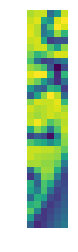

TB13JXxLXXXXXc6XVXXunYpLFXX
超长待机
(9.13, 5.5, 141.13, 149.5)


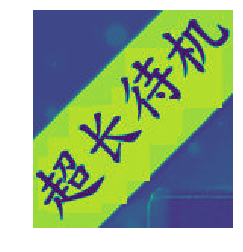

TB13JXxLXXXXXc6XVXXunYpLFXX
热
(461.38, 388.25, 534.63, 468.25)


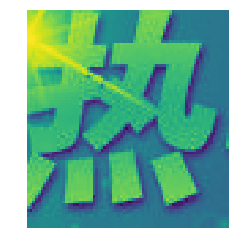

TB13JXxLXXXXXc6XVXXunYpLFXX
锂离子电池
(376.88, 162.75, 396.63, 249.0)


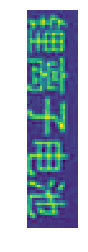

TB13JXxLXXXXXc6XVXXunYpLFXX
lenovo联想
(373.13, 377.5, 389.38, 536.0)


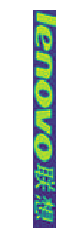

TB13JXxLXXXXXc6XVXXunYpLFXX
电池型号：BL177
(330.88, 166.5, 347.13, 305.75)


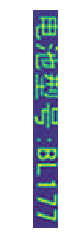

TB13JXxLXXXXXc6XVXXunYpLFXX
标称电压：3.7V
(304.63, 167.5, 324.13, 295.0)


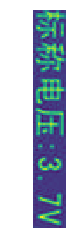

TB13JXxLXXXXXc6XVXXunYpLFXX
充电限制电压：4.2V
(278.38, 166.25, 300.13, 333.25)


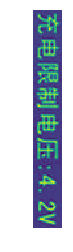

TB13JXxLXXXXXc6XVXXunYpLFXX
电池容量：1000mAh/3.7Wh
(256.88, 166.5, 269.63, 377.0)


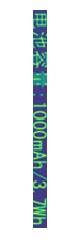

TB13JXxLXXXXXc6XVXXunYpLFXX
执行标准：GB/T18287-2000
(230.13, 166.25, 247.63, 389.75)


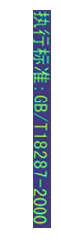

TB13JXxLXXXXXc6XVXXunYpLFXX
201206-177B311586
(162.88, 266.0, 177.63, 447.0)


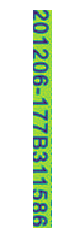

TB13JXxLXXXXXc6XVXXunYpLFXX
警告
(272.13, 463.75, 290.63, 504.75)


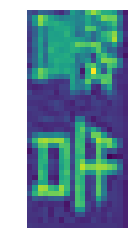

TB13JXxLXXXXXc6XVXXunYpLFXX
投入火中
(254.63, 451.25, 271.38, 517.0)


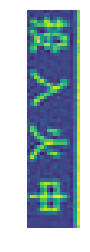

TB13JXxLXXXXXc6XVXXunYpLFXX
可能引起爆炸
(242.13, 445.25, 255.63, 519.75)


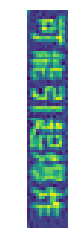

TB13JXxLXXXXXc6XVXXunYpLFXX
联想移动通信科技有限公司
(122.88, 238.25, 140.38, 463.5)


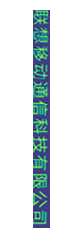

TB13jx_mlDH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
?
(161.75, 22.5, 170.75, 32.5)


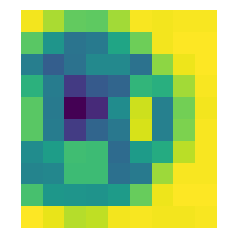

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
?
(42.2, 598.0, 49.6, 607.0)


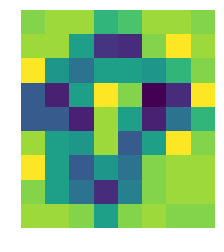

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
-
(45.8, 493.2, 51.4, 499.8)


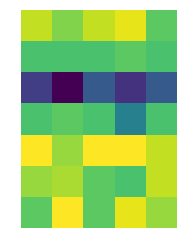

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
·
(43.4, 509.2, 49.4, 515.4)


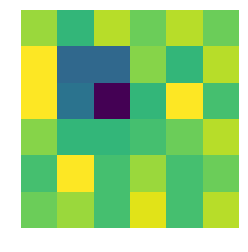

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
1
(70.8, 492.8, 74.8, 502.6)


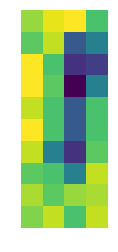

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
1
(71.4, 506.8, 75.0, 513.6)


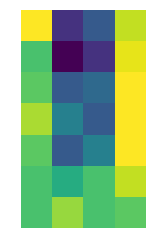

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
2
(140.0, 466.6, 142.0, 474.6)


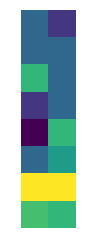

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
2
(99.2, 506.2, 105.6, 515.4)


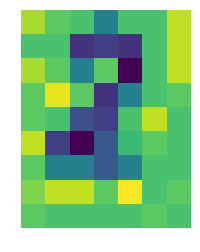

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
3
(128.2, 505.2, 133.6, 513.4)


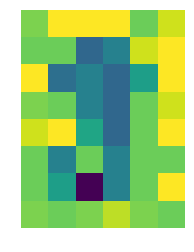

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
4
(157.2, 506.4, 163.8, 513.2)


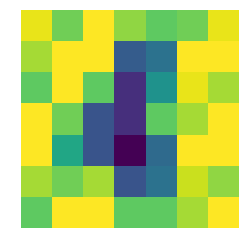

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
%
(187.6, 492.8, 195.6, 502.2)


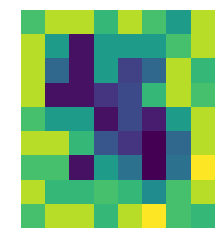

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
5
(187.4, 507.4, 192.8, 514.6)


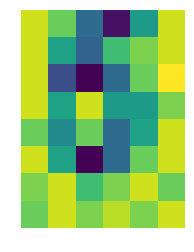

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
^
(218.8, 492.4, 224.8, 499.4)


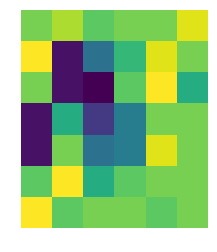

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
6
(216.4, 505.6, 222.8, 514.6)


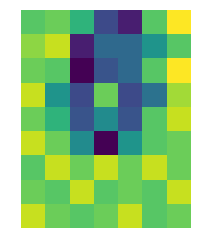

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
7
(246.0, 504.8, 252.2, 514.6)


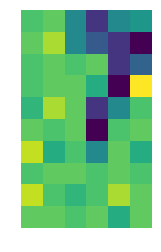

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
8
(278.6, 505.6, 284.0, 513.0)


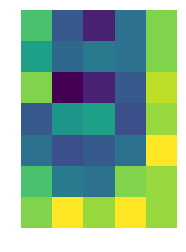

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
(
(309.6, 491.6, 314.4, 502.6)


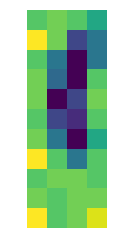

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
9
(308.8, 504.0, 315.2, 512.4)


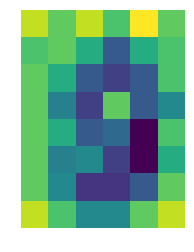

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
0
(339.6, 503.6, 345.6, 512.2)


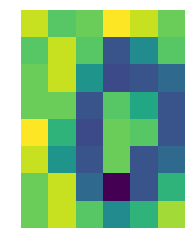

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
)
(341.6, 493.4, 344.8, 500.8)


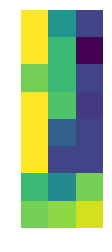

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
Z
(95.2, 594.2, 104.8, 604.6)


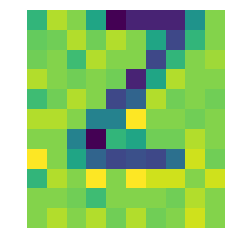

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
A
(85.6, 558.4, 91.6, 569.4)


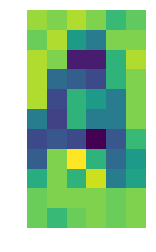

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
Q
(81.6, 526.8, 89.0, 535.2)


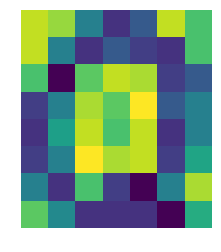

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
E
(137.6, 526.8, 147.0, 536.8)


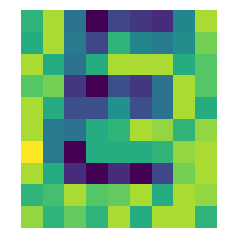

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
S
(113.6, 558.8, 120.2, 569.8)


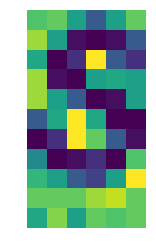

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
X
(127.2, 592.8, 133.4, 602.6)


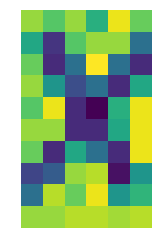

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
C
(154.0, 594.0, 162.8, 604.2)


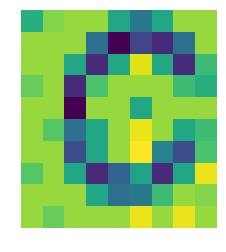

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
F
(173.0, 560.2, 179.6, 570.2)


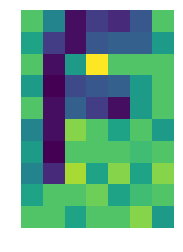

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
R
(167.6, 525.8, 176.8, 535.0)


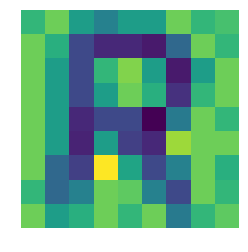

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
T
(200.2, 527.4, 206.0, 536.4)


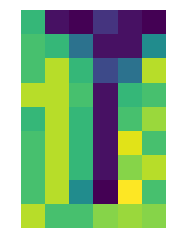

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
V
(185.6, 594.8, 194.8, 605.0)


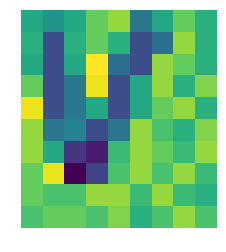

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
H
(232.0, 562.2, 242.0, 572.6)


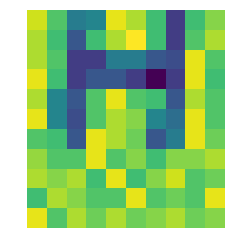

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
Y
(228.4, 527.8, 236.2, 536.2)


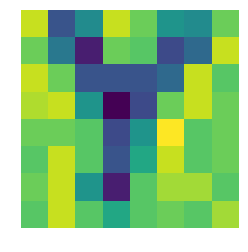

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
B
(216.8, 595.2, 220.4, 606.6)


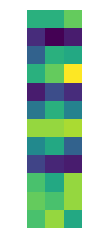

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
J
(262.4, 562.0, 271.6, 571.8)


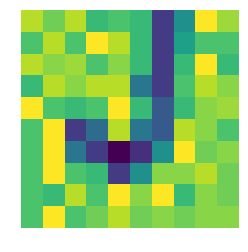

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
U
(258.2, 527.2, 266.6, 538.0)


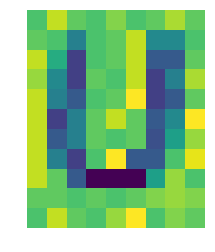

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
I
(291.6, 527.2, 294.2, 537.6)


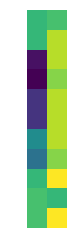

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
K
(296.2, 562.0, 301.2, 572.6)


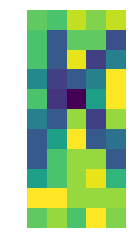

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
M
(277.0, 596.8, 286.0, 606.0)


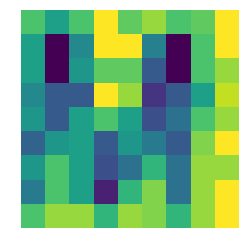

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
.
(342.2, 610.4, 350.0, 619.0)


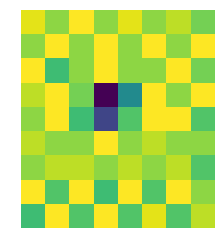

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
/
(371.6, 609.6, 375.6, 618.8)


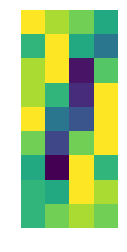

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
?
(373.6, 596.4, 379.6, 608.6)


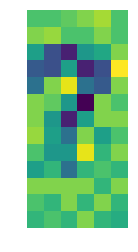

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
O
(322.6, 526.4, 330.6, 539.2)


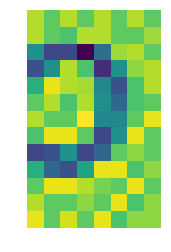

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
P
(351.4, 528.0, 360.4, 539.4)


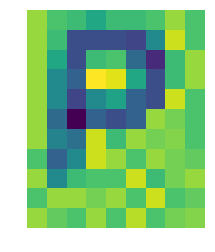

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
:
(359.4, 562.4, 363.2, 571.8)


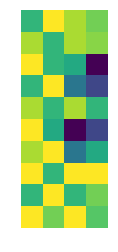

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
[
(386.0, 537.2, 394.0, 549.4)


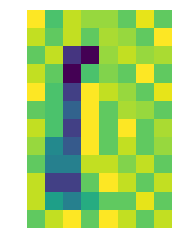

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
(
(387.6, 527.0, 393.0, 536.0)


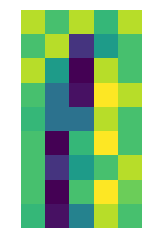

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
]
(420.0, 539.8, 425.6, 549.2)


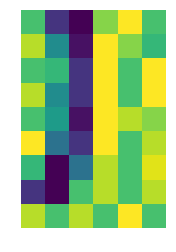

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
)
(419.6, 527.6, 425.4, 539.0)


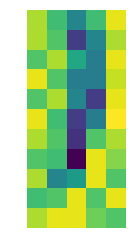

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
?
(417.2, 604.4, 426.0, 613.8)


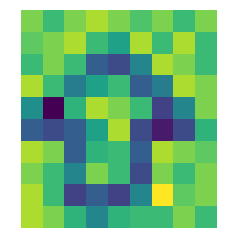

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
C
(455.6, 645.0, 461.4, 653.0)


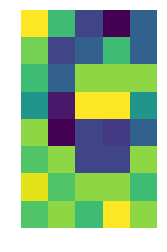

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
1
(424.2, 572.8, 429.6, 583.4)


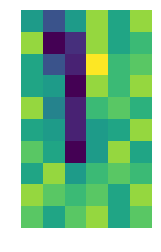

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
:
(424.2, 564.0, 429.2, 572.6)


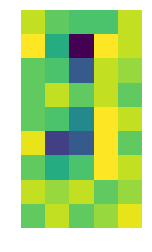

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
+
(409.6, 493.6, 415.8, 503.4)


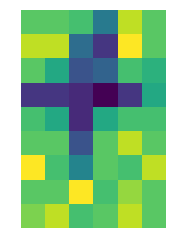

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
猎
(359.4, 415.0, 377.8, 440.4)


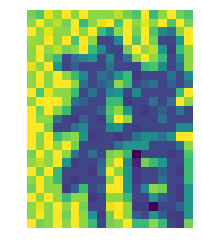

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
↑
(541.2, 606.0, 546.0, 621.4)


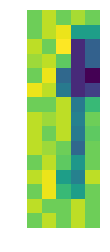

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
↓
(538.0, 641.6, 544.2, 655.8)


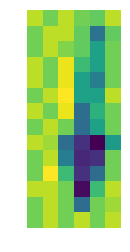

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
/
(660.8, 500.0, 668.4, 510.2)


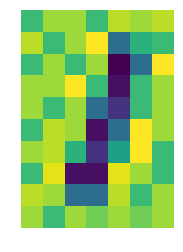

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
*
(697.2, 501.2, 705.0, 509.8)


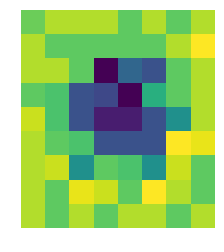

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
+
(729.4, 545.6, 737.0, 553.8)


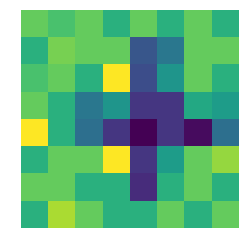

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
0
(618.2, 640.4, 624.8, 651.0)


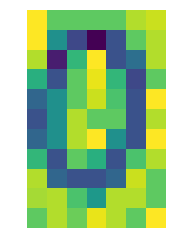

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
1
(617.2, 602.4, 623.2, 612.0)


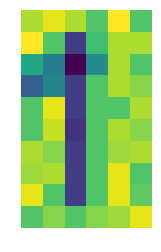

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
2
(648.4, 602.4, 656.4, 613.8)


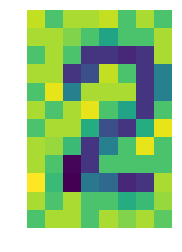

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
↓
(649.0, 614.4, 653.0, 625.6)


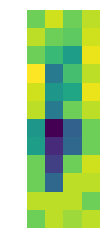

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
3
(683.2, 602.8, 692.8, 614.6)


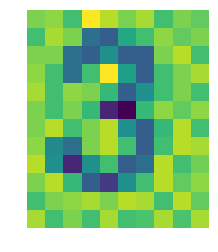

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
4
(615.2, 564.8, 624.2, 574.0)


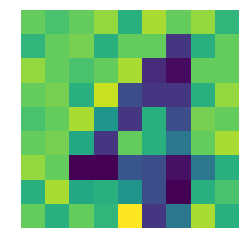

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
7
(618.8, 530.0, 625.2, 539.4)


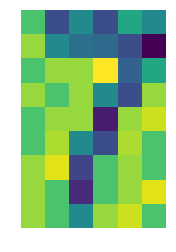

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
↑
(654.0, 540.6, 657.6, 550.8)


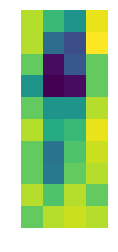

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
5
(651.8, 564.4, 659.2, 577.0)


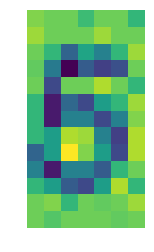

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
6
(687.4, 565.6, 696.0, 575.6)


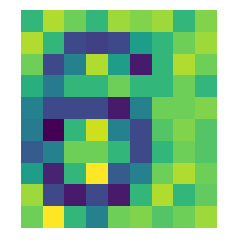

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
9
(689.8, 529.6, 697.6, 540.6)


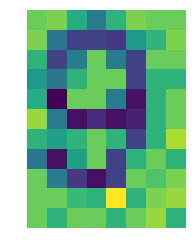

TB13jy.NFXXXXaFXpXXXXXXXXXX_!!1-item_pic.gif
骚
(482.8, 162.8, 581.2, 299.0)


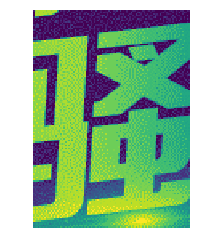

TB13KWcLpXXXXXGXFXXunYpLFXX
1
(62.67, 508.0, 71.0, 536.0)


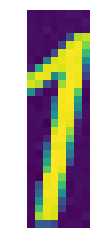

TB13KWcLpXXXXXGXFXXunYpLFXX
3
(52.67, 640.33, 72.33, 666.33)


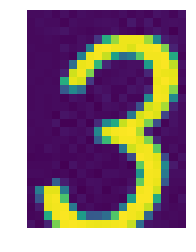

TB13l8lLXXXXXbuXFXXunYpLFXX
R
(437.38, 340.0, 445.88, 349.5)


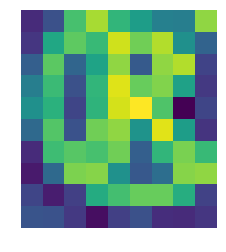

TB13l8lLXXXXXbuXFXXunYpLFXX
5
(490.38, 656.25, 503.88, 682.75)


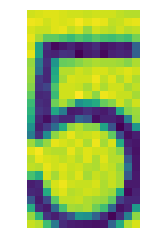

TB13l8lLXXXXXbuXFXXunYpLFXX
6
(572.88, 509.25, 592.63, 536.0)


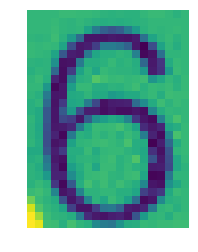

TB13l8lLXXXXXbuXFXXunYpLFXX
7
(575.88, 362.25, 591.13, 385.5)


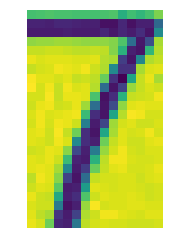

TB13l8lLXXXXXbuXFXXunYpLFXX
4
(217.13, 628.5, 235.13, 656.75)


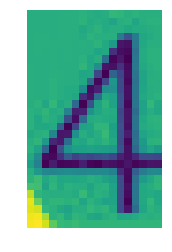

TB13l8lLXXXXXbuXFXXunYpLFXX
2
(86.88, 555.5, 105.13, 580.75)


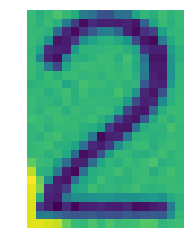

TB13l8lLXXXXXbuXFXXunYpLFXX
3
(219.13, 480.0, 236.38, 505.0)


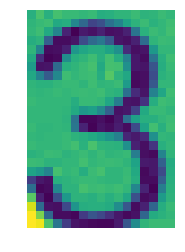

TB13l8lLXXXXXbuXFXXunYpLFXX
1
(88.38, 409.25, 102.88, 435.25)


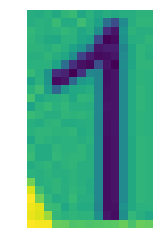

TB13LbhoJrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
比
(663.5, 437.0, 690.5, 466.0)


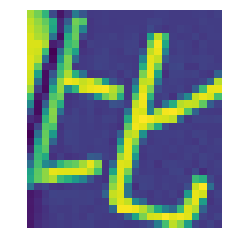

TB13LbhoJrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
h
(661.5, 473.0, 681.5, 493.0)


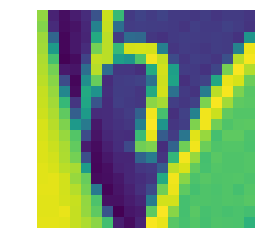

TB13LDjkb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
VANOH
(125.63, 402.0, 177.63, 488.0)


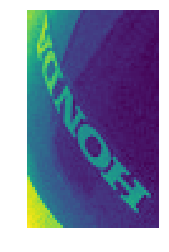

TB13LDjkb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
正品保证
(20.88, 6.5, 160.38, 246.5)


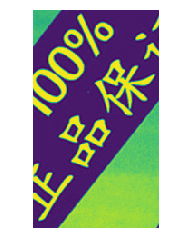

TB13LDjkb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
昌
(316.13, 562.75, 341.63, 588.25)


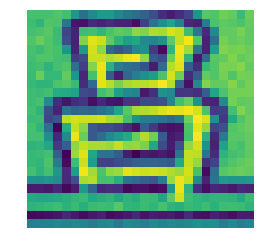

TB13LDjkb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
摩
(367.88, 562.25, 392.38, 587.75)


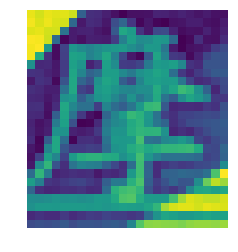

TB13LDjkb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
实
(468.38, 560.75, 491.13, 586.75)


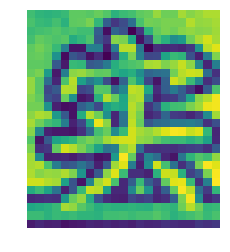

TB13LDjkb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
拍
(570.88, 561.5, 593.38, 586.25)


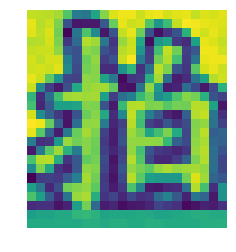

TB13LoPnb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
STYLEFIXER
(73.76, 463.23, 96.76, 679.89)


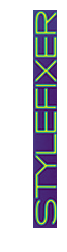

TB13LoPnb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
1
(412.76, 408.56, 509.09, 589.56)


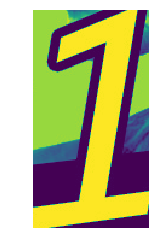

TB13LoPnb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
送
(541.09, 422.56, 686.76, 589.56)


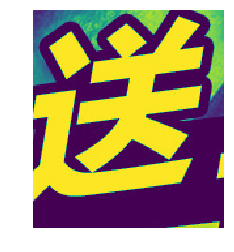

TB13LoPnb_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
1
(676.42, 362.89, 786.09, 561.89)


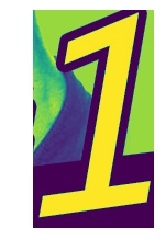

TB13LtjiMoQMeJjy1XaXXcSsFXa_!!0-item_pic.jpg
￥
(494.33, 569.0, 540.67, 615.67)


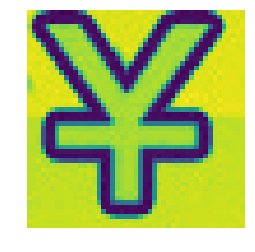

TB13LtjiMoQMeJjy1XaXXcSsFXa_!!0-item_pic.jpg
A
(121.15, 644.31, 131.15, 655.15)


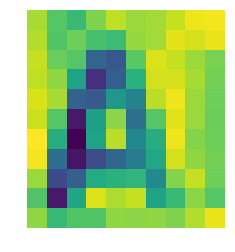

TB13m0BLXXXXXc7XFXXunYpLFXX
AUTO
(323.58, 607.83, 409.75, 717.17)


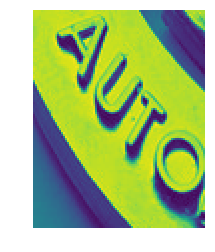

TB13m8bev2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
?
(764.0, 627.0, 791.0, 661.0)


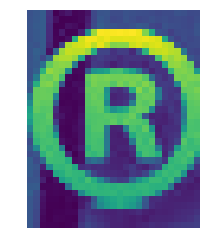

TB13MM2mJnJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
y
(741.67, 273.67, 770.67, 307.0)


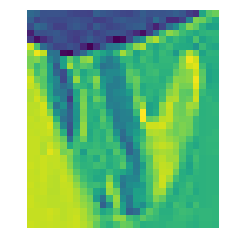

TB13MM2mJnJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
y
(760.33, 326.67, 789.0, 358.0)


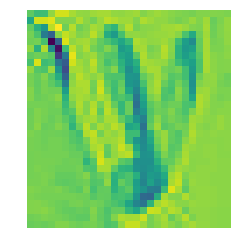

TB13mSpmcrI8KJjy0FhXXbfnpXa_!!0-item_pic.jpg
A
(641.2, 701.6, 649.4, 709.8)


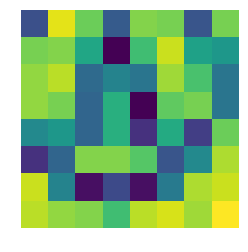

TB13mSpmcrI8KJjy0FhXXbfnpXa_!!0-item_pic.jpg
O
(654.6, 701.6, 661.0, 709.0)


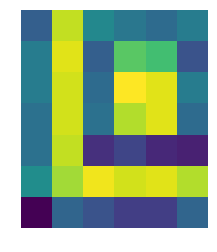

TB13mwcm4rI8KJjy0FpXXb5hVXa_!!0-item_pic.jpg
送
(113.6, 221.8, 172.8, 287.8)


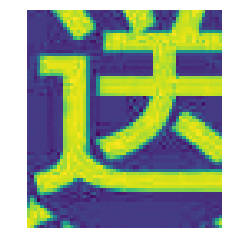

TB13mwcm4rI8KJjy0FpXXb5hVXa_!!0-item_pic.jpg
K
(251.4, 455.6, 264.6, 470.0)


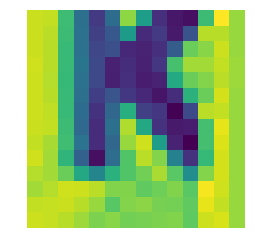

TB13MX9lx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
科学也时尚：
(2.69, 66.04, 20.17, 307.71)


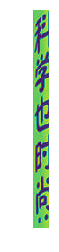

TB13MX9lx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
孩子最想知道的生活秘密
(5.33, 311.06, 22.32, 746.38)


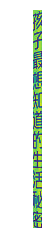

TB13MX9lx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
化学工业出版社
(8.89, 794.03, 17.76, 949.11)


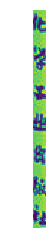

TB13MX9lx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
：
(627.7, 237.51, 645.13, 271.55)


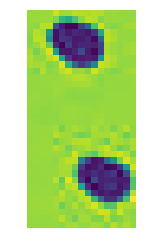

TB13MX9lx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
？
(589.92, 83.99, 680.73, 197.04)


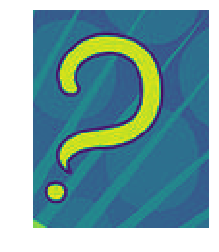

TB13MX9lx6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
主
(313.86, 441.59, 334.04, 466.14)


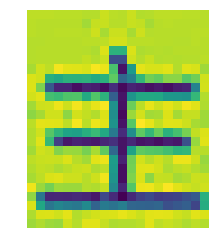

TB13mxtLXXXXXbpaXXXunYpLFXX
让你拥有像
(442.03, 10.64, 492.29, 283.5)


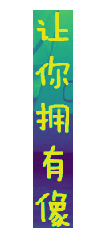

TB13mxtLXXXXXbpaXXXunYpLFXX
鸡蛋般亮白的肌肤
(500.2, 3.69, 547.98, 453.77)


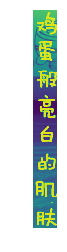

TB13N4KojnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
启贤图书店
(40.82, 93.55, 101.07, 185.59)


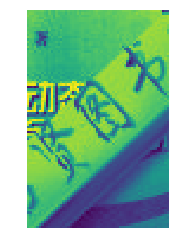

TB13N4KojnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
著
(43.95, 102.48, 50.08, 109.6)


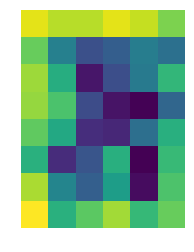

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
TIME
(261.8, 240.88, 287.8, 350.17)


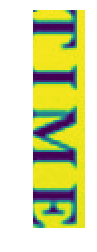

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
40
(330.08, 585.13, 339.08, 599.13)


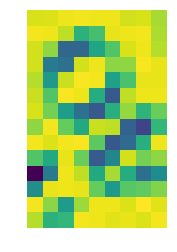

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
45
(312.48, 518.73, 321.88, 533.13)


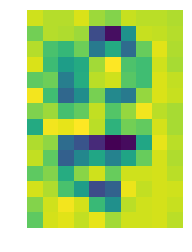

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
50
(327.88, 451.53, 340.08, 464.93)


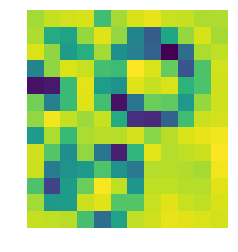

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
10
(558.68, 449.13, 569.68, 462.13)


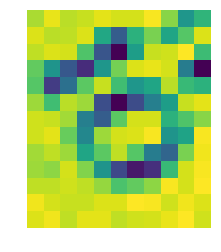

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
15
(576.68, 515.53, 586.08, 527.73)


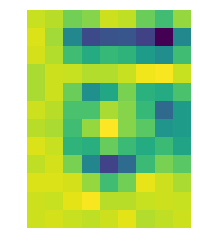

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
25
(510.08, 629.13, 523.48, 643.33)


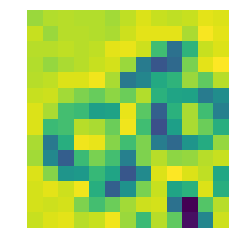

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
1
(499.88, 415.53, 508.48, 438.93)


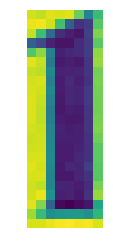

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
2
(532.28, 453.93, 552.88, 475.93)


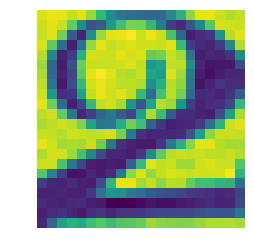

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
11
(382.28, 418.58, 402.48, 439.73)


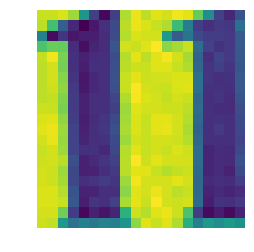

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
7
(446.48, 605.73, 456.68, 625.73)


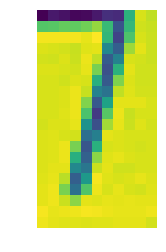

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
LONGINES
(806.19, 444.73, 867.08, 883.93)


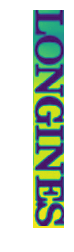

TB13OsGJVXXXXb9XFXXXXXXXXXX_!!0-item_pic.jpg
T
(84.28, 253.26, 163.88, 366.06)


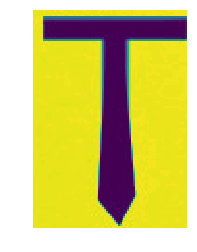

TB13oXULpXXXXXUaXXXunYpLFXX
M:
(202.2, 310.39, 227.12, 336.14)


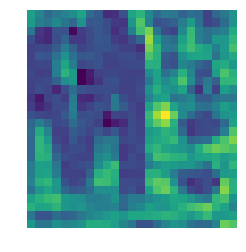

TB13qfxn46I8KJjy0FgXXXXzVXa_!!0-item_pic.jpg
中国十二生肖民俗与科学文化艺术丛书
(644.85, 209.76, 671.13, 627.62)


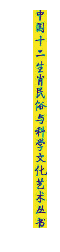

TB13qfxn46I8KJjy0FgXXXXzVXa_!!0-item_pic.jpg
猪
(39.77, 95.03, 261.22, 318.29)


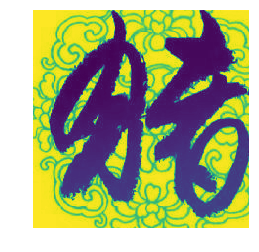

TB13R3qhlTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
V2
(91.21, 379.71, 103.14, 391.71)


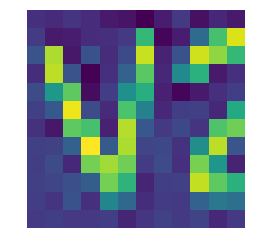

TB13rVVLXXXXXX5XXXXunYpLFXX
N
(488.99, 532.5, 559.88, 617.94)


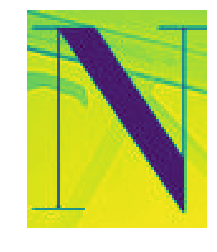

TB13rVVLXXXXXX5XXXXunYpLFXX
5
(658.55, 582.5, 685.66, 639.72)


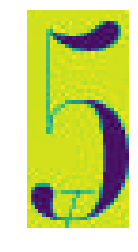

TB13rVVLXXXXXX5XXXXunYpLFXX
E
(570.1, 502.83, 623.33, 569.16)


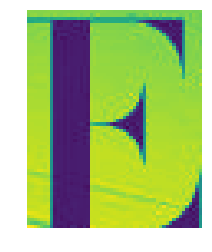

TB13rVVLXXXXXX5XXXXunYpLFXX
:FOU
(301.66, 417.5, 342.66, 498.39)


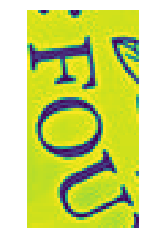

TB13rVVLXXXXXX5XXXXunYpLFXX
D
(390.66, 529.16, 399.99, 558.72)


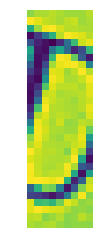

TB13rVVLXXXXXX5XXXXunYpLFXX
SYR
(306.22, 354.29, 355.99, 413.73)


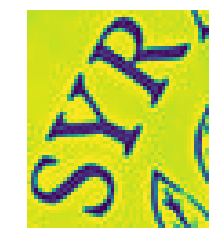

TB13rVVLXXXXXX5XXXXunYpLFXX
ACU
(346.33, 310.4, 401.22, 366.62)


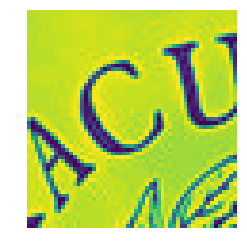

TB13rVVLXXXXXX5XXXXunYpLFXX
NIVE
(451.88, 323.73, 476.66, 393.29)


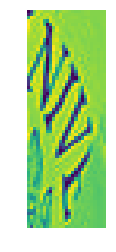

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
包
(631.53, 72.29, 680.63, 126.05)


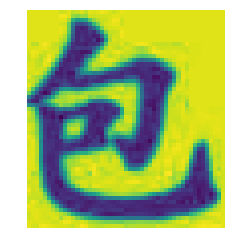

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
邮
(702.86, 76.29, 749.62, 128.38)


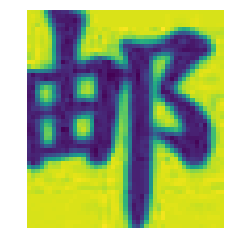

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
神器
(327.83, 476.8, 468.23, 745.5)


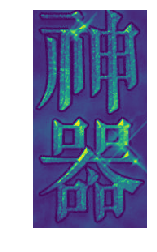

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
十
(333.89, 331.89, 404.2, 410.49)


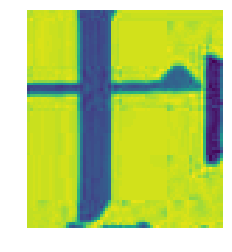

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
日
(398.88, 347.46, 428.72, 389.92)


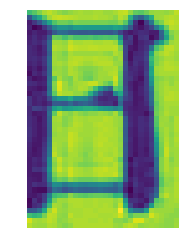

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
热带鱼增色
(633.7, 260.21, 691.09, 577.32)


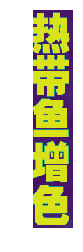

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
专用鱼粮
(576.0, 264.19, 621.41, 512.62)


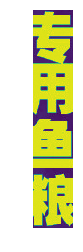

TB13SoCgWigSKJjSsppXXabnpXa_!!0-item_pic.jpg
NDAYS
(434.45, 376.04, 452.76, 446.23)


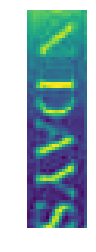

TB13SpRLXXXXXXhXXXXunYpLFXX
支持批发量大价优
(30.83, 16.33, 169.22, 202.6)


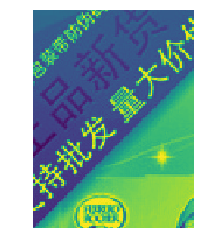

TB13SpRLXXXXXXhXXXXunYpLFXX
正品新货
(20.52, 8.31, 115.66, 157.76)


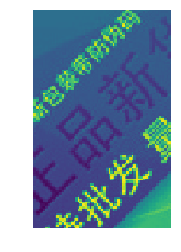

TB13SpRLXXXXXXhXXXXunYpLFXX
全新包装防伪码
(14.26, 2.65, 82.6, 97.0)


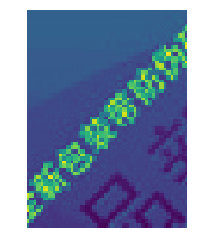

TB13sRALXXXXXazXVXXunYpLFXX
港澳代购
(10.2, 161.27, 66.16, 402.86)


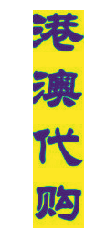

TB13sRALXXXXXazXVXXunYpLFXX
实物拍照
(6.57, 432.91, 67.8, 675.23)


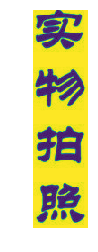

TB13Swil2BNTKJjSszbXXaFrFXa_!!0-item_pic.jpg
品质有保证
(188.07, 312.15, 286.96, 826.71)


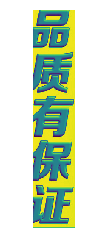

TB13Swil2BNTKJjSszbXXaFrFXa_!!0-item_pic.jpg
实力大档口
(12.44, 312.36, 127.33, 825.11)


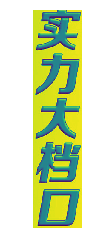

TB13Swil2BNTKJjSszbXXaFrFXa_!!0-item_pic.jpg
原版一模一样
(726.43, 339.23, 832.57, 835.25)


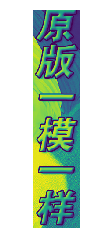

TB13Swil2BNTKJjSszbXXaFrFXa_!!0-item_pic.jpg
大量
(722.65, 24.69, 817.25, 205.29)


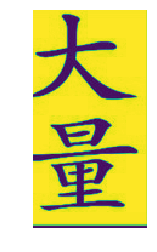

TB13Swil2BNTKJjSszbXXaFrFXa_!!0-item_pic.jpg
现货
(610.39, 33.48, 710.35, 194.68)


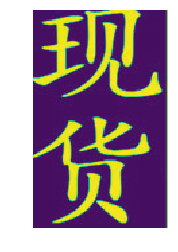

TB13T0yLXXXXXbjXVXXunYpLFXX
百雀羚凡士林保湿润肤露
(638.63, 23.5, 689.58, 547.75)


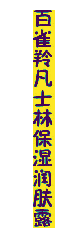

TB13T0yLXXXXXbjXVXXunYpLFXX
中样
(640.88, 563.0, 683.88, 657.25)


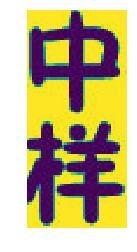

TB13UdDLXXXXXbqXFXXunYpLFXX
送合银硅胶
(772.14, 260.87, 1135.3, 809.58)


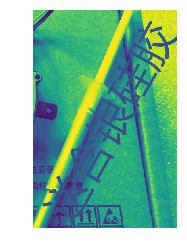

TB13UdDLXXXXXbqXFXXunYpLFXX
包
(22.09, 617.14, 271.94, 943.15)


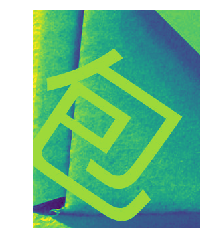

TB13VJDLXXXXXbeXFXXunYpLFXX
+
(301.57, 498.29, 309.86, 506.71)


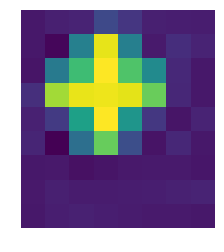

TB13VJDLXXXXXbeXFXXunYpLFXX
+
(698.71, 414.86, 706.0, 423.86)


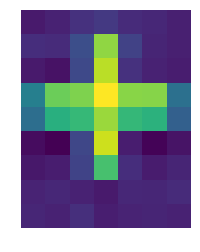

TB13VJDLXXXXXbeXFXXunYpLFXX
?
(142.71, 12.0, 158.0, 29.43)


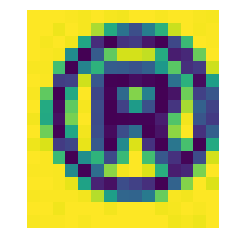

TB13Vn0dInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
厂家直销
(11.09, 144.18, 76.55, 388.45)


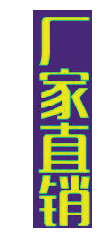

TB13Vn0dInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
终身质保
(90.36, 237.0, 159.27, 478.36)


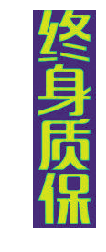

TB13VoYbWzB9uJjSZFMXXXq4XXa_!!0-item_pic.jpg
元
(425.2, 15.4, 485.8, 100.4)


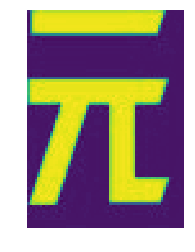

TB13VRHLXXXXXacXFXXunYpLFXX
步步高
(283.85, 447.62, 301.0, 494.92)


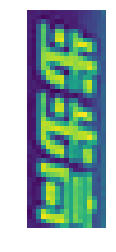

TB13VRHLXXXXXacXFXXunYpLFXX
5
(183.69, 570.69, 192.15, 581.77)


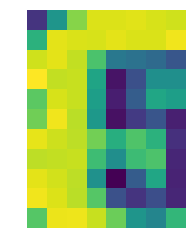

TB13WdKLXXXXXb5XpXXunYpLFXX
量大优惠
(43.88, 282.75, 103.13, 571.25)


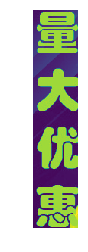

TB13WdKLXXXXXb5XpXXunYpLFXX
島
(453.13, 416.0, 471.38, 438.25)


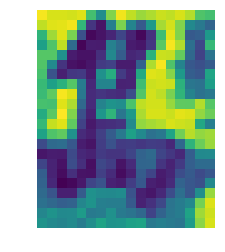

TB13WdKLXXXXXb5XpXXunYpLFXX
寳
(434.63, 426.5, 453.88, 452.0)


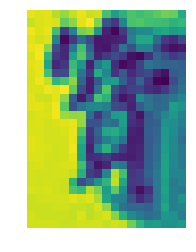

TB13XluLXXXXXXzaXXXunYpLFXX
RYSTATION.3
(11.25, 81.0, 30.25, 398.5)


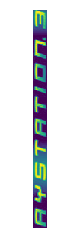

TB13xRNLXXXXXaZXpXXunYpLFXX
1
(97.88, 443.16, 109.12, 463.08)


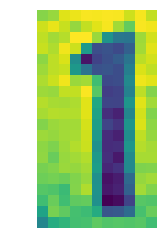

TB13xRNLXXXXXaZXpXXunYpLFXX
2
(129.52, 444.52, 147.6, 465.36)


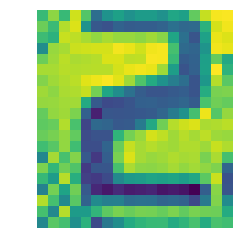

TB13xRNLXXXXXaZXpXXunYpLFXX
3
(169.28, 445.08, 185.36, 465.28)


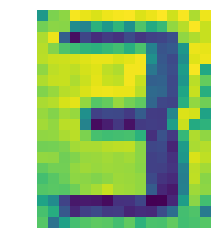

TB13xRNLXXXXXaZXpXXunYpLFXX
6
(168.92, 472.96, 183.36, 496.08)


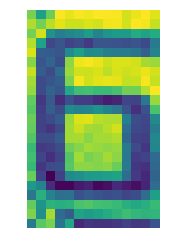

TB13xRNLXXXXXaZXpXXunYpLFXX
5
(130.16, 472.32, 146.24, 490.52)


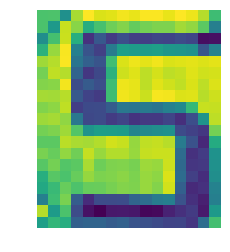

TB13xRNLXXXXXaZXpXXunYpLFXX
4
(96.32, 471.68, 112.04, 491.24)


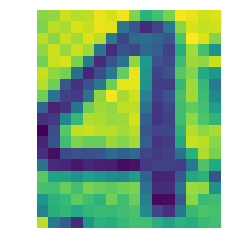

TB13xRNLXXXXXaZXpXXunYpLFXX
7
(95.32, 498.56, 110.76, 521.04)


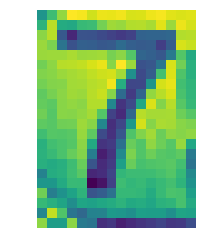

TB13xRNLXXXXXaZXpXXunYpLFXX
8
(131.52, 501.12, 146.52, 520.68)


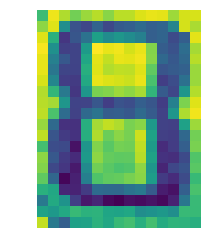

TB13xRNLXXXXXaZXpXXunYpLFXX
9
(170.56, 503.76, 184.36, 522.6)


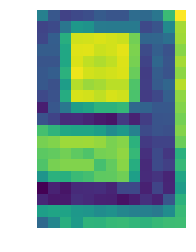

TB13ykCaf2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
泡
(758.5, 594.0, 778.5, 620.0)


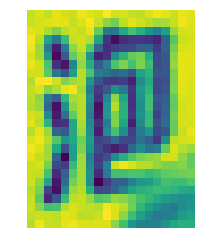

TB13ykCaf2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
+
(332.5, 563.0, 345.5, 580.0)


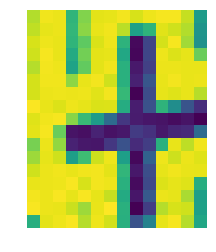

TB13ykCaf2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
管
(188.5, 304.0, 216.5, 344.0)


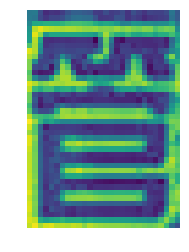

TB13ykCaf2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
+
(126.5, 547.0, 137.5, 565.0)


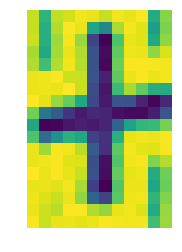

TB13ykCaf2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
+
(475.5, 632.0, 481.5, 647.0)


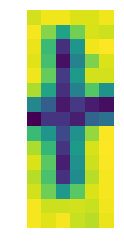

TB13ym0g4PI8KJjSspoXXX6MFXa_!!0-item_pic.jpg
第三种黑猩猩
(84.04, 116.72, 98.87, 235.22)


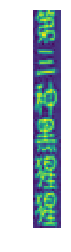

TB13YSXh_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
￥
(584.09, 731.53, 618.95, 766.65)


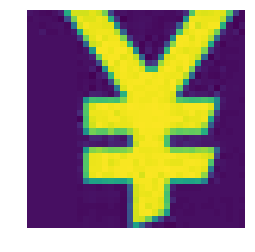

TB13zpUQFXXXXc6aXXXXXXXXXXX_!!0-item_pic.jpg
芷轩堂
(391.0, 84.67, 422.33, 164.67)


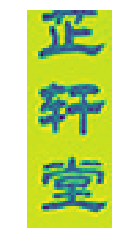

TB13zpUQFXXXXc6aXXXXXXXXXXX_!!0-item_pic.jpg
￥
(545.78, 695.67, 588.0, 738.67)


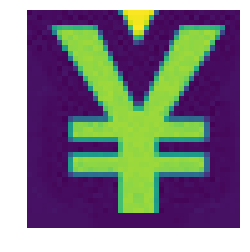

TB13_Y1OVXXXXaFXpXXXXXXXXXX_.jpg
正
(388.0, 736.67, 428.0, 778.0)


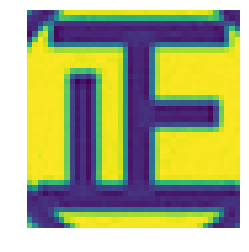

TB13_Y1OVXXXXaFXpXXXXXXXXXX_.jpg
1
(30.0, 711.33, 68.0, 778.67)


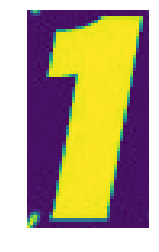

TB14.8NLpXXXXajapXXunYpLFXX
满百
(8.63, 382.58, 31.1, 439.95)


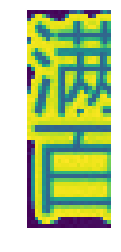

TB14.8NLpXXXXajapXXunYpLFXX
批发
(16.27, -1.38, 48.71, 71.56)


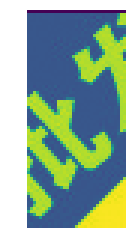

TB14.UuSFXXXXc2XVXXXXXXXXXX_!!1-item_pic.gif
7
(493.24, 704.12, 545.47, 779.76)


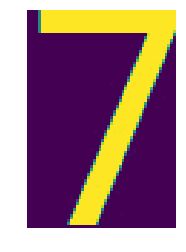

TB140BALXXXXXXbXVXXunYpLFXX
USB
(339.6, 226.11, 394.01, 285.52)


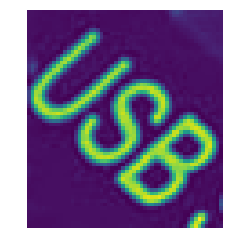

TB140BALXXXXXXbXVXXunYpLFXX
0.1348h
(481.19, 295.53, 554.49, 369.11)


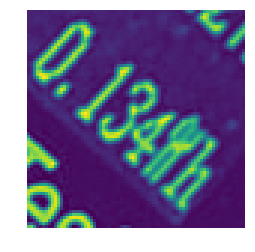

TB140BALXXXXXXbXVXXunYpLFXX
1.22A
(410.89, 171.99, 503.1, 271.62)


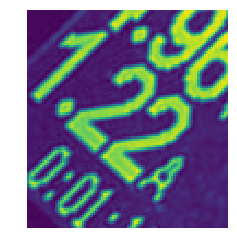

TB140BALXXXXXXbXVXXunYpLFXX
Tester
(466.01, 332.61, 531.17, 408.62)


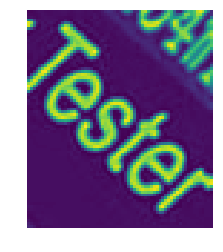

TB140lsLXXXXXcvaXXXunYpLFXX
月
(343.87, 480.13, 351.53, 489.13)


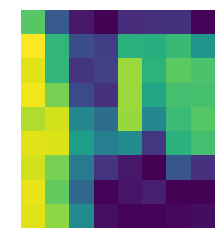

TB140lsLXXXXXcvaXXXunYpLFXX
午时
(351.2, 511.13, 360.2, 529.13)


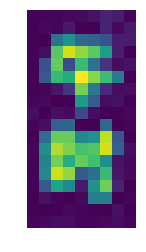

TB140lsLXXXXXcvaXXXunYpLFXX
上午
(240.87, 513.13, 246.2, 526.13)


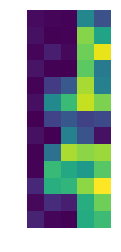

TB141BbmgvD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
6
(473.5, 181.0, 486.5, 197.0)


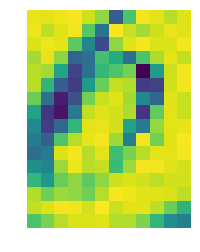

TB141lMLXXXXXbCXpXXunYpLFXX
F1
(415.11, 652.33, 429.33, 666.89)


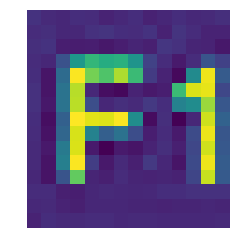

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
福
(489.79, 329.34, 515.5, 355.34)


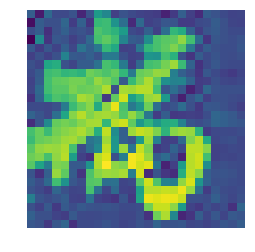

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
赠
(227.65, 531.19, 318.36, 627.91)


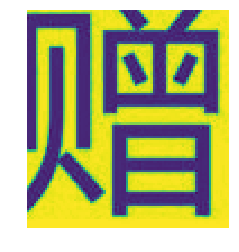

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
：
(359.08, 551.34, 376.08, 612.77)


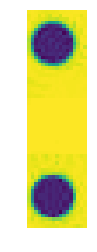

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
+
(493.22, 538.62, 514.08, 565.62)


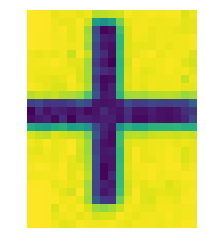

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
+
(488.22, 597.05, 513.08, 626.19)


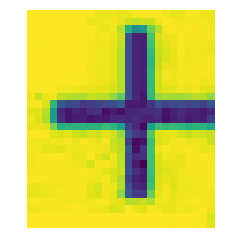

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
+
(615.22, 597.91, 639.93, 623.34)


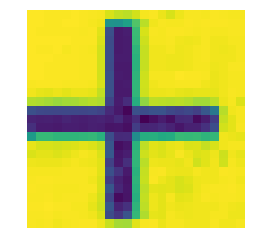

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
蒸
(420.79, 739.48, 459.08, 780.91)


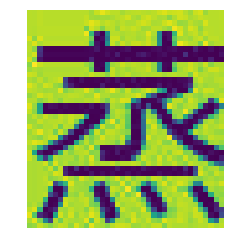

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
烤
(213.22, 743.62, 252.36, 784.34)


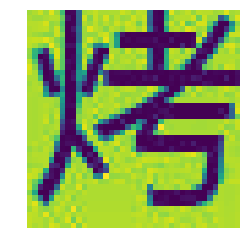

TB142IHk0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
烙
(2.65, 207.19, 45.22, 249.91)


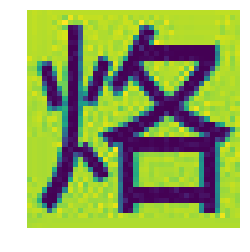

TB142tALXXXXXaBXVXXunYpLFXX
S
(397.5, 650.63, 416.0, 671.24)


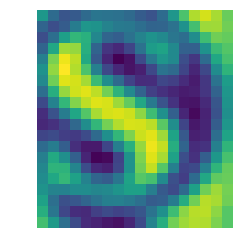

TB142tALXXXXXaBXVXXunYpLFXX
外
(825.13, 136.73, 902.02, 216.77)


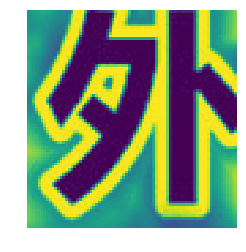

TB142tALXXXXXaBXVXXunYpLFXX
包快递
(632.97, 317.77, 716.72, 603.06)


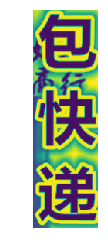

TB142tALXXXXXaBXVXXunYpLFXX
包物流
(818.31, 321.77, 903.2, 596.09)


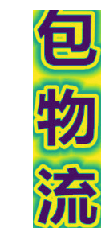

TB142tALXXXXXaBXVXXunYpLFXX
薄荷味饮料浓浆
(552.09, 432.16, 625.09, 654.58)


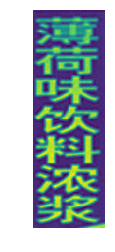

TB142tALXXXXXagXVXXunYpLFXX
65
(130.46, 599.34, 154.28, 627.9)


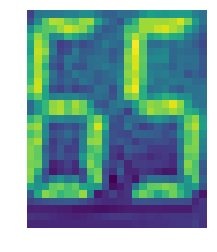

TB142XzLXXXXXa2XVXXunYpLFXX
支持验货
(194.35, 10.04, 263.69, 80.53)


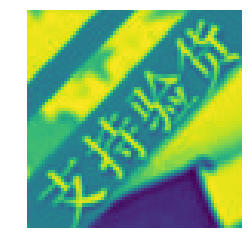

TB142XzLXXXXXa2XVXXunYpLFXX
正品保证
(6.32, 198.81, 81.96, 282.19)


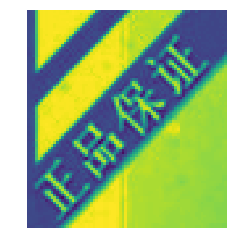

TB142XzLXXXXXa2XVXXunYpLFXX
NK
(339.33, 382.1, 385.27, 434.92)


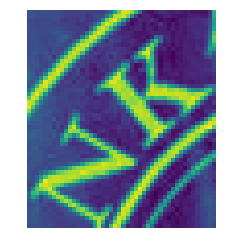

TB142XzLXXXXXa2XVXXunYpLFXX
之家
(448.13, 380.25, 505.99, 447.41)


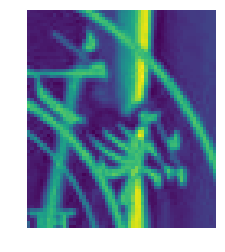

TB142XzLXXXXXa2XVXXunYpLFXX
微信：
(329.85, 461.33, 353.26, 506.27)


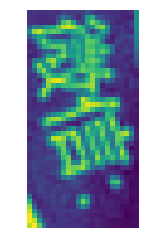

TB142XzLXXXXXa2XVXXunYpLFXX
NAER
(351.67, 501.97, 387.56, 543.31)


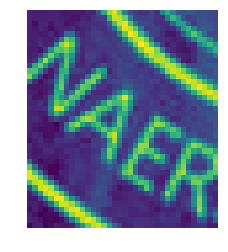

TB142XzLXXXXXa2XVXXunYpLFXX
love娟4
(467.95, 457.19, 504.99, 519.2)


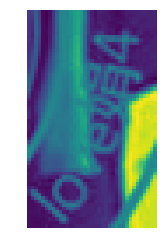

TB143JELXXXXXbYXFXXunYpLFXX
FCN
(418.66, 267.27, 422.39, 307.14)


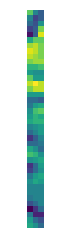

TB144hHLXXXXXX5XFXXunYpLFXX
13
(212.5, 145.0, 223.17, 157.67)


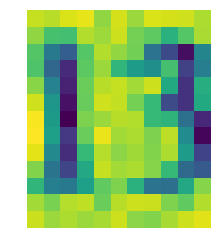

TB144hHLXXXXXX5XFXXunYpLFXX
1
(302.83, 146.33, 305.83, 158.0)


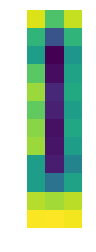

TB144NwLXXXXXc_XVXXunYpLFXX
G
(304.38, 333.08, 319.04, 348.67)


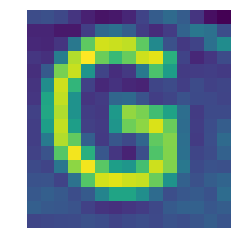

TB144NwLXXXXXc_XVXXunYpLFXX
msi
(22.63, 303.33, 31.21, 328.25)


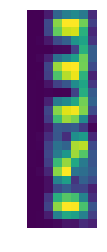

TB144NwLXXXXXc_XVXXunYpLFXX
Z87-G45
(25.63, 351.92, 40.79, 436.58)


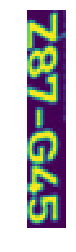

TB144NwLXXXXXc_XVXXunYpLFXX
GAMING
(24.79, 439.83, 39.79, 522.92)


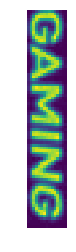

TB1460ALXXXXXXSXVXXunYpLFXX
ZOMEi
(655.64, 494.27, 699.73, 600.27)


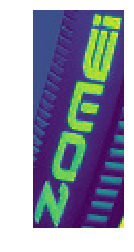

TB147hBLXXXXXc9XFXXunYpLFXX
嘉韵
(227.59, 352.54, 248.62, 395.99)


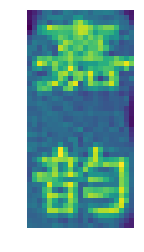

TB147hBLXXXXXc9XFXXunYpLFXX
植物去屑
(272.79, 343.6, 317.0, 574.86)


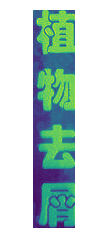

TB147hBLXXXXXc9XFXXunYpLFXX
洗头液
(345.55, 506.33, 371.01, 568.14)


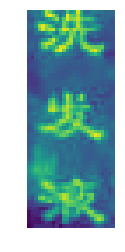

TB1484hgf6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
送礼推荐
(22.84, 2.12, 89.84, 124.12)


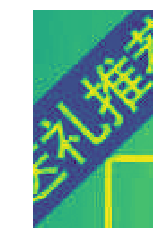

TB1484hgf6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
（礼品包装）
(323.18, 250.79, 350.84, 360.45)


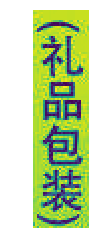

TB1484hgf6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
（12朵礼盒玫瑰）
(392.18, 490.12, 443.84, 633.79)


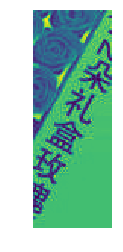

TB1498sLXXXXXbRaXXXunYpLFXX
￥
(23.16, 130.26, 55.16, 170.46)


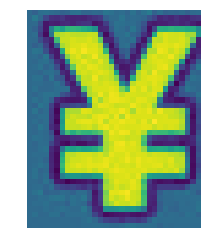

TB1498sLXXXXXbRaXXXunYpLFXX
元
(207.16, 107.66, 234.76, 138.46)


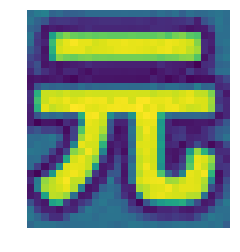

TB1498sLXXXXXbRaXXXunYpLFXX
/
(243.56, 102.46, 248.36, 176.46)


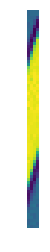

TB1498sLXXXXXbRaXXXunYpLFXX
+
(358.56, 130.26, 386.76, 161.46)


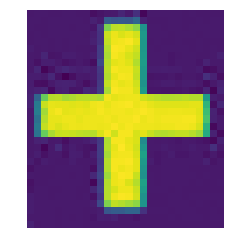

TB149I9jYYI8KJjy0FaXXbAiVXa_!!0-item_pic.jpg
生锈
(4.36, 15.03, 81.0, 177.94)


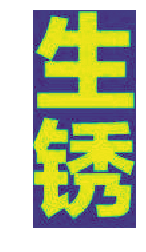

TB14A50ogvD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
宣
(194.62, 182.11, 208.84, 196.65)


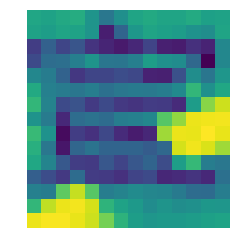

TB14A9Nd46I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
1
(40.0, 204.73, 214.0, 556.0)


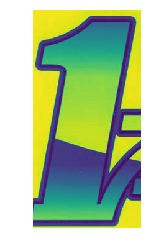

TB14A9Nd46I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
5
(58.5, 667.0, 96.5, 712.0)


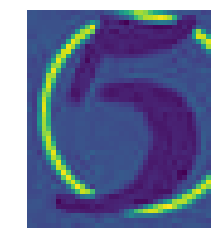

TB14A9Nd46I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
著
(543.55, 575.55, 555.91, 589.09)


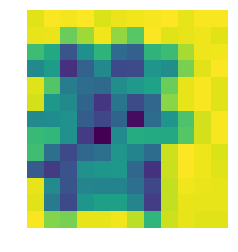

TB14AhVLXXXXXXGXXXXunYpLFXX
?
(364.87, 108.34, 377.84, 122.41)


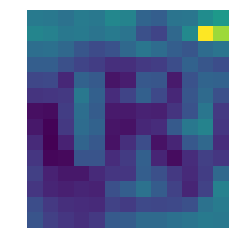

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
A
(107.62, 196.88, 112.91, 206.05)


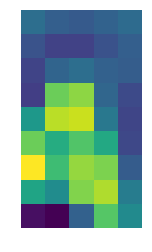

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
S
(139.58, 199.13, 147.5, 207.31)


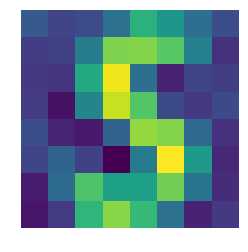

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
D
(176.69, 198.76, 184.35, 206.94)


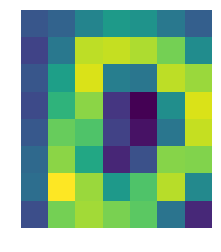

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
F
(212.92, 199.39, 218.32, 209.46)


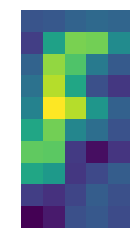

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
L
(386.15, 200.39, 389.92, 208.2)


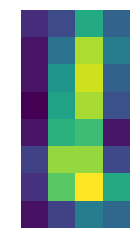

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
I
(342.12, 164.17, 346.64, 175.86)


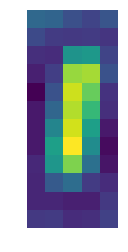

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
U
(308.15, 164.17, 314.81, 174.6)


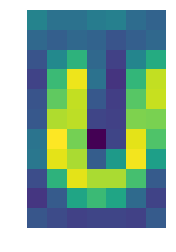

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
Y
(272.3, 164.17, 278.33, 173.97)


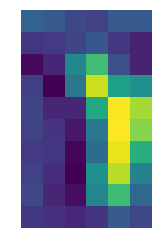

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
T
(237.08, 162.91, 245.37, 174.23)


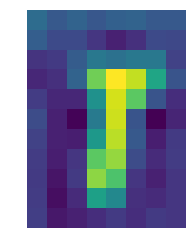

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
R
(203.11, 165.8, 207.51, 172.72)


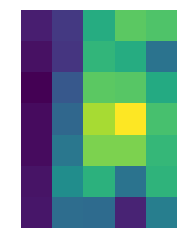

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
E
(168.63, 165.17, 174.55, 173.97)


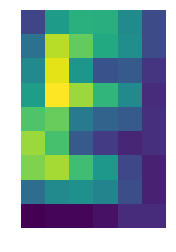

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
0
(393.07, 143.41, 397.47, 151.96)


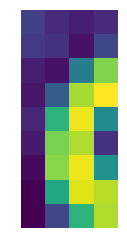

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
9
(359.47, 143.78, 366.13, 152.59)


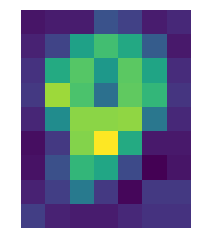

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
8
(323.25, 143.41, 330.91, 153.22)


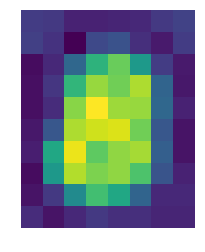

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
6
(257.32, 145.67, 262.61, 151.96)


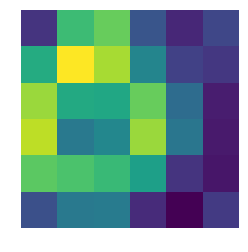

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
4
(185.87, 144.41, 191.53, 151.59)


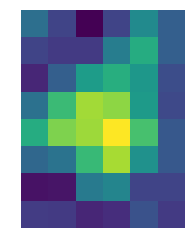

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
3
(152.53, 143.15, 155.31, 151.33)


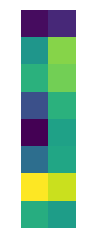

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
2
(116.05, 142.15, 121.71, 151.96)


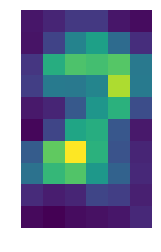

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
1
(79.57, 141.53, 83.97, 150.7)


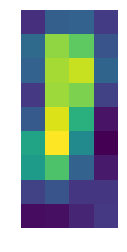

TB14AsVmCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
森
(286.54, 241.05, 355.7, 319.42)


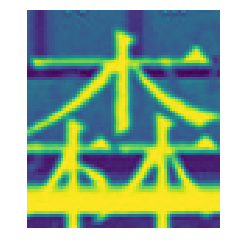

TB14b4jLXXXXXazXFXXunYpLFXX
30
(835.5, 129.0, 871.5, 175.0)


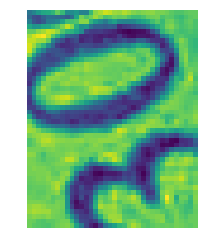

TB14b4jLXXXXXazXFXXunYpLFXX
04170
(1363.5, 161.0, 1382.5, 200.0)


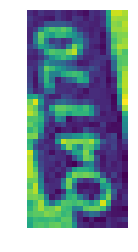

TB14b4jLXXXXXazXFXXunYpLFXX
821-00074-SC3115'
(1079.5, 682.0, 1095.5, 800.0)


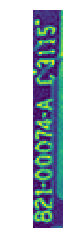

TB14b4jLXXXXXazXFXXunYpLFXX
盖
(1269.5, 1111.0, 1323.5, 1171.0)


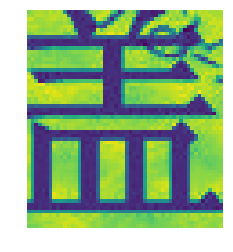

TB14b4jLXXXXXazXFXXunYpLFXX
华
(289.5, 1296.0, 433.5, 1463.0)


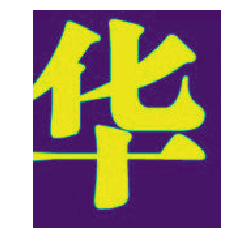

TB14b4jLXXXXXazXFXXunYpLFXX
东
(474.5, 1300.0, 609.5, 1440.0)


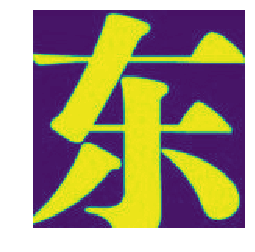

TB14BJNLXXXXXagXpXXunYpLFXX
个
(130.42, 561.38, 226.73, 688.31)


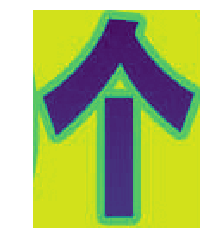

TB14EXvLXXXXXX.aXXXunYpLFXX
13229861706
(392.0, 577.0, 527.0, 758.2)


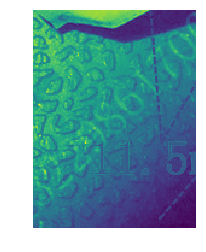

TB14EXvLXXXXXX.aXXXunYpLFXX
61706
(415.0, 309.0, 470.2, 401.4)


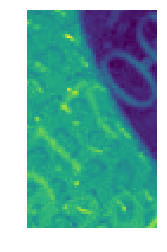

TB14EXvLXXXXXX.aXXXunYpLFXX
13229861706
(306.4, 7.2, 444.4, 184.6)


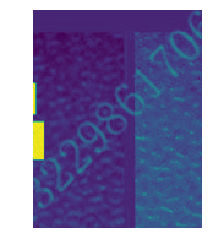

TB14F4yLXXXXXc6XFXXunYpLFXX
I
(343.42, 354.83, 368.92, 404.5)


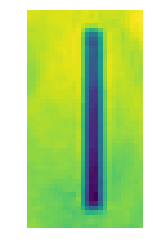

TB14fRfLXXXXXazXFXXunYpLFXX
抢
(248.32, -2.6, 303.7, 61.4)


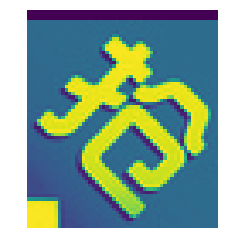

TB14fRfLXXXXXazXFXXunYpLFXX
0
(5.45, 43.8, 29.8, 68.15)


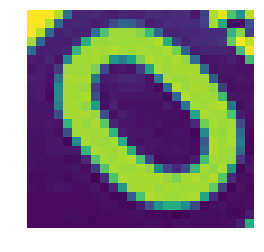

TB14fRfLXXXXXazXFXXunYpLFXX
利润中·
(20.47, 5.6, 70.62, 57.78)


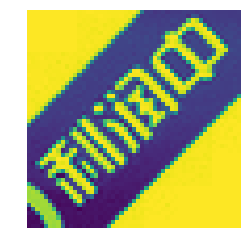

TB14ftALXXXXXX7XVXXunYpLFXX
80
(480.07, 320.84, 511.64, 358.84)


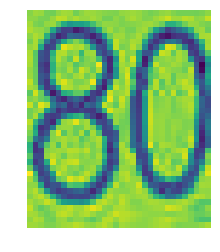

TB14ftALXXXXXX7XVXXunYpLFXX
L
(482.78, 278.04, 503.53, 313.18)


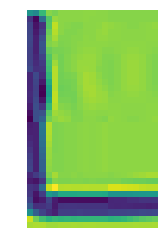

TB14ftALXXXXXX7XVXXunYpLFXX
馆
(123.96, 52.2, 156.64, 91.6)


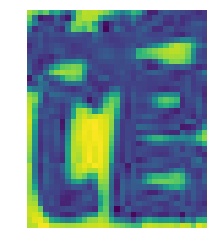

TB14ftALXXXXXX7XVXXunYpLFXX
豆
(120.53, 34.42, 134.62, 50.78)


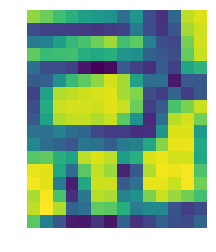

TB14ftALXXXXXX7XVXXunYpLFXX
豆
(125.36, 23.89, 149.98, 49.07)


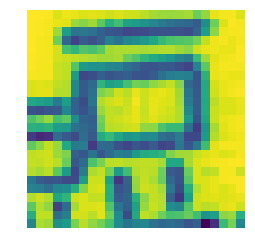

TB14GhSLXXXXXbvXXXXunYpLFXX
▼
(487.95, 405.0, 501.28, 418.77)


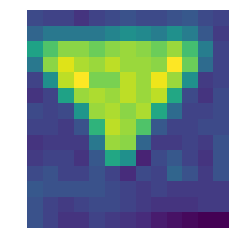

TB14GXCLXXXXXb4XFXXunYpLFXX
送
(120.08, 514.69, 168.31, 567.08)


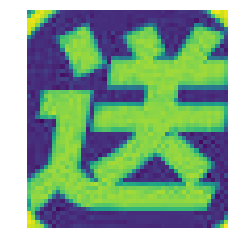

TB14GXCLXXXXXb4XFXXunYpLFXX
Drawing
(382.08, 43.46, 403.77, 141.08)


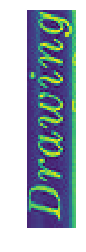

TB14GXCLXXXXXb4XFXXunYpLFXX
EyeBrow
(401.92, 44.69, 407.92, 92.69)


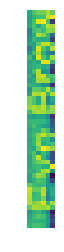

TB14GXCLXXXXXb4XFXXunYpLFXX
EyeBrow
(475.62, 43.08, 487.46, 90.85)


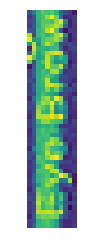

TB14GXCLXXXXXb4XFXXunYpLFXX
EyeBrow
(548.62, 41.85, 558.23, 91.46)


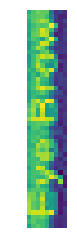

TB14GXCLXXXXXb4XFXXunYpLFXX
EyeBrow
(620.46, 43.46, 633.54, 92.46)


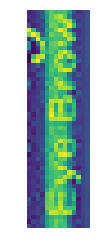

TB14GXCLXXXXXb4XFXXunYpLFXX
EyeBrow
(695.08, 41.85, 704.31, 90.85)


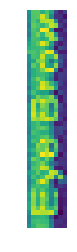

TB14GXCLXXXXXb4XFXXunYpLFXX
EyeBrow
(768.08, 41.46, 778.15, 91.85)


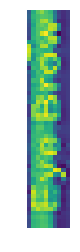

TB14GXCLXXXXXb4XFXXunYpLFXX
Drawing
(529.69, 42.08, 548.62, 136.23)


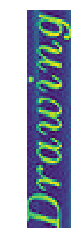

TB14GXCLXXXXXb4XFXXunYpLFXX
Drawing
(602.77, 43.69, 622.46, 141.08)


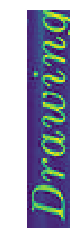

TB14GXCLXXXXXb4XFXXunYpLFXX
Drawing
(673.38, 42.62, 696.31, 140.31)


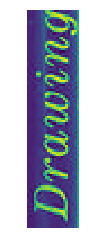

TB14GXCLXXXXXb4XFXXunYpLFXX
Drawing
(748.62, 41.85, 769.92, 140.08)


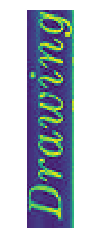

TB14GXCLXXXXXb4XFXXunYpLFXX
Draw
(51.85, 58.46, 68.85, 107.08)


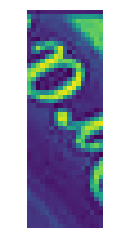

TB14ilkLXXXXXcGapXXunYpLFXX
孕
(114.5, 12.0, 172.5, 108.0)


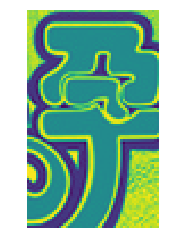

TB14ilkLXXXXXcGapXXunYpLFXX
ENJOY
(9.0, 56.33, 43.33, 93.0)


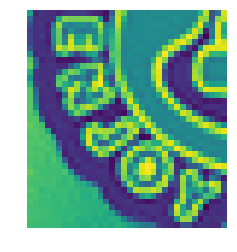

TB14iO5l9fD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
15
(266.27, 137.82, 367.27, 243.91)


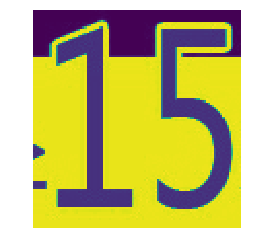

TB14iO5l9fD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
?
(257.55, 30.09, 271.18, 44.18)


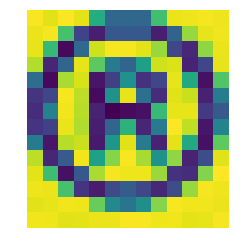

TB14iP7SFXXXXc.aXXXXXXXXXXX_!!0-item_pic.jpg
剂
(430.77, 302.01, 459.35, 332.83)


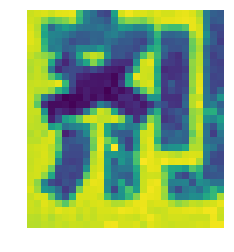

TB14iP7SFXXXXc.aXXXXXXXXXXX_!!0-item_pic.jpg
缝
(520.84, 259.33, 549.79, 291.87)


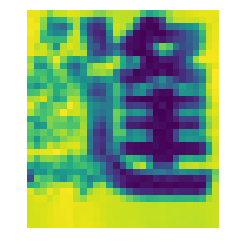

TB14iP7SFXXXXc.aXXXXXXXXXXX_!!0-item_pic.jpg
剂
(519.15, 301.38, 550.09, 332.37)


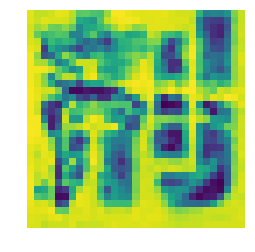

TB14iP7SFXXXXc.aXXXXXXXXXXX_!!0-item_pic.jpg
耐
(10.05, 351.45, 98.24, 463.25)


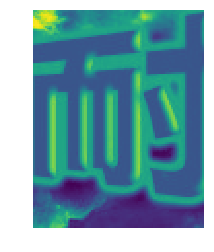

TB14iP7SFXXXXc.aXXXXXXXXXXX_!!0-item_pic.jpg
热
(103.76, 332.09, 229.87, 467.92)


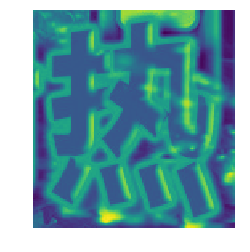

TB14ISOejgy_uJjSZTEXXcYkFXa_!!0-item_pic.jpg
?
(88.2, 11.8, 111.0, 36.6)


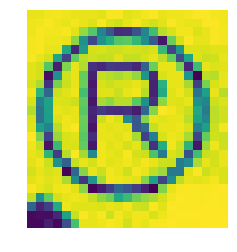

TB14IuabdXXWeJjSZFvXXa6lpXa_!!0-item_pic.jpg
洛
(341.75, 114.5, 355.25, 132.0)


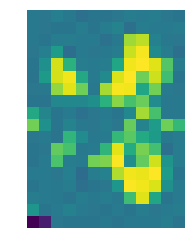

TB14IuabdXXWeJjSZFvXXa6lpXa_!!0-item_pic.jpg
对
(9.25, 337.0, 73.75, 403.5)


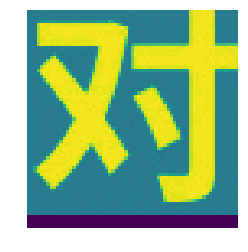

TB14IuabdXXWeJjSZFvXXa6lpXa_!!0-item_pic.jpg
！
(82.25, 338.0, 100.25, 393.5)


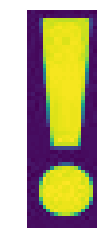

TB14jthRVXXXXX8XXXXXXXXXXXX_!!0-item_pic.jpg
3
(222.96, 251.26, 234.85, 269.04)


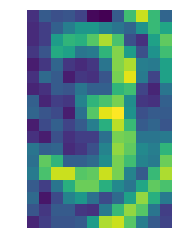

TB14jthRVXXXXX8XXXXXXXXXXXX_!!0-item_pic.jpg
3
(532.85, 263.93, 544.74, 283.04)


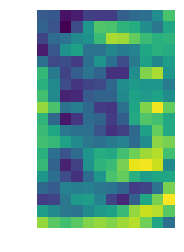

TB14jX_l7fb_uJjSsrbXXb6bVXa_!!0-item_pic.jpg
水生生物与养殖
(167.95, 90.8, 187.55, 212.0)


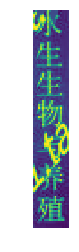

TB14jX_l7fb_uJjSsrbXXb6bVXa_!!0-item_pic.jpg
419
(49.55, 90.0, 80.35, 134.1)


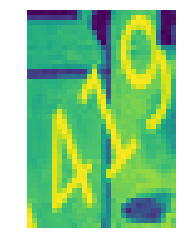

TB14K82LpXXXXXqaXXXunYpLFXX
B
(486.33, 47.9, 512.45, 83.5)


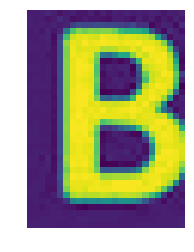

TB14K82LpXXXXXqaXXXunYpLFXX
T
(543.09, 51.51, 571.52, 87.76)


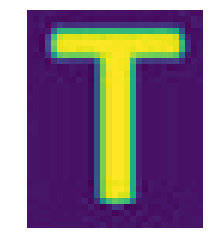

TB14l8RLXXXXXbYXXXXunYpLFXX
TEAM
(766.33, 727.67, 790.67, 785.67)


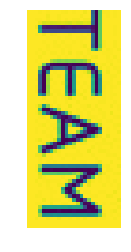

TB14l8RLXXXXXbYXXXXunYpLFXX
?
(492.71, 276.57, 501.86, 286.86)


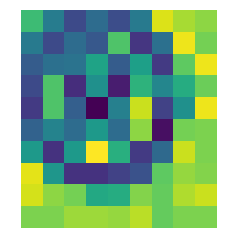

TB14ldsLXXXXXbraXXXunYpLFXX
7
(347.63, 677.0, 391.63, 733.5)


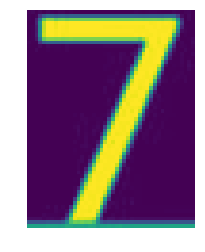

TB14ldsLXXXXXbraXXXunYpLFXX
B
(184.13, 679.0, 197.63, 693.75)


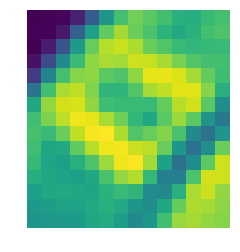

TB14ldsLXXXXXbraXXXunYpLFXX
B
(269.13, 534.75, 282.13, 550.25)


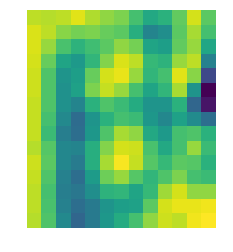

TB14ldsLXXXXXbraXXXunYpLFXX
910
(164.88, 336.5, 183.63, 356.0)


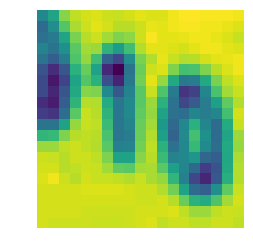

TB14LhfePnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
富贵满堂
(164.6, 400.2, 175.6, 462.8)


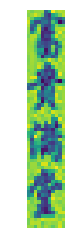

TB14ltVLXXXXXX3XXXXunYpLFXX
窖湾
(150.41, 294.91, 202.05, 355.36)


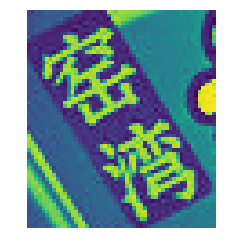

TB14ltVLXXXXXX3XXXXunYpLFXX
甜油
(385.59, 458.45, 405.05, 499.0)


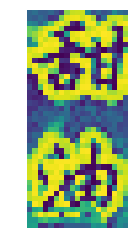

TB14ltVLXXXXXX3XXXXunYpLFXX
S
(91.59, 407.91, 112.68, 434.09)


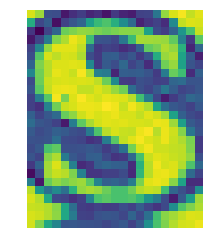

TB14ltVLXXXXXX3XXXXunYpLFXX
甜油
(526.5, 457.0, 543.41, 496.09)


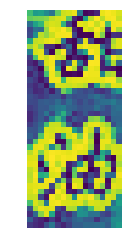

TB14ltVLXXXXXX3XXXXunYpLFXX
S
(423.23, 474.09, 430.86, 487.18)


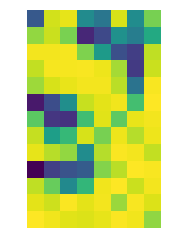

TB14ltVLXXXXXX3XXXXunYpLFXX
S
(556.77, 470.64, 567.05, 481.73)


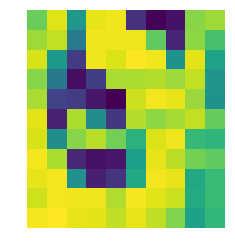

TB14ltVLXXXXXX3XXXXunYpLFXX
味鲜醇厚
(605.77, 262.73, 640.23, 413.09)


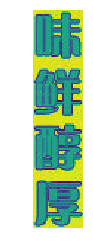

TB14ltVLXXXXXX3XXXXunYpLFXX
传统工艺
(654.14, 263.45, 684.32, 410.45)


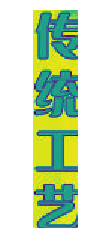

TB14ltVLXXXXXX3XXXXunYpLFXX
酱香浓郁
(607.41, 434.36, 638.59, 584.64)


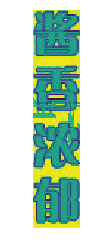

TB14ltVLXXXXXX3XXXXunYpLFXX
天然晒制
(656.77, 435.36, 685.32, 583.73)


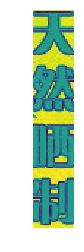

TB14lyEX8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
人一座
(177.75, 473.0, 211.75, 548.5)


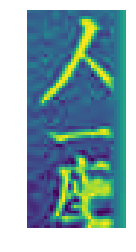

TB14lyEX8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
t
(492.25, 241.0, 506.75, 268.5)


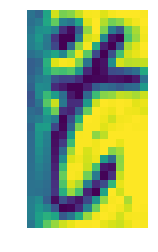

TB14m3_etLO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
1
(269.99, 336.49, 280.63, 355.44)


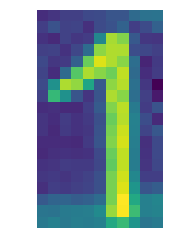

TB14m3_etLO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
暖身
(256.96, 270.72, 273.12, 305.04)


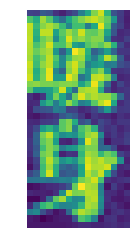

TB14m3_etLO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
族
(196.51, 261.74, 249.58, 320.01)


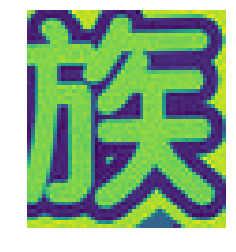

TB14m3_etLO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
家
(156.8, 251.17, 198.31, 294.47)


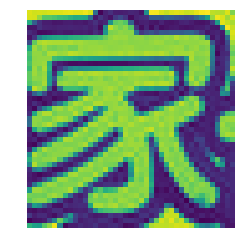

TB14m3_etLO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
LK
(3.99, 84.39, 55.46, 136.06)


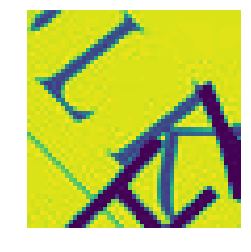

TB14OlALXXXXXcFXFXXunYpLFXX
?
(238.3, 207.11, 249.21, 222.54)


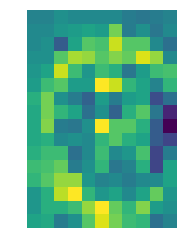

TB14OtTLXXXXXahXXXXunYpLFXX
江浙沪皖包邮
(554.69, 78.75, 612.19, 435.63)


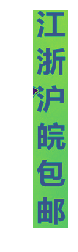

TB14OtTLXXXXXahXXXXunYpLFXX
此为4瓶链接
(630.19, 367.88, 673.56, 668.75)


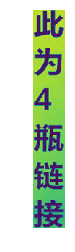

TB14pabLpXXXXamXFXXunYpLFXX
NT
(435.53, 49.78, 471.53, 100.11)


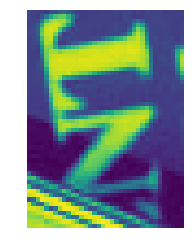

TB14pabLpXXXXamXFXXunYpLFXX
AN
(469.2, 58.44, 500.53, 102.78)


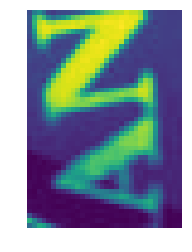

TB14pabLpXXXXamXFXXunYpLFXX
Zwe
(148.53, 112.78, 174.86, 182.78)


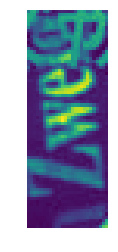

TB14pabLpXXXXamXFXXunYpLFXX
VIVO
(349.53, 357.78, 359.86, 444.44)


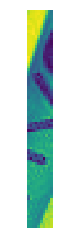

TB14PafLpXXXXb4XpXXunYpLFXX
漂移
(656.56, 13.07, 777.14, 135.65)


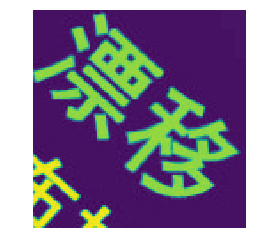

TB14PVeLXXXXXbOXFXXunYpLFXX
包邮
(40.58, 535.17, 116.25, 663.33)


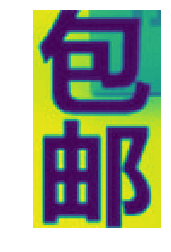

TB14PVeLXXXXXbOXFXXunYpLFXX
glister
(429.08, 392.17, 472.42, 564.0)


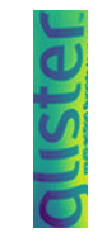

TB14PVeLXXXXXbOXFXXunYpLFXX
多效合一全面保护
(393.75, 246.33, 408.75, 347.33)


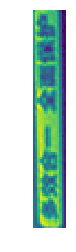

TB14PVeLXXXXXbOXFXXunYpLFXX
200g
(498.58, 158.5, 510.08, 195.67)


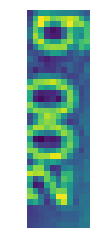

TB14PVeLXXXXXbOXFXXunYpLFXX
清新口气
(440.58, 190.17, 455.25, 232.17)


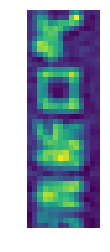

TB14PVeLXXXXXbOXFXXunYpLFXX
美白牙齿
(427.75, 187.83, 442.58, 231.0)


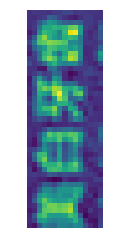

TB14PVeLXXXXXbOXFXXunYpLFXX
防止蛀牙
(414.75, 188.0, 429.58, 232.0)


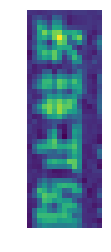

TB14PVeLXXXXXbOXFXXunYpLFXX
安全高效
(390.42, 192.17, 404.25, 233.33)


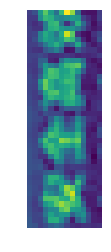

TB14PVeLXXXXXbOXFXXunYpLFXX
多一件，多减一元
(583.92, 72.67, 626.58, 385.67)


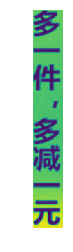

TB14PVeLXXXXXbOXFXXunYpLFXX
请联系客服改价哦
(635.08, 71.33, 670.75, 386.83)


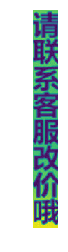

TB14QEhPVXXXXcbXpXXXXXXXXXX_!!0-item_pic.jpg
颈肩腰腿痛
(219.66, 36.68, 252.25, 189.95)


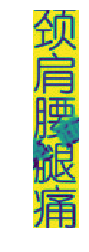

TB14QEhPVXXXXcbXpXXXXXXXXXX_!!0-item_pic.jpg
特效手法治疗图解
(178.52, 35.32, 213.16, 282.86)


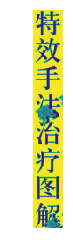

TB14QEhPVXXXXcbXpXXXXXXXXXX_!!0-item_pic.jpg
叶希贤临证精华
(271.34, 39.82, 284.89, 156.32)


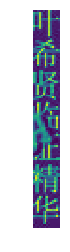

TB14QEhPVXXXXcbXpXXXXXXXXXX_!!0-item_pic.jpg
主编
(151.66, 39.82, 157.93, 60.77)


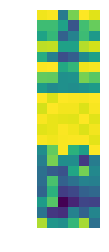

TB14QEhPVXXXXcbXpXXXXXXXXXX_!!0-item_pic.jpg
王平
(150.3, 73.5, 157.98, 100.59)


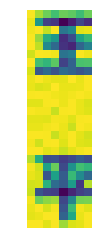

TB14qJPLXXXXXXuXpXXunYpLFXX
D
(365.31, 258.97, 382.96, 280.38)


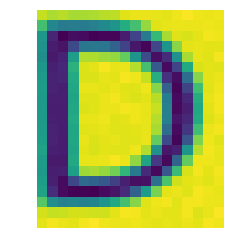

TB14qJPLXXXXXXuXpXXunYpLFXX
6000mAh
(361.19, 339.59, 386.37, 453.21)


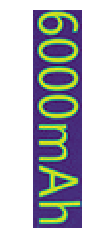

TB14qJPLXXXXXXuXpXXunYpLFXX
锂聚合物电池
(375.1, 465.76, 388.78, 530.29)


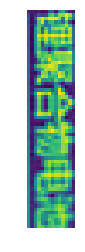

TB14qJPLXXXXXXuXpXXunYpLFXX
USB充电电池
(358.22, 465.32, 371.69, 532.74)


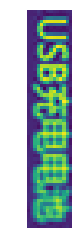

TB14qJPLXXXXXXuXpXXunYpLFXX
额定输出电压：1.5V
(280.69, 348.53, 292.16, 468.32)


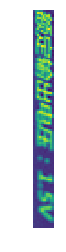

TB14qJPLXXXXXXuXpXXunYpLFXX
执行标准：GB3124.2014
(291.6, 353.5, 308.72, 514.21)


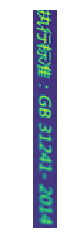

TB14qJPLXXXXXXuXpXXunYpLFXX
意
(454.31, 338.18, 466.78, 356.71)


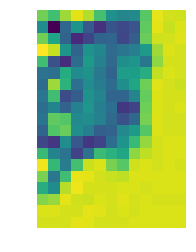

TB14qJPLXXXXXXuXpXXunYpLFXX
注
(468.99, 326.91, 477.69, 346.21)


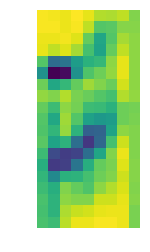

TB14qJPLXXXXXXuXpXXunYpLFXX
mAh
(703.01, 594.15, 719.9, 627.68)


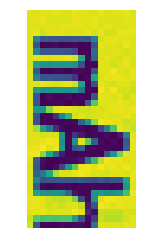

TB14r0yLXXXXXckXVXXunYpLFXX
?
(263.9, 48.2, 278.9, 63.2)


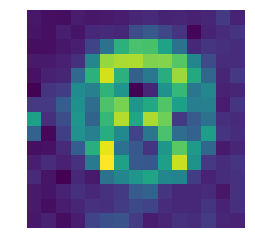

TB14r0yLXXXXXckXVXXunYpLFXX
Dimengna
(297.5, 438.0, 315.5, 510.0)


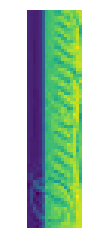

TB14r4uLXXXXXaLaXXXunYpLFXX
g
(315.18, 693.55, 319.79, 705.09)


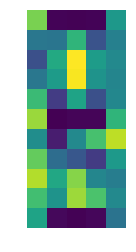

TB14r8FLXXXXXbyXFXXunYpLFXX
M
(41.55, 21.64, 81.0, 78.91)


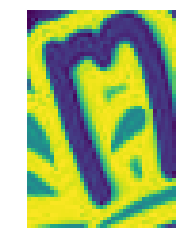

TB14SBTLXXXXXa6XXXXunYpLFXX
k
(610.67, 645.22, 623.33, 669.56)


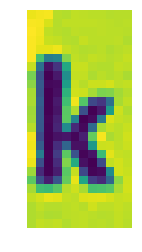

TB14SBTLXXXXXa6XXXXunYpLFXX
1
(501.33, 650.56, 518.0, 669.89)


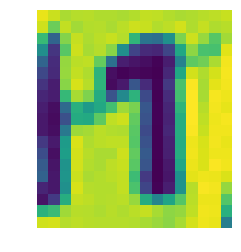

TB14SBTLXXXXXa6XXXXunYpLFXX
鲜
(679.0, 183.22, 725.0, 233.22)


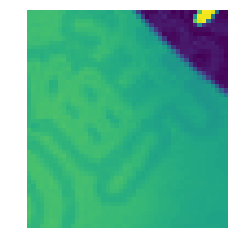

TB14SBTLXXXXXa6XXXXunYpLFXX
鸡排
(714.33, 12.89, 796.0, 193.22)


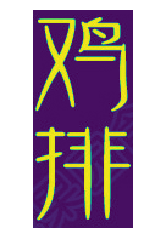

TB14SBTLXXXXXa6XXXXunYpLFXX
SD鲜果
(335.67, 145.89, 450.33, 261.22)


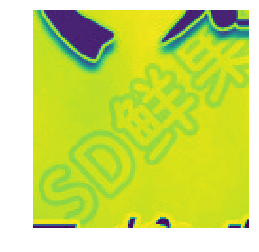

TB14SBTLXXXXXa6XXXXunYpLFXX
品
(500.0, 50.22, 554.67, 109.89)


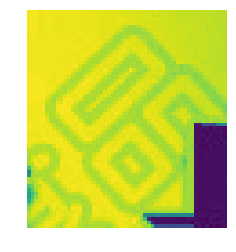

TB14SBTLXXXXXa6XXXXunYpLFXX
六合
(64.67, 95.89, 135.33, 170.56)


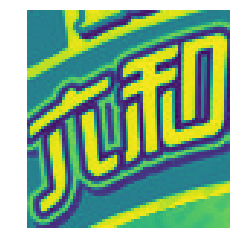

TB14SBTLXXXXXa6XXXXunYpLFXX
品
(203.0, 48.89, 257.67, 109.22)


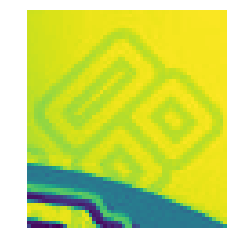

TB14tRrc6gy_uJjSZKPXXaGlFXa_!!0-item_pic.jpg
持续更新
(20.23, -1.15, 134.69, 211.62)


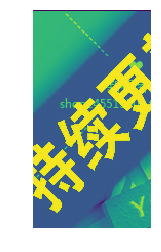

TB14UBtLXXXXXaAaXXXunYpLFXX
y
(657.36, 477.79, 670.36, 517.12)


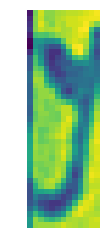

TB14UBtLXXXXXaAaXXXunYpLFXX
e
(778.03, 475.12, 796.7, 499.23)


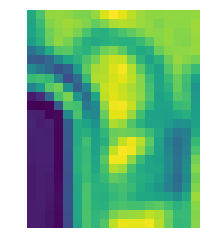

TB14upomf2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
主编
(557.2, 271.2, 572.0, 288.0)


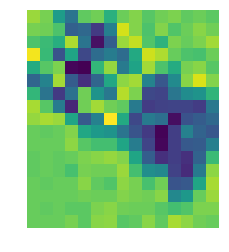

TB14upomf2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
J
(232.2, 40.8, 238.2, 52.6)


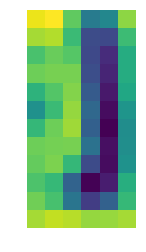

TB14vdALXXXXXaVXVXXunYpLFXX
E
(709.18, 705.45, 729.09, 735.09)


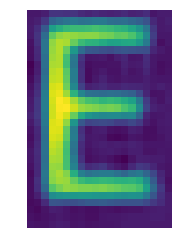

TB14vdALXXXXXaVXVXXunYpLFXX
屋
(755.27, 755.64, 786.64, 788.18)


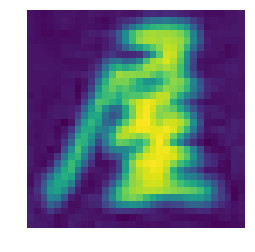

TB14VFALXXXXXbgXVXXunYpLFXX
莲花身体乳
(556.36, 96.73, 643.91, 649.82)


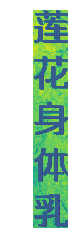

TB14VlFLXXXXXboXFXXunYpLFXX
1
(34.9, 337.65, 63.29, 399.5)


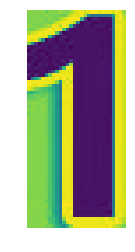

TB14VlFLXXXXXboXFXXunYpLFXX
2
(586.87, 339.23, 627.37, 399.92)


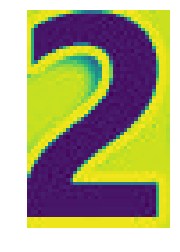

TB14VlFLXXXXXboXFXXunYpLFXX
1
(307.21, 580.96, 313.98, 589.46)


TB14VlFLXXXXXboXFXXunYpLFXX
2
(513.17, 582.12, 520.52, 591.19)


TB14xpBLXXXXXcxXFXXunYpLFXX
b
(353.55, 270.64, 396.09, 325.64)


TB14xpBLXXXXXcxXFXXunYpLFXX
PACIFIC
(503.36, 306.0, 553.82, 362.0)


TB14XVEdvxNTKJjy0FjXXX6yVXa_!!2-item_pic.png
U
(40.15, 30.06, 55.39, 49.47)


TB14XVEdvxNTKJjy0FjXXX6yVXa_!!2-item_pic.png
P
(65.68, 29.53, 75.98, 50.88)


TB14y68ftzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
JONESBO
(27.4, 226.2, 52.2, 290.0)


TB14YBFLXXXXXaWXFXXunYpLFXX
喵
(552.5, 594.0, 566.5, 608.0)


TB14z9jLpXXXXc.XXXXunYpLFXX
9
(204.91, 25.73, 214.21, 36.65)


TB14ZlzLXXXXXbRXVXXunYpLFXX
国
(423.21, 93.59, 498.93, 216.43)


TB14ZlzLXXXXXbRXVXXunYpLFXX
美
(192.53, 87.51, 281.87, 213.89)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
总
(395.2, 61.6, 413.0, 84.2)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
主
(424.2, 66.6, 443.0, 86.8)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
编
(449.6, 63.8, 467.4, 84.2)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
新
(529.4, 67.0, 547.2, 88.2)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
生
(319.8, 202.4, 390.6, 309.4)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
12
(263.2, 589.6, 281.6, 614.2)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
+
(241.6, 661.6, 254.0, 678.0)


TB14Zy1n8DH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
15
(260.2, 653.4, 280.8, 675.2)


TB14_VGLXXXXXacXFXXunYpLFXX
罗裙飘流
(46.5, 67.0, 110.68, 255.64)


TB14_VGLXXXXXacXFXXunYpLFXX
用纤细的柔情拨开你眉间的轻愁
(149.41, 181.36, 190.41, 573.09)


TB15.9VocLJ8KJjy0FnXXcFDpXa_!!0-item_pic.jpg
送
(478.6, 217.4, 548.8, 296.4)


TB15.sVNpXXXXaAXpXXXXXXXXXX_!!0-item_pic.jpg
电
(113.39, 523.11, 130.47, 545.97)


TB15.sVNpXXXXaAXpXXXXXXXXXX_!!0-item_pic.jpg
微
(87.64, 522.14, 106.07, 546.43)


TB15.sVNpXXXXaAXpXXXXXXXXXX_!!0-item_pic.jpg
※
(64.87, 531.86, 90.56, 559.57)


TB150FTLXXXXXbaXXXXunYpLFXX
新
(742.79, 301.74, 753.21, 313.89)


TB150K9fsCNZ1JjSZFHXXb.kVXa_!!0-item_pic.jpg
3
(488.38, 586.67, 493.96, 595.58)


TB150K9fsCNZ1JjSZFHXXb.kVXa_!!0-item_pic.jpg
2
(453.13, 585.67, 461.13, 596.17)


TB150K9fsCNZ1JjSZFHXXb.kVXa_!!0-item_pic.jpg
1
(419.29, 587.25, 425.13, 597.17)


TB152lvLXXXXXXRaXXXunYpLFXX
日
(686.26, 428.43, 703.22, 445.83)


TB152lvLXXXXXXRaXXXunYpLFXX
中
(642.9, 428.43, 655.14, 445.83)


TB152lvLXXXXXXRaXXXunYpLFXX
V
(661.78, 425.11, 681.34, 444.83)


TB152lvLXXXXXXRaXXXunYpLFXX
NIVEA
(495.74, 341.31, 537.06, 402.63)


TB152lvLXXXXXXRaXXXunYpLFXX
NIVEA
(363.26, 328.63, 382.1, 386.07)


TB152lvLXXXXXXRaXXXunYpLFXX
double
(306.66, 331.79, 319.9, 397.03)


TB152lvLXXXXXXRaXXXunYpLFXX
effect
(286.94, 328.35, 301.62, 381.19)


TB152lvLXXXXXXRaXXXunYpLFXX
48h
(244.02, 340.15, 252.22, 373.55)


TB152NPLXXXXXXKXpXXunYpLFXX
QQ
(250.66, 158.18, 272.02, 182.32)


TB152NPLXXXXXXKXpXXunYpLFXX
找
(263.05, 256.32, 276.8, 279.75)


TB154FGLXXXXXajXFXXunYpLFXX
出玲珑剔透的珠子，质感很强。
(23.63, 189.5, 36.88, 380.0)


TB154FGLXXXXXajXFXXunYpLFXX
傅纯手工精细打磨，经数十道繁复的工序打磨
(53.13, 187.25, 66.88, 472.5)


TB154FGLXXXXXajXFXXunYpLFXX
精心挑选优质尼泊尔菩提，由技艺娴熟的老师
(83.13, 188.75, 97.88, 475.25)


TB155plLXXXXXcpapXXunYpLFXX
买4版
(36.96, 7.53, 62.03, 89.11)


TB156hsLXXXXXbSaXXXunYpLFXX
CAR.STIGJH
(355.29, 390.86, 366.43, 454.71)


TB156hsLXXXXXbSaXXXunYpLFXX
CAR.STIGJH
(348.29, 106.43, 360.57, 166.29)


TB156hsLXXXXXbSaXXXunYpLFXX
CAR.STIGJH
(350.86, 248.43, 364.14, 310.14)


TB156OGIFXXXXcxXFXXXXXXXXXX_!!0-item_pic.jpg
专业电子元器件
(699.66, 13.23, 766.25, 503.86)


TB1580Tj2BNTKJjy0FdXXcPpVXa_!!0-item_pic.jpg
外形按键一样即可使用
(342.88, 164.5, 400.63, 725.0)


TB1580Tj2BNTKJjy0FdXXcPpVXa_!!0-item_pic.jpg
双鹿电池
(100.38, 490.0, 114.63, 579.5)


TB1580Tj2BNTKJjy0FdXXcPpVXa_!!0-item_pic.jpg
双鹿电池
(149.88, 489.0, 167.88, 578.5)


TB1580Tj2BNTKJjy0FdXXcPpVXa_!!0-item_pic.jpg
+
(611.88, 356.5, 629.13, 375.75)


TB159lGLXXXXXaGXFXXunYpLFXX
凄
(334.12, 109.51, 377.93, 184.65)


TB159lGLXXXXXaGXFXXunYpLFXX
三
(103.6, 54.53, 150.86, 102.18)


TB15aFsLXXXXXb_aXXXunYpLFXX
￥
(88.05, 616.14, 125.05, 653.14)


TB15ARRLXXXXXa5XXXXunYpLFXX
.9
(391.55, 694.18, 441.0, 749.0)


TB15c2rGFXXXXXAXVXXXXXXXXXX_!!2-item_pic.png
5
(86.78, 93.68, 109.62, 126.47)


TB15ddqLXXXXXcGaXXXunYpLFXX
g
(477.67, 714.33, 494.0, 734.67)


TB15ddqLXXXXXcGaXXXunYpLFXX
进口
(337.0, 273.33, 374.33, 347.67)


TB15dY_dlE_1uJjSZFOXXXNwXXa_!!0-item_pic.jpg
2
(489.33, 99.33, 529.0, 157.33)


TB15dY_dlE_1uJjSZFOXXXNwXXa_!!0-item_pic.jpg
D
(538.4, 615.8, 555.6, 633.2)


TB15ewPd7fb_uJkHFCcXXXagFXa_!!0-item_pic.jpg
F
(632.28, 18.05, 706.8, 125.82)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
BOTNY
(16.99, 11.18, 31.5, 57.9)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
防冻液
(257.49, 144.01, 301.27, 266.02)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
AntiFreeze
(289.13, 164.44, 316.08, 258.0)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
防冻、
(307.57, 232.92, 319.71, 259.72)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
防沸、
(314.06, 201.91, 326.68, 227.14)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
防腐、
(318.32, 172.24, 333.89, 198.8)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
防垢
(323.81, 142.86, 337.48, 167.51)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
净含量：2千克
(372.79, 126.61, 401.5, 182.99)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
新升级
(326.11, 242.08, 343.84, 271.66)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
冰点：
(365.34, 225.75, 382.39, 248.97)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
-25℃
(376.65, 203.53, 387.55, 224.12)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
沸点：106℃
(381.34, 153.84, 405.23, 199.52)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
绿色
(402.69, 130.19, 417.5, 151.74)


TB15f8mhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
B
(390.27, 334.49, 403.41, 349.82)


TB15fahlBTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
多
(88.73, 230.52, 109.5, 264.59)


TB15fahlBTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
情只有春庭月
(85.02, 269.32, 99.09, 380.55)


TB15fahlBTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
尤为离人照落花
(60.42, 289.03, 81.37, 418.16)


TB15fBJLXXXXXciXpXXunYpLFXX
韩国官网
(1.71, 127.24, 37.71, 298.24)


TB15fBJLXXXXXciXpXXunYpLFXX
同步更新
(45.71, 126.24, 75.38, 298.24)


TB15FVFLXXXXXX3XFXXunYpLFXX
OATOA
(123.85, 215.1, 135.45, 265.6)


TB15fXELXXXXXXMXFXXunYpLFXX
2
(173.0, 250.43, 206.29, 305.43)


TB15fXELXXXXXXMXFXXunYpLFXX
1
(272.43, 260.71, 292.14, 306.0)


TB15GBMLXXXXXbSXpXXunYpLFXX
com
(307.93, 287.65, 309.62, 308.64)


TB15GBMLXXXXXbSXpXXunYpLFXX
新
(512.8, 219.58, 541.95, 250.38)


TB15GBMLXXXXXbSXpXXunYpLFXX
?
(578.33, 387.8, 589.73, 404.55)


TB15GBMLXXXXXbSXpXXunYpLFXX
過
(500.09, 411.71, 515.42, 432.35)


TB15I.XeWagSKJjy0FhXXcrbFXa_!!0-item_pic.jpg
热卖
(86.25, 37.0, 121.75, 171.0)


TB15I.XeWagSKJjy0FhXXcrbFXa_!!0-item_pic.jpg
史
(205.25, 81.0, 223.25, 106.0)


TB15ItoLXXXXXbhapXXunYpLFXX
8
(477.12, 308.27, 500.68, 340.61)


TB15ItoLXXXXXbhapXXunYpLFXX
?
(128.79, 113.28, 141.34, 126.73)


TB15KdZNXXXXXX0XVXXXXXXXXXX_!!0-item_pic.jpg
学
(50.85, 42.54, 101.6, 98.71)


TB15KdZNXXXXXX0XVXXXXXXXXXX_!!0-item_pic.jpg
会
(135.73, 39.96, 186.6, 91.83)


TB15KJGLXXXXXaiXFXXunYpLFXX
+
(580.22, 382.22, 587.67, 390.22)


TB15KJGLXXXXXaiXFXXunYpLFXX
0
(430.0, 200.89, 436.78, 213.0)


TB15KJGLXXXXXaiXFXXunYpLFXX
0
(546.9, 162.38, 550.86, 169.55)


TB15KJGLXXXXXaiXFXXunYpLFXX
1
(544.79, 139.03, 549.93, 149.41)


TB15KJGLXXXXXaiXFXXunYpLFXX
0
(398.31, 147.59, 403.62, 155.76)


TB15KJGLXXXXXaiXFXXunYpLFXX
60
(398.59, 118.24, 406.31, 126.52)


TB15KqcfXHM8KJjSZFwMWsibXXa
8
(25.42, 369.0, 44.92, 395.33)


TB15KqcfXHM8KJjSZFwMWsibXXa
片
(47.25, 375.83, 61.58, 396.17)


TB15KqcfXHM8KJjSZFwMWsibXXa
超
(110.25, 217.33, 172.08, 283.5)


TB15KqcfXHM8KJjSZFwMWsibXXa
上
(77.08, 129.17, 96.58, 156.0)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
赠
(638.61, 605.65, 662.01, 631.05)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
南京师范大学出版社
(21.81, 670.5, 26.21, 743.1)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
主编
(16.61, 580.7, 26.21, 600.1)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
杜志建
(16.61, 603.7, 30.01, 635.5)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
物质结构与性质
(15.61, 425.58, 29.01, 493.78)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
选修3
(14.81, 378.38, 30.01, 412.18)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
高中化学
(15.61, 328.58, 30.81, 369.58)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
一遍过
(14.01, 229.52, 29.41, 279.32)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
YIBIANGUO
(16.61, 145.19, 27.01, 206.39)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
③
(195.81, 520.45, 231.41, 565.65)


TB15kwoh4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
⑥
(295.41, 417.45, 336.01, 458.85)


TB15lXHLXXXXXX_XFXXunYpLFXX
3
(125.0, 546.0, 200.67, 657.67)


TB15lXHLXXXXXX_XFXXunYpLFXX
红灵骨
(133.67, 404.33, 162.67, 485.0)


TB15lXHLXXXXXX_XFXXunYpLFXX
红灵骨
(145.67, 233.33, 169.67, 278.0)


TB15mVcLXXXXXaEXFXXunYpLFXX
100%PURENZ
(395.46, 430.65, 450.75, 651.46)


TB15mVcLXXXXXaEXFXXunYpLFXX
?
(556.54, 490.94, 565.15, 502.9)


TB15MzXdLQs8KJjSZFEXXc9RpXa_!!0-item_pic.jpg
训
(88.0, 663.25, 128.0, 708.25)


TB15MzXdLQs8KJjSZFEXXc9RpXa_!!0-item_pic.jpg
高
(149.0, 598.5, 190.0, 644.75)


TB15MzXdLQs8KJjSZFEXXc9RpXa_!!0-item_pic.jpg
E
(260.67, 627.0, 345.67, 727.33)


TB15OCThzihSKJjy0FfXXbGzFXa_!!0-item_pic.jpg
*
(7.64, 120.44, 15.62, 130.91)


TB15OCThzihSKJjy0FfXXbGzFXa_!!0-item_pic.jpg
*
(8.07, 155.78, 15.05, 168.56)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
顺美
(577.29, 83.72, 643.26, 155.63)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
公司
(0.75, 404.22, 62.29, 478.08)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
979
(326.68, 256.98, 344.86, 292.42)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
AZ
(426.08, 255.98, 442.32, 281.14)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
979
(555.55, 221.06, 576.77, 251.57)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
AZ
(311.89, 276.17, 328.15, 297.35)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
979
(212.42, 282.57, 231.66, 318.06)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
AZ
(198.12, 302.78, 215.89, 323.97)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
979
(439.35, 240.23, 461.08, 270.26)


TB15OGHNFXXXXc8XFXXXXXXXXXX_!!0-item_pic.jpg
?
(535.37, 219.08, 554.08, 240.28)


TB15pVVLXXXXXajXXXXunYpLFXX
?
(294.44, 676.04, 314.87, 709.04)


TB15Q6CHpXXXXadXpXXXXXXXXXX_!!0-item_pic.jpg
自带原厂密封背胶
(78.38, 197.57, 101.95, 421.57)


TB15QfocoUIL1JjSZFrXXb3xFXa_!!0-item_pic.jpg
梦
(592.33, 511.11, 630.78, 560.0)


TB15QmJn4PI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
实纪
(198.35, 160.27, 227.73, 218.4)


TB15QmJn4PI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
晚清宫廷
(232.79, 24.96, 271.73, 189.08)


TB15qVOLXXXXXaiXpXXunYpLFXX
http：//car.
(180.36, 288.55, 206.57, 331.33)


TB15qVOLXXXXXaiXpXXunYpLFXX
taobao.
(238.25, 312.99, 258.99, 335.35)


TB15qVOLXXXXXaiXpXXunYpLFXX
coml
(263.0, 289.48, 267.31, 317.69)


TB15qVOLXXXXXaiXpXXunYpLFXX
配件
(241.03, 251.7, 268.85, 283.77)


TB15qVOLXXXXXaiXpXXunYpLFXX
ES
(176.03, 154.95, 201.71, 185.4)


TB15R.noTnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
买
(125.92, 289.03, 164.96, 328.66)


TB15R.noTnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
送
(188.54, 273.32, 221.0, 314.41)


TB15R.noTnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
H
(98.86, 227.08, 126.03, 259.54)


TB15R.noTnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
to
(179.32, 227.08, 202.69, 250.79)


TB15R.noTnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
十万
(172.73, 59.08, 189.4, 76.71)


TB15r0uLXXXXXaMaXXXunYpLFXX
7
(762.55, 161.84, 800.55, 221.17)


TB15R9NhJnJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
￥
(51.2, 339.8, 83.4, 381.4)


TB15R9NhJnJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
304
(483.0, 388.6, 520.2, 434.4)


TB15sdOLXXXXXX2XpXXunYpLFXX
牛奶滋润护手膜
(186.51, 330.26, 207.57, 459.83)


TB15sdOLXXXXXX2XpXXunYpLFXX
護足膜
(456.51, 400.87, 476.01, 460.37)


TB15sdOLXXXXXX2XpXXunYpLFXX
牛奶滋潤
(454.26, 328.62, 475.76, 395.87)


TB15sFNLXXXXXa4XpXXunYpLFXX
最低价
(599.0, 25.0, 626.33, 84.33)


TB15T1de_nI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
R
(346.5, 231.0, 377.5, 271.0)


TB15tf5m_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
视
(300.91, 146.0, 431.0, 305.73)


TB15tf5m_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
兵
(392.82, 80.0, 405.64, 97.27)


TB15tf5m_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
看视频学车刀使用与刃磨
(111.36, 57.55, 136.09, 323.0)


TB15tf5m_nI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
化学工业出版社
(114.27, 634.91, 127.64, 724.18)


TB15TjOeGmgSKJjSsplXXaICpXa_!!0-item_pic.jpg
买
(569.5, 219.0, 590.5, 249.0)


TB15TjOeGmgSKJjSsplXXaICpXa_!!0-item_pic.jpg
2
(595.5, 205.0, 621.5, 248.0)


TB15uSSMVXXXXasaXXXXXXXXXXX_!!0-item_pic.jpg
岁
(514.63, 15.83, 570.63, 84.83)


TB15UVwLXXXXXb9XVXXunYpLFXX
℃
(618.9, 106.31, 648.87, 143.77)


TB15UVwLXXXXXb9XVXXunYpLFXX
+
(548.52, 275.92, 567.67, 295.08)


TB15VI6hLBNTKJjSszeXXcu2VXa_.jpg
8
(651.8, 487.85, 667.73, 513.42)


TB15VI6hLBNTKJjSszeXXcu2VXa_.jpg
好口碑
(715.62, 352.26, 727.26, 380.65)


TB15VI6hLBNTKJjSszeXXcu2VXa_.jpg
源于好品质
(706.98, 341.01, 717.08, 389.15)


TB15VI6hLBNTKJjSszeXXcu2VXa_.jpg
Q
(61.01, 284.98, 197.19, 556.41)


TB15vmFcDnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
10
(402.17, 481.2, 422.5, 503.2)


TB15vmFcDnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
VOOC
(336.81, 401.88, 383.85, 459.26)


TB15vmFcDnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
充
(283.77, 15.01, 355.23, 90.97)


TB15WhBLXXXXXacXVXXunYpLFXX
辛记缘
(227.33, 31.56, 249.0, 86.67)


TB15whDLXXXXXbPXFXXunYpLFXX
SQ
(201.42, 135.5, 239.08, 175.67)


TB15whDLXXXXXbPXFXXunYpLFXX
t
(258.92, 102.5, 276.58, 138.5)


TB15whDLXXXXXbPXFXXunYpLFXX
Te
(216.25, 102.5, 253.58, 142.33)


TB15whDLXXXXXbPXFXXunYpLFXX
Y
(224.08, 77.0, 244.42, 99.83)


TB15whDLXXXXXbPXFXXunYpLFXX
Z
(439.08, 183.67, 465.92, 211.83)


TB15whDLXXXXXbPXFXXunYpLFXX
TY
(409.92, 169.83, 439.25, 203.83)


TB15whDLXXXXXbPXFXXunYpLFXX
O
(387.25, 171.83, 406.42, 197.5)


TB15whDLXXXXXbPXFXXunYpLFXX
t
(447.58, 108.5, 467.08, 145.17)


TB15whDLXXXXXbPXFXXunYpLFXX
Z
(348.25, 79.0, 375.08, 110.5)


TB15WhKLXXXXXcfXpXXunYpLFXX
妈
(132.38, 16.6, 163.38, 48.6)


TB15WhKLXXXXXcfXpXXunYpLFXX
母
(197.38, 18.05, 222.65, 44.6)


TB15WhKLXXXXXcfXpXXunYpLFXX
婴
(225.93, 18.96, 250.2, 46.69)


TB15WhKLXXXXXcfXpXXunYpLFXX
铺
(284.11, 18.69, 314.02, 48.69)


TB15WhKLXXXXXcfXpXXunYpLFXX
02
(375.29, 35.42, 393.75, 56.05)


TB15WhKLXXXXXcfXpXXunYpLFXX
6
(210.93, 245.18, 235.75, 277.64)


TB15WhKLXXXXXcfXpXXunYpLFXX
03
(378.75, 122.55, 395.56, 143.45)


TB15XVmLXXXXXb_apXXunYpLFXX
手信
(799.87, 229.4, 815.23, 268.95)


TB15XVmLXXXXXb_apXXunYpLFXX
傳秘方
(489.37, 213.33, 517.27, 292.55)


TB15XVmLXXXXXb_apXXunYpLFXX
黑芝麻
(534.45, 295.55, 581.71, 428.96)


TB15XVmLXXXXXb_apXXunYpLFXX
花生糖
(422.81, 343.75, 546.87, 604.92)


TB15XVmLXXXXXb_apXXunYpLFXX
澳門特産
(349.43, 332.8, 379.03, 479.87)


TB15_4uLXXXXXXPaXXXunYpLFXX
企
(636.0, 709.33, 685.0, 770.33)


TB15_4uLXXXXXXPaXXXunYpLFXX
业
(724.33, 708.0, 773.33, 769.0)


TB162VlLXXXXXb1apXXunYpLFXX
OORPORATCN
(421.33, 166.67, 445.0, 253.67)


TB162VlLXXXXXb1apXXunYpLFXX
NATIVE
(90.5, 272.0, 129.5, 316.0)


TB162VlLXXXXXb1apXXunYpLFXX
NATIONAL
(69.5, 215.0, 104.5, 276.0)


TB162VlLXXXXXb1apXXunYpLFXX
CHINA
(71.5, 173.0, 85.5, 217.0)


TB162VlLXXXXXb1apXXunYpLFXX
CHI
(204.5, 83.0, 229.5, 109.0)


TB162VlLXXXXXb1apXXunYpLFXX
CHA
(342.5, 119.0, 369.5, 155.0)


TB162VlLXXXXXb1apXXunYpLFXX
中國土產
(94.5, 238.0, 157.5, 314.0)


TB1633UmnTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
实物拍摄
(46.21, 5.8, 163.21, 200.86)


TB1633UmnTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
辉信电子
(31.88, -0.87, 93.61, 129.26)


TB166h_LpXXXXaTXFXXunYpLFXX
?
(224.33, 30.0, 235.33, 43.0)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
3M
(399.69, 282.63, 426.69, 309.75)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
3M
(379.94, 472.88, 404.19, 506.38)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
3M
(389.69, 377.5, 413.56, 410.75)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
3M
(644.19, 327.75, 657.56, 352.13)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
车身反光贴
(636.56, 322.88, 637.56, 359.38)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
3M
(627.19, 440.0, 640.06, 460.63)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
车身反光贴
(622.44, 431.63, 624.44, 465.63)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
3M
(612.19, 537.5, 620.69, 557.88)


TB169jgfyqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
车身反光贴
(600.06, 532.88, 610.31, 566.63)


TB16C0VLXXXXXXLXXXXunYpLFXX
SAFETYQUALITYASSURANCE
(284.78, 195.44, 298.33, 420.33)


TB16CBPi8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
筑
(224.45, 54.43, 272.51, 110.04)


TB16CBPi8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
师
(281.01, 68.87, 322.51, 112.54)


TB16CBPi8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
马
(182.92, 11.44, 205.64, 36.08)


TB16CBPi8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
百
(150.28, 9.53, 169.01, 31.21)


TB16CBPi8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
变
(167.01, 3.8, 184.96, 35.76)


TB16CBPi8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
丁
(202.73, 7.94, 219.78, 29.67)


TB16CpuLXXXXXazaXXXunYpLFXX
买就送原版头饰
(358.02, 3.79, 398.35, 235.02)


TB16CpuLXXXXXazaXXXunYpLFXX
喜
(293.68, 23.57, 315.46, 48.57)


TB16CpuLXXXXXazaXXXunYpLFXX
全网最低
(-0.32, 5.57, 53.46, 183.57)


TB16cRpLXXXXXalapXXunYpLFXX
LeatherWorks
(700.5, 356.0, 721.5, 431.0)


TB16cRpLXXXXXalapXXunYpLFXX
LeatherWorks
(574.5, 289.0, 615.5, 358.0)


TB16cRpLXXXXXalapXXunYpLFXX
ANZO
(554.5, 294.0, 614.5, 397.0)


TB16cRpLXXXXXalapXXunYpLFXX
更薄
(16.5, 346.0, 160.5, 618.0)


TB16CTsKpXXXXXmaXXXgLaK.VXX_112211.jpg
家
(386.81, 638.19, 402.15, 657.52)


TB16CTsKpXXXXXmaXXXgLaK.VXX_112211.jpg
V
(164.48, 172.41, 191.48, 209.71)


TB16CTsKpXXXXXmaXXXgLaK.VXX_112211.jpg
家
(272.48, 173.74, 304.81, 206.07)


TB16CTsKpXXXXXmaXXXgLaK.VXX_112211.jpg
店
(496.81, 175.74, 525.15, 208.41)


TB16C_wOXXXXXbsXFXXXXXXXXXX_!!0-item_pic.jpg
I
(422.0, 557.67, 449.33, 613.0)


TB16C_wOXXXXXbsXFXXXXXXXXXX_!!0-item_pic.jpg
I
(347.67, 727.67, 367.33, 770.33)


TB16D0CLXXXXXclXFXXunYpLFXX
a
(350.09, 534.0, 363.0, 550.27)


TB16dtALXXXXXabXVXXunYpLFXX
1
(45.37, 243.27, 71.25, 295.57)


TB16EBKLXXXXXciXpXXunYpLFXX
！
(1645.61, 20.07, 1678.11, 142.47)


TB16EBKLXXXXXciXpXXunYpLFXX
！
(1803.75, 23.88, 1835.84, 139.26)


TB16EBKLXXXXXciXpXXunYpLFXX
！
(1966.7, 23.07, 1995.98, 137.85)


TB16EBKLXXXXXciXpXXunYpLFXX
1
(219.43, 1219.48, 243.31, 1260.62)


TB16EBKLXXXXXciXpXXunYpLFXX
?
(399.85, 1201.02, 434.16, 1237.14)


TB16EBKLXXXXXciXpXXunYpLFXX
2
(157.24, 721.21, 208.79, 787.44)


TB16EBKLXXXXXciXpXXunYpLFXX
3
(757.65, 486.43, 803.98, 550.43)


TB16EBKLXXXXXciXpXXunYpLFXX
4
(902.71, 667.83, 940.05, 723.61)


TB16EBKLXXXXXciXpXXunYpLFXX
5
(859.79, 935.94, 890.88, 987.7)


TB16EBKLXXXXXciXpXXunYpLFXX
6
(782.53, 1042.29, 828.26, 1093.05)


TB16EBKLXXXXXciXpXXunYpLFXX
℃
(1743.13, 586.36, 1770.82, 624.09)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
户
(84.63, 686.94, 126.55, 730.16)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
外
(177.61, 685.76, 224.49, 735.46)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
底窝
(135.45, 348.27, 174.72, 454.09)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
窝
(28.37, 345.92, 105.12, 498.32)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
源
(52.95, 485.0, 175.37, 611.04)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
窝
(303.7, 259.65, 430.35, 391.54)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
源
(360.69, 383.72, 485.36, 516.63)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
自
(306.93, 439.25, 328.07, 467.81)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
则无所不
(307.58, 519.22, 326.42, 577.29)


TB16eH5h6uhSKJjSspaXXXFgFXa_!!0-item_pic.jpg
底窝
(434.37, 289.91, 468.22, 358.98)


TB16eiaczgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
人生不过如此
(65.29, 157.04, 77.06, 215.77)


TB16eiaczgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
读者文摘
(61.94, 39.04, 79.67, 107.35)


TB16Eubn0fJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
E
(215.33, 41.67, 231.0, 60.67)


TB16EVcfpYM8KJjSZFuXXcf7FXa_!!0-item_pic.jpg
￥
(115.62, 581.77, 139.54, 614.08)


TB16EVcfpYM8KJjSZFuXXcf7FXa_!!0-item_pic.jpg
8
(319.69, 558.38, 357.31, 625.92)


TB16EVcfpYM8KJjSZFuXXcf7FXa_!!0-item_pic.jpg
Soft
(676.0, 638.54, 689.15, 652.08)


TB16EVcfpYM8KJjSZFuXXcf7FXa_!!0-item_pic.jpg
天猫
(192.54, 27.69, 217.92, 73.62)


TB16eXioL2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
图
(240.1, 295.63, 266.89, 331.63)


TB16eXioL2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
正
(235.81, 231.88, 267.77, 269.83)


TB16eXioL2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
3
(239.6, 117.4, 262.93, 152.53)


TB16F76efal9eJjSZFzXXaITVXa_!!0-item_pic.jpg
3
(463.0, 70.67, 507.0, 131.67)


TB16F76efal9eJjSZFzXXaITVXa_!!0-item_pic.jpg
之
(455.0, 142.0, 498.67, 189.67)


TB16F76efal9eJjSZFzXXaITVXa_!!0-item_pic.jpg
对
(153.67, 235.33, 260.0, 350.0)


TB16F76efal9eJjSZFzXXaITVXa_!!0-item_pic.jpg
篇
(336.33, 218.67, 453.0, 352.0)


TB16F76efal9eJjSZFzXXaITVXa_!!0-item_pic.jpg
方
(354.67, 429.67, 379.67, 466.33)


TB16fECklfH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
5
(294.12, 688.08, 366.12, 797.86)


TB16fFlJpXXXXXoXFXXXXXXXXXX_!!0-item_pic.jpg
晟捷电
(1483.0, 1244.33, 1596.67, 1370.67)


TB16fWujcnI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
全套
(28.95, 296.38, 56.16, 351.6)


TB16fWujcnI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
3
(223.81, 371.43, 246.99, 398.67)


TB16FZunC_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
的
(293.38, 138.75, 316.88, 166.5)


TB16gB2LpXXXXXvaXXXunYpLFXX
朴雪
(93.38, 244.5, 115.13, 297.5)


TB16GNqLXXXXXa6aXXXunYpLFXX
plk
(117.48, 189.33, 138.05, 211.51)


TB16GNqLXXXXXa6aXXXunYpLFXX
Bl
(284.85, 199.18, 309.16, 234.86)


TB16GNqLXXXXXa6aXXXunYpLFXX
Blah
(274.35, 150.64, 308.58, 189.91)


TB16GxDLXXXXXcHXFXXunYpLFXX
天
(173.07, 1030.02, 243.22, 1111.02)


TB16GxDLXXXXXcHXFXXunYpLFXX
天
(56.53, 1019.09, 178.92, 1160.55)


TB16GxDLXXXXXcHXFXXunYpLFXX
邮
(1009.99, 101.81, 1209.3, 318.12)


TB16H0WLXXXXXXlXXXXunYpLFXX
速诚车品
(965.2, 18.03, 1009.97, 183.83)


TB16H8ULXXXXXayXXXXunYpLFXX
一件也包邮
(22.73, 19.13, 75.15, 165.04)


TB16H8ULXXXXXayXXXXunYpLFXX
扣
(295.31, 74.83, 309.02, 92.54)


TB16HELXXYM8KJjSZFuXXcf7FXa_!!2-item_pic.png
件
(308.44, 343.17, 330.38, 371.86)


TB16HELXXYM8KJjSZFuXXcf7FXa_!!2-item_pic.png
纯棉透气
(24.85, 53.15, 53.46, 173.62)


TB16IGTgWmWQ1JjSZPhXXXCJFXa_!!0-item_pic.jpg
￥
(595.55, 69.84, 625.55, 102.84)


TB16IVTLXXXXXaAXXXXunYpLFXX
关
(691.51, 100.45, 739.84, 159.12)


TB16IVTLXXXXXaAXXXXunYpLFXX
云
(695.51, 190.79, 739.51, 237.45)


TB16IVTLXXXXXaAXXXXunYpLFXX
长
(695.51, 260.45, 746.84, 328.12)


TB16IVTLXXXXXaAXXXXunYpLFXX
品
(706.18, 388.79, 728.18, 413.79)


TB16IVTLXXXXXaAXXXXunYpLFXX
关公又被
(660.84, 168.79, 677.51, 238.12)


TB16IVTLXXXXXaAXXXXunYpLFXX
供奉的
(658.84, 437.45, 674.51, 494.45)


TB16IVTLXXXXXaAXXXXunYpLFXX
“武财神”，
(660.84, 283.45, 680.51, 376.45)


TB16IVTLXXXXXaAXXXXunYpLFXX
。因此其形象也因威武而气质非凡。
(629.84, 201.45, 649.84, 486.79)


TB16IVTLXXXXXaAXXXXunYpLFXX
【吉祥如意】
(593.84, 165.12, 623.84, 331.12)


TB16IVTLXXXXXaAXXXXunYpLFXX
宅招財
(662.0, 511.0, 676.6, 565.0)


TB16IVTLXXXXXaAXXXXunYpLFXX
之神
(631.8, 166.4, 648.8, 200.4)


TB16JAHdPgy_uJjSZK9XXXvlFXa_!!0-item_pic.jpg
尼尔斯骑鹅旅行记
(79.5, 152.16, 88.37, 238.54)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
JAGUAR
(114.31, 533.63, 174.56, 614.38)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
18
(728.06, 353.13, 748.81, 376.38)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
17
(708.31, 368.38, 728.56, 390.63)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
16
(690.56, 388.38, 709.81, 408.13)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
13
(628.31, 444.38, 647.81, 467.63)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
11
(591.31, 480.38, 607.06, 503.88)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
9
(547.06, 523.13, 564.06, 540.38)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
7
(510.56, 559.38, 525.06, 578.88)


TB16jmSdjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
1
(389.31, 671.88, 404.31, 688.13)


TB16JRELXXXXXb3XFXXunYpLFXX
MATRIX
(260.33, 162.0, 282.0, 312.33)


TB16JRELXXXXXb3XFXXunYpLFXX
mouDER.BROMN
(227.67, 348.33, 262.67, 678.33)


TB16JRELXXXXXb3XFXXunYpLFXX
mouDER.BROMN
(73.33, 341.67, 95.33, 599.0)


TB16JRELXXXXXb3XFXXunYpLFXX
MATRIX
(108.0, 228.33, 135.67, 360.67)


TB16JRELXXXXXb3XFXXunYpLFXX
uom
(228.33, 696.0, 257.33, 796.0)


TB16KFGLXXXXXXWXFXXunYpLFXX
TmT
(391.0, 384.6, 456.8, 453.0)


TB16KFGLXXXXXXWXFXXunYpLFXX
TmT
(557.2, 238.8, 624.0, 309.4)


TB16KFGLXXXXXXWXFXXunYpLFXX
IEA
(119.8, 306.8, 162.0, 357.4)


TB16KFGLXXXXXXWXFXXunYpLFXX
OVL
(138.4, 353.2, 175.8, 411.2)


TB16KFGLXXXXXXWXFXXunYpLFXX
O
(149.0, 407.0, 180.6, 467.0)


TB16KhOoS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
（第六版）
(197.21, 288.7, 211.16, 347.01)


TB16KhOoS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
zhong
(224.01, 50.08, 258.34, 211.55)


TB16KhOoS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
DENG
(225.92, 248.55, 255.79, 380.73)


TB16KhOoS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
实训与练习
(129.44, 120.12, 163.57, 280.27)


TB16KhOoS_I8KJjy0FoXXaFnVXa_!!0-item_pic.jpg
企业财务会计
(172.77, 52.58, 215.79, 275.12)


TB16kiiLpXXXXXpXpXXunYpLFXX
元
(376.53, 722.53, 441.53, 788.2)


TB16KlOLXXXXXXCXpXXunYpLFXX
花花
(683.17, 702.0, 699.99, 737.98)


TB16l3bbxuaVKJjSZFjXXcjmpXa_!!0-item_pic.jpg
?
(116.3, 20.33, 123.16, 28.75)


TB16L8BLXXXXXcLXFXXunYpLFXX
C
(74.43, 115.4, 105.89, 150.04)


TB16LcLNXXXXXajXFXXXXXXXXXX_!!0-item_pic.jpg
S
(320.8, 611.56, 327.8, 621.8)


TB16lhkSpXXXXXGXFXXXXXXXXXX_!!0-item_pic.jpg
R
(131.0, 16.0, 147.67, 33.33)


TB16LXKLXXXXXcxXpXXunYpLFXX
h
(400.0, 780.22, 408.73, 798.09)


TB16LXKLXXXXXcxXpXXunYpLFXX
淘
(51.65, 745.47, 69.36, 763.6)


TB16LXKLXXXXXcxXpXXunYpLFXX
日
(409.89, 594.87, 435.16, 625.29)


TB16LXKLXXXXXcxXpXXunYpLFXX
本
(453.27, 589.55, 482.87, 629.95)


TB16LXKLXXXXXcxXpXXunYpLFXX
KITTY
(315.8, 376.44, 325.53, 444.93)


TB16LXKLXXXXXcxXpXXunYpLFXX
KITTY
(390.85, 310.11, 405.49, 358.07)


TB16LXKLXXXXXcxXpXXunYpLFXX
HELLO
(405.07, 310.11, 413.8, 362.89)


TB16LXKLXXXXXcxXpXXunYpLFXX
E
(417.62, 378.93, 441.15, 413.35)


TB16LXKLXXXXXcxXpXXunYpLFXX
I
(418.62, 416.58, 435.33, 445.93)


TB16LXKLXXXXXcxXpXXunYpLFXX
H
(426.6, 246.85, 455.36, 280.85)


TB16LXKLXXXXXcxXpXXunYpLFXX
K
(420.85, 282.76, 451.62, 318.51)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
ideapad
(758.91, 696.0, 769.82, 746.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
0
(620.27, 517.82, 628.73, 528.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
3
(686.18, 474.18, 696.64, 488.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
2
(651.0, 477.36, 662.18, 489.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
1
(620.0, 477.36, 626.82, 488.0)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
4
(620.27, 437.82, 626.82, 448.0)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
5
(652.0, 438.09, 662.45, 449.73)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
6
(686.18, 437.09, 695.64, 448.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
7
(616.82, 397.82, 623.64, 408.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
8
(652.73, 397.09, 661.73, 408.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
9
(683.73, 397.36, 694.18, 409.45)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
P
(454.18, 401.45, 462.64, 413.36)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
L
(426.82, 440.0, 433.82, 450.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
0
(450.09, 373.09, 455.91, 385.0)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
9
(406.36, 373.09, 419.55, 386.73)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
8
(370.55, 374.55, 378.09, 385.73)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
7
(330.55, 373.82, 336.82, 386.45)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
4
(215.18, 373.82, 225.09, 387.45)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
3
(176.36, 372.36, 184.36, 384.73)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
1
(99.55, 376.73, 106.55, 387.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
Z
(137.82, 479.27, 147.55, 490.18)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
X
(174.91, 479.27, 185.36, 491.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
C
(214.45, 478.55, 223.91, 491.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
V
(254.0, 477.09, 264.18, 491.45)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
B
(290.27, 478.55, 300.73, 492.64)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
N
(329.55, 480.55, 341.73, 493.64)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
K
(386.55, 437.55, 398.73, 452.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
J
(350.18, 441.73, 357.45, 450.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
I
(373.91, 401.45, 382.64, 411.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
U
(333.91, 402.91, 344.64, 414.09)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
H
(310.18, 440.0, 318.64, 451.91)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
G
(271.91, 438.55, 281.82, 452.64)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
T
(257.82, 402.45, 265.55, 413.36)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
R
(220.73, 403.91, 229.0, 414.82)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
F
(232.36, 439.27, 239.36, 453.09)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
E
(182.45, 402.18, 192.64, 417.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
W
(142.91, 402.91, 156.0, 416.27)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
S
(155.27, 440.0, 165.73, 454.09)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
A
(118.73, 440.45, 126.91, 453.09)


TB16LYtOVXXXXaSXVXXXXXXXXXX_!!0-item_pic.jpg
Q
(104.82, 404.64, 114.55, 417.0)


TB16mBHLXXXXXauXFXXunYpLFXX
醯官醋
(38.2, 25.2, 72.4, 133.0)


TB16mBHLXXXXXauXFXXunYpLFXX
3
(27.0, 383.4, 61.0, 429.4)


TB16mBHLXXXXXauXFXXunYpLFXX
醯官醋
(338.4, 362.6, 376.2, 481.2)


TB16mBHLXXXXXauXFXXunYpLFXX
原浆苹果醋
(406.6, 360.8, 431.6, 486.6)


TB16mBHLXXXXXauXFXXunYpLFXX
2
(513.2, 285.8, 539.6, 333.4)


TB16mEVoDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
语
(226.03, 96.56, 268.68, 141.16)


TB16mEVoDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
智祥书社
(32.53, 141.34, 82.78, 206.54)


TB16mEVoDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
智祥书社
(67.48, 255.35, 115.33, 326.6)


TB16mEVoDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
智祥书社
(240.83, 264.41, 291.03, 330.56)


TB16mEVoDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
说
(144.32, 10.46, 154.36, 22.26)


TB16mEVoDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
智祥书社
(247.82, 58.52, 293.19, 123.31)


TB16MJrLXXXXXcyaXXXunYpLFXX
C
(427.88, 159.49, 441.13, 175.84)


TB16MJrLXXXXXcyaXXXunYpLFXX
V
(442.23, 158.42, 456.48, 173.82)


TB16NRrLXXXXXbsaXXXunYpLFXX
原版高清
(268.74, 42.42, 295.71, 145.16)


TB16NRrLXXXXXbsaXXXunYpLFXX
代查代购服务
(226.37, 7.76, 256.72, 155.38)


TB16O8khL2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
元
(748.0, 745.33, 792.33, 796.33)


TB16PNeLXXXXXbMXFXXunYpLFXX
pedag
(532.84, 627.68, 607.47, 716.47)


TB16PNeLXXXXXbMXFXXunYpLFXX
适用于
(43.16, 625.32, 105.05, 693.21)


TB16ptJLXXXXXXrXFXXunYpLFXX
升级布线版
(313.05, 124.94, 349.06, 278.57)


TB16qntRXXXXXbZXpXXXXXXXXXX_!!0-item_pic.jpg
全新升级
(679.51, 69.45, 781.18, 510.11)


TB16qtLLXXXXXceXpXXunYpLFXX
A
(356.84, 331.79, 411.18, 395.79)


TB16QVzLXXXXXaiXVXXunYpLFXX
s
(188.49, 432.46, 195.97, 441.23)


TB16QVzLXXXXXaiXVXXunYpLFXX
净
(177.51, 358.31, 188.94, 377.77)


TB16QVzLXXXXXaiXVXXunYpLFXX
丝
(165.63, 337.74, 186.0, 358.11)


TB16QVzLXXXXXaiXVXXunYpLFXX
氏
(281.46, 253.17, 292.71, 269.34)


TB16QVzLXXXXXaiXVXXunYpLFXX
貝
(259.8, 252.26, 275.14, 268.43)


TB16QVzLXXXXXaiXVXXunYpLFXX
可
(241.69, 252.71, 256.4, 268.51)


TB16SJALXXXXXakXVXXunYpLFXX
1
(517.33, 546.67, 568.67, 640.67)


TB16sQdnDnI8KJjSszgO8g8ApXa
包馅
(314.67, 307.0, 408.67, 471.0)


TB16sQdnDnI8KJjSszgO8g8ApXa
真心好吃
(565.67, 229.0, 649.67, 325.0)


TB16sQdnDnI8KJjSszgO8g8ApXa
桂冠
(166.67, 218.67, 192.67, 254.67)


TB16sRSLXXXXXbCXXXXunYpLFXX
NEW
(308.42, 109.57, 325.98, 148.8)


TB16sRSLXXXXXbCXXXXunYpLFXX
AC
(191.58, 272.8, 216.45, 298.6)


TB16sRSLXXXXXbCXXXXunYpLFXX
IC
(294.02, 293.43, 333.32, 339.83)


TB16sRSLXXXXXbCXXXXunYpLFXX
TI
(340.52, 296.6, 390.95, 351.33)


TB16sRSLXXXXXbCXXXXunYpLFXX
ON
(384.02, 313.1, 427.42, 394.67)


TB16sRSLXXXXXbCXXXXunYpLFXX
FL
(247.38, 296.53, 279.58, 348.2)


TB16sRSLXXXXXbCXXXXunYpLFXX
AF
(204.15, 309.97, 240.25, 386.3)


TB16T4MLXXXXXcKXXXXunYpLFXX
1
(26.67, 262.67, 46.33, 304.33)


TB16T4MLXXXXXcKXXXXunYpLFXX
2
(351.33, 495.67, 388.0, 535.33)


TB16T4MLXXXXXcKXXXXunYpLFXX
6
(564.33, 251.0, 590.0, 281.67)


TB16T4MLXXXXXcKXXXXunYpLFXX
4
(546.33, 89.33, 568.0, 112.0)


TB16T4MLXXXXXcKXXXXunYpLFXX
东莞虎门蓝宁通讯
(658.33, 404.67, 759.0, 517.67)


TB16T4MLXXXXXcKXXXXunYpLFXX
东莞虎门蓝宁通讯
(542.0, 504.0, 638.33, 617.67)


TB16T4MLXXXXXcKXXXXunYpLFXX
东莞
(772.67, 594.67, 788.33, 636.67)


TB16tRILXXXXXXUXFXXunYpLFXX
6/16.FATHER'SDAY
(345.62, 163.29, 364.55, 329.35)


TB16tRILXXXXXXUXFXXunYpLFXX
那年
(625.74, 649.56, 650.86, 694.38)


TB16tRILXXXXXXUXFXXunYpLFXX
如山
(620.61, 736.84, 633.29, 753.82)


TB16tRzLXXXXXXnXFXXunYpLFXX
?
(558.05, 705.86, 596.38, 749.86)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
121476754.TAOBAO.COM
(144.58, 171.67, 163.08, 397.83)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
梦改装店
(594.75, 29.83, 616.58, 106.33)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
SHOP121476754.TAOBAO.COM
(594.25, 117.5, 611.08, 396.83)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
车梦改
(597.08, 454.33, 612.92, 503.5)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
店
(593.92, 521.5, 614.92, 543.67)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
车梦
(144.75, 451.67, 163.25, 492.67)


TB16UKIbnnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
SHOP12
(143.58, 558.17, 163.92, 632.0)


TB16UtbKpXXXXcXXXXXXXXXXXXX_!!0-item_pic.jpg
1
(179.75, 378.5, 228.25, 487.83)


TB16V4vLXXXXXX6aXXXunYpLFXX
MEIROSY
(228.86, 409.13, 237.52, 478.46)


TB16V4vLXXXXXX6aXXXunYpLFXX
MEIROSY
(194.19, 461.46, 210.52, 545.13)


TB16V4vLXXXXXX6aXXXunYpLFXX
MEIROSY
(151.52, 585.34, 164.52, 639.01)


TB16V4vLXXXXXX6aXXXunYpLFXX
beautiful
(203.52, 591.01, 212.86, 631.34)


TB16V4vLXXXXXX6aXXXunYpLFXX
eyes
(194.52, 591.01, 203.52, 614.13)


TB16V4vLXXXXXX6aXXXunYpLFXX
MEIROSY
(111.52, 585.01, 124.19, 636.34)


TB16V4vLXXXXXX6aXXXunYpLFXX
MEIROSY
(66.86, 585.01, 77.19, 634.01)


TB16V4vLXXXXXX6aXXXunYpLFXX
E
(299.52, 83.83, 330.52, 119.83)


TB16V4vLXXXXXX6aXXXunYpLFXX
T
(213.86, 107.16, 245.52, 142.16)


TB16V4vLXXXXXX6aXXXunYpLFXX
S
(211.86, 169.43, 240.86, 204.49)


TB16V4vLXXXXXX6aXXXunYpLFXX
C
(122.19, 168.83, 161.19, 207.83)


TB16V4vLXXXXXX6aXXXunYpLFXX
M
(38.86, 106.16, 73.19, 145.49)


TB16V4vLXXXXXX6aXXXunYpLFXX
I
(36.86, 170.16, 42.19, 205.16)


TB16V4vLXXXXXX6aXXXunYpLFXX
MEIROSY
(256.19, 411.8, 271.86, 489.8)


TB16VhKLXXXXXc4XpXXunYpLFXX
5
(615.63, 478.5, 623.63, 492.75)


TB16VhKLXXXXXc4XpXXunYpLFXX
7
(659.38, 478.75, 669.13, 493.5)


TB16VhKLXXXXXc4XpXXunYpLFXX
7
(491.38, 527.25, 503.88, 542.25)


TB16VhKLXXXXXc4XpXXunYpLFXX
5
(438.13, 513.75, 450.13, 531.0)


TB16VhKLXXXXXc4XpXXunYpLFXX
7
(327.88, 583.75, 339.38, 601.25)


TB16VhKLXXXXXc4XpXXunYpLFXX
5
(260.13, 577.75, 269.13, 599.75)


TB16VhKLXXXXXc4XpXXunYpLFXX
7
(130.63, 522.75, 145.13, 542.0)


TB16VhKLXXXXXc4XpXXunYpLFXX
5
(80.88, 518.75, 90.63, 537.25)


TB16wJDo3DD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
远古
(201.43, 17.26, 248.07, 86.01)


TB16wJDo3DD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
商业思想
(175.25, 113.6, 201.98, 206.22)


TB16wJDo3DD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
秦汉
(201.43, 113.63, 241.73, 181.83)


TB16wJDo3DD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
秦汉的商业思想
(45.26, 79.19, 61.48, 179.77)


TB16XJoLXXXXXa9apXXunYpLFXX
真
(23.81, 344.35, 54.54, 380.6)


TB16XJoLXXXXXa9apXXunYpLFXX
小
(346.05, 61.19, 372.65, 88.87)


TB16XJoLXXXXXa9apXXunYpLFXX
送
(346.81, 18.97, 369.32, 45.49)


TB16XvQcnnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
可爱
(320.86, 185.3, 361.66, 259.9)


TB16XvQcnnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
狗
(447.26, 424.55, 499.26, 476.55)


TB16XvQcnnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
2
(409.86, 722.15, 452.46, 797.95)


TB16XvQcnnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
3
(575.26, 723.15, 613.46, 795.35)


TB16XvQcnnI8KJjy0FfXXcdoVXa_!!0-item_pic.jpg
?
(778.26, 722.75, 791.86, 736.55)


TB16y8FLXXXXXbgXFXXunYpLFXX
feith
(314.82, 431.0, 335.36, 451.91)


TB16YNALXXXXXaQXVXXunYpLFXX
Nourish
(294.75, 532.5, 314.75, 610.5)


TB16YNALXXXXXaQXVXXunYpLFXX
Nourish
(154.25, 533.5, 177.75, 612.5)


TB16YNALXXXXXaQXVXXunYpLFXX
Perfume
(495.25, 550.0, 512.75, 621.0)


TB16YNALXXXXXaQXVXXunYpLFXX
送
(581.37, 418.05, 640.47, 484.74)


TB16YNALXXXXXaQXVXXunYpLFXX
?
(203.22, 44.44, 212.22, 53.44)


TB16YtbOVXXXXbAXpXX1abcFXXX
非
(28.39, 15.73, 95.72, 84.73)


TB16YVTLXXXXXa.XXXXunYpLFXX
黑
(178.08, 729.7, 278.89, 836.52)


TB16YVTLXXXXXa.XXXXunYpLFXX
送工具
(-6.07, 29.2, 218.78, 416.36)


TB16YVTLXXXXXa.XXXXunYpLFXX
8折优惠
(133.58, 70.49, 351.96, 458.88)


TB16YVTLXXXXXa.XXXXunYpLFXX
蓝
(422.51, 339.28, 540.86, 462.86)


TB16Z_2GFXXXXc1XXXXXXXXXXXX_!!0-item_pic.jpg
TRICO
(155.31, 176.69, 290.31, 336.69)


TB16Z_2GFXXXXc1XXXXXXXXXXXX_!!0-item_pic.jpg
fIex
(261.06, 318.69, 344.06, 406.69)


TB16_0VLXXXXXXOXXXXunYpLFXX
d
(217.9, 231.8, 305.9, 344.2)


TB16_hqLXXXXXclaXXXunYpLFXX
元
(352.8, 744.6, 411.4, 805.2)


TB16_hqLXXXXXclaXXXunYpLFXX
元
(248.4, 664.4, 287.4, 704.0)


TB173lfaf2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
？
(627.65, 44.5, 659.05, 109.5)


TB173lfaf2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
！
(658.05, 167.3, 668.55, 224.3)


TB175XzLXXXXXaIXVXXunYpLFXX
原创
(203.45, 62.09, 224.18, 102.82)


TB175XzLXXXXXaIXVXXunYpLFXX
￥
(531.82, 631.82, 556.27, 666.27)


TB175XzLXXXXXaIXVXXunYpLFXX
P-FASHION
(599.09, 439.82, 631.36, 475.18)


TB175XzLXXXXXaIXVXXunYpLFXX
B·W
(611.0, 427.18, 641.55, 457.73)


TB17a8yLXXXXXb4XVXXunYpLFXX
淘
(40.94, 626.5, 87.06, 680.88)


TB17a8yLXXXXXb4XVXXunYpLFXX
格
(112.19, 529.0, 139.56, 558.25)


TB17blALXXXXXapXVXXunYpLFXX
小
(465.8, 447.6, 506.4, 496.2)


TB17blALXXXXXapXVXXunYpLFXX
小
(526.8, 456.0, 566.8, 498.2)


TB17blALXXXXXapXVXXunYpLFXX
小浣熊
(651.2, 319.6, 707.0, 419.4)


TB17BlBLXXXXXc8XFXXunYpLFXX
a
(219.39, 314.43, 235.31, 333.33)


TB17BlBLXXXXXc8XFXXunYpLFXX
3
(368.99, 87.79, 375.5, 95.14)


TB17bNqLXXXXXchaXXXunYpLFXX
正品保证
(843.78, 645.28, 923.07, 971.44)


TB17bNqLXXXXXchaXXXunYpLFXX
M
(527.23, 724.28, 561.32, 760.12)


TB17bNqLXXXXXchaXXXunYpLFXX
SNOOPY
(410.3, 616.89, 435.4, 706.55)


TB17bNqLXXXXXchaXXXunYpLFXX
AMERICA
(263.33, 589.92, 300.04, 687.7)


TB17bNqLXXXXXchaXXXunYpLFXX
厂家授权
(835.16, 195.9, 920.95, 542.92)


TB17bNqLXXXXXchaXXXunYpLFXX

(896.98, 552.28, 918.08, 577.26)


TB17bNqLXXXXXchaXXXunYpLFXX
咨询有惊喜
(112.28, 267.95, 198.57, 715.62)


TB17bNqLXXXXXchaXXXunYpLFXX
型号备注
(3.01, 224.5, 104.05, 579.39)


TB17c0vLXXXXXXxaXXXunYpLFXX
Z
(125.85, 51.69, 151.0, 80.38)


TB17c0vLXXXXXXxaXXXunYpLFXX
不锈钢台式切肉机
(48.08, 225.0, 104.46, 747.38)


TB17c0vLXXXXXXxaXXXunYpLFXX
双层刀具一次性切肉丝，二次切成粒
(123.23, 286.92, 148.08, 762.38)


TB17C8DLXXXXXcVXFXXunYpLFXX
C
(411.7, 436.1, 421.04, 450.6)


TB17C8DLXXXXXcVXFXXunYpLFXX
E
(422.12, 436.1, 436.62, 451.6)


TB17c8tLXXXXXXbaXXXunYpLFXX
3M
(432.0, 205.0, 456.33, 234.33)


TB17ChNLXXXXXauXpXXunYpLFXX
￥
(537.5, 600.0, 571.5, 647.0)


TB17ChNLXXXXXauXpXXunYpLFXX
075586358886
(309.5, 220.0, 411.5, 415.0)


TB17DWbiOqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
Gigabit
(396.93, 399.64, 416.6, 456.64)


TB17DWbiOqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
Ethernet
(392.49, 338.31, 414.16, 396.31)


TB17DWbiOqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
Conver
(396.89, 303.49, 410.46, 339.42)


TB17DWbiOqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
1000B
(429.76, 300.73, 448.29, 325.8)


TB17DWbiOqAXuNjy1XdXXaYcVXa_!!0-item_pic.jpg
ase-
(439.36, 349.4, 454.69, 374.87)


TB17fdylznD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
i
(478.02, 397.48, 497.82, 437.08)


TB17fdylznD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
T
(474.02, 57.5, 535.42, 138.3)


TB17fdylznD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
P
(595.82, 54.7, 662.02, 146.3)


TB17fdylznD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
U
(725.82, 51.5, 789.42, 145.9)


TB17fh4LpXXXXb5XVXXunYpLFXX
Zhenai
(201.2, 496.8, 242.4, 587.4)


TB17FJGLXXXXXaDXFXXunYpLFXX
冰糖雪梨
(278.89, 147.19, 300.08, 225.23)


TB17FJGLXXXXXaDXFXXunYpLFXX
饮
(255.39, 146.29, 263.35, 155.25)


TB17FJGLXXXXXaDXFXXunYpLFXX
季
(260.18, 174.72, 267.38, 182.3)


TB17FJGLXXXXXaDXFXXunYpLFXX
季
(51.49, 191.64, 61.97, 203.77)


TB17FJGLXXXXXaDXFXXunYpLFXX
四
(46.94, 179.51, 57.04, 190.12)


TB17FJGLXXXXXaDXFXXunYpLFXX
养
(50.73, 164.87, 60.83, 176.61)


TB17FJGLXXXXXaDXFXXunYpLFXX
饮
(46.81, 151.74, 57.42, 166.11)


TB17f_CnnTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
2
(57.79, 355.25, 91.65, 405.33)


TB17f_CnnTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
2
(185.87, 354.95, 213.2, 408.63)


TB17G0VonnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
格林童话
(5.5, 297.0, 20.5, 491.0)


TB17G0VonnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
陪伴
(4.5, 114.0, 23.5, 138.0)


TB17G0VonnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
孩子
(6.5, 145.0, 19.5, 171.0)


TB17G0VonnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
经典
(6.5, 215.0, 19.5, 240.0)


TB17G0VonnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
阅读
(7.5, 251.0, 22.5, 276.0)


TB17G5hkqmgSKJjSspiXXXyJFXa_!!0-item_pic.jpg
3
(664.8, 642.43, 725.8, 780.43)


TB17G5hkqmgSKJjSspiXXXyJFXa_!!0-item_pic.jpg
年
(724.8, 665.43, 803.8, 749.43)


TB17G5hkqmgSKJjSspiXXXyJFXa_!!0-item_pic.jpg
包邮
(-3.2, 1.88, 156.8, 164.88)


TB17gsUdZjI8KJjSsppXXXbyVXa_!!0-item_pic.jpg
史记中那些值得铭记的故事
(11.68, 37.87, 25.2, 302.26)


TB17gxKLXXXXXcFXpXXunYpLFXX
代
(186.64, 395.96, 217.64, 429.96)


TB17gxKLXXXXXcFXpXXunYpLFXX
微
(279.44, 402.96, 306.64, 435.16)


TB17gxKLXXXXXcFXpXXunYpLFXX
商
(311.64, 399.96, 337.04, 433.16)


TB17gxKLXXXXXcFXpXXunYpLFXX
微
(366.04, 401.96, 395.64, 432.76)


TB17gxKLXXXXXcFXpXXunYpLFXX
信
(404.04, 399.16, 434.04, 435.16)


TB17gxKLXXXXXcFXpXXunYpLFXX
：
(437.24, 407.36, 448.84, 433.16)


TB17gxKLXXXXXcFXpXXunYpLFXX
天
(321.04, 345.16, 349.64, 377.36)


TB17gxKLXXXXXcFXpXXunYpLFXX
体
(390.64, 345.36, 421.84, 377.36)


TB17gxKLXXXXXcFXpXXunYpLFXX
育
(428.64, 345.76, 459.64, 378.36)


TB17gxKLXXXXXcFXpXXunYpLFXX
宇
(359.44, 345.76, 386.64, 377.36)


TB17I0abaLN8KJjSZFGXXbjrVXa_!!0-item_pic.jpg
冬
(394.62, 235.85, 430.3, 277.53)


TB17I4Xakfb_uJkSndVXXaBkpXa_!!2-item_pic.png
2D.3D巨幕来袭
(247.8, 412.8, 278.07, 609.47)


TB17I4Xakfb_uJkSndVXXaBkpXa_!!2-item_pic.png
齊天大聖
(150.73, 325.6, 265.8, 624.87)


TB17I4Xakfb_uJkSndVXXaBkpXa_!!2-item_pic.png
2D.3D巨幕来袭
(44.33, 264.2, 95.47, 682.53)


TB17i8YQpXXXXaqaXXXXXXXXXXX_!!0-item_pic.jpg
紫
(149.11, 702.11, 187.56, 751.67)


TB17i8YQpXXXXaqaXXXXXXXXXXX_!!0-item_pic.jpg
液压丫剪锁
(159.78, 351.33, 236.67, 433.0)


TB17i8YQpXXXXaqaXXXXXXXXXXX_!!0-item_pic.jpg
液压丫剪锁
(24.33, 215.33, 107.33, 298.78)


TB17i8YQpXXXXaqaXXXXXXXXXXX_!!0-item_pic.jpg
液压丫
(380.78, 293.22, 437.78, 352.33)


TB17i8YQpXXXXaqaXXXXXXXXXXX_!!0-item_pic.jpg
JTSJ
(510.0, 572.56, 584.33, 648.78)


TB17k66dQfb_uJkSne1cjbE4XXa
冰
(340.67, 450.33, 419.0, 550.67)


TB17k66dQfb_uJkSne1cjbE4XXa
宝
(417.67, 475.67, 488.33, 578.67)


TB17k66dQfb_uJkSne1cjbE4XXa
贴
(485.67, 492.33, 569.33, 593.33)


TB17k66dQfb_uJkSne1cjbE4XXa
6
(488.44, 62.33, 516.33, 92.33)


TB17l8zLXXXXXbgXVXXunYpLFXX
+
(603.8, 54.69, 613.53, 69.65)


TB17l8zLXXXXXbgXVXXunYpLFXX
R
(243.04, 248.4, 260.58, 272.43)


TB17LSkLpXXXXcHXXXXunYpLFXX
MHMDG
(426.78, 255.89, 484.67, 314.78)


TB17LSkLpXXXXcHXXXXunYpLFXX
MHMDG
(603.22, 221.56, 606.78, 293.44)


TB17lW3cFHM8KJjSZFwXXcibXXa_!!0-item_pic.jpg
大
(488.21, 664.84, 600.88, 785.5)


TB17lW3cFHM8KJjSZFwXXcibXXa_!!0-item_pic.jpg
I
(83.33, 379.0, 102.67, 474.0)


TB17mVWLXXXXXXaXXXXunYpLFXX
维也纳的阳光
(22.25, 38.5, 53.25, 260.0)


TB17mVWLXXXXXXaXXXXunYpLFXX
奥地利直邮
(240.75, 76.0, 264.25, 227.5)


TB17mVWLXXXXXXaXXXXunYpLFXX
+20%
(188.75, 225.5, 200.75, 249.0)


TB17mVWLXXXXXXaXXXXunYpLFXX
1
(90.25, 220.0, 102.25, 241.0)


TB17mVWLXXXXXXaXXXXunYpLFXX
+
(101.75, 221.5, 108.75, 229.5)


TB17mxsLXXXXXa5aXXXunYpLFXX
终身免费维护
(557.71, 428.57, 601.43, 773.43)


TB17mxsLXXXXXa5aXXXunYpLFXX
量大贴牌定做
(653.0, 427.14, 699.0, 774.57)


TB17mxsLXXXXXa5aXXXunYpLFXX
独特红外热疗
(739.57, 432.0, 786.29, 779.86)


TB17nxMLXXXXXbhXpXXunYpLFXX
?
(738.0, 3.89, 768.0, 37.89)


TB17oQDXN6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
套
(589.02, 698.63, 656.35, 787.29)


TB17oQDXN6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
R
(481.79, 216.08, 498.79, 239.31)


TB17OuBOFXXXXamXXXXXXXXXXXX_!!0-item_pic.jpg
送
(725.67, 700.33, 770.67, 751.0)


TB17ov.jBTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
系列
(150.87, 464.13, 180.87, 501.47)


TB17ov.jBTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
5
(618.53, 352.8, 633.2, 376.47)


TB17PQCoBTH8KJjy0FipT3RsXXa_021124.jpg
?
(315.97, 271.13, 331.83, 291.41)


TB17PQCoBTH8KJjy0FipT3RsXXa_021124.jpg
card
(239.33, 187.0, 260.54, 266.13)


TB17QdJLXXXXXXhXFXXunYpLFXX
州
(242.37, -1.06, 281.18, 48.02)


TB17qhsLXXXXXXYaXXXunYpLFXX
崇善
(536.16, 777.89, 820.71, 1197.54)


TB17qhsLXXXXXXYaXXXunYpLFXX
桂林米粉
(761.54, 1135.78, 963.07, 1427.33)


TB17qhsLXXXXXXYaXXXunYpLFXX
满
(1490.99, 186.61, 1581.59, 283.62)


TB17qhsLXXXXXXYaXXXunYpLFXX
元
(1802.77, 225.1, 1848.08, 279.62)


TB17qhsLXXXXXXYaXXXunYpLFXX
?
(665.49, 65.69, 718.84, 124.03)


TB17qhsLXXXXXXYaXXXunYpLFXX
崇
(685.76, 738.79, 747.51, 810.57)


TB17qhsLXXXXXXYaXXXunYpLFXX
善
(822.5, 650.77, 896.28, 725.76)


TB17qhsLXXXXXXYaXXXunYpLFXX
净含量
(710.61, 1195.74, 778.98, 1282.97)


TB17qhsLXXXXXXYaXXXunYpLFXX
138克
(778.98, 1290.79, 831.32, 1384.22)


TB17qhsLXXXXXXYaXXXunYpLFXX
传统
(981.89, 765.45, 1032.03, 827.42)


TB17qhsLXXXXXXYaXXXunYpLFXX
桂林
(994.33, 693.08, 1014.97, 761.25)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
河北出版传媒集团·河北少年儿童出版社
(134.24, 551.3, 148.24, 739.9)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
河北出版传媒集团·河北少年儿童出版社
(117.41, 552.04, 129.49, 733.57)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
河北出版传媒集团·河北少年儿童出版社
(95.11, 548.19, 110.03, 729.04)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
河北出版传媒集团·河北少年儿童出版社
(82.95, 548.34, 97.26, 724.57)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
河北出版传媒集团·河北少年儿童出版社
(63.11, 546.34, 77.41, 723.11)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
河北出版传媒集团·河北少年儿童出版社
(44.03, 546.11, 56.95, 721.65)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
和
(358.88, 420.81, 373.18, 437.57)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
王
(509.34, 317.2, 565.11, 390.66)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
国
(573.11, 333.28, 632.57, 415.43)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭先生和菜小姐
(132.29, 92.8, 146.03, 167.8)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭先生和菜小姐
(117.76, 99.14, 126.29, 171.6)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭先生和菜小姐
(99.03, 108.2, 111.76, 178.47)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭先生和菜小姐
(80.03, 113.47, 94.76, 183.8)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭先生和菜小姐
(66.03, 118.34, 77.16, 188.14)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭先生和菜小姐
(45.69, 123.14, 61.09, 191.87)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
大战龋齿王国
(134.36, 223.11, 147.03, 294.97)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
饭扫光星球
(118.29, 225.24, 131.49, 281.77)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
大战心脏王国
(98.56, 234.84, 111.83, 298.31)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
妈妈的魔术手
(82.16, 239.51, 93.29, 303.51)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
流口水星球
(62.43, 240.71, 79.23, 294.04)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
神奇的蛋糕派对
(44.76, 243.97, 60.03, 320.64)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
（韩）李昭乙〇著
(131.76, 314.31, 146.96, 389.97)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
（韩）李昭乙〇著
(113.63, 314.91, 131.49, 389.97)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
（韩）李昭乙〇著
(95.96, 321.24, 110.76, 392.17)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
（韩）李昭乙〇著
(84.03, 325.51, 94.76, 393.84)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
（韩）李昭乙〇著
(63.49, 326.44, 79.83, 395.24)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
（韩）李昭乙〇著
(44.76, 325.57, 59.49, 398.97)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
袁玲洁〇译
(132.83, 399.11, 144.49, 455.51)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
袁玲洁〇译
(117.76, 402.31, 129.49, 456.04)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
袁玲洁〇译
(100.63, 402.37, 113.36, 455.64)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
袁玲洁〇译
(83.56, 403.44, 94.23, 457.64)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
袁玲洁〇译
(66.56, 407.57, 76.16, 457.71)


TB17qpoRFXXXXaLaXXXXXXXXXXX_!!0-item_pic.jpg
袁玲洁〇译
(45.29, 407.64, 61.09, 454.51)


TB17RBFLXXXXXaZXFXXunYpLFXX
B
(120.81, 40.05, 143.91, 77.41)


TB17RBFLXXXXXaZXFXXunYpLFXX
C
(251.88, 44.1, 286.35, 80.86)


TB17RBFLXXXXXaZXFXXunYpLFXX
D
(385.44, 47.55, 414.7, 79.14)


TB17RBFLXXXXXaZXFXXunYpLFXX
A
(31.93, 220.75, 85.62, 278.48)


TB17RBFLXXXXXaZXFXXunYpLFXX
E
(117.81, 450.24, 133.13, 480.83)


TB17RBFLXXXXXaZXFXXunYpLFXX
F
(257.26, 441.74, 275.86, 473.33)


TB17RptLXXXXXb7aXXXunYpLFXX
10
(540.55, 599.0, 550.45, 615.27)


TB17SFGLXXXXXXUXFXXunYpLFXX
膝部
(454.09, 265.88, 481.56, 322.29)


TB17tdOLXXXXXXFXpXXunYpLFXX
7
(45.33, 724.0, 83.0, 766.67)


TB17tdOLXXXXXXFXpXXunYpLFXX
?
(255.86, 38.43, 283.29, 68.43)


TB17tKHmGagSKJjy0FbXXa.mVXa_!!0-item_pic.jpg
神
(476.63, 79.84, 510.63, 119.84)


TB17tKHmGagSKJjy0FbXXa.mVXa_!!0-item_pic.jpg
机
(514.63, 90.84, 541.63, 127.84)


TB17tKHmGagSKJjy0FbXXa.mVXa_!!0-item_pic.jpg
妙
(544.63, 92.84, 580.63, 132.84)


TB17tKHmGagSKJjy0FbXXa.mVXa_!!0-item_pic.jpg
算
(593.63, 80.84, 619.63, 125.84)


TB17tVPkgLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
￥
(50.0, 549.2, 103.0, 619.2)


TB17tVPkgLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
8
(109.6, 487.8, 213.0, 628.8)


TB17tVPkgLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
5
(229.0, 493.2, 319.8, 639.4)


TB17UajLpXXXXcIXXXXunYpLFXX
促销
(446.4, 620.8, 490.2, 713.2)


TB17UajLpXXXXcIXXXXunYpLFXX
RMB
(504.6, 655.2, 525.8, 707.6)


TB17Ud6LpXXXXayXVXXunYpLFXX
V
(52.75, 362.0, 75.25, 390.0)


TB17Ud6LpXXXXayXVXXunYpLFXX
信
(79.75, 358.0, 110.75, 390.0)


TB17UikLpXXXXcgXXXXunYpLFXX
A1091
(670.44, 380.33, 695.56, 416.22)


TB17UikLpXXXXcgXXXXunYpLFXX
M
(656.56, 311.33, 669.89, 325.56)


TB17V0pLXXXXXaxapXXunYpLFXX
2
(447.62, 282.24, 452.17, 292.32)


TB17V0pLXXXXXaxapXXunYpLFXX
合格
(453.36, 503.11, 465.01, 515.92)


TB17x8zOXXXXXc_XVXXXXXXXXXX_!!0-item_pic.jpg
艺
(71.98, 24.18, 123.39, 77.27)


TB17x8zOXXXXXc_XVXXXXXXXXXX_!!0-item_pic.jpg
双
(126.7, 32.09, 170.48, 79.09)


TB17x8zOXXXXXc_XVXXXXXXXXXX_!!0-item_pic.jpg
馨
(177.16, 50.82, 216.25, 99.86)


TB17x8zOXXXXXc_XVXXXXXXXXXX_!!0-item_pic.jpg
爱
(527.16, 298.54, 568.05, 345.32)


TB17xxOLXXXXXXoXpXXunYpLFXX
寸
(750.67, 614.0, 802.56, 701.0)


TB17xxOLXXXXXXoXpXXunYpLFXX
R
(272.29, 409.0, 290.57, 438.14)


TB17xxOLXXXXXXoXpXXunYpLFXX
海尔
(300.57, 458.43, 314.29, 472.29)


TB17xxOLXXXXXXoXpXXunYpLFXX
电器厂
(322.29, 440.86, 335.14, 468.86)


TB17z8SLXXXXXa4XXXXunYpLFXX
2
(873.79, 220.66, 920.23, 271.83)


TB17_JoLXXXXXaaapXXunYpLFXX
送拆机工具送膜
(26.83, 59.67, 79.5, 326.33)


TB17_JoLXXXXXaaapXXunYpLFXX
爆屏修复
(108.83, 45.0, 149.5, 202.33)


TB17_JoLXXXXXaaapXXunYpLFXX
质量一个月
(430.89, 69.33, 475.22, 265.67)


TB17_JoLXXXXXaaapXXunYpLFXX
售后无忧
(520.22, 101.67, 561.22, 258.33)


TB1800OLXXXXXX4XpXXunYpLFXX
?
(546.18, 269.82, 591.45, 324.91)


TB1800OLXXXXXX4XpXXunYpLFXX
5
(592.55, 261.18, 701.82, 427.27)


TB18045LpXXXXbfXVXXunYpLFXX
！
(379.84, 81.19, 387.17, 90.55)


TB18045LpXXXXbfXVXXunYpLFXX
0
(406.0, 139.21, 413.79, 148.27)


TB18045LpXXXXbfXVXXunYpLFXX
飞
(382.0, 173.09, 389.07, 182.49)


TB18045LpXXXXbfXVXXunYpLFXX
龙
(391.14, 173.16, 399.89, 182.57)


TB1828ZLpXXXXbjaXXXunYpLFXX
正品
(0.11, 1.22, 71.44, 73.22)


TB185VHLXXXXXX1XFXXunYpLFXX
9.9
(16.57, 13.36, 38.68, 56.58)


TB185VHLXXXXXX1XFXXunYpLFXX
全国包邮
(18.42, 56.81, 44.27, 169.62)


TB185VHLXXXXXX1XFXXunYpLFXX
有
(4.18, 295.61, 47.07, 354.5)


TB186tgoBDH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
百
(93.88, 373.0, 214.13, 519.75)


TB186tgoBDH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
问
(223.38, 377.25, 308.63, 478.5)


TB186tgoBDH8KJjSszcXXbDTFXa_!!0-item_pic.jpg
答
(422.88, 406.25, 535.13, 598.25)


TB186xrLXXXXXbcaXXXunYpLFXX
SAKER
(102.56, 507.56, 120.44, 582.44)


TB186xrLXXXXXbcaXXXunYpLFXX
BOSCH
(375.69, 503.62, 412.77, 546.23)


TB186xrLXXXXXbcaXXXunYpLFXX
9603
(374.69, 478.92, 402.15, 510.15)


TB186xrLXXXXXbcaXXXunYpLFXX
FR7
(364.85, 455.77, 385.15, 480.38)


TB186xrLXXXXXbcaXXXunYpLFXX
MadeinCermary
(481.25, 455.5, 492.47, 525.8)


TB186xrLXXXXXbcaXXXunYpLFXX
3ananNTenwa
(532.75, 436.0, 543.67, 507.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Mno
(640.25, 396.0, 651.75, 421.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Buji
(653.75, 389.5, 665.75, 416.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Tandstift
(667.75, 386.0, 676.75, 435.0)


TB186xrLXXXXXbcaXXXunYpLFXX
Zandkerze
(773.25, 347.0, 783.75, 403.0)


TB186xrLXXXXXbcaXXXunYpLFXX
Sparkplug
(762.25, 352.5, 772.75, 408.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Bougie
(748.75, 354.0, 758.75, 392.5)


TB186xrLXXXXXbcaXXXunYpLFXX
d'aliumage
(739.25, 361.5, 750.25, 415.0)


TB186xrLXXXXXbcaXXXunYpLFXX
Bougie
(726.75, 363.5, 737.25, 401.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Candela
(715.75, 368.0, 724.75, 413.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Bujiade
(702.75, 375.0, 712.75, 417.0)


TB186xrLXXXXXbcaXXXunYpLFXX
encendido
(691.25, 377.5, 701.25, 433.5)


TB186xrLXXXXXbcaXXXunYpLFXX
Veladeignicao
(679.75, 378.5, 690.75, 458.0)


TB189sDazihSKJjy0FfXXbGzFXa_!!1-item_pic.gif
s
(315.8, 452.0, 325.4, 464.8)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
1
(620.35, 531.96, 633.02, 544.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
2
(653.35, 529.29, 662.02, 544.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
4
(616.68, 500.29, 630.35, 514.29)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
6
(680.35, 500.96, 690.35, 516.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
8
(643.68, 471.96, 656.02, 486.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
9
(672.02, 472.96, 686.68, 491.29)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
/
(639.68, 449.3, 648.95, 459.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
.
(668.35, 444.29, 681.02, 460.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
\
(577.37, 475.56, 586.68, 486.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
1
(108.68, 441.63, 123.35, 457.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
3
(186.35, 441.63, 198.35, 458.29)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
5
(255.02, 441.63, 269.68, 457.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
7
(329.35, 442.96, 342.02, 455.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
9
(400.35, 442.96, 414.68, 457.29)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
0
(440.02, 443.96, 452.68, 459.96)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
U
(343.35, 468.29, 357.68, 484.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
I
(386.63, 472.46, 394.95, 485.25)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
P
(463.32, 473.62, 473.11, 486.25)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
F
(243.02, 496.29, 255.02, 510.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
G
(283.35, 497.29, 296.02, 511.29)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
J
(358.02, 494.96, 372.68, 511.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
V
(262.35, 524.29, 276.02, 542.63)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
M
(373.68, 526.96, 387.02, 541.29)


TB18a4vbjgy_uJjSZKbXXXXkXXa_!!0-item_pic.jpg
寸
(444.68, 13.96, 531.35, 109.29)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
6
(545.77, 534.77, 553.92, 547.46)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
6
(210.38, 500.92, 217.54, 514.23)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
抢
(727.15, 624.85, 786.54, 696.62)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
1
(187.0, 198.77, 195.15, 211.46)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
1
(372.85, 194.46, 381.62, 205.54)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
2
(567.08, 193.23, 576.69, 207.15)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
2
(749.46, 197.92, 758.23, 210.85)


TB18aNMIVXXXXczapXXXXXXXXXX_!!0-item_pic.jpg
1
(739.62, 519.77, 745.54, 532.31)


TB18Bg.g3vD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
会
(318.46, 248.62, 335.92, 267.46)


TB18Bg.g3vD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
明前
(360.54, 199.38, 380.0, 238.92)


TB18Bg.g3vD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
4G
(633.31, 154.23, 641.54, 163.46)


TB18BR0OVXXXXXvXFXXXXXXXXXX_!!2-item_pic.png
起
(213.53, 113.17, 253.99, 155.33)


TB18BR0OVXXXXXvXFXXXXXXXXXX_!!2-item_pic.png
起
(460.83, 117.7, 499.14, 160.35)


TB18BR0OVXXXXXvXFXXXXXXXXXX_!!2-item_pic.png
—
(174.05, 622.18, 179.9, 629.03)


TB18cpxLXXXXXcoXVXXunYpLFXX
W
(172.38, 646.5, 190.63, 691.75)


TB18D8vLXXXXXc5XVXXunYpLFXX
热火
(131.88, 219.47, 258.24, 377.71)


TB18D8vLXXXXXc5XVXXunYpLFXX
IO
(265.82, 238.65, 268.41, 283.59)


TB18dJJRVXXXXXWXpXXXXXXXXXX_!!0-item_pic.jpg
宝宝的网页颜色
(111.53, 180.37, 119.87, 374.04)


TB18dlyHVXXXXXxXVXXXXXXXXXX_!!0-item_pic.jpg
Levi's
(316.87, 481.13, 342.53, 550.13)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
?
(78.52, 2.61, 88.24, 14.4)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
到此一游
(529.81, 65.08, 558.45, 139.15)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
到此一游
(467.31, 146.72, 494.63, 228.22)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
到此一游
(398.67, 243.24, 422.52, 325.74)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
到此一游
(321.59, 335.53, 355.42, 424.46)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
到此一游
(240.24, 438.52, 270.45, 528.84)


TB18DYZoSYH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
到此一游
(157.74, 540.77, 192.24, 637.05)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
30
(308.21, 279.23, 314.13, 292.35)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
40
(311.83, 407.88, 320.48, 418.12)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
30
(377.02, 313.85, 388.4, 325.81)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
20
(439.33, 233.5, 447.25, 244.46)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
长度30cm
(533.79, 232.46, 634.48, 453.04)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
长度50cm
(435.75, 168.77, 536.1, 395.35)


TB18e1wmhOMSKJjSZFlXXXqQFXa_!!0-item_pic.jpg
长度60cm
(113.9, 278.35, 213.63, 500.19)


TB18eJ3lJnJ8KJjSszdXXaxuFXa_!!2-item_pic.png
香
(170.29, 145.94, 187.77, 168.44)


TB18eJ3lJnJ8KJjSszdXXaxuFXa_!!2-item_pic.png
Pigeon
(217.67, 341.6, 235.91, 387.43)


TB18eJ3lJnJ8KJjSszdXXaxuFXa_!!2-item_pic.png
包邮
(442.05, 77.59, 602.05, 258.25)


TB18ERpkUQIL1JjSZFhXXaDZFXa_!!0-item_pic.jpg
送
(698.57, 287.29, 749.57, 339.29)


TB18ERpkUQIL1JjSZFhXXaDZFXa_!!0-item_pic.jpg
满
(680.14, 341.86, 709.0, 372.57)


TB18ERpkUQIL1JjSZFhXXaDZFXa_!!0-item_pic.jpg
?
(206.86, 705.14, 238.14, 741.29)


TB18ExPLXXXXXcHXXXXunYpLFXX
3318
(242.26, 171.12, 258.38, 199.16)


TB18ExPLXXXXXcHXXXXunYpLFXX
吴特
(183.84, 134.23, 211.13, 168.64)


TB18ExPLXXXXXcHXXXXunYpLFXX
HIOH
(3.94, 34.48, 15.96, 55.56)


TB18ExPLXXXXXcHXXXXunYpLFXX
OUAL
(9.21, 11.78, 18.68, 31.31)


TB18ExPLXXXXXcHXXXXunYpLFXX
ITY
(22.79, 10.54, 30.77, 18.98)


TB18ExPLXXXXXcHXXXXunYpLFXX
PROO
(44.24, 18.36, 54.65, 39.13)


TB18ExPLXXXXXcHXXXXunYpLFXX
VCT
(47.52, 38.44, 48.83, 53.94)


TB18EXVLXXXXXXkXXXXunYpLFXX
E
(310.6, 165.08, 324.96, 190.16)


TB18EXVLXXXXXXkXXXXunYpLFXX
T
(285.64, 165.08, 301.04, 190.16)


TB18EXVLXXXXXXkXXXXunYpLFXX
U
(259.72, 166.08, 276.08, 189.2)


TB18EXVLXXXXXXkXXXXunYpLFXX
A
(230.88, 166.04, 249.2, 189.2)


TB18EXVLXXXXXXkXXXXunYpLFXX
E
(205.84, 165.08, 223.28, 191.12)


TB18EXVLXXXXXXkXXXXunYpLFXX
B
(179.0, 165.08, 192.48, 191.12)


TB18EXVLXXXXXXkXXXXunYpLFXX
E
(665.72, 531.84, 676.28, 551.08)


TB18EXVLXXXXXXkXXXXunYpLFXX
T
(650.44, 529.92, 662.0, 548.2)


TB18EXVLXXXXXXkXXXXunYpLFXX
U
(626.32, 529.88, 641.76, 548.16)


TB18EXVLXXXXXXkXXXXunYpLFXX
A
(606.2, 532.84, 622.6, 550.16)


TB18EXVLXXXXXXkXXXXunYpLFXX
E
(588.96, 528.92, 600.48, 547.2)


TB18EXVLXXXXXXkXXXXunYpLFXX
B
(569.68, 531.88, 583.24, 550.16)


TB18fdySpXXXXX1XFXXXXXXXXXX_!!0-item_pic.jpg
Y
(452.4, 420.38, 470.0, 438.98)


TB18fJBOVXXXXbvaXXXXXXXXXXX_!!0-item_pic.jpg
原版
(14.05, 51.83, 32.31, 99.3)


TB18fJBOVXXXXbvaXXXXXXXXXXX_!!0-item_pic.jpg
正版
(57.98, 7.68, 77.4, 53.73)


TB18FJzLXXXXXX0XVXXunYpLFXX
低价格高质量
(12.82, 18.0, 281.73, 296.91)


TB18FJzLXXXXXX0XVXXunYpLFXX
男士的首选
(0.64, 4.73, 191.73, 200.73)


TB18gVuLXXXXXasaXXXunYpLFXX
?
(233.0, 7.0, 252.67, 31.33)


TB18gVuLXXXXXasaXXXunYpLFXX
列！
(403.33, 597.67, 428.33, 623.33)


TB18H93dAfb_uJkSmRyXXbWxVXa_!!0-item_pic.jpg
C
(342.85, 520.89, 356.48, 542.3)


TB18H93dAfb_uJkSmRyXXbWxVXa_!!0-item_pic.jpg
M
(404.94, 528.34, 419.98, 550.84)


TB18H93dAfb_uJkSmRyXXbWxVXa_!!0-item_pic.jpg
Y
(473.44, 529.39, 491.48, 549.16)


TB18H93dAfb_uJkSmRyXXbWxVXa_!!0-item_pic.jpg
PULL
(559.76, 200.52, 572.67, 250.93)


TB18IsSeUsIL1JjSZPiXXXKmpXa_!!0-item_pic.jpg
多
(192.67, -2.67, 291.0, 107.33)


TB18IsSeUsIL1JjSZPiXXXKmpXa_!!0-item_pic.jpg
省
(355.67, 4.33, 437.33, 102.67)


TB18IsSeUsIL1JjSZPiXXXKmpXa_!!0-item_pic.jpg
邮
(667.0, 5.0, 771.0, 109.33)


TB18IsSeUsIL1JjSZPiXXXKmpXa_!!0-item_pic.jpg
包邮
(51.0, 18.33, 80.67, 110.33)


TB18IsSeUsIL1JjSZPiXXXKmpXa_!!0-item_pic.jpg
买
(8.33, 709.33, 105.0, 807.67)


TB18KxoLXXXXXX9XFXXunYpLFXX
假一赔十
(16.9, 8.6, 67.79, 106.42)


TB18L0vLXXXXXamaXXXunYpLFXX
基本型
(155.2, 183.2, 175.4, 206.0)


TB18L8QLpXXXXcJapXXunYpLFXX
?
(26.33, 370.0, 65.67, 410.33)


TB18lZfHpXXXXcdXVXXXXXXXXXX_!!0-item_pic.jpg
满包邮
(10.67, -0.67, 112.67, 173.33)


TB18m8DLXXXXXbeXFXXunYpLFXX
+
(301.0, 11.0, 320.67, 31.67)


TB18N6gKXXXXXX.XFXXXXXXXXXX_!!0-item_pic.jpg
20
(22.2, 177.98, 59.05, 261.45)


TB18N6gKXXXXXX.XFXXXXXXXXXX_!!0-item_pic.jpg
9
(7.14, 11.51, 113.66, 155.9)


TB18N6gKXXXXXX.XFXXXXXXXXXX_!!0-item_pic.jpg
9
(117.7, 24.56, 194.38, 107.29)


TB18N6gKXXXXXX.XFXXXXXXXXXX_!!0-item_pic.jpg
包邮
(196.66, 3.5, 260.55, 84.97)


TB18ne3jf6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
1
(60.89, 174.74, 69.01, 185.24)


TB18OJULXXXXXarXXXXunYpLFXX
500mm
(291.79, 121.36, 307.7, 178.68)


TB18OJULXXXXXarXXXXunYpLFXX
.
(61.29, 84.13, 65.39, 89.26)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
1
(231.67, 222.67, 241.67, 241.33)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
3
(243.67, 228.0, 255.0, 247.67)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
5
(529.25, 309.33, 541.67, 324.0)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
4
(513.25, 296.0, 522.0, 309.5)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
4
(491.25, 280.33, 503.0, 294.5)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
5
(482.0, 275.0, 495.0, 288.0)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
6
(473.0, 271.67, 481.67, 284.0)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
7
(461.25, 262.0, 473.25, 274.0)


TB18plcbDnI8KJjSszgXXc8ApXa_!!0-item_pic.jpg
1
(444.25, 250.0, 456.25, 263.0)


TB18PlyLXXXXXbAXVXXunYpLFXX
6
(595.07, 418.51, 602.74, 428.85)


TB18QVVLXXXXXXUXXXXunYpLFXX
简
(30.54, 57.77, 42.43, 70.37)


TB18QVVLXXXXXXUXXXXunYpLFXX
更
(94.18, 57.19, 108.36, 71.52)


TB18QVVLXXXXXXUXXXXunYpLFXX
更
(133.02, 57.48, 144.2, 70.66)


TB18QVVLXXXXXXUXXXXunYpLFXX
从
(147.21, 57.48, 159.96, 72.23)


TB18r0DLXXXXXcbXFXXunYpLFXX
?
(440.28, 523.56, 445.51, 530.77)


TB18r0DLXXXXXcbXFXXunYpLFXX
DMB
(352.3, 485.66, 369.25, 526.05)


TB18SPaklDH8KJjSspnXXbNAVXa_!!2-item_pic.png
?
(11.57, 411.34, 22.75, 426.25)


TB18SQdPpXXXXXJaXXX5GOv.pXX
加送10片
(945.82, 283.93, 1105.55, 1099.53)


TB18SQdPpXXXXXJaXXX5GOv.pXX
贴身
(248.42, 385.52, 297.02, 457.19)


TB18SQdPpXXXXXJaXXX5GOv.pXX
?
(884.68, 419.79, 916.42, 452.79)


TB18SQdPpXXXXXJaXXX5GOv.pXX
爱
(537.22, 734.52, 603.08, 805.79)


TB18SQdPpXXXXXJaXXX5GOv.pXX
上
(610.48, 749.59, 658.15, 806.79)


TB18SQdPpXXXXXJaXXX5GOv.pXX
妈
(805.75, 827.26, 870.75, 894.26)


TB18SQdPpXXXXXJaXXX5GOv.pXX
片
(178.55, 950.13, 195.48, 978.73)


TB18SQdPpXXXXXJaXXX5GOv.pXX
+
(194.48, 933.92, 223.35, 968.06)


TB18SQdPpXXXXXJaXXX5GOv.pXX
片
(303.42, 973.59, 330.75, 1002.19)


TB18SQdPpXXXXXJaXXX5GOv.pXX
H
(355.26, 349.42, 470.38, 502.5)


TB18STNmJbJ8KJjy1zjXXaqapXa_!!0-item_pic.jpg
责任=机会
(235.75, -2.5, 298.25, 290.0)


TB18t0NLXXXXXaEXpXXunYpLFXX
爱我别走..
(153.75, 138.88, 171.65, 249.97)


TB18t0NLXXXXXaEXpXXunYpLFXX
火爆热卖中
(372.13, 4.49, 383.11, 46.56)


TB18TFyLXXXXXbTXVXXunYpLFXX
?
(560.83, 669.61, 601.03, 722.41)


TB18TFyLXXXXXbTXVXXunYpLFXX
O
(407.83, 362.61, 437.23, 409.01)


TB18TFyLXXXXXbTXVXXunYpLFXX
D
(607.43, 367.81, 642.63, 411.61)


TB18TMCjtzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
2
(7.69, 8.08, 21.08, 32.15)


TB18uEMnDnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
物
(496.91, 337.45, 521.36, 365.91)


TB18uEMnDnI8KJjSszbXXb4KFXa_!!0-item_pic.jpg
语
(570.0, 339.91, 591.0, 363.18)


TB18uJvLXXXXXXQaXXXunYpLFXX
品
(108.23, 32.2, 121.56, 49.64)


TB18uJvLXXXXXXQaXXXunYpLFXX
真
(75.12, 89.64, 90.34, 106.2)


TB18uJvLXXXXXXQaXXXunYpLFXX
FOOD
(98.78, 87.71, 124.89, 123.94)


TB18uJvLXXXXXXQaXXXunYpLFXX
趣
(287.23, 126.23, 318.45, 176.67)


TB18uJvLXXXXXXQaXXXunYpLFXX
儿
(317.12, 135.23, 335.01, 163.45)


TB18uJvLXXXXXXQaXXXunYpLFXX
趣
(432.45, 119.56, 477.23, 171.12)


TB18uJvLXXXXXXQaXXXunYpLFXX
儿
(472.23, 129.9, 491.78, 158.23)


TB18uJvLXXXXXXQaXXXunYpLFXX
L
(180.89, 298.62, 197.78, 315.85)


TB18uJvLXXXXXXQaXXXunYpLFXX
03
(250.45, 266.7, 262.45, 281.15)


TB18uJvLXXXXXXQaXXXunYpLFXX
02
(268.89, 265.37, 281.34, 281.59)


TB18uJvLXXXXXXQaXXXunYpLFXX
20
(286.23, 265.37, 299.78, 283.48)


TB18uJvLXXXXXXQaXXXunYpLFXX
20
(124.01, 272.56, 137.56, 288.9)


TB18uJvLXXXXXXQaXXXunYpLFXX
Q
(655.46, 266.7, 715.9, 336.26)


TB18uJvLXXXXXXQaXXXunYpLFXX
日期不断更新中
(739.02, 73.26, 777.46, 334.7)


TB18uJvLXXXXXXQaXXXunYpLFXX
S
(412.81, 179.03, 423.41, 196.03)


TB18uVHLXXXXXX5XFXXunYpLFXX
鼎
(73.67, 11.05, 91.34, 32.71)


TB18uVHLXXXXXX5XFXXunYpLFXX
商
(155.34, 8.71, 176.67, 32.05)


TB18uVHLXXXXXX5XFXXunYpLFXX
鼎
(15.34, 356.05, 49.01, 391.38)


TB18uVHLXXXXXX5XFXXunYpLFXX
商
(218.34, 355.05, 254.67, 393.05)


TB18uWVdKLM8KJjSZFqXXa7.FXa_!!0-item_pic.jpg
?
(783.35, 642.99, 798.75, 658.79)


TB18xNxLXXXXXb7XVXXunYpLFXX
7061084
(164.67, 429.0, 180.33, 557.33)


TB18Y8nLXXXXXbFapXXunYpLFXX
生榨
(286.75, 236.62, 298.85, 268.22)


TB18Y8nLXXXXXbFapXXunYpLFXX
生榨
(138.43, 238.82, 152.54, 268.74)


TB18ZdPLXXXXXXUXpXXunYpLFXX
8
(165.0, 456.24, 186.8, 482.61)


TB18ZdPLXXXXXXUXpXXunYpLFXX
朝9晚9持久持妆
(173.42, 210.55, 192.24, 374.55)


TB18Zl.LpXXXXbHXFXXunYpLFXX
￥
(253.2, 336.2, 274.2, 358.4)


TB18znekTnI8KJjSszbXXb4KFXa_!!2-item_pic.png
4
(498.69, 716.08, 554.69, 780.38)


TB18ZrdaaLN8KJjSZFGXXbjrVXa_!!0-item_pic.jpg
?
(28.0, 261.4, 46.4, 289.8)


TB18ZrdaaLN8KJjSZFGXXbjrVXa_!!0-item_pic.jpg
起
(149.8, 272.8, 168.6, 296.4)


TB190QPc8LN8KJjSZFpXXbZaVXa_!!0-item_pic.jpg
￥
(534.71, 750.72, 563.49, 781.72)


TB1914ILXXXXXcGXpXXunYpLFXX
H
(261.51, 194.93, 277.99, 216.28)


TB191RRLXXXXXb0XXXXunYpLFXX
//
(191.83, 378.1, 217.22, 411.65)


TB191RRLXXXXXb0XXXXunYpLFXX
/
(425.84, 153.82, 435.7, 179.59)


TB191syoTTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
个多世纪，全球销量已连续5亿册
(186.77, 0.0, 196.82, 133.3)


TB191syoTTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
ster
(269.32, 123.1, 280.82, 149.7)


TB191syoTTI8KJjSsphXXcFppXa_!!0-item_pic.jpg
著
(270.07, 235.55, 281.17, 246.7)


TB19357IpXXXXcZXpXXXXXXXXXX_!!0-item_pic.jpg
水产专用
(434.86, 117.2, 486.86, 384.53)


TB19357IpXXXXcZXpXXXXXXXXXX_!!0-item_pic.jpg
维生素
(372.36, 41.37, 426.69, 239.53)


TB19357IpXXXXcZXpXXXXXXXXXX_!!0-item_pic.jpg
C
(400.03, 265.7, 429.36, 304.2)


TB19357IpXXXXcZXpXXXXXXXXXX_!!0-item_pic.jpg
钠粉
(373.03, 333.53, 429.69, 456.2)


TB193dHLXXXXXXwXFXXunYpLFXX
送
(401.0, 576.33, 448.33, 623.67)


TB193VILXXXXXXLXFXXunYpLFXX
送
(65.75, 140.0, 115.75, 190.5)


TB193VILXXXXXXLXFXXunYpLFXX
！
(266.25, 161.0, 269.25, 204.5)


TB193VILXXXXXXLXFXXunYpLFXX
折
(505.25, 537.0, 596.25, 637.5)


TB195pULXXXXXXjXXXXunYpLFXX
直邮现货均可
(343.69, 138.21, 374.31, 301.65)


TB1982Oczgy_uJjSZR0XXaK5pXa_!!0-item_pic.jpg
自
(340.04, 145.23, 357.08, 163.65)


TB1982Oczgy_uJjSZR0XXaK5pXa_!!0-item_pic.jpg
來
(366.19, 150.16, 380.76, 168.21)


TB1982Oczgy_uJjSZR0XXaK5pXa_!!0-item_pic.jpg
章
(439.46, 166.59, 456.27, 184.01)


TB1982Oczgy_uJjSZR0XXaK5pXa_!!0-item_pic.jpg
章
(362.87, 422.88, 381.85, 444.39)


TB198WaLpXXXXa1XFXXunYpLFXX
123
(330.35, 572.63, 350.35, 641.29)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
审
(558.33, 533.62, 568.27, 545.96)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
译
(573.27, 524.29, 587.27, 541.29)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
茨绘
(598.27, 461.29, 617.94, 496.62)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
大
(542.61, 408.96, 556.25, 425.0)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
卫
(560.33, 414.0, 573.0, 428.29)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
译
(480.94, 476.0, 496.75, 493.0)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
（英）
(446.27, 422.29, 471.94, 461.62)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
得
(477.75, 389.5, 493.25, 411.0)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
利
(544.27, 384.29, 557.67, 398.96)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
溶
(527.0, 530.67, 543.0, 550.67)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
中
(279.27, 418.62, 365.94, 517.96)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
天猫
(605.61, 60.25, 624.61, 98.92)


TB19ad4n3LD8KJjSszeXXaGRpXa_!!2-item_pic.png
本
(585.67, 175.92, 599.94, 190.92)


TB19d4oLXXXXXbqapXXunYpLFXX
3
(420.34, 701.79, 441.63, 735.39)


TB19d8JmSfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
彩
(119.6, 56.8, 255.6, 212.4)


TB19ehULXXXXXazXXXXunYpLFXX
7天
(515.99, 446.84, 552.29, 483.14)


TB19elpLXXXXXXEapXXunYpLFXX
沈阳鑫伟华
(20.0, 7.0, 55.67, 223.67)


TB19EOhLpXXXXX2XpXXunYpLFXX
R
(10.22, 8.08, 28.09, 30.24)


TB19EOhLpXXXXX2XpXXunYpLFXX
O
(31.92, 1.94, 54.22, 35.08)


TB19EOhLpXXXXX2XpXXunYpLFXX
?
(15.82, 356.91, 27.62, 375.01)


TB19EOhLpXXXXX2XpXXunYpLFXX
1
(269.57, 325.91, 278.36, 354.92)


TB19EOhLpXXXXX2XpXXunYpLFXX
号
(281.03, 343.47, 289.23, 356.18)


TB19EpmLXXXXXbOapXXunYpLFXX
8
(50.69, 336.87, 101.53, 397.2)


TB19EpmLXXXXXbOapXXunYpLFXX
*
(210.36, 443.2, 224.19, 461.03)


TB19EpmLXXXXXbOapXXunYpLFXX
0
(243.53, 449.7, 257.53, 471.53)


TB19EpmLXXXXXbOapXXunYpLFXX
#
(278.53, 457.37, 296.69, 477.7)


TB19EpmLXXXXXbOapXXunYpLFXX
9
(281.19, 427.53, 292.36, 445.87)


TB19EpmLXXXXXbOapXXunYpLFXX
8
(244.69, 423.37, 259.19, 440.87)


TB19EpmLXXXXXbOapXXunYpLFXX
7
(206.86, 414.87, 218.53, 432.53)


TB19EpmLXXXXXbOapXXunYpLFXX
6
(279.53, 398.2, 291.36, 415.03)


TB19EpmLXXXXXbOapXXunYpLFXX
5
(247.36, 397.37, 254.86, 415.03)


TB19EpmLXXXXXbOapXXunYpLFXX
4
(209.69, 387.53, 220.53, 402.2)


TB19EpmLXXXXXbOapXXunYpLFXX
3
(279.53, 367.2, 290.36, 386.53)


TB19EpmLXXXXXbOapXXunYpLFXX
2
(245.36, 368.2, 255.69, 386.7)


TB19EpmLXXXXXbOapXXunYpLFXX
1
(211.19, 359.03, 219.03, 378.37)


TB19hIwnJfJ8KJjy0FeXXXKEXXa_!!0-item_pic.jpg
灵书屋
(157.5, 342.0, 449.5, 766.0)


TB19HydlL6H8KJjy0FjmaOXepXa
呵护全家健康
(528.2, 493.2, 549.6, 640.2)


TB19HydlL6H8KJjy0FjmaOXepXa
不伤手
(493.6, 403.2, 534.6, 450.8)


TB19HydlL6H8KJjy0FjmaOXepXa
无残留
(562.6, 421.2, 588.6, 472.4)


TB19JVJLXXXXXcwXpXXunYpLFXX
6.0L
(523.25, 632.0, 559.67, 675.33)


TB19JVJLXXXXXcwXpXXunYpLFXX
4.7
(543.25, 308.0, 557.75, 324.0)


TB19JVJLXXXXXcwXpXXunYpLFXX
3.0
(543.75, 440.0, 558.25, 457.0)


TB19JVJLXXXXXcwXpXXunYpLFXX
4
(527.75, 578.5, 534.75, 590.5)


TB19JVJLXXXXXcwXpXXunYpLFXX
6
(527.75, 545.5, 535.25, 554.5)


TB19JVJLXXXXXcwXpXXunYpLFXX
8
(530.25, 508.5, 535.75, 519.0)


TB19JVJLXXXXXcwXpXXunYpLFXX
10
(525.75, 472.5, 536.75, 483.5)


TB19JVJLXXXXXcwXpXXunYpLFXX
12
(528.25, 434.0, 536.75, 446.5)


TB19JVJLXXXXXcwXpXXunYpLFXX
16
(528.75, 361.5, 537.75, 373.0)


TB19JVJLXXXXXcwXpXXunYpLFXX
18
(529.25, 325.0, 538.25, 335.5)


TB19K5Fcjgy_uJjSZKzXXb_jXXa_!!0-item_pic.jpg
来
(509.18, 26.55, 652.0, 187.82)


TB19L8QLXXXXXc2XXXXunYpLFXX
80PCS
(687.4, 561.1, 717.74, 608.76)


TB19L8QLXXXXXc2XXXXunYpLFXX
修
(554.4, 339.67, 575.57, 365.0)


TB19LJTLXXXXXX.XXXXunYpLFXX
LITEON
(267.4, 537.2, 344.4, 635.0)


TB19LJTLXXXXXX.XXXXunYpLFXX
WR
(506.4, 300.8, 525.4, 320.2)


TB19LJTLXXXXXX.XXXXunYpLFXX
S
(481.47, 321.13, 502.07, 342.27)


TB19LJTLXXXXXX.XXXXunYpLFXX
A
(450.93, 296.6, 469.53, 316.13)


TB19LJTLXXXXXX.XXXXunYpLFXX
送
(743.45, 756.64, 762.27, 776.55)


TB19LxYriFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
?
(783.36, 750.27, 796.73, 764.64)


TB19LxYriFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
送
(492.82, 530.27, 587.45, 626.18)


TB19LxYriFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
1
(645.0, 10.0, 751.91, 163.73)


TB19M8DRXXXXXXVaXXXXXXXXXXX_!!0-item_pic.jpg
20170115
(400.49, 541.93, 484.72, 638.55)


TB19nBJLXXXXXbsXpXXunYpLFXX
p
(979.83, 245.67, 995.5, 277.67)


TB19neReIic_eJjSZFnXXXVwVXa_!!0-item_pic.jpg
依依
(290.73, 231.55, 300.91, 255.82)


TB19nlyLXXXXXXXXFXXunYpLFXX
BYS
(133.5, 166.43, 168.93, 202.0)


TB19nlyLXXXXXXXXFXXunYpLFXX
V28
(111.79, 191.57, 144.79, 224.57)


TB19nlyLXXXXXXXXFXXunYpLFXX
V28
(166.07, 251.57, 199.64, 288.43)


TB19nlyLXXXXXXXXFXXunYpLFXX
BYS
(263.64, 278.43, 300.93, 319.29)


TB19nlyLXXXXXXXXFXXunYpLFXX
V28
(239.5, 305.86, 280.21, 347.29)


TB19nlyLXXXXXXXXFXXunYpLFXX
BYS
(389.64, 401.43, 421.36, 437.14)


TB19nlyLXXXXXXXXFXXunYpLFXX
V28
(366.5, 428.86, 398.5, 462.86)


TB19nlyLXXXXXXXXFXXunYpLFXX
LF
(40.3, 485.12, 123.3, 578.12)


TB19O0PLXXXXXc5XXXXunYpLFXX
蜀
(262.25, 102.4, 277.72, 122.27)


TB19O0PLXXXXXc5XXXXunYpLFXX
信
(280.09, 99.37, 290.86, 112.16)


TB19O0PLXXXXXc5XXXXunYpLFXX
阙根
(303.4, 89.25, 391.61, 219.2)


TB19O0PLXXXXXc5XXXXunYpLFXX
.
(253.47, 309.89, 256.52, 313.93)


TB19O0PLXXXXXc5XXXXunYpLFXX
的
(296.59, 287.33, 302.65, 299.44)


TB19O0PLXXXXXc5XXXXunYpLFXX
王调料
(452.87, 176.86, 564.4, 289.34)


TB19O0PLXXXXXc5XXXXunYpLFXX
?
(93.67, 231.4, 106.87, 244.67)


TB19O0PLXXXXXc5XXXXunYpLFXX
川王调料
(81.8, 256.07, 218.67, 410.73)


TB19ohQLXXXXXcqXXXXunYpLFXX
乐
(12.46, 28.67, 66.46, 97.92)


TB19ohQLXXXXXcqXXXXunYpLFXX
米
(84.88, 45.08, 128.29, 95.83)


TB19ohQLXXXXXcqXXXXunYpLFXX
2
(210.47, 95.63, 221.78, 107.81)


TB19ohQLXXXXXcqXXXXunYpLFXX
2
(207.91, 339.44, 219.59, 351.56)


TB19ohQLXXXXXcqXXXXunYpLFXX
2
(364.53, 337.5, 374.91, 351.94)


TB19ohQLXXXXXcqXXXXunYpLFXX
宽口
(5.09, 204.31, 23.59, 241.31)


TB19p5pe2al9eJjSZFzXXaITVXa_!!0-item_pic.jpg
著
(401.44, 49.24, 411.04, 64.64)


TB19p5pe2al9eJjSZFzXXaITVXa_!!0-item_pic.jpg
译
(402.44, 66.24, 413.44, 79.24)


TB19PZ_bdzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
Y
(123.97, 273.32, 164.09, 320.87)


TB19RdPLXXXXXcPXXXXunYpLFXX
全脂淡炼乳
(203.25, 586.0, 270.25, 666.5)


TB19RdPLXXXXXcPXXXXunYpLFXX
Net
(496.75, 646.5, 524.75, 675.0)


TB19RdPLXXXXXcPXXXXunYpLFXX
410克
(574.75, 608.0, 597.25, 644.0)


TB19RdPLXXXXXcPXXXXunYpLFXX
?
(346.25, 220.5, 353.75, 229.0)


TB19RdPLXXXXXcPXXXXunYpLFXX
?
(471.75, 220.0, 480.75, 230.0)


TB19RdPLXXXXXcPXXXXunYpLFXX
?
(603.25, 246.5, 614.25, 258.0)


TB19RJHLXXXXXXOXFXXunYpLFXX
+
(250.0, 840.4, 271.6, 862.8)


TB19RJHLXXXXXXOXFXXunYpLFXX
+
(254.6, 872.6, 269.6, 895.4)


TB19S4jLXXXXXXAaFXXunYpLFXX
malata
(423.0, 548.8, 528.2, 698.8)


TB19S4jLXXXXXXAaFXXunYpLFXX
月光宝盒
(548.0, 471.0, 607.8, 563.8)


TB19S4jLXXXXXXAaFXXunYpLFXX
?
(391.0, 43.0, 401.0, 58.6)


TB19SByKXXXXXbJXXXXXXXXXXXX_!!0-item_pic.jpg
：
(168.48, 679.49, 178.39, 708.77)


TB19SJMLXXXXXXRXpXXunYpLFXX
?
(484.67, 740.33, 517.33, 780.33)


TB19SJMLXXXXXXRXpXXunYpLFXX
彩绘坊
(20.33, 51.33, 79.33, 262.67)


TB19SJMLXXXXXXRXpXXunYpLFXX
L
(365.67, 658.67, 380.67, 679.67)


TB19SJMLXXXXXXRXpXXunYpLFXX
.
(112.0, 583.33, 122.33, 595.0)


TB19SXSLXXXXXbCXXXXunYpLFXX
EOBEAEB
(769.0, 17.6, 802.6, 262.2)


TB19SXSLXXXXXbCXXXXunYpLFXX
IOAE
(761.2, 289.4, 801.8, 427.4)


TB19TNyLXXXXXb0XVXXunYpLFXX
@
(211.95, 16.48, 225.93, 36.12)


TB19TNyLXXXXXb0XVXXunYpLFXX
Q:
(1.92, 143.29, 15.23, 161.94)


TB19TNyLXXXXXb0XVXXunYpLFXX
@
(105.6, 206.21, 123.57, 224.51)


TB19TNyLXXXXXb0XVXXunYpLFXX
Q:
(-1.08, 297.08, 17.39, 315.55)


TB19TppLXXXXXayXFXXunYpLFXX
必究
(338.67, 519.22, 455.67, 642.89)


TB19TppLXXXXXayXFXXunYpLFXX
盛
(64.67, 153.22, 136.0, 232.22)


TB19tVvLXXXXXX_aXXXunYpLFXX
?
(104.21, 272.94, 107.41, 279.45)


TB19uQbfS3PL1JjSZFtXXclRVXa_!!2-item_pic.png
6
(22.11, 677.56, 102.33, 799.67)


TB19uQbfS3PL1JjSZFtXXclRVXa_!!2-item_pic.png
2
(297.89, 707.56, 348.56, 782.67)


TB19uQbfS3PL1JjSZFtXXclRVXa_!!2-item_pic.png
2
(488.78, 710.11, 545.89, 783.33)


TB19URLLXXXXXbLXpXXunYpLFXX
Y
(34.18, 21.91, 68.73, 93.55)


TB19URLLXXXXXbLXpXXunYpLFXX
S
(10.64, 48.0, 38.73, 90.55)


TB19URLLXXXXXbLXpXXunYpLFXX
希芸
(185.73, 47.55, 206.91, 94.64)


TB19vFoLXXXXXcVaXXXunYpLFXX
送
(23.18, 737.45, 65.84, 785.12)


TB19VR8LpXXXXXzXVXXunYpLFXX
秒杀
(30.43, 121.85, 52.2, 169.83)


TB19VR8LpXXXXXzXVXXunYpLFXX
7
(0.33, 236.14, 48.65, 307.45)


TB19VR8LpXXXXXzXVXXunYpLFXX
：
(103.63, 296.67, 108.07, 309.56)


TB19VR8LpXXXXXzXVXXunYpLFXX
五月钜惠
(279.68, 98.74, 308.89, 200.6)


TB19VR8LpXXXXXzXVXXunYpLFXX
款
(284.56, 18.88, 310.78, 46.54)


TB19X5qoJbJ8KJjy1zjXXaqapXa_!!0-item_pic.jpg
IT
(108.03, 287.4, 120.64, 310.96)


TB19X5qoJbJ8KJjy1zjXXaqapXa_!!0-item_pic.jpg
学
(103.92, 319.12, 110.14, 328.29)


TB19XJPLXXXXXXaXpXXunYpLFXX
in
(268.35, 718.46, 275.34, 726.9)


TB19XJPLXXXXXXaXpXXunYpLFXX
&
(116.66, 691.81, 127.1, 702.92)


TB19Y8yLXXXXXaMXFXXunYpLFXX
②
(287.8, 221.6, 315.8, 251.8)


TB19Y8yLXXXXXaMXFXXunYpLFXX
D1B1OWNS
(302.29, 303.0, 371.57, 578.86)


TB19Y8yLXXXXXaMXFXXunYpLFXX
NaturalFlow?
(371.71, 293.71, 390.86, 442.0)


TB19YFFLXXXXXbIXFXXunYpLFXX
?
(259.86, 13.0, 278.0, 31.14)


TB19YFFLXXXXXbIXFXXunYpLFXX
高透
(123.57, 638.57, 175.71, 693.14)


TB19YFFLXXXXXbIXFXXunYpLFXX
M
(633.14, 429.43, 647.86, 459.71)


TB19YFFLXXXXXbIXFXXunYpLFXX
层
(651.43, 301.57, 666.0, 316.86)


TB19YFtLXXXXXaeaXXXunYpLFXX
等
(321.33, 533.67, 337.67, 554.0)


TB19yHxHVXXXXcxXXXXXXXXXXXX_!!0-item_pic.jpg
N
(361.7, 334.69, 393.48, 368.18)


TB19YJsLXXXXXcfaXXXunYpLFXX
A
(73.86, 498.5, 87.34, 521.38)


TB19YJsLXXXXXcfaXXXunYpLFXX
PREMIUM
(103.11, 407.74, 121.84, 538.76)


TB19YJsLXXXXXcfaXXXunYpLFXX
SV
(321.66, 475.65, 338.97, 505.22)


TB19YtwLXXXXXc4XVXXunYpLFXX
COGEnT
(400.0, 239.22, 651.67, 510.67)


TB19YtwLXXXXXc4XVXXunYpLFXX
年
(706.78, 53.11, 739.89, 92.0)


TB19YtwLXXXXXc4XVXXunYpLFXX
5
(669.0, 47.0, 695.67, 93.56)


TB19zNALXXXXXXTXVXXunYpLFXX
购
(2.4, 668.28, 14.84, 688.68)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
送
(-3.62, 653.39, 136.15, 796.27)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
厚德载物
(456.49, 352.27, 457.49, 510.94)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
似
(509.6, 142.39, 568.27, 214.16)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
流
(555.93, 261.16, 632.04, 337.61)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
年
(540.71, 354.94, 606.49, 422.83)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
情
(219.27, 216.5, 245.38, 244.27)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
不
(219.49, 249.39, 232.71, 268.05)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
知
(195.15, 266.27, 219.93, 293.16)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
所
(204.15, 292.72, 220.27, 319.72)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
起
(191.82, 322.27, 217.82, 350.83)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
一往情深
(220.15, 275.16, 255.49, 364.72)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
情
(666.27, 446.5, 678.93, 464.27)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
不
(664.87, 466.29, 676.2, 478.29)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
知
(657.53, 476.62, 670.53, 491.29)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
所
(660.2, 492.96, 667.87, 506.29)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
起
(653.53, 507.96, 665.2, 520.29)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
一往
(675.53, 479.96, 687.87, 503.29)


TB1A.0naCfD8KJjSszhXXbIJFXa_!!0-item_pic.jpg
厚德载物
(637.53, 598.29, 640.2, 675.96)


TB1a.mja46I8KJjy0FgXXXXzVXa_!!2-item_pic.png
￥
(279.57, 387.72, 303.79, 413.23)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
全
(256.4, 336.85, 322.75, 412.15)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
集
(356.57, 336.51, 422.24, 416.12)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
快乐游戏大全
(11.12, 84.67, 20.17, 234.8)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
填字游戏
(10.67, 275.92, 25.04, 383.38)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
全集
(8.78, 392.33, 25.04, 446.39)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
智慧部落
(12.99, 478.66, 23.94, 556.49)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
主编
(12.99, 588.1, 22.39, 627.35)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
石油工業出版社
(13.65, 766.08, 24.6, 948.37)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
怡
(258.95, 819.14, 268.24, 828.99)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
心
(247.9, 761.66, 255.19, 770.95)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
二
(103.74, 636.19, 112.48, 647.69)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
文
(385.97, 563.23, 395.37, 573.63)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
济
(543.71, 562.12, 553.0, 571.97)


TB1a0G4nInI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
亡
(493.86, 681.51, 504.26, 693.01)


TB1a0XyggoQMeJjy0FpXXcTxpXa_!!2-item_pic.png
升级
(1.42, 60.52, 118.67, 184.57)


TB1a0XyggoQMeJjy0FpXXcTxpXa_!!2-item_pic.png
1
(31.52, 233.9, 62.22, 291.0)


TB1a0XyggoQMeJjy0FpXXcTxpXa_!!2-item_pic.png
2
(28.62, 343.55, 79.82, 406.55)


TB1a18mLXXXXXcjapXXunYpLFXX
9
(867.61, 132.73, 878.98, 145.44)


TB1a18mLXXXXXcjapXXunYpLFXX
6
(869.95, 180.58, 879.54, 192.29)


TB1a18mLXXXXXcjapXXunYpLFXX
3
(872.73, 226.64, 880.32, 239.92)


TB1a18mLXXXXXcjapXXunYpLFXX
8
(824.1, 131.17, 832.91, 144.66)


TB1a18mLXXXXXcjapXXunYpLFXX
/
(832.47, 96.82, 838.94, 107.97)


TB1a18mLXXXXXcjapXXunYpLFXX
+
(923.82, 167.87, 931.85, 177.45)


TB1a18mLXXXXXcjapXXunYpLFXX
0
(827.79, 277.39, 837.16, 289.88)


TB1a18mLXXXXXcjapXXunYpLFXX
?
(602.92, 225.86, 611.73, 236.01)


TB1a18mLXXXXXcjapXXunYpLFXX
/
(605.27, 239.7, 611.95, 252.41)


TB1a18mLXXXXXcjapXXunYpLFXX
4
(781.38, 179.58, 786.63, 191.51)


TB1a18mLXXXXXcjapXXunYpLFXX
5
(824.88, 179.58, 833.69, 191.51)


TB1a18mLXXXXXcjapXXunYpLFXX
2
(826.23, 225.64, 835.59, 238.35)


TB1a18mLXXXXXcjapXXunYpLFXX
[
(617.98, 147.57, 625.01, 161.06)


TB1a18mLXXXXXcjapXXunYpLFXX
]
(664.83, 148.35, 672.07, 161.06)


TB1a18mLXXXXXcjapXXunYpLFXX
}
(665.39, 130.39, 671.85, 142.32)


TB1a18mLXXXXXcjapXXunYpLFXX
{
(616.2, 130.39, 624.44, 143.1)


TB1a18mLXXXXXcjapXXunYpLFXX
0
(543.81, 102.28, 552.61, 112.65)


TB1a18mLXXXXXcjapXXunYpLFXX
9
(496.4, 99.16, 503.99, 111.65)


TB1a18mLXXXXXcjapXXunYpLFXX
8
(447.77, 99.94, 456.36, 110.09)


TB1a18mLXXXXXcjapXXunYpLFXX
7
(399.36, 99.16, 408.17, 110.31)


TB1a18mLXXXXXcjapXXunYpLFXX
6
(351.52, 97.6, 361.32, 109.53)


TB1a18mLXXXXXcjapXXunYpLFXX
3
(210.2, 96.82, 220.01, 106.97)


TB1a18mLXXXXXcjapXXunYpLFXX
2
(161.23, 95.25, 171.6, 106.97)


TB1a18mLXXXXXcjapXXunYpLFXX
1
(115.16, 94.47, 120.63, 106.4)


TB1a18mLXXXXXcjapXXunYpLFXX
Z
(173.16, 217.62, 184.31, 231.89)


TB1a18mLXXXXXcjapXXunYpLFXX
V
(313.82, 220.96, 323.97, 234.45)


TB1a18mLXXXXXcjapXXunYpLFXX
N
(408.29, 221.52, 422.23, 236.23)


TB1a18mLXXXXXcjapXXunYpLFXX
<
(508.89, 223.3, 517.48, 232.89)


TB1a18mLXXXXXcjapXXunYpLFXX
>
(557.08, 222.52, 566.23, 232.11)


TB1a18mLXXXXXcjapXXunYpLFXX
:
(577.16, 176.45, 584.41, 187.6)


TB1a18mLXXXXXcjapXXunYpLFXX
;
(577.16, 193.63, 586.19, 204.0)


TB1a18mLXXXXXcjapXXunYpLFXX
L
(531.31, 176.23, 539.46, 190.95)


TB1a18mLXXXXXcjapXXunYpLFXX
I
(472.76, 129.61, 480.0, 139.76)


TB1a18mLXXXXXcjapXXunYpLFXX
H
(386.43, 175.11, 397.58, 186.6)


TB1a18mLXXXXXcjapXXunYpLFXX
F
(290.62, 174.89, 301.99, 186.82)


TB1a18mLXXXXXcjapXXunYpLFXX
D
(244.99, 173.33, 256.92, 186.82)


TB1a18mLXXXXXcjapXXunYpLFXX
Q
(139.15, 125.7, 150.08, 137.63)


TB1a18mLXXXXXcjapXXunYpLFXX
A
(148.52, 171.77, 158.89, 183.7)


TB1a18mLXXXXXcjapXXunYpLFXX
F9
(472.98, 353.69, 481.34, 363.28)


TB1a18mLXXXXXcjapXXunYpLFXX
/
(841.84, 402.88, 851.65, 414.81)


TB1a18mLXXXXXcjapXXunYpLFXX
+
(932.97, 476.83, 946.12, 489.98)


TB1a18mLXXXXXcjapXXunYpLFXX
9
(878.76, 442.7, 888.13, 453.07)


TB1a18mLXXXXXcjapXXunYpLFXX
6
(881.1, 490.32, 890.69, 505.38)


TB1a18mLXXXXXcjapXXunYpLFXX
3
(882.44, 541.07, 893.03, 554.57)


TB1a18mLXXXXXcjapXXunYpLFXX
2
(836.38, 541.07, 845.96, 552.0)


TB1a18mLXXXXXcjapXXunYpLFXX
1
(791.09, 541.85, 799.34, 553.78)


TB1a18mLXXXXXcjapXXunYpLFXX
5
(834.03, 491.88, 843.84, 504.6)


TB1a18mLXXXXXcjapXXunYpLFXX
8
(834.47, 441.13, 843.06, 454.63)


TB1a18mLXXXXXcjapXXunYpLFXX
7
(789.19, 441.13, 796.99, 452.07)


TB1a18mLXXXXXcjapXXunYpLFXX
+
(641.96, 391.95, 652.55, 403.1)


TB1a18mLXXXXXcjapXXunYpLFXX
]
(669.51, 460.65, 673.98, 473.37)


TB1a18mLXXXXXcjapXXunYpLFXX
}
(667.73, 440.35, 677.54, 454.63)


TB1a18mLXXXXXcjapXXunYpLFXX
|
(717.14, 442.92, 723.6, 453.85)


TB1a18mLXXXXXcjapXXunYpLFXX
\
(716.92, 462.43, 724.38, 473.37)


TB1a18mLXXXXXcjapXXunYpLFXX
4
(789.97, 491.88, 798.34, 504.6)


TB1a18mLXXXXXcjapXXunYpLFXX
P
(570.13, 441.13, 579.72, 453.07)


TB1a18mLXXXXXcjapXXunYpLFXX
{
(620.1, 440.35, 629.91, 453.85)


TB1a18mLXXXXXcjapXXunYpLFXX
[
(620.1, 459.87, 627.57, 473.37)


TB1a18mLXXXXXcjapXXunYpLFXX
?
(607.05, 541.07, 615.08, 554.57)


TB1a18mLXXXXXcjapXXunYpLFXX
/
(606.05, 558.25, 614.29, 572.52)


TB1a18mLXXXXXcjapXXunYpLFXX
>
(557.86, 540.29, 568.23, 552.22)


TB1a18mLXXXXXcjapXXunYpLFXX
。
(558.42, 559.81, 566.67, 569.4)


TB1a18mLXXXXXcjapXXunYpLFXX
<
(507.11, 539.51, 516.26, 549.88)


TB1a18mLXXXXXcjapXXunYpLFXX
0
(542.02, 409.9, 551.39, 420.83)


TB1a18mLXXXXXcjapXXunYpLFXX
）
(545.15, 391.95, 551.61, 401.53)


TB1a18mLXXXXXcjapXXunYpLFXX
（
(494.4, 390.38, 501.08, 402.32)


TB1a18mLXXXXXcjapXXunYpLFXX
9
(493.27, 407.34, 503.99, 423.62)


TB1a18mLXXXXXcjapXXunYpLFXX
8
(444.65, 408.34, 453.46, 420.27)


TB1a18mLXXXXXcjapXXunYpLFXX
U
(421.79, 439.35, 433.5, 454.85)


TB1a18mLXXXXXcjapXXunYpLFXX
I
(470.19, 441.35, 476.66, 452.28)


TB1a18mLXXXXXcjapXXunYpLFXX
J
(432.16, 491.88, 441.74, 503.82)


TB1a18mLXXXXXcjapXXunYpLFXX
N
(411.07, 542.07, 419.66, 553.78)


TB1a18mLXXXXXcjapXXunYpLFXX
B
(357.2, 540.29, 369.35, 553.0)


TB1a18mLXXXXXcjapXXunYpLFXX
Y
(374.6, 439.79, 386.31, 451.72)


TB1a18mLXXXXXcjapXXunYpLFXX
7
(396.24, 408.34, 405.05, 420.27)


TB1a18mLXXXXXcjapXXunYpLFXX
&
(394.46, 390.38, 405.05, 401.53)


TB1a18mLXXXXXcjapXXunYpLFXX
5
(298.08, 405.78, 307.23, 420.49)


TB1a18mLXXXXXcjapXXunYpLFXX
$
(248.68, 387.26, 257.48, 398.41)


TB1a18mLXXXXXcjapXXunYpLFXX
4
(247.89, 405.22, 258.82, 418.93)


TB1a18mLXXXXXcjapXXunYpLFXX
3
(198.71, 404.44, 209.86, 416.93)


TB1a18mLXXXXXcjapXXunYpLFXX
#
(200.49, 386.48, 207.86, 397.41)


TB1a18mLXXXXXcjapXXunYpLFXX
2
(147.74, 404.22, 160.89, 417.37)


TB1a18mLXXXXXcjapXXunYpLFXX
1
(100.11, 405.44, 107.36, 417.15)


TB1a18mLXXXXXcjapXXunYpLFXX
！
(102.67, 385.92, 108.14, 395.85)


TB1a18mLXXXXXcjapXXunYpLFXX
E
(226.25, 436.23, 238.96, 450.72)


TB1a18mLXXXXXcjapXXunYpLFXX
S
(185.21, 487.98, 195.8, 500.69)


TB1a18mLXXXXXcjapXXunYpLFXX
A
(136.24, 488.2, 149.96, 503.25)


TB1a18mLXXXXXcjapXXunYpLFXX
C
(258.82, 536.17, 268.76, 554.0)


TB1a18mLXXXXXcjapXXunYpLFXX
Z
(159.67, 537.17, 171.82, 555.57)


TB1a1BALXXXXXaBXVXXunYpLFXX
康
(520.87, 2565.13, 1008.07, 3087.13)


TB1a1BALXXXXXaBXVXXunYpLFXX
之
(1026.07, 2769.33, 1301.07, 3099.13)


TB1a1BALXXXXXaBXVXXunYpLFXX
A
(577.0, 2117.87, 699.0, 2250.67)


TB1a1BALXXXXXaBXVXXunYpLFXX
L
(2831.09, 277.34, 2947.49, 440.34)


TB1a257e0LO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
㎡
(145.84, 304.79, 174.84, 343.45)


TB1A2hnLXXXXXcCapXXunYpLFXX
S
(115.23, 247.92, 122.11, 256.25)


TB1A2hnLXXXXXcCapXXunYpLFXX
R
(31.33, 49.99, 43.37, 64.39)


TB1A2hnLXXXXXcCapXXunYpLFXX
T
(145.15, 50.18, 158.36, 63.84)


TB1A2hnLXXXXXcCapXXunYpLFXX
by
(69.58, 71.88, 77.63, 82.38)


TB1A2hnLXXXXXcCapXXunYpLFXX
S
(78.61, 72.07, 85.49, 79.93)


TB1A2hnLXXXXXcCapXXunYpLFXX
L
(121.47, 72.15, 129.44, 80.2)


TB1A2hnLXXXXXcCapXXunYpLFXX
:
(0.68, 142.95, 8.82, 156.97)


TB1a2K9KVXXXXcpXpXXXXXXXXXX_!!0-item_pic.jpg
设置按键
(519.41, 96.26, 547.64, 205.17)


TB1a2K9KVXXXXcpXpXXXXXXXXXX_!!0-item_pic.jpg
退出
(486.84, 169.21, 500.17, 182.72)


TB1a2K9KVXXXXcpXpXXXXXXXXXX_!!0-item_pic.jpg
变压器
(402.42, 25.42, 428.04, 106.67)


TB1a2K9KVXXXXcpXpXXXXXXXXXX_!!0-item_pic.jpg
3.8
(155.8, 143.51, 171.22, 161.61)


TB1A2lvLXXXXXXnaXXXunYpLFXX
?
(153.68, 77.98, 164.68, 92.8)


TB1A34CbvDH8KJjy1XcXXcpdXXa_!!0-item_pic.jpg
？
(399.33, 518.67, 454.67, 589.0)


TB1a37ic0HO8KJjSZFLXXaTqVXa_!!0-item_pic.jpg
止
(354.33, 39.33, 431.33, 116.33)


TB1a37ic0HO8KJjSZFLXXaTqVXa_!!0-item_pic.jpg
迎
(537.33, 59.67, 605.0, 131.67)


TB1a3a7HVXXXXXhXFXXXXXXXXXX_!!0-item_pic.jpg
7
(242.51, 17.25, 277.86, 88.09)


TB1a3ZJOFXXXXXrXXXXxrn8FFXX
随到随学
(742.84, 479.84, 929.04, 679.64)


TB1a4.jcqLN8KJjSZFvXXXW8VXa_!!0-item_pic.jpg
o
(695.56, 471.63, 701.81, 478.5)


TB1a4.jcqLN8KJjSZFvXXXW8VXa_!!0-item_pic.jpg
o
(708.06, 465.63, 714.31, 472.5)


TB1a4.jcqLN8KJjSZFvXXXW8VXa_!!0-item_pic.jpg
o
(694.69, 110.63, 703.19, 119.13)


TB1a4.jcqLN8KJjSZFvXXXW8VXa_!!0-item_pic.jpg
o
(706.19, 105.63, 714.06, 113.5)


TB1A48QLpXXXXb3apXXunYpLFXX
GAOH
(517.89, 338.56, 565.56, 418.56)


TB1A48QLpXXXXb3apXXunYpLFXX
￥
(202.0, 754.78, 239.11, 794.78)


TB1A48QLpXXXXb3apXXunYpLFXX
长
(661.89, 727.11, 700.33, 769.78)


TB1A4h4RpXXXXXoXpXXXXXXXXXX_!!0-item_pic.jpg
+
(22.02, 415.29, 47.02, 441.63)


TB1A4h4RpXXXXXoXpXXXXXXXXXX_!!0-item_pic.jpg
收藏
(27.02, 190.96, 59.02, 303.29)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
全国硕士研究生
(6.33, 213.67, 26.0, 328.33)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
全国硕士研究生
(35.0, 210.67, 57.0, 326.67)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
全国硕士研究生
(65.33, 207.67, 85.67, 326.67)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
全国硕士研究生
(94.0, 206.33, 113.67, 326.33)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
入学考试专业课资料
(7.0, 327.0, 27.0, 474.0)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
入学考试专业课资料
(36.33, 327.0, 54.67, 476.33)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
入学考试专业课资料
(63.67, 324.33, 83.0, 479.0)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
入学考试专业课资料
(91.33, 326.67, 108.67, 480.0)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
直击考点
(565.67, 295.33, 602.33, 473.67)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
浓缩精华
(621.0, 298.67, 665.0, 474.0)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
重点提炼
(688.0, 296.0, 728.33, 473.0)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
复试必备
(749.33, 295.33, 790.0, 475.0)


TB1a4w.dBLN8KJjSZFPXXXoLXXa_!!0-item_pic.jpg
！
(753.0, 25.33, 774.33, 102.67)


TB1a55hXw7pLuJjSZPiXXbP3VXa_!!0-item_pic.jpg
Blue
(210.92, 443.31, 245.38, 482.62)


TB1a55hXw7pLuJjSZPiXXbP3VXa_!!0-item_pic.jpg
Red
(361.92, 419.69, 391.46, 455.62)


TB1a55hXw7pLuJjSZPiXXbP3VXa_!!0-item_pic.jpg
Hot
(26.14, 101.86, 72.29, 192.0)


TB1A5dMMXXXXXcpXVXX0gGQFXXX_115201.jpg
随
(217.76, 59.31, 247.76, 90.31)


TB1A5dMMXXXXXcpXVXX0gGQFXXX_115201.jpg
去
(328.59, 59.31, 358.59, 90.14)


TB1a5F2mx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
③
(349.8, 140.07, 383.6, 176.41)


TB1a5pFLXXXXXaMXFXXunYpLFXX
新西兰
(33.33, 13.67, 88.67, 128.67)


TB1a5pFLXXXXXaMXFXXunYpLFXX
原装正品
(47.67, 6.0, 166.33, 214.67)


TB1a5pFLXXXXXaMXFXXunYpLFXX
THE
(140.67, 435.67, 154.0, 451.0)


TB1a5pFLXXXXXaMXFXXunYpLFXX
LE
(246.67, 402.33, 281.33, 439.67)


TB1A5qSbgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
酷
(6.62, 6.76, 19.06, 19.89)


TB1A5qSbgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
下
(27.27, 23.13, 39.4, 40.54)


TB1A5qSbgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
天
(5.96, 23.79, 19.75, 37.58)


TB1a6BVLpXXXXXqapXXunYpLFXX
全套不锈钢
(43.23, 13.66, 131.36, 439.88)


TB1A6NqLXXXXXcIaXXXunYpLFXX
送
(499.56, 464.67, 554.78, 520.33)


TB1a6O8HpXXXXXRapXXXXXXXXXX_!!0-item_pic.jpg
满包邮
(-2.6, 0.67, 153.4, 162.67)


TB1A6RvLXXXXXXQaXXXunYpLFXX
￥
(382.43, 344.57, 414.71, 387.0)


TB1A6ydLpXXXXcDXpXXunYpLFXX
ON
(456.53, 275.7, 466.53, 288.36)


TB1A6ydLpXXXXcDXpXXunYpLFXX
R
(455.87, 467.03, 463.87, 482.36)


TB1a78vLXXXXXXKaXXXunYpLFXX
肌肤
(10.89, 563.14, 45.34, 627.32)


TB1a78vLXXXXXXKaXXXunYpLFXX
秘策
(10.52, 647.73, 39.61, 719.95)


TB1a78vLXXXXXXKaXXXunYpLFXX
拱辰享
(51.16, 478.64, 98.52, 626.86)


TB1a78vLXXXXXXKaXXXunYpLFXX
{熱}
(44.75, 638.91, 104.2, 734.55)


TB1a78vLXXXXXXKaXXXunYpLFXX
S
(711.52, 698.86, 733.25, 730.18)


TB1a78vLXXXXXXKaXXXunYpLFXX
白粘土
(638.57, 291.73, 680.02, 412.41)


TB1a78vLXXXXXXKaXXXunYpLFXX
清洗面膜
(634.75, 439.73, 683.43, 627.59)


TB1a78vLXXXXXXKaXXXunYpLFXX
金霖
(511.34, 416.95, 537.25, 487.09)


TB1a79bLpXXXXc1XpXXunYpLFXX
5
(417.51, 683.79, 482.18, 778.12)


TB1a79bLpXXXXc1XpXXunYpLFXX
朗
(153.46, 12.88, 223.1, 101.79)


TB1a79bLpXXXXc1XpXXunYpLFXX
L
(39.82, 27.25, 114.55, 109.88)


TB1a79bLpXXXXc1XpXXunYpLFXX
申
(163.8, 673.32, 272.8, 792.32)


TB1a7EUKFXXXXXoaXXXXXXXXXXX_!!0-item_pic.jpg
S
(666.72, 574.48, 686.29, 603.32)


TB1A7YzHXXXXXbCXFXXXXXXXXXX_!!0-item_pic.jpg
·C
(592.56, 471.88, 605.06, 489.75)


TB1A7YzHXXXXXbCXFXXXXXXXXXX_!!0-item_pic.jpg
·
(530.56, 482.5, 540.31, 495.38)


TB1a8hPRpXXXXbzXVXXXXXXXXXX_!!0-item_pic.jpg
C
(524.26, 52.24, 548.59, 113.24)


TB1a8hPRpXXXXbzXVXXXXXXXXXX_!!0-item_pic.jpg
E
(580.09, 53.4, 605.42, 115.07)


TB1a8JVLXXXXXXTXXXXunYpLFXX
七色可选
(347.57, 39.43, 461.0, 333.57)


TB1a8JVLXXXXXXTXXXXunYpLFXX
忠天车品
(702.43, 18.71, 736.57, 139.29)


TB1a8JVLXXXXXXTXXXXunYpLFXX
忠天车品
(703.86, 189.43, 732.43, 309.57)


TB1a8JVLXXXXXXTXXXXunYpLFXX
忠天车品
(706.0, 348.86, 730.0, 467.14)


TB1a8JVLXXXXXXTXXXXunYpLFXX
忠天车品
(702.43, 505.14, 735.43, 627.0)


TB1a8JVLXXXXXXTXXXXunYpLFXX
忠天车品
(704.14, 672.14, 734.86, 795.14)


TB1a8JVLXXXXXXTXXXXunYpLFXX
东风
(162.29, 677.57, 173.57, 689.0)


TB1a9kDb6gy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
全新科技
(345.18, 31.81, 364.47, 105.81)


TB1a9kDb6gy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
英语教程
(316.75, 31.24, 338.75, 104.38)


TB1a9kDb6gy_uJjSZSyXXbqvVXa_!!0-item_pic.jpg
全新科技英语教程
(209.18, 22.53, 220.9, 129.81)


TB1a9t_LpXXXXcmXFXXunYpLFXX
?
(372.04, 37.57, 390.44, 57.37)


TB1Aa0CLXXXXXcrXFXXunYpLFXX
4
(349.43, 33.57, 431.43, 147.71)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
惠
(763.1, 221.19, 828.16, 290.25)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
装
(845.18, 192.82, 859.2, 259.88)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
T
(473.14, 829.98, 505.17, 865.34)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
T
(581.92, 830.98, 612.28, 865.34)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
H
(619.29, 827.31, 653.99, 862.34)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
P
(661.0, 830.98, 687.68, 863.34)


TB1AaHgeRfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
K
(751.09, 828.98, 783.45, 871.02)


TB1AaHiKpXXXXbbXpXXXXXXXXXX_!!0-item_pic.jpg
抢
(703.34, 5.41, 703.67, 176.3)


TB1AaHiKpXXXXbbXpXXXXXXXXXX_!!0-item_pic.jpg
HUAWEI
(43.45, 29.08, 88.67, 102.19)


TB1AaHiKpXXXXbbXpXXXXXXXXXX_!!0-item_pic.jpg
促销特价
(63.34, 20.97, 164.01, 185.41)


TB1aahuLXXXXXbgaXXXunYpLFXX
:
(416.49, 521.65, 434.2, 551.86)


TB1aainbuALL1JjSZFjXXasqXXa_!!0-item_pic.jpg
SYlaser303
(641.92, 541.0, 652.08, 592.5)


TB1aainbuALL1JjSZFjXXasqXXa_!!0-item_pic.jpg
SYlaser303
(568.58, 535.83, 578.75, 589.33)


TB1aaJLLXXXXXajXFXXXXXXXXXX_!!0-item_pic.jpg
?
(385.09, 39.64, 398.18, 53.46)


TB1aaJLLXXXXXajXFXXXXXXXXXX_!!0-item_pic.jpg
箱
(511.57, 589.04, 523.14, 603.47)


TB1AaV7LpXXXXcrXFXXunYpLFXX
景
(607.64, 670.46, 650.21, 717.97)


TB1AaV7LpXXXXcrXFXXunYpLFXX
德
(650.14, 653.62, 715.51, 719.96)


TB1AaV7LpXXXXcrXFXXunYpLFXX
镇
(717.43, 675.44, 756.99, 716.99)


TB1AaV7LpXXXXcrXFXXunYpLFXX
市
(761.95, 655.62, 823.32, 722.94)


TB1AaV7LpXXXXcrXFXXunYpLFXX
实物
(590.87, 608.21, 598.81, 698.2)


TB1AaV7LpXXXXcrXFXXunYpLFXX
必究
(801.46, 612.16, 882.63, 702.14)


TB1AaV7LpXXXXcrXFXXunYpLFXX
玉
(615.61, 724.84, 664.97, 789.17)


TB1AaV7LpXXXXcrXFXXunYpLFXX
月
(672.91, 744.64, 714.49, 787.19)


TB1AaV7LpXXXXcrXFXXunYpLFXX
陶
(721.43, 723.83, 779.81, 792.14)


TB1AaV7LpXXXXcrXFXXunYpLFXX
shop
(561.17, 745.64, 604.68, 813.88)


TB1AaV7LpXXXXcrXFXXunYpLFXX
com
(829.17, 751.57, 873.69, 800.04)


TB1aAXlLXXXXXbIapXXunYpLFXX
R
(582.17, 375.0, 609.5, 406.33)


TB1aAXlLXXXXXbIapXXunYpLFXX
FI
(36.11, 48.0, 58.22, 72.11)


TB1aAXlLXXXXXbIapXXunYpLFXX
MS
(102.67, 44.78, 130.89, 78.56)


TB1aaz3c8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
0
(600.82, 154.79, 614.06, 170.27)


TB1aaz3c8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
1
(600.07, 140.81, 609.56, 152.3)


TB1aaz3c8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
3
(639.52, 137.56, 653.0, 152.3)


TB1aaz3c8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
4
(599.08, 121.84, 610.31, 134.07)


TB1aaz3c8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
5
(618.05, 120.34, 631.53, 135.07)


TB1aaz3c8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
9
(636.02, 104.61, 649.26, 118.59)


TB1AB0ULXXXXXaXXXXXunYpLFXX
型男专供
(19.8, 23.6, 63.8, 194.2)


TB1Ab9gKpXXXXcjXXXXXXXXXXXX_!!0-item_pic.jpg
06
(60.78, 223.97, 117.78, 283.41)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(21.86, 4.46, 29.51, 48.77)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(66.4, 4.91, 75.73, 43.97)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
版
(127.0, 5.46, 132.11, 30.22)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
版
(171.42, 7.46, 177.35, 36.08)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正
(206.09, 66.99, 207.64, 95.68)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(243.42, -0.58, 277.49, 45.91)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(245.8, 54.68, 281.25, 94.37)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(246.91, 97.42, 280.89, 140.48)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(246.35, 143.77, 277.22, 190.88)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(242.86, 191.75, 278.4, 238.04)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(245.53, 241.22, 280.33, 278.48)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
7
(140.06, 3.99, 157.24, 32.13)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
K
(131.11, 171.97, 155.33, 209.48)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
m
(157.13, 184.35, 172.17, 202.57)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
et
(212.06, 154.66, 230.29, 183.35)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
S
(51.35, 208.48, 64.84, 238.86)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(65.53, 241.77, 74.86, 281.86)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(117.0, 243.71, 122.77, 277.55)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(159.11, 240.22, 174.31, 278.48)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(215.69, 241.46, 222.33, 281.48)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(13.69, 101.46, 32.13, 142.91)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(17.62, 151.75, 31.13, 189.57)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(18.55, 198.42, 29.0, 239.79)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(22.35, 245.57, 29.13, 278.79)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(114.57, 192.99, 121.64, 232.13)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(166.4, 149.19, 172.73, 190.64)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(17.86, 54.24, 26.44, 95.99)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
版
(63.75, 190.67, 94.69, 227.33)


TB1abhSoL6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
正版
(56.55, 148.63, 90.05, 189.73)


TB1abiMav2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
动
(43.51, 112.47, 63.31, 132.27)


TB1abiMav2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
动
(123.31, 111.07, 142.51, 133.07)


TB1abVELXXXXXcfXFXXunYpLFXX
y
(305.67, 581.94, 347.0, 652.61)


TB1abVELXXXXXcfXFXXunYpLFXX
Y
(-5.17, 452.61, 16.67, 517.28)


TB1abVELXXXXXcfXFXXunYpLFXX
T
(290.0, 436.78, 323.67, 491.94)


TB1abVELXXXXXcfXFXXunYpLFXX
i
(376.83, 566.61, 393.33, 622.61)


TB1aBVOLXXXXXXGXpXXunYpLFXX
A
(651.33, 256.0, 668.33, 287.0)


TB1aBVOLXXXXXXGXpXXunYpLFXX
A
(205.67, 220.33, 214.33, 245.0)


TB1acBCLXXXXXcnXFXXunYpLFXX
专注净水
(300.18, 20.09, 318.73, 76.18)


TB1acBCLXXXXXcnXFXXunYpLFXX
汉斯顿品牌代言人：蒋欣
(748.73, 49.45, 770.09, 264.45)


TB1aCqhOVXXXXasXpXXXXXXXXXX_!!0-item_pic.jpg
脚踏板
(605.0, 265.63, 651.33, 453.3)


TB1ACRYLpXXXXbFaXXXunYpLFXX
￥
(224.61, 329.58, 243.81, 357.18)


TB1ACseQVXXXXakXXXXXXXXXXXX_!!0-item_pic.jpg
热
(11.11, 95.06, 111.61, 196.06)


TB1acVJLXXXXXbWXpXXunYpLFXX
带身对比
(389.67, 310.67, 435.0, 507.33)


TB1AczFfInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
Z
(125.73, 289.69, 174.89, 366.19)


TB1AczFfInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
F
(174.23, 72.36, 208.23, 119.69)


TB1AczFfInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
621Q
(222.06, 130.52, 256.06, 221.19)


TB1AczFfInI8KJjSspeXXcwIpXa_!!0-item_pic.jpg
N
(175.22, 290.38, 206.75, 361.2)


TB1aDDiJVXXXXa0XpXXXXXXXXXX_!!0-item_pic.jpg
元
(270.84, 754.79, 299.84, 790.79)


TB1AdJrLXXXXXXgapXXunYpLFXX
7
(575.73, 268.2, 593.73, 289.47)


TB1AdJrLXXXXXXgapXXunYpLFXX
Ⅱ
(593.8, 271.53, 606.0, 291.2)


TB1ADlKLXXXXXb_XpXXunYpLFXX
innisfree
(714.45, 532.15, 729.46, 695.28)


TB1ADzYoMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
运费险还包邮~
(-2.76, 117.93, 99.04, 229.03)


TB1ADzYoMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
你还不
(131.54, 42.53, 178.34, 102.53)


TB1Ae0NLXXXXXaYXpXXunYpLFXX
Ⅱ
(396.51, 578.12, 421.18, 610.79)


TB1Ae0NLXXXXXaYXpXXunYpLFXX
3
(401.84, 544.12, 415.18, 567.12)


TB1Ae0NLXXXXXaYXpXXunYpLFXX
⑩
(380.51, 455.45, 410.84, 490.79)


TB1AecQewvD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
中
(181.81, 679.63, 223.31, 721.63)


TB1AecQewvD8KJjy0FlXXagBFXa_!!0-item_pic.jpg
12
(551.75, 182.26, 595.75, 229.01)


TB1AedyLXXXXXblXVXXunYpLFXX
专业压屏技术支持
(18.33, 196.0, 63.67, 557.33)


TB1AedyLXXXXXblXVXXunYpLFXX
专业压屏技术支持
(747.33, 187.67, 792.0, 544.33)


TB1aEF7LpXXXXadXVXXunYpLFXX
80CM
(699.54, 284.05, 746.47, 381.65)


TB1aEHxhRDH8KJjy1zeXXXjepXa_!!0-item_pic.jpg
P
(695.0, 771.8, 709.4, 799.4)


TB1aEHxhRDH8KJjy1zeXXXjepXa_!!0-item_pic.jpg
?
(784.6, 750.2, 796.6, 766.8)


TB1aEHxhRDH8KJjy1zeXXXjepXa_!!0-item_pic.jpg
+
(187.14, 434.86, 274.43, 525.86)


TB1aEVLLXXXXXbVXpXXunYpLFXX
1
(506.53, 148.33, 522.33, 171.67)


TB1aEVLLXXXXXbVXpXXunYpLFXX
送
(527.07, 145.13, 555.8, 173.87)


TB1aEVLLXXXXXbVXpXXunYpLFXX
2
(556.13, 147.27, 570.4, 169.67)


TB1aF4ILXXXXXXNXFXXunYpLFXX
BIGPIG
(181.33, 617.67, 207.67, 762.0)


TB1aF4ILXXXXXXNXFXXunYpLFXX
+
(195.33, 367.67, 214.33, 391.67)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
益
(262.2, 226.07, 292.87, 267.4)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
正
(53.76, 305.39, 101.55, 354.4)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
关
(176.6, 334.92, 186.44, 345.18)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
种
(150.18, 299.55, 187.44, 352.24)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
关
(665.63, 326.87, 674.79, 338.66)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
种
(635.11, 288.23, 674.48, 342.81)


TB1AfHRSXXXXXXfXXXXXXXXXXXX_!!0-item_pic.jpg
傅承
(656.32, 517.0, 667.58, 540.58)


TB1AfvEcPnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
?
(229.83, 620.97, 235.17, 627.03)


TB1aFwlnBcHL1JjSZFBXXaiGXXa_!!0-item_pic.jpg
免费设计
(886.72, 299.1, 968.59, 701.34)


TB1aFwlnBcHL1JjSZFBXXaiGXXa_!!0-item_pic.jpg
可开发票
(755.25, 398.5, 853.71, 805.45)


TB1aFXNLXXXXXbCXpXXunYpLFXX
短袖大褂厂家直销
(286.29, 23.92, 353.71, 631.92)


TB1afY4kv6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
1
(546.83, 453.96, 561.83, 494.29)


TB1afY4kv6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
1
(688.83, 115.59, 704.5, 147.25)


TB1afY4kv6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
衔
(219.83, 280.66, 257.5, 323.66)


TB1afY4kv6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
接
(273.5, 268.66, 283.5, 318.33)


TB1afY4kv6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
Z
(559.16, 176.33, 576.16, 193.66)


TB1afY4kv6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
衔
(48.5, 59.66, 69.16, 83.66)


TB1ag.gn0nJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
I
(634.22, 714.22, 651.04, 735.41)


TB1ag.gn0nJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
U
(686.13, 720.04, 702.13, 739.04)


TB1ag.gn0nJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
o
(398.4, 619.22, 405.67, 631.13)


TB1ag.gn0nJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
I
(631.85, 473.5, 646.94, 493.68)


TB1ag.gn0nJ8KJjSszdXXaxuFXa_!!0-item_pic.jpg
U
(681.58, 477.13, 696.85, 498.22)


TB1aG7HagnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
木顿
(367.0, 370.6, 421.2, 435.6)


TB1aG7HagnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
定时
(632.0, 578.0, 661.0, 628.6)


TB1aG7HagnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
加热
(742.4, 576.8, 770.8, 630.6)


TB1aG7HagnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
?
(691.38, 730.08, 708.46, 748.92)


TB1aG7HagnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
⑧
(713.15, 738.46, 731.15, 756.46)


TB1aG7HagnH8KJjSspcXXb3QFXa_!!0-item_pic.jpg
⑦
(727.69, 756.54, 745.31, 775.54)


TB1AgdULXXXXXaxXXXXunYpLFXX
弱
(713.5, 1012.0, 744.5, 1048.0)


TB1AgdULXXXXXaxXXXXunYpLFXX
酸
(746.5, 1023.0, 773.5, 1053.0)


TB1AgdULXXXXXaxXXXXunYpLFXX
熱
(233.8, 862.8, 345.8, 989.8)


TB1AgdULXXXXXaxXXXXunYpLFXX
熱
(627.8, 807.8, 728.8, 946.8)


TB1AGEycxPI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
6600ES
(242.8, 604.6, 279.2, 643.6)


TB1AGEycxPI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
6600ES
(293.73, 428.82, 323.55, 460.64)


TB1aGL4XgfHK1Jjy1zbXXahRFXa_!!0-item_pic.jpg
4
(195.3, 379.05, 216.04, 407.0)


TB1aGpOLXXXXXXaXpXXunYpLFXX
7
(659.0, 721.4, 685.6, 770.0)


TB1aGpOLXXXXXXaXpXXunYpLFXX
件
(691.4, 724.8, 737.2, 781.0)


TB1aGpOLXXXXXXaXpXXunYpLFXX
套
(735.6, 726.0, 773.4, 771.6)


TB1aGpOLXXXXXXaXpXXunYpLFXX
6＇-8＇
(272.0, 697.0, 297.6, 724.2)


TB1aGpOLXXXXXXaXpXXunYpLFXX
炒花生
(255.6, 713.8, 284.6, 747.4)


TB1aGpOLXXXXXXaXpXXunYpLFXX
烙烧饼
(219.0, 705.0, 240.6, 739.6)


TB1aGpOLXXXXXXaXpXXunYpLFXX
烧烤
(180.8, 691.0, 205.2, 718.4)


TB1Ah4GLXXXXXaIXFXXunYpLFXX
5
(119.98, 212.95, 131.83, 237.95)


TB1Ah4GLXXXXXaIXFXXunYpLFXX
六罐包邮
(257.98, 247.3, 309.03, 325.5)


TB1Ah4GLXXXXXaIXFXXunYpLFXX
荷兰直邮
(20.73, 9.6, 71.68, 88.9)


TB1AhBKLXXXXXceXpXXunYpLFXX
8
(10.7, 264.44, 66.5, 374.64)


TB1AhBKLXXXXXceXpXXunYpLFXX
张
(78.9, 291.04, 137.1, 356.44)


TB1AhBKLXXXXXceXpXXunYpLFXX
5
(475.1, 265.44, 539.6, 372.94)


TB1AhBKLXXXXXceXpXXunYpLFXX
8
(572.2, 369.94, 598.7, 414.74)


TB1AHfnk4TI8KJjSspiXXbM4FXa_!!0-item_pic.jpg
元
(771.33, 707.0, 794.67, 741.67)


TB1AhKXXv2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
E
(663.24, 34.17, 761.24, 183.57)


TB1AhKXXv2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
E
(703.6, 421.07, 715.6, 446.22)


TB1AhKXXv2H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
E
(508.03, 543.17, 520.31, 567.45)


TB1aHo6h8HH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
HYUnDAI
(242.39, 476.21, 272.94, 633.32)


TB1aHRxLXXXXXcEXVXXunYpLFXX
g
(512.87, 702.93, 523.47, 722.07)


TB1aHRxLXXXXXcEXVXXunYpLFXX
g
(666.53, 568.53, 691.4, 603.67)


TB1AHSqRpXXXXb1aXXXXXXXXXXX_!!0-item_pic.jpg
代
(428.38, 151.5, 470.63, 197.5)


TB1AHSqRpXXXXb1aXXXXXXXXXXX_!!0-item_pic.jpg
时代广场
(309.38, 288.5, 335.13, 391.5)


TB1ai9jLpXXXXcWXXXXunYpLFXX
真
(79.21, 184.45, 112.11, 217.62)


TB1ai9jLpXXXXcWXXXXunYpLFXX
MEDIUM
(191.88, 224.5, 208.52, 269.3)


TB1aijOJVXXXXboXVXXXXXXXXXX_!!2-item_pic.png
广州伦达工具有限公司
(4.92, 66.17, 49.08, 473.33)


TB1aIKwh3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
小学数学思维拓展
(165.67, 247.67, 184.0, 375.67)


TB1aIKwh3vD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
（三年级）
(161.33, 428.33, 184.0, 477.67)


TB1aiylhZrI8KJjy0FhXXbfnpXa_!!0-item_pic.jpg
狂扣
(190.14, 122.33, 216.68, 160.78)


TB1aiylhZrI8KJjy0FhXXbfnpXa_!!0-item_pic.jpg
节
(132.09, 110.01, 174.0, 157.74)


TB1ajBHLXXXXXaaXFXXunYpLFXX
FASHION
(6.19, 15.0, 20.06, 81.63)


TB1ajBHLXXXXXaaXFXXunYpLFXX
STYLE
(8.19, 91.0, 20.06, 138.13)


TB1ajBHLXXXXXaaXFXXunYpLFXX
FASHION
(123.31, 38.75, 139.19, 108.25)


TB1ajBHLXXXXXaaXFXXunYpLFXX
STYLE
(122.69, 115.63, 139.81, 165.38)


TB1ajBHLXXXXXaaXFXXunYpLFXX
FASHION
(232.69, 131.63, 247.56, 200.13)


TB1ajBHLXXXXXaaXFXXunYpLFXX
FAS
(512.19, 139.63, 526.31, 170.0)


TB1ajBHLXXXXXaaXFXXunYpLFXX
FASHION
(619.31, 87.75, 632.56, 157.88)


TB1AJifLpXXXXbNXpXXunYpLFXX
S
(29.25, 424.7, 53.16, 469.24)


TB1AJifLpXXXXccXpXXunYpLFXX
1
(289.33, 309.67, 327.0, 391.0)


TB1AJifLpXXXXccXpXXunYpLFXX
月
(340.33, 343.33, 378.67, 392.0)


TB1aJQ8g_AKL1JjSZFCXXXFspXa_!!0-item_pic.jpg
拍两件立减4元
(700.38, 320.44, 758.46, 770.03)


TB1aJQ8g_AKL1JjSZFCXXXFspXa_!!0-item_pic.jpg
送
(101.62, 531.65, 192.23, 634.88)


TB1aJQ8g_AKL1JjSZFCXXXFspXa_!!0-item_pic.jpg
冰箱除霜小铲
(2.85, 629.74, 131.15, 787.89)


TB1aJQ8g_AKL1JjSZFCXXXFspXa_!!0-item_pic.jpg
冰箱插杆排水杆
(163.15, 609.66, 297.31, 769.89)


TB1aK0QFVXXXXaYXXXXmtk6FpXX_092549.jpg
来
(203.42, 368.09, 231.53, 433.31)


TB1aK0QFVXXXXaYXXXXmtk6FpXX_092549.jpg
酸
(228.09, 382.2, 276.64, 455.75)


TB1aK0QFVXXXXaYXXXXmtk6FpXX_092549.jpg
氯
(283.42, 404.2, 338.75, 465.64)


TB1aK0QFVXXXXaYXXXXmtk6FpXX_092549.jpg
那
(435.75, 404.31, 491.98, 469.2)


TB1aK0QFVXXXXaYXXXXmtk6FpXX_092549.jpg
敏
(504.53, 400.09, 552.2, 457.75)


TB1aK0QFVXXXXaYXXXXmtk6FpXX_092549.jpg
片
(561.75, 387.75, 585.86, 450.2)


TB1AK48SVXXXXcSXXXXXXXXXXXX_!!0-item_pic.jpg
康
(71.4, 3.26, 121.0, 54.73)


TB1AK48SVXXXXcSXXXXXXXXXXXX_!!0-item_pic.jpg
庭
(126.47, 2.26, 177.47, 57.33)


TB1AkdHLXXXXXXPXFXXunYpLFXX
S
(29.4, 31.53, 51.07, 67.53)


TB1AkdHLXXXXXXPXFXXunYpLFXX
A
(55.07, 31.53, 86.73, 71.53)


TB1AkdHLXXXXXXPXFXXunYpLFXX
K
(92.73, 32.2, 123.07, 71.53)


TB1AkdHLXXXXXXPXFXXunYpLFXX
U
(128.73, 32.53, 159.4, 71.53)


TB1AkdHLXXXXXXPXFXXunYpLFXX
R
(169.07, 31.53, 200.07, 72.87)


TB1AkdHLXXXXXXPXFXXunYpLFXX
E
(200.07, 31.53, 224.73, 70.53)


TB1AkdHLXXXXXXPXFXXunYpLFXX
.
(126.4, 121.87, 135.4, 132.53)


TB1AkH2GFXXXXaWXFXXXXXXXXXX_!!0-item_pic.jpg
食品
(657.81, 462.94, 691.31, 524.44)


TB1aKRioILJ8KJjy0FnXXcFDpXa_!!0-item_pic.jpg
泰和路
(22.69, 375.5, 53.56, 462.5)


TB1aKRioILJ8KJjy0FnXXcFDpXa_!!0-item_pic.jpg
停车场
(64.56, 357.25, 98.56, 490.88)


TB1aKRioILJ8KJjy0FnXXcFDpXa_!!0-item_pic.jpg
5
(592.44, 364.25, 633.56, 428.0)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
E
(41.8, 8.6, 59.8, 39.0)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
L
(279.4, 9.2, 294.0, 39.2)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
E
(325.0, 11.8, 345.4, 42.8)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
D
(375.0, 14.2, 394.8, 39.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
I
(428.4, 12.8, 434.8, 40.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
N
(464.4, 13.4, 488.2, 41.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
D
(664.0, 5.4, 679.2, 37.2)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
I
(713.8, 0.4, 723.2, 32.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
N
(754.0, 1.0, 782.8, 36.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
7天退换
(-3.8, 3.0, 182.4, 214.77)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
M
(374.2, 245.6, 391.4, 265.8)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
E
(393.2, 258.8, 408.4, 278.2)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
E
(412.2, 261.8, 424.0, 277.4)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
T
(422.6, 270.4, 438.6, 292.8)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
T
(546.6, 285.4, 567.0, 306.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
E
(542.4, 276.2, 549.4, 293.8)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
E
(527.8, 274.6, 535.0, 290.8)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
3
(124.0, 248.8, 132.2, 257.0)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
5
(124.0, 293.6, 129.0, 300.0)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
8
(58.2, 318.4, 66.0, 327.0)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
9
(36.8, 312.4, 43.2, 319.6)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
13
(34.2, 230.4, 42.6, 239.4)


TB1aKt0XAOWBuNjSsppXXXPgpXa_!!0-item_pic.jpg
14
(50.4, 219.2, 58.4, 227.4)


TB1aKXCLXXXXXcQXFXXunYpLFXX
!
(749.01, 22.47, 773.73, 117.04)


TB1AlJpLXXXXXcKaXXXunYpLFXX
?
(475.75, 426.5, 484.75, 436.5)


TB1aln6nZnI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
8
(20.97, 174.0, 29.11, 185.48)


TB1aln6nZnI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
盗图必究
(10.04, 117.9, 21.97, 178.23)


TB1aln6nZnI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
明智文化
(19.53, 114.66, 36.47, 171.65)


TB1alpnLXXXXXb9apXXunYpLFXX
芝麻
(175.83, 176.0, 322.17, 339.0)


TB1AlvJfgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
14+
(71.0, 367.22, 92.11, 395.22)


TB1AlvJfgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
BUCKYBALLS
(109.67, 355.89, 189.33, 451.44)


TB1AlvJfgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
MAGCUBE
(116.56, 324.67, 213.56, 439.11)


TB1AlvJfgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
ETIC
(191.89, 317.22, 212.44, 347.44)


TB1AlvJfgjN8KJjSZFkXXaboXXa_!!0-item_pic.jpg
PUZZLE
(207.78, 343.67, 225.56, 399.56)


TB1ALWiLpXXXXafXpXXunYpLFXX
硕
(51.36, 91.27, 95.73, 155.0)


TB1ALWiLpXXXXafXpXXunYpLFXX
比硕
(582.91, 430.82, 613.73, 462.09)


TB1ALWiLpXXXXafXpXXunYpLFXX
比硕
(616.64, 385.0, 645.45, 417.0)


TB1ALWiLpXXXXafXpXXunYpLFXX
BISHUO
(553.55, 458.45, 589.18, 494.09)


TB1AmdtLXXXXXbcaXXXunYpLFXX
L
(341.0, 681.45, 350.45, 692.36)


TB1AmdtLXXXXXbcaXXXunYpLFXX
L
(375.36, 546.91, 382.45, 557.82)


TB1AmdtLXXXXXbcaXXXunYpLFXX
L
(86.57, 607.43, 110.43, 641.71)


TB1AmdtLXXXXXbcaXXXunYpLFXX
S
(81.14, 452.14, 107.14, 489.29)


TB1AN4mLXXXXXbUapXXunYpLFXX
?
(190.33, 16.85, 202.0, 28.85)


TB1an8yLXXXXXakXVXXunYpLFXX
SAM
(275.35, 258.7, 292.65, 286.0)


TB1an8yLXXXXXakXVXXunYpLFXX
LTO
(383.25, 255.5, 383.65, 279.0)


TB1ANJOLpXXXXaqaFXXunYpLFXX
N
(627.8, 339.8, 637.2, 351.6)


TB1ANJOLpXXXXaqaFXXunYpLFXX
L
(653.8, 331.2, 662.2, 342.2)


TB1AnpNLXXXXXaiXpXXunYpLFXX
1
(1018.83, 741.33, 1061.89, 790.48)


TB1AnpNLXXXXXaiXpXXunYpLFXX
N
(670.82, 927.74, 721.87, 984.99)


TB1aNxRLXXXXXbNXXXXunYpLFXX
正宗地道
(587.53, 217.88, 596.47, 267.29)


TB1aNxRLXXXXXbNXXXXunYpLFXX
原味原香
(600.24, 217.47, 610.94, 266.35)


TB1aNxRLXXXXXbNXXXXunYpLFXX
正
(365.76, 654.06, 398.65, 688.18)


TB1aNxRLXXXXXbNXXXXunYpLFXX
C
(681.76, 288.88, 696.76, 313.06)


TB1AOd5LpXXXXXVXVXXunYpLFXX
柳银
(338.2, 250.4, 388.0, 345.2)


TB1AOd5LpXXXXXVXVXXunYpLFXX
1342
(305.2, 385.4, 380.2, 463.6)


TB1AogVdNsIL1JjSZFqXXceCpXa_!!0-item_pic.jpg
?
(645.73, 733.82, 671.91, 773.36)


TB1AoJ8LpXXXXc1XFXXunYpLFXX
零
(334.5, 677.0, 416.5, 774.0)


TB1AoJ8LpXXXXc1XFXXunYpLFXX
R
(213.5, 35.0, 236.5, 59.0)


TB1AolTLXXXXXafXXXXunYpLFXX
S
(154.7, 534.42, 180.37, 567.25)


TB1AolTLXXXXXafXXXXunYpLFXX
长达10
(316.18, 448.69, 336.08, 480.72)


TB1aOqknlTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
日本万代
(57.71, 253.18, 151.21, 594.02)


TB1aOqknlTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
原装
(58.71, 629.34, 142.55, 797.66)


TB1aOqknlTH8KJjy0FiXXcRsXXa_!!0-item_pic.jpg
MADEINJAPAN
(165.33, 256.4, 196.03, 518.76)


TB1aP8JLXXXXXchXpXXunYpLFXX
年
(134.92, 31.46, 158.15, 56.46)


TB1aP8JLXXXXXchXpXXunYpLFXX
S
(64.06, 446.75, 84.31, 470.63)


TB1aP8JLXXXXXchXpXXunYpLFXX
GIGABYTE
(68.94, 245.63, 82.81, 311.13)


TB1aP8JLXXXXXchXpXXunYpLFXX
H170M-D3HDDR3
(40.94, 257.38, 62.56, 396.75)


TB1apdpLXXXXXaIapXXunYpLFXX
L
(343.0, 104.0, 367.0, 168.33)


TB1APpVLXXXXXXNXXXXunYpLFXX
IC
(-1.56, 189.35, 12.29, 207.43)


TB1ApRpLXXXXXaiapXXunYpLFXX
?
(104.65, 11.2, 111.35, 18.5)


TB1ApRpLXXXXXaiapXXunYpLFXX
芯
(299.95, 66.5, 326.85, 101.0)


TB1ApRpLXXXXXaiapXXunYpLFXX
体
(338.55, 64.8, 367.35, 98.6)


TB1ApRpLXXXXXaiapXXunYpLFXX
梦
(160.75, 241.9, 180.15, 266.3)


TB1ApRpLXXXXXaiapXXunYpLFXX
S
(192.45, 310.5, 200.95, 323.4)


TB1ApxRLpXXXXcXapXXunYpLFXX
穿越文
(291.77, 42.64, 298.72, 61.89)


TB1ApxRLpXXXXcXapXXunYpLFXX
作品
(291.77, 86.04, 296.72, 97.59)


TB1ApxRLpXXXXcXapXXunYpLFXX
梦回大清系列
(261.62, 19.54, 277.72, 125.89)


TB1ApxRLpXXXXcXapXXunYpLFXX
恍然如梦
(218.72, 22.64, 256.07, 154.59)


TB1AqdHLXXXXXXRXFXXunYpLFXX
3
(125.56, 321.77, 142.9, 356.43)


TB1AqdHLXXXXXXRXFXXunYpLFXX
R
(273.28, 165.64, 277.5, 177.71)


TB1AqdHLXXXXXXRXFXXunYpLFXX
龙飞电玩
(26.72, 23.48, 84.48, 346.94)


TB1aQdmLXXXXXbNapXXunYpLFXX
退也包邮
(728.33, 179.33, 784.0, 449.0)


TB1aQdmLXXXXXbNapXXunYpLFXX
不好用
(632.67, 7.67, 691.0, 206.0)


TB1aQdmLXXXXXbNapXXunYpLFXX
你砸了
(627.0, 240.0, 692.33, 442.0)


TB1aQdmLXXXXXbNapXXunYpLFXX
我全赔
(655.67, 461.67, 754.0, 770.33)


TB1aQstNVXXXXXvXFXXXXXXXXXX_!!0-item_pic.jpg
S
(455.27, 452.39, 469.69, 480.53)


TB1ar40LXXXXXX5XVXXXXXXXXXX_!!0-item_pic.jpg
!
(134.0, 393.89, 159.67, 496.22)


TB1ar40LXXXXXX5XVXXXXXXXXXX_!!0-item_pic.jpg
红
(476.11, 630.11, 518.44, 678.56)


TB1ar40LXXXXXX5XVXXXXXXXXXX_!!0-item_pic.jpg
黑
(541.44, 623.78, 588.11, 673.22)


TB1ar40LXXXXXX5XVXXXXXXXXXX_!!0-item_pic.jpg
蓝
(600.78, 623.0, 651.33, 674.22)


TB1ar40LXXXXXX5XVXXXXXXXXXX_!!0-item_pic.jpg
4
(157.89, 700.56, 201.22, 777.0)


TB1ar9jLpXXXXXwXpXXunYpLFXX
厂家直销
(11.6, 4.84, 239.4, 236.04)


TB1ArdHKpXXXXceXXXXXXXXXXXX_!!0-item_pic.jpg
出
(69.5, 59.77, 74.74, 65.37)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
清新无异味
(738.38, 54.38, 771.38, 276.38)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
BU
(162.05, 84.47, 186.2, 108.71)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
LIAO
(131.05, 179.38, 132.71, 232.05)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
SU
(102.71, 234.71, 115.2, 267.05)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
一次性
(145.71, 303.05, 155.38, 431.71)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
买
(245.71, 627.0, 341.38, 756.0)


TB1ArSLkMvD8KJjSsplXXaIEFXa_!!0-item_pic.jpg
4
(373.71, 589.33, 484.05, 741.0)


TB1asFrLXXXXXb_aXXXunYpLFXX
白肤
(605.35, 532.13, 616.13, 547.13)


TB1asFrLXXXXXb_aXXXunYpLFXX
白肤
(228.3, 339.83, 240.22, 359.65)


TB1asIek8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
快
(399.0, 233.89, 450.14, 293.8)


TB1asIek8fH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
大
(517.77, 233.3, 574.91, 291.8)


TB1aSJ_LpXXXXXOXFXXunYpLFXX
中
(467.98, 618.18, 530.78, 704.98)


TB1AslALXXXXXX4XVXXunYpLFXX
养
(130.06, 203.11, 181.06, 267.11)


TB1AslALXXXXXX4XVXXunYpLFXX
颜
(200.83, 191.89, 247.17, 249.11)


TB1AslALXXXXXX4XVXXunYpLFXX
店
(110.88, 7.42, 149.21, 46.5)


TB1AslALXXXXXX4XVXXunYpLFXX
满
(179.04, 8.83, 209.96, 46.75)


TB1AslALXXXXXX4XVXXunYpLFXX
邮
(415.38, 5.83, 453.79, 44.75)


TB1AsVyNVXXXXXLapXXXXXXXXXX_!!0-item_pic.jpg
买一送一
(17.93, 250.19, 150.1, 658.86)


TB1AsVyNVXXXXXLapXXXXXXXXXX_!!0-item_pic.jpg
一个包邮
(586.6, 305.86, 677.77, 678.36)


TB1ASVZLpXXXXaVaXXXunYpLFXX
爆款
(369.51, 1.44, 429.27, 64.64)


TB1asWJc8fM8KJjSZFhXXcRyFXa_!!0-item_pic.jpg
俪龙
(262.4, 296.8, 291.0, 341.8)


TB1asWJc8fM8KJjSZFhXXcRyFXa_!!0-item_pic.jpg
LIDRGON
(252.8, 246.4, 256.0, 360.8)


TB1asWJc8fM8KJjSZFhXXcRyFXa_!!0-item_pic.jpg
皮具胶
(164.8, 195.4, 266.2, 399.0)


TB1asWJc8fM8KJjSZFhXXcRyFXa_!!0-item_pic.jpg
?
(313.6, 347.8, 326.6, 365.6)


TB1aSx7LpXXXXXQXVXXunYpLFXX
4
(256.43, 657.71, 263.57, 665.0)


TB1aSx7LpXXXXXQXVXXunYpLFXX
2
(254.71, 678.86, 260.29, 687.29)


TB1aSx7LpXXXXXQXVXXunYpLFXX
150
(331.57, 680.0, 341.43, 694.14)


TB1at4OLXXXXXXSXpXXunYpLFXX
再送一瓶
(675.0, 276.0, 743.0, 526.0)


TB1at4OLXXXXXXSXpXXunYpLFXX
昔日朝廷贡品
(65.67, 244.67, 117.0, 571.33)


TB1atFULXXXXXaCXXXXunYpLFXX
H
(12.22, 6.33, 24.56, 22.67)


TB1atmhKVXXXXX8XXXXXXXXXXXX_!!0-item_pic.jpg
宝贝
(116.08, 345.17, 138.92, 386.83)


TB1AtpBLXXXXXaOXVXXunYpLFXX
包邮
(46.54, 12.85, 66.8, 118.76)


TB1AtpBLXXXXXaOXVXXunYpLFXX
C
(121.43, 334.33, 182.25, 419.96)


TB1AtpBLXXXXXaOXVXXunYpLFXX
C
(124.22, 449.98, 178.68, 525.03)


TB1AtpBLXXXXXaOXVXXunYpLFXX
A
(-0.4, 189.97, 64.44, 275.34)


TB1AtpBLXXXXXaOXVXXunYpLFXX
A
(222.59, 52.93, 342.84, 197.29)


TB1AtpBLXXXXXaOXVXXunYpLFXX
I
(321.88, 10.69, 410.19, 174.17)


TB1aTpTLXXXXXXZXXXXunYpLFXX
OSCH
(181.93, 250.15, 214.53, 284.75)


TB1AttoLXXXXXbfapXXunYpLFXX
送
(27.69, 553.69, 112.54, 641.62)


TB1AttoLXXXXXbfapXXunYpLFXX
?
(630.23, 466.69, 649.08, 489.38)


TB1aTtxLXXXXXb.XVXXunYpLFXX
e
(183.44, 650.67, 191.44, 664.11)


TB1aTxnLXXXXXaWapXXunYpLFXX
S
(364.73, 264.55, 372.82, 275.36)


TB1aTxnLXXXXXaWapXXunYpLFXX
S
(335.18, 264.0, 343.82, 275.36)


TB1aTxnLXXXXXaWapXXunYpLFXX
S
(293.82, 279.82, 302.91, 289.55)


TB1aTxnLXXXXXaWapXXunYpLFXX
S
(273.09, 279.82, 281.09, 289.55)


TB1aTxnLXXXXXaWapXXunYpLFXX
J
(229.45, 280.36, 237.45, 289.09)


TB1AU0QLXXXXXcfXXXXunYpLFXX
H
(149.07, 103.29, 171.93, 135.57)


TB1AU0QLXXXXXcfXXXXunYpLFXX
H
(240.07, 263.14, 265.93, 302.14)


TB1AU0QLXXXXXcfXXXXunYpLFXX
H
(209.5, 389.43, 227.93, 416.14)


TB1aU4zLXXXXXa3XVXXunYpLFXX
去角质洗面奶
(396.75, 204.0, 425.75, 368.0)


TB1AUBZLpXXXXbbaXXXunYpLFXX
1
(184.12, 205.59, 201.46, 232.59)


TB1AUBZLpXXXXbbaXXXunYpLFXX
27
(190.79, 183.92, 202.46, 195.92)


TB1AUGye4PI8KJjSspoMPJ6MFXa
在
(880.6, 368.0, 904.13, 392.47)


TB1AUGye4PI8KJjSspoMPJ6MFXa
OPEN
(776.2, 663.53, 799.6, 733.93)


TB1AUGye4PI8KJjSspoMPJ6MFXa
?
(1011.87, 854.47, 1031.0, 874.53)


TB1AUGye4PI8KJjSspoMPJ6MFXa
7
(589.53, 1013.27, 625.4, 1051.6)


TB1AUGye4PI8KJjSspoMPJ6MFXa
片
(451.87, 1026.0, 472.0, 1049.47)


TB1AUGye4PI8KJjSspoMPJ6MFXa
8
(417.6, 1011.27, 445.2, 1045.33)


TB1auN9LpXXXXb_XFXXunYpLFXX
识字
(122.57, 9.22, 249.93, 149.22)


TB1auNRLXXXXXcuXXXXunYpLFXX
件
(279.32, 208.55, 290.32, 222.73)


TB1auNRLXXXXXcuXXXXunYpLFXX
1
(249.23, 211.91, 255.68, 225.09)


TB1Av0RLXXXXXcjXXXXunYpLFXX
DIDIAO
(694.75, 540.67, 709.75, 632.83)


TB1Av0RLXXXXXcjXXXXunYpLFXX
调
(631.92, 543.83, 692.42, 627.67)


TB1Av0RLXXXXXcjXXXXunYpLFXX
girl
(49.58, 428.83, 95.92, 480.5)


TB1Av0RLXXXXXcjXXXXunYpLFXX
iS
(569.58, 75.17, 584.75, 91.83)


TB1Av0RLXXXXXcjXXXXunYpLFXX
it
(549.58, 75.33, 564.75, 91.83)


TB1aVdILXXXXXbdXpXXunYpLFXX
wildkirs
(608.05, 528.8, 631.03, 599.5)


TB1aVdILXXXXXbdXpXXunYpLFXX
zuckerfre
(658.35, 502.6, 674.15, 577.4)


TB1aVdILXXXXXbdXpXXunYpLFXX
S
(534.5, 172.27, 543.03, 185.8)


TB1AVFFLXXXXXblXFXXunYpLFXX
1905
(324.98, 215.89, 352.91, 244.68)


TB1AVFILXXXXXc9XpXXunYpLFXX
8
(435.27, 325.82, 442.55, 337.0)


TB1AVFILXXXXXc9XpXXunYpLFXX
4
(434.27, 292.36, 442.55, 303.55)


TB1AVFILXXXXXc9XpXXunYpLFXX
畅
(431.36, 255.0, 443.55, 267.91)


TB1AVFILXXXXXc9XpXXunYpLFXX
速
(429.64, 215.0, 441.82, 229.64)


TB1AVFILXXXXXc9XpXXunYpLFXX
T
(336.82, 314.91, 344.36, 323.18)


TB1AVFILXXXXXc9XpXXunYpLFXX
Y
(336.82, 298.91, 343.91, 306.45)


TB1AVFILXXXXXc9XpXXunYpLFXX
E
(337.55, 282.18, 342.91, 290.45)


TB1AVFILXXXXXc9XpXXunYpLFXX
P
(337.09, 250.18, 343.91, 259.18)


TB1AVFILXXXXXc9XpXXunYpLFXX
O
(333.91, 234.18, 342.91, 243.18)


TB1AVFILXXXXXc9XpXXunYpLFXX
S
(334.64, 218.18, 342.45, 227.91)


TB1AVFILXXXXXc9XpXXunYpLFXX
白富美
(369.55, 213.82, 409.09, 341.18)


TB1AvI8eazB9uJjSZFMXXXq4XXa_!!0-item_pic.jpg
韩非子
(71.98, 110.87, 90.8, 166.92)


TB1AvI8eazB9uJjSZFMXXXq4XXa_!!0-item_pic.jpg
包邮
(0.19, 3.76, 101.68, 107.72)


TB1aVktn22H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
6
(273.86, 392.34, 299.17, 430.9)


TB1aVQAapTM8KJjSZFlXXaO8FXa_!!0-item_pic.jpg
5
(709.52, 1032.91, 753.98, 1090.25)


TB1avwOXcrHK1JjSspeXXcOEXXa_!!0-item_pic.jpg
YIT
(201.18, 452.79, 284.51, 557.12)


TB1aw2qcQfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
数
(479.57, 462.0, 523.71, 508.29)


TB1aw2qcQfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
1
(165.71, 151.43, 225.43, 291.43)


TB1aw2qcQfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
课
(242.57, 165.86, 373.57, 304.57)


TB1aw2qcQfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
3
(357.29, 90.29, 541.57, 327.14)


TB1aw2qcQfb_uJkHFJHXXb4vFXa_!!0-item_pic.jpg
练
(523.43, 167.57, 641.14, 295.14)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
编著
(15.06, 542.23, 34.12, 590.38)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
刘军娣
(13.06, 464.97, 33.11, 535.2)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
BP
(2.02, 33.35, 47.15, 89.53)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
口语900句
(0.02, 186.86, 23.08, 389.53)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
大家说日语
(25.09, 181.85, 54.18, 399.57)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
日
(450.5, 168.79, 494.65, 228.99)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
语
(507.69, 174.81, 561.87, 248.05)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
基
(215.73, 87.53, 236.79, 111.6)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
础
(259.88, 88.54, 281.94, 113.61)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
口
(304.02, 89.54, 321.08, 111.6)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
速
(387.3, 90.54, 408.36, 113.61)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
成
(432.45, 92.55, 449.5, 113.61)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
会
(171.59, 121.64, 190.64, 141.71)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
中
(210.71, 119.64, 228.77, 139.7)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
文
(248.84, 121.64, 266.9, 143.71)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
就
(286.97, 121.65, 306.03, 145.72)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
能
(326.09, 119.64, 344.15, 145.72)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
日
(397.33, 122.65, 418.39, 146.72)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
语
(435.46, 122.65, 454.52, 145.72)


TB1AW7Hl3LD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
！
(471.58, 127.66, 481.61, 146.73)


TB1aw8BLXXXXXcEXFXXunYpLFXX
1866
(34.2, 409.68, 59.39, 435.09)


TB1aWBNLXXXXXcUXXXXunYpLFXX
6
(557.2, 244.47, 578.4, 273.53)


TB1aWBNLXXXXXcUXXXXunYpLFXX
S
(253.27, 674.67, 260.93, 684.2)


TB1AwpELXXXXXbuXFXXunYpLFXX
低
(323.13, 484.25, 401.63, 591.25)


TB1AwpELXXXXXbuXFXXunYpLFXX
调
(304.63, 591.0, 391.38, 701.0)


TB1AwpELXXXXXbuXFXXunYpLFXX
不要掌
(391.38, 618.25, 399.63, 651.75)


TB1AwpELXXXXXbuXFXXunYpLFXX
要尖叫
(388.38, 684.94, 402.88, 720.0)


TB1AwpELXXXXXbuXFXXunYpLFXX
OIOIAO
(413.88, 517.25, 443.63, 729.75)


TB1AwpELXXXXXbuXFXXunYpLFXX
我不是
(192.88, 541.5, 202.38, 571.5)


TB1AwpELXXXXXbuXFXXunYpLFXX
壞人
(177.13, 521.25, 276.88, 741.5)


TB1AwpELXXXXXbuXFXXunYpLFXX
言
(120.38, 316.5, 126.38, 329.5)


TB1AwpELXXXXXbuXFXXunYpLFXX
弃
(123.63, 296.0, 138.88, 318.25)


TB1AwpELXXXXXbuXFXXunYpLFXX
不
(110.88, 305.25, 117.88, 322.75)


TB1AwpELXXXXXbuXFXXunYpLFXX
永
(103.13, 289.75, 111.88, 308.25)


TB1AwpELXXXXXbuXFXXunYpLFXX
+
(519.38, 37.25, 546.38, 64.5)


TB1AwpELXXXXXbuXFXXunYpLFXX
巨
(692.63, 98.25, 705.38, 114.5)


TB1aWXULXXXXXaRXXXXunYpLFXX
专
(18.95, 17.98, 66.56, 87.94)


TB1aWXULXXXXXaRXXXXunYpLFXX
祛
(157.2, 19.06, 212.3, 85.87)


TB1aWXULXXXXXaRXXXXunYpLFXX
痘
(231.14, 19.7, 291.32, 84.58)


TB1aWXULXXXXXaRXXXXunYpLFXX
TEA
(413.73, 112.56, 459.62, 164.3)


TB1AXDNa3jN8KJjSZFCXXb3GpXa_!!0-item_pic.jpg
亏本
(548.56, 307.67, 657.56, 421.67)


TB1AXDNa3jN8KJjSZFCXXb3GpXa_!!0-item_pic.jpg
送
(337.56, 71.89, 393.22, 133.22)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
你
(221.78, 101.24, 273.13, 153.62)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
YOU
(199.6, 104.51, 211.42, 130.96)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
SHOULD
(198.6, 136.76, 213.18, 185.62)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
HAVE
(200.36, 193.18, 210.93, 232.44)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
BEEN
(184.24, 100.49, 196.58, 135.73)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
WORKING
(188.51, 143.8, 197.82, 205.0)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
LIKE
(186.76, 211.04, 197.33, 239.76)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
THIS
(187.51, 245.56, 200.09, 274.51)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
你
(125.04, 49.6, 139.64, 76.04)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
职场
(127.07, 246.56, 137.89, 298.69)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
早该这样打拼
(127.04, 75.31, 140.4, 242.27)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
升职路线图
(127.89, 313.18, 137.89, 392.13)


TB1aXevPFXXXXXwaXXXXXXXXXXX_!!0-item_pic.jpg
刘峰·著
(130.13, 424.62, 139.64, 459.69)


TB1aXGoeLjM8KJjSZFyXXXdzVXa_!!0-item_pic.jpg
全车五座
(579.01, 527.97, 597.01, 599.97)


TB1aXGoeLjM8KJjSZFyXXXdzVXa_!!0-item_pic.jpg
起
(541.01, 563.97, 575.01, 602.97)


TB1aXGoeLjM8KJjSZFyXXXdzVXa_!!0-item_pic.jpg
￥
(375.01, 550.97, 413.01, 598.97)


TB1Axitb6gy_uJjSZKbtitXkXXa
清真
(383.81, 280.57, 402.8, 331.51)


TB1Axitb6gy_uJjSZKbtitXkXXa
?
(387.73, 52.5, 405.41, 70.84)


TB1Axitb6gy_uJjSZKbtitXkXXa
马
(171.47, 425.43, 178.32, 433.28)


TB1Axitb6gy_uJjSZKbtitXkXXa
人
(213.84, 425.43, 222.34, 433.93)


TB1AxLnIpXXXXaoXXXXXXXXXXXX_!!0-item_pic.jpg
?
(493.55, 260.07, 512.55, 282.97)


TB1axpwLXXXXXc0XVXXunYpLFXX
1
(393.58, 146.53, 404.31, 173.13)


TB1axpwLXXXXXc0XVXXunYpLFXX
in
(346.98, 143.47, 373.71, 172.67)


TB1axpwLXXXXXc0XVXXunYpLFXX
7
(309.31, 141.33, 329.38, 169.4)


TB1axRELXXXXXbPXFXXunYpLFXX
8
(85.69, 35.15, 107.53, 68.69)


TB1axRELXXXXXbPXFXXunYpLFXX
女人
(28.19, 258.05, 46.69, 277.55)


TB1axRELXXXXXbPXFXXunYpLFXX
Primavista
(264.12, 184.38, 274.04, 245.88)


TB1axRELXXXXXbPXFXXunYpLFXX
Ange
(256.66, 247.0, 276.04, 302.04)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
SEALED-FOR
(603.67, 298.0, 659.0, 372.0)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
SEALE
(621.67, 270.33, 648.67, 311.0)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
FOR
(585.0, 311.33, 596.67, 352.0)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
SEALED-FOR
(662.33, 285.0, 715.33, 354.33)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
养
(708.11, 467.56, 723.78, 487.67)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
生
(722.44, 471.56, 735.89, 488.56)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
堂
(733.78, 468.67, 750.0, 490.44)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
养
(470.89, 459.44, 488.44, 483.33)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
堂
(496.89, 461.78, 515.89, 482.33)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
FOR
(682.33, 349.78, 695.22, 371.56)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
LED
(588.56, 273.78, 598.33, 302.67)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
养
(236.44, 326.89, 250.56, 346.33)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
生
(250.33, 332.11, 258.89, 346.33)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
堂
(261.33, 326.89, 268.56, 346.33)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
养
(88.11, 35.0, 119.67, 82.89)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
生
(118.56, 48.44, 149.0, 81.56)


TB1Ay4POpXXXXaMXXXXXXXXXXXX_!!0-item_pic.jpg
堂
(144.78, 38.33, 179.44, 83.0)


TB1AY6DGpXXXXcdXFXXXXXXXXXX_!!0-item_pic.jpg
厂家直销
(659.56, 358.1, 731.13, 716.74)


TB1AY6DGpXXXXcdXFXXXXXXXXXX_!!0-item_pic.jpg
品质保证
(567.95, 166.13, 621.55, 526.0)


TB1AY6DGpXXXXcdXFXXXXXXXXXX_!!0-item_pic.jpg
加厚钢板
(119.47, 347.41, 187.28, 706.77)


TB1AY6DGpXXXXcdXFXXXXXXXXXX_!!0-item_pic.jpg
通双节保缩密柜
(6.17, 6.44, 81.98, 559.49)


TB1AYbGRXXXXXXaXVXXXXXXXXXX_!!0-item_pic.jpg
長
(223.71, 95.35, 267.98, 143.62)


TB1AYbGRXXXXXXaXVXXXXXXXXXX_!!0-item_pic.jpg
T
(481.06, 218.62, 558.37, 324.62)


TB1AyBkLXXXXXbXXFXXunYpLFXX
全食材配置不含激素防腐剂
(40.34, 223.51, 85.17, 821.35)


TB1AyBkLXXXXXbXXFXXunYpLFXX
铅汞等有害物质
(91.17, 328.51, 138.67, 672.51)


TB1AyBkLXXXXXbXXFXXunYpLFXX
美白保湿去皱
(261.34, 526.14, 306.01, 751.64)


TB1AyBkLXXXXXbXXFXXunYpLFXX
补充胶原蛋白
(304.67, 528.14, 346.01, 750.48)


TB1ayGgLpXXXXXRXpXXunYpLFXX
B
(110.65, 89.66, 118.43, 97.8)


TB1ayGgLpXXXXXRXpXXunYpLFXX
M
(121.93, 84.6, 130.63, 93.95)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
智创意
(565.35, 64.8, 645.05, 150.1)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
缤纷大世界
(109.05, 480.9, 171.05, 571.2)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
其乐无穷
(37.15, 430.4, 66.95, 505.3)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
寓教于乐
(33.35, 336.6, 58.65, 410.8)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
化图书系列
(63.05, 369.2, 87.15, 463.7)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
的玩具
(64.05, 311.9, 94.05, 370.2)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
最具创意
(73.55, 242.5, 120.45, 313.2)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
彩色小蘑菇
(89.95, 371.7, 116.95, 463.8)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
+白色拼插板
(122.75, 445.6, 186.85, 543.6)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
颗彩色小蘑菇
(115.55, 333.5, 143.35, 445.5)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
225
(123.65, 279.7, 159.05, 330.0)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
彩
(118.15, 79.6, 248.05, 250.9)


TB1AYQRGXXXXXXAXpXXXXXXXXXX_!!0-item_pic.jpg
拼
(470.65, 102.8, 625.15, 264.9)


TB1AyR4JFXXXXbWXFXXXXXXXXXX_!!0-item_pic.jpg
价：
(470.63, 648.75, 532.13, 715.75)


TB1AYtVLXXXXXaoXXXXunYpLFXX
外
(204.39, 525.56, 232.06, 555.78)


TB1AYtVLXXXXXaoXXXXunYpLFXX
?
(201.28, 127.56, 214.5, 141.56)


TB1AYtVLXXXXXaoXXXXunYpLFXX
E
(136.06, 103.11, 157.5, 140.22)


TB1AYtVLXXXXXaoXXXXunYpLFXX
保障安全放飞快感
(59.28, 157.11, 78.39, 442.78)


TB1AYVFLXXXXXbGXpXXunYpLFXX
HOT
(4.1, 4.0, 31.77, 35.0)


TB1AYVFLXXXXXbGXpXXunYpLFXX
新品
(5.77, 9.0, 61.77, 67.33)


TB1AYXGmh6I8KJjy0FgXXXXzVXa_!!1-item_pic.gif
进口精品不伤机器
(64.81, 166.39, 105.61, 519.99)


TB1AYXGmh6I8KJjy0FgXXXXzVXa_!!1-item_pic.gif
高清打印强粘覆膜
(498.41, 164.79, 541.01, 519.19)


TB1AYXGmh6I8KJjy0FgXXXXzVXa_!!1-item_pic.gif
6
(327.81, 234.26, 355.81, 268.06)


TB1aze5OFXXXXaWXVXXXXXXXXXX_!!0-item_pic.jpg
装
(673.0, 41.67, 787.67, 161.33)


TB1aze5OFXXXXaWXVXXXXXXXXXX_!!0-item_pic.jpg
足米数
(702.67, 370.33, 741.67, 471.33)


TB1aze5OFXXXXaWXVXXXXXXXXXX_!!0-item_pic.jpg
5mmX
(726.73, 662.4, 761.87, 707.8)


TB1aze5OFXXXXaWXVXXXXXXXXXX_!!0-item_pic.jpg
5m
(520.27, 669.27, 541.73, 692.87)


TB1aze5OFXXXXaWXVXXXXXXXXXX_!!0-item_pic.jpg
5m
(454.2, 668.87, 478.13, 693.87)


TB1aze5OFXXXXaWXVXXXXXXXXXX_!!0-item_pic.jpg
5m
(391.07, 674.6, 408.4, 702.33)


TB1AzFrLXXXXXcGaXXXunYpLFXX
C
(239.27, 159.65, 249.57, 172.36)


TB1aZgCJXXXXXcCXFXXXXXXXXXX_!!0-item_pic.jpg
S
(66.67, 255.29, 126.33, 342.79)


TB1aZgCJXXXXXcCXFXXXXXXXXXX_!!0-item_pic.jpg
C
(249.0, 455.45, 259.83, 477.95)


TB1aZgCJXXXXXcCXFXXXXXXXXXX_!!0-item_pic.jpg
e
(262.81, 465.67, 271.46, 485.29)


TB1Azgpov6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
著
(488.63, 709.42, 505.33, 727.59)


TB1Azgpov6H8KJjSspmXXb2WXXa_!!0-item_pic.jpg
译
(556.72, 709.89, 570.48, 725.12)


TB1AzJOLXXXXXXoXpXXunYpLFXX
01
(446.84, 279.38, 482.34, 323.72)


TB1AzJOLXXXXXXoXpXXunYpLFXX
01
(493.67, 279.88, 531.67, 323.38)


TB1AzJOLXXXXXXoXpXXunYpLFXX
01
(530.67, 277.22, 566.51, 322.38)


TB1AzJOLXXXXXXoXpXXunYpLFXX
01
(563.51, 279.55, 594.67, 319.22)


TB1AzJOLXXXXXXoXpXXunYpLFXX
101
(605.01, 278.38, 646.01, 320.22)


TB1AZkCkRUSMeJjy1zkyT9WmpXa
R
(200.5, 242.4, 204.3, 248.8)


TB1AZkCkRUSMeJjy1zkyT9WmpXa
8
(91.5, 440.0, 109.3, 467.4)


TB1AZQDk9YH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
送镜头布
(21.67, 277.67, 59.67, 388.67)


TB1AZQDk9YH8KJjSspdXXcRgVXa_!!0-item_pic.jpg
eEIRMAI
(358.11, 146.44, 369.44, 200.11)


TB1aZXGLXXXXXXyXFXXunYpLFXX
称
(80.57, 589.09, 104.31, 612.83)


TB1a_LralfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
品质·
(19.87, 197.8, 36.2, 227.13)


TB1a_LralfM8KJjSZFOXXXr5XXa_!!0-item_pic.jpg
技术·创新
(15.53, 227.8, 66.2, 284.13)


TB1a_Luekfb_uJkSmLyXXcxoXXa_!!0-item_pic.jpg
冬
(657.51, 631.45, 699.51, 675.45)


TB1B.DdlRHH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
0
(493.5, 570.0, 502.5, 579.0)


TB1B.DdlRHH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
1
(508.5, 571.0, 515.5, 579.0)


TB1B.DdlRHH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
2
(522.5, 570.0, 527.5, 577.0)


TB1B.DdlRHH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
4
(548.5, 568.0, 556.5, 577.0)


TB1B.DdlRHH8KJjy0FbXXcqlpXa_!!0-item_pic.jpg
5
(560.5, 568.0, 569.5, 578.0)


TB1b.unhlDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
?
(471.0, 499.0, 492.67, 523.67)


TB1b.unhlDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
thGen
(499.94, 688.94, 508.0, 717.71)


TB1b.unhlDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
CharlesColorFilter
(480.76, 656.0, 489.18, 739.35)


TB1b.unhlDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
WARNING
(288.18, 644.24, 294.35, 687.12)


TB1b.unhlDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
18650
(195.18, 597.29, 208.65, 662.59)


TB1b.unhlDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
BAISITE
(115.0, 508.71, 123.59, 540.29)


TB1B08LLXXXXXckXpXXunYpLFXX
bbox
(435.49, 657.26, 479.84, 705.25)


TB1B08LLXXXXXckXpXXunYpLFXX
b.bo
(454.43, 584.03, 497.78, 645.26)


TB1B08LLXXXXXckXpXXunYpLFXX
b.box
(281.63, 293.25, 348.04, 380.24)


TB1B08LLXXXXXckXpXXunYpLFXX
b.box
(258.93, 354.65, 298.51, 403.18)


TB1B08LLXXXXXckXpXXunYpLFXX
box
(352.57, 523.04, 379.8, 551.62)


TB1B08LLXXXXXckXpXXunYpLFXX
b
(374.74, 448.93, 392.68, 475.4)


TB1B08LLXXXXXckXpXXunYpLFXX
6m
(514.18, 457.47, 532.12, 480.68)


TB1B08LLXXXXXckXpXXunYpLFXX
防调包贴
(86.2, 522.76, 136.23, 740.08)


TB1B08LLXXXXXckXpXXunYpLFXX
当天报纸
(83.65, 275.62, 130.4, 496.89)


TB1B08LLXXXXXckXpXXunYpLFXX
空运直邮
(19.13, 220.66, 67.32, 439.59)


TB1B08LLXXXXXckXpXXunYpLFXX
微信定位
(22.68, 463.18, 71.1, 686.95)


TB1B0fZGVXXXXXCXVXXXXXXXXXX_!!0-item_pic.jpg
4
(74.87, 123.02, 112.84, 176.51)


TB1b0gqkwDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
新年快乐
(27.21, 7.48, 80.64, 193.58)


TB1b0gqkwDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
三味美书店
(450.79, 26.51, 512.79, 178.54)


TB1B0xXcjgy_uJjSZPxXXanNpXa_!!2-item_pic.png
9.
(89.46, 25.18, 180.96, 121.26)


TB1B0xXcjgy_uJjSZPxXXanNpXa_!!2-item_pic.png
9
(188.88, 57.51, 226.8, 121.34)


TB1b180PpXXXXXJaVXXXXXXXXXX_!!0-item_pic.jpg
D
(53.56, 30.11, 77.56, 63.44)


TB1b180PpXXXXXJaVXXXXXXXXXX_!!0-item_pic.jpg
品
(680.56, 207.78, 736.56, 264.44)


TB1b180PpXXXXXJaVXXXXXXXXXX_!!0-item_pic.jpg
NEC
(222.22, 339.89, 262.56, 400.56)


TB1b180PpXXXXXJaVXXXXXXXXXX_!!0-item_pic.jpg
K2362
(232.56, 359.56, 286.89, 435.89)


TB1b1JJLXXXXXcXXpXXunYpLFXX
BIG
(680.18, 733.58, 695.93, 750.08)


TB1b1JJLXXXXXcXXpXXunYpLFXX
X
(426.93, 429.74, 505.68, 547.99)


TB1b1JJLXXXXXcXXpXXunYpLFXX
HOT
(37.68, 0.49, 93.93, 111.24)


TB1B1pGLXXXXXXNXFXXunYpLFXX
QT-150
(341.75, 330.5, 436.25, 438.0)


TB1B1pGLXXXXXXNXFXXunYpLFXX
貼
(56.25, 406.5, 79.25, 432.0)


TB1B1pGLXXXXXXNXFXXunYpLFXX
酷
(23.25, 376.5, 81.75, 442.5)


TB1B24TLXXXXXX7XXXXunYpLFXX
JP
(389.56, 42.75, 418.81, 74.88)


TB1B24TLXXXXXX7XXXXunYpLFXX
M
(351.48, 335.29, 379.23, 369.5)


TB1b24xLXXXXXcoXVXXunYpLFXX
g
(582.79, 642.83, 603.13, 672.75)


TB1B287LpXXXXX.XVXXunYpLFXX
新
(292.64, 45.61, 388.82, 152.79)


TB1B287LpXXXXX.XVXXunYpLFXX
?
(197.37, 7.61, 211.1, 32.16)


TB1b2XLLXXXXXb_XpXXunYpLFXX
ALL
(571.87, 294.35, 600.89, 326.32)


TB1b2XLLXXXXXb_XpXXunYpLFXX
%
(116.59, 1273.22, 150.2, 1316.14)


TB1b3pVLXXXXXXKXXXXunYpLFXX
拒绝分装
(11.55, 10.18, 22.47, 80.22)


TB1b3pVLXXXXXXKXXXXunYpLFXX
，
(11.55, 91.39, 15.27, 97.1)


TB1b3pVLXXXXXXKXXXXunYpLFXX
拒绝添加
(13.05, 102.82, 25.72, 169.62)


TB1b3pVLXXXXXXKXXXXunYpLFXX
就选他
(9.05, 191.46, 23.72, 242.88)


TB1b3pVLXXXXXXKXXXXunYpLFXX
年11月产
(244.73, 42.47, 268.1, 140.55)


TB1b3pVLXXXXXXKXXXXunYpLFXX
最新货
(242.73, 175.81, 265.35, 251.07)


TB1b3pVLXXXXXXKXXXXunYpLFXX
PHTACHIOS
(125.53, 84.18, 145.16, 200.42)


TB1B3RALXXXXXaXXVXXunYpLFXX
正品
(26.06, 24.59, 53.78, 101.84)


TB1B3RALXXXXXaXXVXXunYpLFXX
茶树
(109.63, 346.25, 205.76, 541.44)


TB1b41eKpXXXXaYXVXXXXXXXXXX_!!0-item_pic.jpg
家
(59.0, 27.8, 90.2, 67.8)


TB1b41eKpXXXXaYXVXXXXXXXXXX_!!0-item_pic.jpg
家
(254.4, 335.0, 300.0, 383.4)


TB1b4dqLXXXXXcsaXXXunYpLFXX
高69cm
(751.83, 376.79, 781.83, 478.79)


TB1B4jdRFXXXXXkapXXYXGcGpXX_M2.SS2
POST
(561.06, 530.72, 593.62, 595.28)


TB1B4jdRFXXXXXkapXXYXGcGpXX_M2.SS2
19
(353.26, 390.96, 367.22, 407.96)


TB1B4jdRFXXXXXkapXXYXGcGpXX_M2.SS2
19
(345.82, 429.08, 361.78, 445.76)


TB1B57DjBfH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
艺祥
(417.49, 561.29, 441.82, 612.07)


TB1B57DjBfH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
标牌
(488.6, 534.51, 530.27, 584.18)


TB1B57DjBfH8KJjy1XbXXbLdXXa_!!0-item_pic.jpg
厂
(506.38, 586.73, 526.16, 613.73)


TB1B5FpLXXXXXagapXXunYpLFXX
AQUAPLUMPLIPBALM
(115.1, 251.0, 124.43, 355.06)


TB1B5FpLXXXXXagapXXunYpLFXX
LANSUR
(125.92, 248.96, 137.0, 307.97)


TB1B5FpLXXXXXagapXXunYpLFXX
LANSUR
(157.25, 238.08, 201.64, 286.71)


TB1B5FpLXXXXXagapXXunYpLFXX
AQUAPLUMPLIPBALM
(147.82, 249.26, 224.34, 328.92)


TB1B5OlLpXXXXbTXXXXunYpLFXX
送
(24.36, 206.64, 59.56, 246.48)


TB1B5OlLpXXXXbTXXXXunYpLFXX
?
(459.12, 21.4, 471.64, 36.56)


TB1B6RJLXXXXXbWXpXXunYpLFXX
FLOWER
(25.56, 396.56, 44.89, 468.67)


TB1B6RJLXXXXXbWXpXXunYpLFXX
C
(2.44, 331.56, 25.11, 359.11)


TB1B6VNLpXXXXb.apXXunYpLFXX
.
(387.47, 383.06, 396.25, 393.5)


TB1b7tPndrJ8KJjSspaXXXuKpXa_!!0-item_pic.jpg
P
(691.29, 770.86, 709.43, 797.71)


TB1b9t0LpXXXXXiaXXXunYpLFXX
送
(409.33, 487.33, 432.73, 512.33)


TB1b9t0LpXXXXXiaXXXunYpLFXX
送
(408.93, 546.87, 432.33, 572.07)


TB1b9VZLpXXXXbXaXXXunYpLFXX
绘
(549.33, 138.0, 565.0, 156.33)


TB1b9_ravBNTKJjSszeXXcu2VXa_!!0-item_pic.jpg
1
(186.0, 315.0, 211.0, 343.0)


TB1b9_ravBNTKJjSszeXXcu2VXa_!!0-item_pic.jpg
2
(176.0, 487.67, 199.33, 511.33)


TB1b9_ravBNTKJjSszeXXcu2VXa_!!0-item_pic.jpg
3
(178.33, 528.0, 203.0, 555.0)


TB1BaHGRpXXXXbuXVXXXXXXXXXX_!!0-item_pic.jpg
動的水車
(92.41, 235.17, 128.07, 277.23)


TB1BaHGRpXXXXbuXVXXXXXXXXXX_!!0-item_pic.jpg
科
(34.54, 86.99, 96.21, 152.66)


TB1BaHGRpXXXXbuXVXXXXXXXXXX_!!0-item_pic.jpg
學
(106.81, 71.26, 164.41, 141.46)


TB1bApELXXXXXbTXFXXunYpLFXX
羽西
(200.0, 158.0, 228.67, 215.83)


TB1bApELXXXXXbTXFXXunYpLFXX
羽
(293.0, 399.55, 309.18, 424.55)


TB1bApELXXXXXbTXFXXunYpLFXX
2
(235.73, 362.91, 255.09, 392.09)


TB1bApELXXXXXbTXFXXunYpLFXX
羽西
(120.73, 327.82, 136.82, 351.09)


TB1bApELXXXXXbTXFXXunYpLFXX
羽西
(146.55, 326.82, 166.91, 351.91)


TB1BARELXXXXXbjXFXXunYpLFXX
3M
(201.85, 338.45, 215.6, 355.7)


TB1BARELXXXXXbjXFXXunYpLFXX
3M
(233.85, 271.65, 245.23, 288.56)


TB1bAtJLXXXXXchXpXXunYpLFXX
四色可选
(112.09, 137.64, 161.45, 318.45)


TB1bAtJLXXXXXchXpXXunYpLFXX
两件减40元
(-9.64, 140.64, 118.27, 644.27)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
青木政治家
(191.08, 349.15, 209.08, 423.54)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
欲则
(287.08, 357.92, 312.31, 412.08)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
海
(590.23, 395.0, 631.15, 437.62)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
纳百
(555.23, 390.31, 585.92, 439.54)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
川
(510.92, 391.15, 543.31, 442.77)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
有容
(474.23, 385.46, 501.46, 438.77)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
乃大
(442.62, 387.46, 469.77, 437.92)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
千
(358.92, 361.85, 392.31, 415.69)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
仞無
(328.23, 359.15, 355.31, 409.62)


TB1bAy3eL2H8KJjy1zkXXXr7pXa_!!1-item_pic.gif
壁立
(400.77, 354.08, 427.62, 408.0)


TB1bB0qbcic_eJjSZFnXXXVwVXa_!!0-item_pic.jpg
￥
(468.45, 689.91, 498.55, 723.91)


TB1bB0qbcic_eJjSZFnXXXVwVXa_!!0-item_pic.jpg
包邮
(723.09, 673.91, 789.64, 785.64)


TB1bbhTLXXXXXbaXXXXunYpLFXX
19
(302.17, 219.55, 322.85, 247.49)


TB1bbhTLXXXXXbaXXXXunYpLFXX
￥
(37.23, 645.39, 57.02, 673.34)


TB1bbhWLXXXXXXqXXXXunYpLFXX
F
(550.97, 463.29, 616.49, 637.66)


TB1bbhWLXXXXXXqXXXXunYpLFXX
e
(601.4, 530.0, 623.29, 580.06)


TB1bbhWLXXXXXXqXXXXunYpLFXX
L
(625.03, 529.74, 647.4, 608.86)


TB1bbhWLXXXXXXqXXXXunYpLFXX
i
(646.97, 508.11, 661.0, 581.11)


TB1bbhWLXXXXXXqXXXXunYpLFXX
Na
(666.37, 521.4, 716.8, 600.57)


TB1bbhWLXXXXXXqXXXXunYpLFXX
店
(193.6, 139.89, 230.74, 185.51)


TB1bbhWLXXXXXXqXXXXunYpLFXX
6
(552.91, 301.66, 585.26, 355.14)


TB1bBJQLXXXXXcRXXXXunYpLFXX
元
(665.93, 149.36, 750.3, 235.14)


TB1bBJQLXXXXXcRXXXXunYpLFXX
5
(15.39, 119.36, 70.57, 196.27)


TB1bBJQLXXXXXcRXXXXunYpLFXX
液
(163.7, 121.09, 263.98, 227.55)


TB1bbKGmMLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
漢宫艶史
(121.0, 129.36, 253.88, 633.93)


TB1BblZJpXXXXalXpXXXXXXXXXX_!!0-item_pic.jpg
5
(278.2, 345.2, 342.0, 415.4)


TB1BblZJpXXXXalXpXXXXXXXXXX_!!0-item_pic.jpg
1
(326.2, 424.2, 336.4, 436.2)


TB1BBnqoN6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
全球
(422.22, 100.82, 438.4, 117.71)


TB1BBnqoN6I8KJjSszfXXaZVXXa_!!0-item_pic.jpg
出版
(475.13, 119.65, 497.79, 143.07)


TB1bBOYPFXXXXc2XVXXb.KYQpXX
养
(109.84, 563.98, 172.04, 640.98)


TB1bBOYPFXXXXc2XVXXb.KYQpXX
快
(166.64, 555.18, 244.24, 641.58)


TB1bBOYPFXXXXc2XVXXb.KYQpXX
线
(247.04, 560.38, 301.04, 639.38)


TB1bBOYPFXXXXc2XVXXb.KYQpXX
快
(521.04, 605.38, 589.04, 678.58)


TB1bBOYPFXXXXc2XVXXb.KYQpXX
线
(587.04, 607.58, 639.84, 668.58)


TB1bBOYPFXXXXc2XVXXb.KYQpXX
线
(950.44, 604.78, 984.64, 673.18)


TB1bbxALXXXXXaPXVXXunYpLFXX
粉天使
(41.75, 120.89, 87.58, 280.33)


TB1bbxALXXXXXaPXVXXunYpLFXX
拒绝低端
(16.06, 444.11, 56.61, 599.67)


TB1bbxALXXXXXaPXVXXunYpLFXX
只做高端品质
(62.94, 384.56, 105.28, 642.33)


TB1bbxALXXXXXaPXVXXunYpLFXX
粉
(338.39, 315.22, 362.83, 340.56)


TB1bbxALXXXXXaPXVXXunYpLFXX
天
(372.72, 310.89, 393.94, 338.56)


TB1bbxALXXXXXaPXVXXunYpLFXX
?
(456.94, 305.89, 474.83, 325.56)


TB1bc3lSXXXXXc7XpXXXXXXXXXX_!!0-item_pic.jpg
词典
(121.2, 572.53, 177.2, 634.87)


TB1bc3lSXXXXXc7XpXXXXXXXXXX_!!0-item_pic.jpg
多音
(116.2, 474.87, 178.2, 537.87)


TB1bc9Je3fH8KJjy1zcmhwTzpXa
十
(395.93, 65.14, 450.79, 161.29)


TB1bc9Je3fH8KJjy1zcmhwTzpXa
三
(436.21, 119.43, 460.36, 149.0)


TB1bc9Je3fH8KJjy1zcmhwTzpXa
香
(418.64, 159.0, 461.79, 218.43)


TB1bc9Je3fH8KJjy1zcmhwTzpXa
调味料
(470.21, 277.86, 507.36, 353.71)


TB1BcBCLXXXXXc9XFXXunYpLFXX
|
(269.06, 377.5, 286.94, 457.25)


TB1BcFWLXXXXXXuXXXXunYpLFXX
代查代购服务
(372.97, 17.36, 423.4, 255.35)


TB1bCRNLXXXXXazXpXXunYpLFXX
X
(585.67, 399.0, 616.67, 436.33)


TB1bCRNLXXXXXazXpXXunYpLFXX
Y
(655.0, 329.67, 686.0, 365.33)


TB1bCRNLXXXXXazXpXXunYpLFXX
B
(730.33, 402.0, 756.67, 439.0)


TB1bCRNLXXXXXazXpXXunYpLFXX
A
(659.67, 472.0, 690.0, 506.0)


TB1Bd0PpcnI8KJjSsziXXb8QpXa_!!0-item_pic.jpg
送
(125.73, 320.25, 162.81, 365.64)


TB1bd4LLXXXXXbtXpXXunYpLFXX
送
(89.84, 671.79, 135.18, 719.12)


TB1bd4LLXXXXXbtXpXXunYpLFXX
送
(551.84, 509.12, 592.51, 553.45)


TB1bd4LLXXXXXbtXpXXunYpLFXX
功能
(225.51, 637.12, 245.18, 671.12)


TB1BDlALXXXXXaAXVXXunYpLFXX
FARBSTOFFE
(462.06, 434.78, 521.72, 494.67)


TB1BDlALXXXXXaAXVXXunYpLFXX
NTS
(504.61, 461.0, 519.72, 486.33)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
宠
(442.8, 670.4, 459.0, 686.6)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
6
(423.2, 595.4, 450.8, 636.2)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
卷
(185.6, 656.0, 216.0, 696.6)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
卷
(192.2, 566.6, 212.2, 599.4)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
卷
(196.0, 469.8, 213.2, 504.4)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
卷
(196.8, 365.0, 222.4, 398.0)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
2
(153.6, 342.2, 192.2, 396.8)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
2
(143.4, 543.0, 180.2, 602.2)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
2
(144.0, 642.4, 182.6, 694.8)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
2
(155.4, 448.6, 193.8, 504.0)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
2
(239.8, 309.4, 275.2, 346.4)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
！
(415.0, 143.6, 447.4, 220.0)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
56万套
(52.6, 4.4, 174.2, 220.2)


TB1BD_Fnx3IL1JjSZPfXXcrUVXa_!!0-item_pic.jpg
已售
(27.8, 15.8, 65.6, 103.6)


TB1bE8JSVXXXXXyXVXXXXXXXXXX_!!0-item_pic.jpg
23
(69.88, 236.75, 132.71, 309.67)


TB1BEFJLXXXXXcvXpXXunYpLFXX
易
(136.55, 63.36, 160.82, 95.45)


TB1BEFJLXXXXXcvXpXXunYpLFXX
科
(199.82, 57.91, 221.91, 83.91)


TB1BEFJLXXXXXcvXpXXunYpLFXX
ADTAT
(396.93, 552.53, 407.27, 645.47)


TB1BEJULXXXXXXMXXXXunYpLFXX
￥
(642.88, 714.42, 666.54, 752.42)


TB1BePVKVXXXXasaXXXXXXXXXXX_!!0-item_pic.jpg
?
(231.47, 231.31, 238.03, 239.28)


TB1BePVKVXXXXasaXXXXXXXXXXX_!!0-item_pic.jpg
新
(669.12, 153.76, 725.75, 216.04)


TB1Bes4jPnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
上海财经大学出版社
(166.7, 691.4, 262.7, 794.0)


TB1bEtOLXXXXXXpXpXXunYpLFXX
NIP/TUCK
(635.17, 16.14, 687.67, 69.64)


TB1bEtOLXXXXXXpXpXXunYpLFXX
Designing a Perfect Body
(598.34, -2.36, 700.51, 103.47)


TB1BEVqLXXXXXXjapXXunYpLFXX
S
(714.89, 513.67, 736.33, 547.89)


TB1BEVqLXXXXXXjapXXunYpLFXX
够
(99.27, 572.82, 127.45, 601.45)


TB1BEVqLXXXXXXjapXXunYpLFXX
直
(120.82, 553.91, 150.0, 593.91)


TB1BEVqLXXXXXXjapXXunYpLFXX
红油辣肉
(191.36, 431.27, 208.09, 514.91)


TB1BEVqLXXXXXXjapXXunYpLFXX
风味
(197.73, 516.82, 206.91, 539.18)


TB1BEVqLXXXXXXjapXXunYpLFXX
炒面
(217.91, 346.82, 293.36, 477.18)


TB1BEVqLXXXXXXjapXXunYpLFXX
宛
(331.27, 482.18, 340.0, 496.27)


TB1bEwGdJHO8KJjSZFHXXbWJFXa_!!0-item_pic.jpg
屹
(245.33, 55.0, 263.33, 82.0)


TB1bEwGdJHO8KJjSZFHXXbWJFXa_!!0-item_pic.jpg
G
(204.33, 90.33, 228.67, 120.0)


TB1bFd1e3jN8KJjSZFgXXbjbVXa_!!0-item_pic.jpg
三辰影库音像出版社
(13.23, 830.22, 21.16, 947.55)


TB1bFd1e3jN8KJjSZFgXXbjbVXa_!!0-item_pic.jpg
作品
(13.21, 637.87, 23.14, 681.49)


TB1bFd1e3jN8KJjSZFgXXbjbVXa_!!0-item_pic.jpg
磨剑少爷
(13.55, 540.38, 22.48, 622.34)


TB1bFd1e3jN8KJjSZFgXXbjbVXa_!!0-item_pic.jpg
2铁血击杀
(12.55, 291.5, 26.13, 469.31)


TB1bFd1e3jN8KJjSZFgXXbjbVXa_!!0-item_pic.jpg
生死反击
(7.91, 65.1, 31.74, 286.55)


TB1bFdzLXXXXXXKXFXXunYpLFXX
5
(187.7, 173.68, 218.09, 218.15)


TB1bFdzLXXXXXXKXFXXunYpLFXX
新品
(589.72, 12.91, 742.26, 169.65)


TB1bFdzLXXXXXXKXFXXunYpLFXX
12
(398.56, 109.59, 414.27, 127.04)


TB1bFdzLXXXXXXKXFXXunYpLFXX
12
(216.2, 500.15, 224.37, 513.09)


TB1bFhsLXXXXXcVaXXXunYpLFXX
STACCATO
(646.66, 398.19, 668.72, 495.32)


TB1BfMhmMDD8KJjy0FdXXcjvXXa_!!0-item_pic.jpg
为
(44.4, 688.25, 135.73, 789.58)


TB1BFQamY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
防
(14.86, 26.87, 145.2, 163.53)


TB1BFQamY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
警
(408.86, -0.13, 558.86, 191.2)


TB1BFQamY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
一年更换一次电池
(634.53, 161.87, 668.2, 435.53)


TB1BFQamY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
厂家直销终生保修
(697.86, 193.2, 738.53, 509.53)


TB1BFQamY_I8KJjy1XaXXbsxpXa_!!0-item_pic.jpg
6
(416.86, 500.53, 428.2, 519.87)


TB1BfxuLXXXXXXRaXXXunYpLFXX
R
(367.95, 328.76, 374.43, 335.86)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
安徒生获奖得者
(521.56, 46.33, 691.11, 227.44)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
曹文轩推荐
(453.11, 54.56, 689.11, 291.56)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
葛
(505.22, 384.78, 522.11, 406.22)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
冰
(540.78, 384.89, 556.89, 404.56)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
著
(577.33, 385.89, 595.11, 404.67)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
3
(350.33, 524.56, 388.78, 577.11)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
本
(386.78, 518.33, 444.22, 581.89)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
立
(448.67, 511.22, 506.0, 568.78)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
打
(497.56, 503.89, 557.22, 566.22)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
8
(557.56, 511.44, 598.11, 564.89)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
折
(594.78, 503.22, 655.33, 570.33)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
拍
(295.33, 523.22, 350.78, 580.56)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
列
(234.44, 513.56, 293.89, 581.0)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
系
(184.78, 514.78, 232.89, 580.11)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
此
(123.0, 510.89, 177.33, 578.22)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
北京出版集团公司
(159.33, 626.56, 175.78, 721.11)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
北京教育出版社
(148.78, 624.11, 161.44, 711.89)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
蓝皮鼠和大脸猫
(149.67, 213.33, 175.89, 438.22)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
儿童文学
(157.56, 86.44, 176.56, 175.22)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
名家经典书系
(143.56, 91.78, 160.67, 177.89)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
葛
(151.44, 470.11, 170.33, 489.11)


TB1BfxzSVXXXXbUXXXXXXXXXXXX_!!0-item_pic.jpg
/
(563.0, 387.56, 573.0, 401.89)


TB1bG80LpXXXXaIaXXXunYpLFXX
正版
(6.44, 4.63, 15.35, 18.88)


TB1bG80LpXXXXaIaXXXunYpLFXX
正版
(195.84, 146.69, 207.02, 160.47)


TB1BGIcb0LO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
15
(458.14, 575.43, 476.0, 602.14)


TB1BGIcb0LO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
?
(725.71, 588.71, 751.29, 616.29)


TB1BGIcb0LO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
雷
(660.14, 588.71, 710.0, 656.57)


TB1BGIcb0LO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
雷
(100.0, 529.0, 113.71, 545.43)


TB1BGIcb0LO8KJjSZFxXXaGEVXa_!!0-item_pic.jpg
?
(104.14, 456.0, 123.43, 484.86)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
3
(416.39, 244.69, 446.06, 292.69)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
6
(239.51, 407.57, 265.28, 451.13)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
7
(150.84, 384.13, 180.39, 429.91)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
4
(385.28, 325.35, 419.62, 368.8)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
2
(390.17, 157.13, 419.06, 201.91)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
1
(332.06, 114.8, 349.17, 141.8)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
9
(58.95, 240.8, 90.17, 288.57)


TB1BGoffnfN8KJjSZFjXXXGvpXa_!!0-item_pic.jpg
8
(85.84, 321.69, 113.39, 365.8)


TB1BGSeLpXXXXb_XpXXunYpLFXX
N
(2.8, 26.04, 37.91, 78.71)


TB1bh0FLXXXXXXaXFXXunYpLFXX
44cm
(83.88, 278.5, 127.96, 387.92)


TB1BH4oLXXXXXaDapXXunYpLFXX
su:m
(139.17, 130.48, 192.54, 499.35)


TB1bHk8ixPI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
滕
(519.91, 611.82, 563.91, 676.27)


TB1bhlrLXXXXXcmaXXXunYpLFXX
6
(174.02, 138.45, 212.36, 188.45)


TB1bhPENXXXXXc2XFXXXXXXXXXX_!!0-item_pic.jpg
￥
(749.5, 761.3, 769.01, 782.34)


TB1bhPENXXXXXc2XFXXXXXXXXXX_!!0-item_pic.jpg
?
(166.68, 36.55, 183.15, 54.83)


TB1biFSLXXXXXamXXXXunYpLFXX
：
(4.81, 294.84, 11.78, 310.74)


TB1biFSLXXXXXamXXXXunYpLFXX
29
(205.92, 114.43, 220.68, 134.0)


TB1biFSLXXXXXamXXXXunYpLFXX
：
(1.22, 143.56, 11.15, 156.25)


TB1biGaLpXXXXajXFXXunYpLFXX
L
(315.88, 73.5, 328.8, 92.05)


TB1biGaLpXXXXajXFXXunYpLFXX
R
(501.7, 175.85, 512.32, 190.76)


TB1biGaLpXXXXajXFXXunYpLFXX
—
(262.53, 268.62, 269.24, 279.7)


TB1biGaLpXXXXajXFXXunYpLFXX
|
(263.46, 309.31, 266.79, 320.39)


TB1biPlnfDH8KJjy1XcXXcpdXXa_!!0-item_pic.jpg
1
(772.02, 5.49, 779.46, 21.97)


TB1biPlnfDH8KJjy1XcXXcpdXXa_!!0-item_pic.jpg
0
(768.26, 63.29, 783.22, 79.09)


TB1biPlnfDH8KJjy1XcXXcpdXXa_!!0-item_pic.jpg
TU
(521.94, 511.92, 538.5, 529.56)


TB1biqdhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
正
(559.02, 421.63, 572.02, 441.96)


TB1biqdhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
R
(491.35, 277.63, 512.68, 310.29)


TB1biqdhjnD8KJjSspbXXbbEXXa_!!0-item_pic.jpg
业
(209.21, 396.09, 247.9, 438.56)


TB1BJEdPVXXXXXNXXXXXXXXXXXX_!!0-item_pic.jpg
中国科普名家作品
(9.49, 26.35, 123.49, 782.04)


TB1bJJCLXXXXXb.XFXXunYpLFXX
、
(259.22, 259.11, 275.22, 275.11)


TB1bJJCLXXXXXb.XFXXunYpLFXX
6
(374.38, 660.42, 394.18, 684.82)


TB1bJJCLXXXXXb.XFXXunYpLFXX
2
(539.51, 498.45, 573.51, 590.45)


TB1Bjk4PVXXXXciXFXXXXXXXXXX_!!0-item_pic.jpg
105
(366.18, 549.86, 389.45, 579.18)


TB1Bjk4PVXXXXciXFXXXXXXXXXX_!!0-item_pic.jpg
x18mm
(382.45, 526.13, 408.45, 568.04)


TB1Bjk4PVXXXXciXFXXXXXXXXXX_!!0-item_pic.jpg
领航者
(426.81, 552.32, 490.45, 650.22)


TB1Bjk4PVXXXXciXFXXXXXXXXXX_!!0-item_pic.jpg
LINGHANGZHE
(466.63, 551.59, 495.72, 622.86)


TB1BJkNfIbI8KJjy1zdXXbe1VXa_.jpg
极速
(15.63, 22.0, 108.38, 130.25)


TB1BJkNfIbI8KJjy1zdXXbe1VXa_.jpg
芝
(301.13, 232.0, 311.38, 244.0)


TB1BJkNfIbI8KJjy1zdXXbe1VXa_.jpg
芝
(229.38, 498.25, 238.63, 511.25)


TB1BJkNfIbI8KJjy1zdXXbe1VXa_.jpg
驴胶补血颗粒
(415.63, 534.5, 480.13, 629.0)


TB1BJXxLXXXXXcCXVXXunYpLFXX
L
(134.62, 517.27, 159.82, 554.57)


TB1BK4ALXXXXXXiXVXXunYpLFXX
国民新
(136.0, 136.0, 153.67, 189.33)


TB1BK4ALXXXXXXiXVXXunYpLFXX
女神
(157.67, 147.33, 193.33, 222.67)


TB1bkeUnBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
买
(5.38, 87.25, 91.63, 173.75)


TB1BKlFLXXXXXbgXFXXunYpLFXX
P
(135.13, 316.93, 204.2, 423.0)


TB1BKlFLXXXXXbgXFXXunYpLFXX
印
(516.87, 668.73, 601.6, 827.33)


TB1BKlFLXXXXXbgXFXXunYpLFXX
象
(577.73, 733.0, 643.4, 821.13)


TB1BKlFLXXXXXbgXFXXunYpLFXX
代购
(510.47, 790.33, 529.6, 823.53)


TB1BKlFLXXXXXbgXFXXunYpLFXX
日本
(531.87, 791.53, 547.67, 823.53)


TB1BKlqLXXXXXc.aXXXunYpLFXX
微笑
(333.19, 233.81, 360.29, 266.81)


TB1BKlqLXXXXXc.aXXXunYpLFXX
均衡一面
(452.1, 474.05, 469.43, 531.05)


TB1BKlqLXXXXXc.aXXXunYpLFXX
营养一面
(469.57, 474.29, 477.1, 530.29)


TB1BKlqLXXXXXc.aXXXunYpLFXX
舒畅一面
(482.0, 472.9, 491.81, 529.9)


TB1bKNAIpXXXXajXFXXXXXXXXXX_!!0-item_pic.jpg
量多优惠
(2.67, 0.33, 93.67, 96.67)


TB1bktyLXXXXXbIXVXXunYpLFXX
包邮
(696.46, 1.62, 795.85, 103.23)


TB1bKucLpXXXXXHXFXXunYpLFXX
￥
(6.92, 640.46, 66.62, 706.62)


TB1bKucLpXXXXXHXFXXunYpLFXX
x
(440.31, 356.08, 448.92, 369.0)


TB1bKucLpXXXXXHXFXXunYpLFXX
-1
(450.38, 354.46, 458.77, 364.08)


TB1bKucLpXXXXXHXFXXunYpLFXX
:
(668.62, 334.77, 676.38, 343.77)


TB1bKucLpXXXXXHXFXXunYpLFXX
x
(698.15, 354.46, 707.15, 366.15)


TB1bKucLpXXXXXHXFXXunYpLFXX
3
(706.77, 351.38, 715.38, 361.62)


TB1bKucLpXXXXXHXFXXunYpLFXX
x
(543.08, 399.38, 552.54, 409.0)


TB1bKucLpXXXXXHXFXXunYpLFXX
2
(553.54, 396.08, 561.31, 404.69)


TB1bKucLpXXXXXHXFXXunYpLFXX
B
(513.77, 419.69, 520.92, 430.54)


TB1bKucLpXXXXXHXFXXunYpLFXX
C
(561.15, 419.08, 569.92, 428.31)


TB1bKucLpXXXXXHXFXXunYpLFXX
D
(615.08, 419.08, 624.08, 429.31)


TB1bKucLpXXXXXHXFXXunYpLFXX
E
(669.0, 418.23, 675.15, 426.46)


TB1bKucLpXXXXXHXFXXunYpLFXX
F
(716.85, 417.23, 724.0, 426.46)


TB1bKucLpXXXXXHXFXXunYpLFXX
X
(611.62, 462.15, 621.23, 472.38)


TB1bKucLpXXXXXHXFXXunYpLFXX
-1
(597.85, 420.69, 602.77, 426.23)


TB1bKucLpXXXXXHXFXXunYpLFXX
-1
(644.85, 419.69, 653.23, 428.69)


TB1bKucLpXXXXXHXFXXunYpLFXX
;
(630.46, 462.15, 637.0, 473.0)


TB1bKucLpXXXXXHXFXXunYpLFXX

(642.77, 478.15, 652.0, 489.62)


TB1bKucLpXXXXXHXFXXunYpLFXX
（
(540.23, 479.77, 551.46, 493.54)


TB1bKucLpXXXXXHXFXXunYpLFXX
）
(595.62, 476.31, 605.62, 493.92)


TB1bKucLpXXXXXHXFXXunYpLFXX
7
(449.15, 528.77, 464.08, 546.46)


TB1bKucLpXXXXXHXFXXunYpLFXX
8
(506.0, 523.92, 524.38, 548.08)


TB1bKucLpXXXXXHXFXXunYpLFXX
9
(566.92, 524.92, 586.31, 548.69)


TB1bKucLpXXXXXHXFXXunYpLFXX
4
(446.69, 576.85, 462.08, 599.15)


TB1bKucLpXXXXXHXFXXunYpLFXX
5
(508.85, 577.62, 525.38, 596.92)


TB1bKucLpXXXXXHXFXXunYpLFXX
6
(569.15, 576.62, 583.69, 599.15)


TB1bKucLpXXXXXHXFXXunYpLFXX
[
(436.23, 613.54, 444.0, 622.54)


TB1bKucLpXXXXXHXFXXunYpLFXX
]
(474.77, 613.92, 480.08, 623.15)


TB1bKucLpXXXXXHXFXXunYpLFXX
[
(497.92, 612.69, 501.23, 622.15)


TB1bKucLpXXXXXHXFXXunYpLFXX
]
(532.23, 613.31, 539.38, 623.15)


TB1bKucLpXXXXXHXFXXunYpLFXX
1
(448.77, 628.69, 465.08, 651.85)


TB1bKucLpXXXXXHXFXXunYpLFXX
2
(507.85, 627.92, 522.77, 650.46)


TB1bKucLpXXXXXHXFXXunYpLFXX
3
(567.54, 629.92, 582.46, 653.08)


TB1bKucLpXXXXXHXFXXunYpLFXX
0
(451.15, 677.77, 465.15, 700.31)


TB1bKucLpXXXXXHXFXXunYpLFXX
.
(511.69, 685.54, 519.69, 693.92)


TB1bKucLpXXXXXHXFXXunYpLFXX
π
(572.62, 660.69, 580.0, 669.92)


TB1bkWEn22H8KJjy1zkXXXr7pXa_!!0-item_pic.jpg
邮
(146.89, -1.56, 181.22, 47.78)


TB1bKwlHpXXXXc1XXXXXXXXXXXX_!!0-item_pic.jpg
满包邮
(12.59, 4.97, 108.19, 172.97)


TB1bKxsLXXXXXbJaXXXunYpLFXX
5
(500.97, 449.65, 559.83, 525.51)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
富
(382.23, 289.3, 434.78, 349.86)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
中秋
(205.45, 535.64, 250.67, 586.86)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
禮
(187.78, 579.19, 231.23, 625.41)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
C
(375.34, 566.59, 386.18, 578.12)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
C
(462.23, 568.28, 471.65, 580.22)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
C
(549.39, 570.12, 559.65, 580.49)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
M
(559.34, 562.22, 570.86, 575.75)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
C
(371.97, 653.07, 382.23, 664.43)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
C
(458.28, 651.64, 468.7, 664.43)


TB1blXFfiFTMKJjSZFAXXckJpXa_!!0-item_pic.jpg
C
(546.02, 654.59, 555.44, 666.12)


TB1bm46LpXXXXaHXVXXunYpLFXX
4
(388.32, 42.58, 443.72, 123.88)


TB1BMiuXwsSMeJjSspeXXa77VXa_!!0-item_pic.jpg
3
(383.5, 88.0, 425.5, 148.0)


TB1BMiuXwsSMeJjSspeXXa77VXa_!!0-item_pic.jpg
的
(467.5, 103.0, 477.5, 119.0)


TB1BMiuXwsSMeJjSspeXXa77VXa_!!0-item_pic.jpg
孙国宾
(535.5, 110.0, 557.5, 173.0)


TB1BMiuXwsSMeJjSspeXXa77VXa_!!0-item_pic.jpg
编著
(539.5, 194.0, 560.5, 237.0)


TB1bmJHLXXXXXX4XFXXunYpLFXX
包邮
(357.33, 574.67, 391.67, 635.33)


TB1bMJjhv2H8KJjy0FcXXaDlFXa_!!0-item_pic.jpg
二战风云
(107.95, 120.73, 134.32, 292.55)


TB1BmlILXXXXXcqXpXXunYpLFXX
TRUKF
(750.18, 232.0, 800.91, 287.55)


TB1bmqcfgjN8KJjSZFCXXb3GpXa_!!0-item_pic.jpg
送
(355.72, 401.55, 417.05, 464.88)


TB1bmqcfgjN8KJjSZFCXXb3GpXa_!!0-item_pic.jpg
0.000
(249.38, 166.1, 300.05, 228.77)


TB1BmsUagLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
天资
(147.03, 222.38, 161.76, 252.15)


TB1BmsUagLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
第
(187.53, 296.56, 213.46, 326.33)


TB1BmsUagLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
vs
(349.03, 9.18, 392.7, 53.98)


TB1bMUwbv6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
?
(569.53, 701.87, 599.86, 735.2)


TB1bMUwbv6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
0
(712.53, 697.2, 741.2, 748.53)


TB1bMUwbv6H8KJjy0FjXXaXepXa_!!0-item_pic.jpg
福来恩
(306.2, 264.53, 325.86, 339.2)


TB1BMuwjhPI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
撸
(176.73, 218.55, 264.82, 318.73)


TB1BMuwjhPI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
加
(514.82, 227.82, 597.09, 312.73)


TB1BMuwjhPI8KJjSspfXXcCFXXa_!!0-item_pic.jpg
吉祥
(230.64, 333.09, 255.09, 376.0)


TB1BMxWlvBNTKJjSszeXXcu2VXa_!!0-item_pic.jpg
两件包邮
(483.95, -0.92, 675.22, 234.81)


TB1bn4VLpXXXXXzapXXunYpLFXX
e
(876.68, 128.6, 897.84, 157.08)


TB1bn4VLpXXXXXzapXXunYpLFXX
t
(809.44, 174.68, 831.16, 206.36)


TB1bn4VLpXXXXXzapXXunYpLFXX
t
(932.28, 173.24, 958.44, 209.36)


TB1bn4VLpXXXXXzapXXunYpLFXX
牛
(1086.6, 195.4, 1137.88, 264.2)


TB1bn4VLpXXXXXzapXXunYpLFXX
刻
(1227.04, 201.16, 1281.44, 261.32)


TB1bn4VLpXXXXXzapXXunYpLFXX
祥
(758.84, 267.6, 938.04, 476.36)


TB1bNhcNVXXXXbMXVXXXXXXXXXX_!!0-item_pic.jpg
0
(73.54, 142.21, 118.93, 188.52)


TB1bNhcNVXXXXbMXVXXXXXXXXXX_!!0-item_pic.jpg
10
(14.77, 287.36, 54.08, 338.44)


TB1bNhcNVXXXXbMXVXXXXXXXXXX_!!0-item_pic.jpg
20
(19.85, 384.59, 52.7, 444.98)


TB1bNhcNVXXXXbMXVXXXXXXXXXX_!!0-item_pic.jpg
30
(19.47, 490.21, 58.16, 547.67)


TB1bNhcNVXXXXbMXVXXXXXXXXXX_!!0-item_pic.jpg
40
(19.85, 595.9, 57.39, 659.75)


TB1bNhcNVXXXXbMXVXXXXXXXXXX_!!0-item_pic.jpg
50
(2.54, 692.67, 48.31, 771.98)


TB1bNhLLXXXXXb2XpXXunYpLFXX
【耳机配件】
(18.88, 151.83, 53.63, 391.1)


TB1bNhLLXXXXXb2XpXXunYpLFXX
【原装正品】
(465.59, 148.44, 498.45, 387.47)


TB1BNibOXXXXXc0XpXXXXXXXXXX_!!0-item_pic.jpg
:
(456.3, 167.27, 461.5, 175.2)


TB1bNJHLXXXXXXVXFXXunYpLFXX
+
(47.58, 449.0, 80.92, 487.33)


TB1BnXBLXXXXXXtXVXXunYpLFXX
H
(53.84, 314.64, 71.2, 335.45)


TB1BnXBLXXXXXXtXVXXunYpLFXX
O
(81.52, 311.95, 98.16, 333.36)


TB1BnXBLXXXXXXtXVXXunYpLFXX
L
(113.89, 314.64, 128.2, 333.41)


TB1BnXBLXXXXXXtXVXXunYpLFXX
L
(53.89, 343.32, 67.16, 365.09)


TB1BnXBLXXXXXXtXVXXunYpLFXX
T
(52.52, 374.64, 67.16, 393.05)


TB1BnXBLXXXXXXtXVXXunYpLFXX
I
(86.25, 343.64, 94.75, 362.73)


TB1BnXBLXXXXXXtXVXXunYpLFXX
S
(115.52, 343.95, 128.84, 362.0)


TB1BnXBLXXXXXXtXVXXunYpLFXX
E
(85.2, 374.95, 99.84, 393.05)


TB1BnXBLXXXXXXtXVXXunYpLFXX
R
(112.2, 371.95, 130.52, 392.73)


TB1bo3BXTTI8KJjSsphXXcFppXa_!!2-item_pic.png
周六
(639.55, 414.16, 674.19, 449.61)


TB1bopQLXXXXXaZXXXXunYpLFXX
?
(774.86, 248.96, 790.72, 268.38)


TB1bopQLXXXXXaZXXXXunYpLFXX
+
(453.44, 630.75, 477.72, 656.75)


TB1bOR2LpXXXXXraXXXunYpLFXX
诚
(68.67, 47.33, 184.33, 163.33)


TB1bOR2LpXXXXXraXXXunYpLFXX
5
(361.0, 268.33, 374.67, 286.0)


TB1bOR2LpXXXXXraXXXunYpLFXX
4
(391.33, 253.33, 405.67, 270.67)


TB1bOR2LpXXXXXraXXXunYpLFXX
2
(387.0, 203.0, 403.0, 220.67)


TB1bOR2LpXXXXXraXXXunYpLFXX
1
(362.0, 191.67, 370.33, 207.67)


TB1bOR2LpXXXXXraXXXunYpLFXX
8
(347.33, 209.0, 385.33, 270.0)


TB1BP8GLXXXXXX7XFXXunYpLFXX
类
(3.47, 99.38, 14.7, 112.08)


TB1bPf2NVXXXXXDXXXXXXXXXXXX_.jpg
外
(291.4, 103.8, 308.6, 133.8)


TB1bPf2NVXXXXXDXXXXXXXXXXXX_.jpg
1
(31.4, 624.0, 109.8, 744.8)


TB1bpJ8LpXXXXXNXVXXunYpLFXX
368
(18.61, 86.32, 37.21, 104.92)


TB1BPJDRVXXXXbgXVXXXXXXXXXX_!!0-item_pic.jpg
1
(56.0, 463.96, 74.67, 498.96)


TB1BPJDRVXXXXbgXVXXXXXXXXXX_!!0-item_pic.jpg
3
(53.0, 610.63, 77.33, 649.96)


TB1BPJDRVXXXXbgXVXXXXXXXXXX_!!0-item_pic.jpg
2
(51.0, 535.96, 80.67, 573.96)


TB1bPMBnwLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
给女孩管理情绪的智慧
(11.4, 370.67, 25.0, 605.13)


TB1bPMBnwLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
给女孩的智慧故事书
(11.04, 167.56, 22.85, 355.56)


TB1bPMBnwLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
管理
(109.75, 578.0, 262.94, 733.82)


TB1bPMBnwLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
N
(164.49, 130.66, 229.62, 199.3)


TB1bPMBnwLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
Y
(224.75, 119.81, 275.56, 188.45)


TB1bPMBnwLD8KJjSszeXXaGRpXa_!!0-item_pic.jpg
P
(90.7, 135.46, 104.72, 232.39)


TB1bPmOdfjM8KJjSZFNXXbQjFXa_!!0-item_pic.jpg
保
(30.8, 103.6, 158.6, 268.8)


TB1bPmOdfjM8KJjSZFNXXbQjFXa_!!0-item_pic.jpg
佑
(152.6, 155.2, 233.6, 251.8)


TB1bPmOdfjM8KJjSZFNXXbQjFXa_!!0-item_pic.jpg
平
(230.0, 193.0, 323.2, 296.4)


TB1bPmOdfjM8KJjSZFNXXbQjFXa_!!0-item_pic.jpg
安
(294.6, 103.0, 438.0, 267.6)


TB1bPmxntzJ8KJjSspkXXbF7VXa_!!0-item_pic.jpg
C
(190.75, 80.5, 323.25, 222.5)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
个
(378.81, 247.64, 426.31, 302.14)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
个
(212.3, 191.83, 261.99, 248.6)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
大
(163.37, 156.11, 217.15, 216.65)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
大个子老鼠小个子猫
(134.93, 120.31, 152.67, 266.81)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
大个子老鼠小个子猫
(123.19, 109.42, 132.51, 259.53)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
个子老鼠小个子猫
(107.45, 122.12, 120.96, 252.07)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐著
(139.36, 303.8, 148.44, 347.45)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐著
(125.0, 295.53, 133.08, 339.18)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐著
(109.64, 287.44, 121.15, 332.9)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐等著
(95.9, 280.98, 105.6, 333.71)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐著
(79.35, 274.51, 91.05, 317.35)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐著
(52.25, 259.15, 60.95, 302.99)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐著
(21.96, 246.22, 31.85, 290.06)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐等著
(35.7, 252.88, 47.4, 303.8)


TB1Bpp_nBDH8KJjSspnXXbNAVXa_!!0-item_pic.jpg
周锐等著
(66.8, 267.43, 76.5, 317.54)


TB1bPtGLXXXXXaEXFXXunYpLFXX
?
(627.92, 729.35, 670.59, 788.35)


TB1bpUrd6gy_uJjSZR0XXaK5pXa_!!0-item_pic.jpg
氢
(257.2, 763.8, 276.4, 789.2)


TB1Bq0DLXXXXXcBXFXXunYpLFXX
原装
(15.37, 307.91, 29.29, 339.82)


TB1Bq0DLXXXXXcBXFXXunYpLFXX
日
(11.62, 241.16, 49.87, 291.24)


TB1Bq0DLXXXXXcBXFXXunYpLFXX
13
(97.37, 280.07, 111.62, 295.91)


TB1BqFMFVXXXXcwXFXXXXXXXXXX_!!0-item_pic.jpg
6
(108.4, 412.74, 133.67, 448.1)


TB1BQJILXXXXXXqXFXXunYpLFXX
A
(240.41, 202.91, 257.41, 225.45)


TB1BqNSLXXXXXbRXXXXunYpLFXX
妙
(24.5, 527.0, 49.5, 555.0)


TB1BqNSLXXXXXbRXXXXunYpLFXX
天然棉麻面料
(125.5, 260.0, 179.5, 600.0)


TB1BqNSLXXXXXbRXXXXunYpLFXX
这一季流行趋势
(92.5, 285.0, 113.5, 457.0)


TB1BqNSLXXXXXbRXXXXunYpLFXX
由你做主
(65.5, 322.0, 84.5, 409.0)


TB1BqNSLXXXXXbRXXXXunYpLFXX
女人，我有我主张
(38.5, 366.0, 62.5, 538.0)


TB1bQRRLXXXXXcbXXXXunYpLFXX
NO
(481.94, 379.6, 513.35, 411.81)


TB1bqRTLXXXXXbcXXXXunYpLFXX
?
(676.69, 125.28, 693.06, 142.48)


TB1BQVFLXXXXXaIXFXXunYpLFXX
工厂直销
(648.6, 177.46, 712.95, 408.62)


TB1BQVFLXXXXXaIXFXXunYpLFXX
T
(526.1, 564.48, 533.28, 571.97)


TB1bQVTLXXXXXaYXXXXunYpLFXX
?
(351.33, 446.33, 359.0, 455.67)


TB1bQVTLXXXXXaYXXXXunYpLFXX
送
(485.0, 158.0, 555.33, 236.0)


TB1bQVTLXXXXXaYXXXXunYpLFXX
剂
(734.33, 204.0, 741.67, 213.67)


TB1bQVTLXXXXXaYXXXXunYpLFXX
发
(705.67, 204.0, 714.0, 214.33)


TB1bQVTLXXXXXaYXXXXunYpLFXX
酸
(679.33, 204.67, 686.0, 212.33)


TB1bQVTLXXXXXaYXXXXunYpLFXX
酸
(702.33, 179.33, 717.33, 196.67)


TB1bQVTLXXXXXaYXXXXunYpLFXX
机
(333.67, 510.33, 356.33, 534.67)


TB1Bqy4QFXXXXaeXFXXXXXXXXXX_!!0-item_pic.jpg
瑞
(154.0, 344.6, 229.0, 429.0)


TB1Bqy4QFXXXXaeXFXXXXXXXXXX_!!0-item_pic.jpg
C
(394.4, 189.87, 405.67, 202.6)


TB1Bqy4QFXXXXaeXFXXXXXXXXXX_!!0-item_pic.jpg
GL
(381.13, 216.47, 397.6, 236.2)


TB1Bqy4QFXXXXaeXFXXXXXXXXXX_!!0-item_pic.jpg
669A
(375.13, 194.67, 395.0, 230.93)


TB1Bqy4QFXXXXaeXFXXXXXXXXXX_!!0-item_pic.jpg
H
(366.6, 217.6, 378.33, 229.8)


TB1Bqy4QFXXXXaeXFXXXXXXXXXX_!!0-item_pic.jpg
69
(691.6, 118.47, 692.07, 141.27)


SystemError: tile cannot extend outside image

In [12]:
# 查看竖的图片，以便后续处理
def show_vertical_image(image_path, text_path):
    for root, dirs, files in os.walk(image_path):  
        for file in files:  
            #file_name_list.append(os.path.splitext(file)[0])
            file_name = os.path.splitext(file)[0]
            text_file = text_path + file_name + ".txt"
            with open(text_file, encoding='utf-8') as f:
                for labels in f.readlines():
                    labels = labels.strip('\r\n')
                    arr = labels.split(',')
                    #print(labels)
                    x1 = float(arr[0]) #左上角
                    y1 = float(arr[1])
                    x2 = float(arr[2]) #左下角
                    y2 = float(arr[3])
                    x3 = float(arr[4]) #右下角
                    y3 = float(arr[5])
                    x4 = float(arr[6]) #右上角
                    y4 = float(arr[7])
                    label = arr[8]
                    
                    if (label == "###"):
                        continue
                    
                    left = x1 if x1 < x2 else x2
                    top = y1 if y1 < y4 else y4
                    right = x3 if x3 > x4 else x4
                    bottom = y2 if y2 > y3 else y3
                    
                    if (left == right):
                        continue
                    temp = left
                    if (left > right):
                        left = right
                        right = temp
                    
                    height = bottom - top
                    width = right - left
                    if (width > height):
                        continue
                    print(file_name)
                    # 剪裁图片
                    box = (left,top,right,bottom)
                    print(label)
                    print(box)
                    img = Image.open(image_path + file)
                    region = img.crop(box)
                    region = region.convert('L')
                    plt.figure("test")
                    plt.imshow(region),plt.axis('off')
                    plt.show()



show_vertical_image('C:/Users/FWY_bonnie/Desktop/天池/ICPR_text_train_part2_20180313/image_9000/', 'C:/Users/FWY_bonnie/Desktop/天池/ICPR_text_train_part2_20180313/txt_9000/')

In [34]:
# 处理横的训练集
def horizontal_image_method(img, box):
    region = img.crop(box)
    region = region.convert('L')
    return region

# 处理竖的训练集
def vertical_image_method(img, box, label_length):
    region = img.crop(box)
    region = region.convert('L')

    # 将竖的图片转成横的图片
    region_width, region_height = region.size
    one_word_height = int(region_height / label_length)
    temp_region_left = 0
    if (one_word_height == 0):
        return img
    
    new_img = Image.new('L', (region_width * label_length, one_word_height))
    
    for index in range(label_length):
        temp_region_height = one_word_height * index
        temp_region = region.crop((0, temp_region_height, region_width, temp_region_height + one_word_height))
        new_img.paste(temp_region, (temp_region_left, 0, temp_region_left + region_width, one_word_height))
        temp_region_left += region_width
    return new_img

# 处理旋转的训练集
######################################
# 传入的x1, y1, x2, y2是矩形的对角点，左上角和右下角
######################################
def rotate_image_method(image_path, save_path, x1, y1, x2, y2, rad, i):
    img = cv.imread(image_path, cv.IMREAD_GRAYSCALE)
    
    angle = rad * 180 / math.pi
    if (angle < -45):
        angle = -(90 + angle)
    else:
        angle = -angle
    
    if (angle > 50 or angle <-50):
        angle = 90 - angle
    
    center_w = (x1 + x2) / 2
    center_h = (y1 + y2) / 2
    (h, w) = img.shape[:2]
    
    rot_mat = cv.getRotationMatrix2D((center_w, center_h), angle, 1.0)
    result = cv.warpAffine(img, rot_mat, (w, h), flags=cv.INTER_CUBIC, borderMode=cv.BORDER_REPLICATE)
    
    x1_rot = int((x1 - center_w) * math.cos(rad) - (y1 - center_h) * math.sin(rad) + center_w)

    y1_rot = int((x1 - center_w) * math.sin(rad) + (y1 - center_h) * math.cos(rad) + center_h)

    x2_rot = int((x2 - center_w) * math.cos(rad) - (y2 - center_h) * math.sin(rad) + center_w)

    y2_rot = int((x2 - center_w) * math.sin(rad) + (y2 - center_h) * math.cos(rad) + center_h)
    
    region = result[y1_rot:y2_rot, x1_rot:x2_rot]
    
    image_name = "rotated-" + str(i) + ".jpg"
    cv.imwrite(save_path + image_name, region)
    return image_name

def get_rad(x1, y1, x2, y2, x3, y3):
    if (x1 == x2 or x2 == x3):
        return 0
    line1 = math.sqrt(pow((x1 - x2), 2) + pow((y1 - y2), 2))
    line2 = math.sqrt(pow((x2 - x3), 2) + pow((y2 - y3), 2))
    if (line1 >= line2):
        tan = (y1 - y2) / (x2 - x1)
    else:
        tan = (y2 - y3) / (x3 - x2)
        
    rad = math.atan(tan)
    return rad

In [35]:
# 数据预处理
def data_preprocess(image_path, text_path, save_path):
    i = 1
    dic = {}
    max_height, min_height, max_label_length = -1, -1, -1
    max_label_length_file = ""
    max_height_file = ""
    for root, dirs, files in os.walk(image_path):  
        for file in files:  
            #file_name_list.append(os.path.splitext(file)[0])
            file_name = os.path.splitext(file)[0]
            text_file = text_path + file_name + ".txt"
            raw_img = Image.open(image_path + file)
            with open(text_file, encoding='utf-8') as f:
                for labels in f.readlines():
                    labels = labels.strip('\r\n')
                    arr = labels.split(',')
                    
                    x1 = float(arr[0]) #左上角
                    y1 = float(arr[1])
                    x2 = float(arr[2]) #左下角
                    y2 = float(arr[3])
                    x3 = float(arr[4]) #右下角
                    y3 = float(arr[5])
                    x4 = float(arr[6]) #右上角
                    y4 = float(arr[7])
                    label = arr[8]
                    label_length = len(label)

                    if (label == "###"):
                        continue
                    
                    # 弧度
                    rad = get_rad(x1, y1, x2, y2, x3, y3)
                    # 角度
                    angle = rad * 180 / math.pi
                    if (angle < -45):
                        angle = -(90 + angle)
                    else:
                        angle = -angle
                    
                    if (angle > 20 or angle < -20):
                        image_name = rotate_image_method(image_path + file, save_path, x1, y1, x3, y3, rad, i)
                        dic[image_name] = label
                        i = i + 1
                        continue
                    
                    left = int(x1 if x1 < x2 else x2)
                    top = int(y1 if y1 < y4 else y4)
                    right = math.ceil(x3 if x3 > x4 else x4)
                    bottom = math.ceil(y2 if y2 > y3 else y3)
                    
                    if (left == right or top == bottom):
                        continue
                    temp = left
                    if (left > right):
                        left = right
                        right = temp
                    temp = top
                    if (top > bottom):
                        top = bottom
                        bottom = temp
                    box = (left,top,right,bottom)
                    
                    print(box)
                    print(label_length)
                    height = bottom - top
                    width = right - left
                    aspect_ratio = height / width
                    # 剪裁图片
                    if (width > height or aspect_ratio <= 1.5):
                        img = horizontal_image_method(raw_img, box)
                    else:
                        img = vertical_image_method(raw_img, box, label_length)
                    
                    # 获取最大和最小height
                    width, height = img.size
                    if (i == 1):
                        min_height = height
                    if (max_height < height):
                        max_height = height
                        max_height_file = text_file
                    if (min_height > height):
                        min_height = height
                    if (max_label_length < label_length):
                        max_label_length = label_length
                        max_label_length_file = text_file
                    # 保存图片
                    image_name = str(i) + ".jpg"
                    img.save(save_path + image_name, quality=100)
                    
                    dic[image_name] = label
                
                    i = i + 1
    dic['max_height'] = max_height
    dic['min_height'] = min_height
    dic['max_label_length'] = max_label_length
    dic['max_label_length_file'] = max_label_length_file
    dic['max_height_file'] = max_height_file
    json_file = open('meta.json','w', encoding='utf-8')
    json.dump(dic, json_file, ensure_ascii=False)
    json_file.close()
    return max_height, min_height, max_label_length

max_height, min_height, max_label_length = data_preprocess('C:/Users/FWY_bonnie/Desktop/tianchi/ICPR_text_train_part2_20180313/image_9000/', 'C:/Users/FWY_bonnie/Desktop/tianchi/ICPR_text_train_part2_20180313/txt_9000/', 'C:/Users/FWY_bonnie/Desktop/tianchi/data3/')
print((max_height, min_height, max_label_length))

(88, 98, 457, 192)
4
(26, 20, 346, 46)
12
(277, 751, 315, 767)
4
(239, 639, 352, 654)
19
(240, 625, 354, 639)
10
(209, 608, 385, 625)
17
(225, 572, 297, 595)
4
(302, 573, 366, 596)
5
(258, 546, 337, 570)
3
(256, 516, 513, 543)
28
(265, 487, 331, 507)
5
(231, 476, 361, 488)
20
(232, 454, 361, 470)
10
(358, 456, 369, 464)
2
(298, 429, 363, 489)
1
(344, 376, 409, 442)
1
(397, 429, 444, 489)
1
(273, 417, 309, 442)
2
(310, 418, 328, 434)
1
(276, 397, 286, 408)
1
(290, 396, 304, 406)
1
(312, 397, 320, 407)
1
(355, 505, 371, 517)
1
(404, 498, 417, 513)
1
(428, 411, 443, 430)
1
(400, 413, 412, 424)
1
(412, 400, 426, 418)
1
(404, 382, 416, 399)
1
(334, 415, 349, 425)
1
(330, 385, 346, 398)
1
(222, 360, 359, 378)
14
(222, 323, 355, 349)
9
(230, 292, 356, 319)
10
(228, 232, 360, 268)
10
(241, 177, 429, 196)
14
(229, 111, 437, 150)
7
(185, 71, 216, 87)
2
(183, 31, 233, 74)
2
(199, 18, 234, 39)
3
(352, 46, 708, 118)
5
(545, 411, 651, 429)
7
(175, 325, 493, 360)
11
(37, 507, 719, 571)
10
(74, 220, 2

(140, 96, 195, 110)
6
(46, 111, 103, 138)
3
(119, 112, 255, 132)
11
(413, 735, 499, 765)
4
(368, 544, 449, 572)
4
(634, 501, 715, 530)
4
(42, 515, 128, 548)
4
(17, 164, 238, 268)
2
(9, 7, 567, 118)
5
(589, 22, 776, 69)
6
(629, 75, 749, 114)
6
(622, 140, 762, 168)
6
(39, 47, 183, 64)
8
(359, 172, 410, 192)
3
(425, 170, 442, 190)
1
(213, 202, 281, 286)
1
(324, 262, 368, 313)
1
(258, 300, 306, 365)
1
(381, 315, 443, 377)
1
(461, 280, 522, 348)
1
(276, 398, 310, 424)
2
(368, 398, 419, 430)
3
(318, 406, 370, 429)
3
(245, 440, 518, 457)
17
(250, 495, 449, 515)
13
(247, 467, 495, 488)
15
(38, 748, 147, 767)
7
(218, 5, 238, 82)
4
(138, 158, 210, 171)
6
(77, 6, 153, 22)
5
(4, 56, 20, 164)
5
(31, 75, 44, 84)
2
(31, 85, 58, 95)
4
(120, 113, 148, 120)
7
(74, 80, 87, 87)
4
(91, 79, 151, 88)
13
(70, 64, 86, 78)
1
(137, 65, 150, 79)
1
(174, 370, 226, 385)
6
(128, 372, 144, 384)
3
(98, 379, 110, 381)
1
(142, 282, 163, 299)
2
(172, 212, 193, 227)
2
(215, 168, 239, 185)
2
(310, 146, 325, 158)
2
(316, 20

(93, 100, 156, 143)
2
(178, 140, 222, 172)
3
(225, 140, 274, 172)
3
(96, 170, 279, 210)
5
(94, 218, 193, 236)
8
(199, 220, 277, 236)
5
(103, 254, 239, 268)
22
(151, 268, 267, 280)
19
(91, 321, 292, 340)
12
(91, 342, 291, 355)
12
(169, 560, 445, 594)
10
(456, 561, 595, 589)
5
(465, 520, 573, 545)
6
(467, 481, 563, 521)
4
(568, 479, 594, 547)
3
(223, 304, 489, 341)
10
(218, 223, 495, 300)
3
(104, 61, 294, 70)
30
(98, 9, 307, 54)
4
(19, 26, 74, 52)
2
(73, 9, 237, 26)
10
(73, 85, 81, 97)
1
(92, 86, 109, 98)
1
(120, 84, 131, 99)
1
(64, 136, 223, 224)
2
(219, 95, 290, 157)
1
(111, 241, 227, 250)
13
(82, 226, 265, 235)
21
(40, 683, 770, 737)
13
(414, 339, 752, 464)
3
(25, 61, 786, 119)
13
(38, 372, 392, 430)
6
(295, 242, 357, 277)
2
(70, 162, 306, 210)
5
(359, 698, 791, 793)
4
(490, 497, 670, 552)
4
(684, 375, 786, 405)
4
(677, 193, 801, 236)
4
(715, 58, 783, 86)
3
(386, 402, 534, 462)
3
(92, 374, 353, 457)
3
(87, 151, 295, 189)
9
(63, 84, 343, 140)
7
(2, 702, 363, 805)
4
(10, 282, 159, 315)


(21, 26, 74, 50)
2
(105, 10, 303, 60)
4
(104, 60, 294, 74)
31
(91, 231, 270, 267)
5
(82, 292, 336, 339)
6
(363, 291, 532, 341)
4
(469, 525, 566, 542)
6
(473, 480, 562, 519)
4
(172, 566, 450, 595)
10
(453, 564, 594, 591)
5
(60, 30, 308, 96)
4
(352, 2, 588, 73)
4
(0, 630, 665, 694)
11
(490, 548, 649, 570)
13
(492, 506, 674, 529)
15
(80, 28, 137, 42)
6
(98, 45, 136, 58)
4
(32, 78, 100, 96)
5
(106, 80, 135, 94)
3
(143, 80, 203, 94)
8
(33, 107, 133, 119)
13
(73, 133, 133, 145)
8
(57, 78, 320, 127)
6
(57, 41, 351, 71)
14
(223, 15, 354, 29)
15
(420, 101, 507, 126)
4
(511, 100, 589, 126)
5
(397, 67, 414, 91)
1
(412, 15, 603, 98)
3
(470, 244, 578, 269)
5
(482, 196, 569, 242)
2
(429, 511, 545, 542)
4
(416, 441, 554, 473)
5
(274, 452, 304, 483)
1
(29, 20, 373, 116)
3
(355, 115, 721, 186)
8
(181, 212, 259, 248)
3
(265, 200, 454, 221)
12
(469, 214, 528, 238)
4
(266, 229, 409, 247)
11
(413, 222, 458, 244)
3
(230, 263, 412, 294)
7
(424, 257, 478, 294)
2
(236, 307, 277, 331)
4
(286, 308, 344, 324)
4
(

AttributeError: 'NoneType' object has no attribute 'shape'

In [13]:
# 缩放图片
def rescale(image_path, save_path, img_height):
    max_width = -1
    for root, dirs, files in os.walk(image_path):  
        for file in files:
            img = Image.open(image_path + file)
            width, height = img.size
            scale = height / img_height
            img_width = math.ceil(width / scale)
            img = img.resize((img_width, img_height), Image.ANTIALIAS)
            if (max_width < img_width):
                max_width = img_width
            
            img.save(save_path + file, quality=100)
    return max_width

max_width = rescale('C:/Users/FWY_bonnie/Desktop/tianchi/data2/', 'C:/Users/FWY_bonnie/Desktop/tianchi/final1/', 32)
print(max_width)

23232


In [4]:
# 缩放图片
def rescale(image_path, save_path, img_height, img_width):
    for root, dirs, files in os.walk(image_path):  
        for file in files:
            img = Image.open(image_path + file)
            img = img.resize((img_width, img_height), Image.ANTIALIAS)
            
            img.save(save_path + file, quality=100)

rescale('C:/Users/FWY_bonnie/Desktop/tianchi/data2/', 'C:/Users/FWY_bonnie/Desktop/tianchi/final3/', 64, 200)

In [22]:
char = u'\'─臉體·疗绚诚娇溜题贿者廖更纳加奉公一就汴计与路房原妇208-7其>:],，骑刈全消昏傈安久钟嗅不影处驽蜿资关椤地瘸专问忖票嫉炎韵要月田节陂鄙捌备拳伺眼网盎大傍心东愉汇蹿科每业里航晏字平录先13彤鲶产稍督腴有象岳注绍在泺文定核名水过理让偷率等这发”为含肥酉相鄱七编猥锛日镀蒂掰倒辆栾栗综涩州雌滑馀了机块司宰甙兴矽抚保用沧秩如收息滥页疑埠!！姥异橹钇向下跄的椴沫国绥獠报开民蜇何分凇长讥藏掏施羽中讲派嘟人提浼间世而古多倪唇饯控庚首赛蜓味断制觉技替艰溢潮夕钺外摘枋动双单啮户枇确锦曜杜或能效霜盒然侗电晁放步鹃新杖蜂吒濂瞬评总隍对独合也是府青天诲墙组滴级邀帘示已时骸仄泅和遨店雇疫持巍踮境只亨目鉴崤闲体泄杂作般轰化解迂诿蛭璀腾告版服省师小规程线海办引二桧牌砺洄裴修图痫胡许犊事郛基柴呼食研奶律蛋因葆察戏褒戒再李骁工貂油鹅章啄休场给睡纷豆器捎说敏学会浒设诊格廓查来霓室溆￠诡寥焕舜柒狐回戟砾厄实翩尿五入径惭喹股宇篝|;美期云九祺扮靠锝槌系企酰阊暂蚕忻豁本羹执条钦H獒限进季楦于芘玖铋茯未答粘括样精欠矢甥帷嵩扣令仔风皈行支部蓉刮站蜡救钊汗松嫌成可.鹤院从交政怕活调球局验髌第韫谗串到圆年米/*友忿检区看自敢刃个兹弄流留同没齿星聆轼湖什三建蛔儿椋汕震颧鲤跟力情璺铨陪务指族训滦鄣濮扒商箱十召慷辗所莞管护臭横硒嗓接侦六露党馋驾剖高侬妪幂猗绺骐央酐孝筝课徇缰门男西项句谙瞒秃篇教碲罚声呐景前富嘴鳌稀免朋啬睐去赈鱼住肩愕速旁波厅健茼厥鲟谅投攸炔数方击呋谈绩别愫僚躬鹧胪炳招喇膨泵蹦毛结54谱识陕粽婚拟构且搜任潘比郢妨醪陀桔碘扎选哈骷楷亿明缆脯监睫逻婵共赴淝凡惦及达揖谩澹减焰蛹番祁柏员禄怡峤龙白叽生闯起细装谕竟聚钙上导渊按艾辘挡耒盹饪臀记邮蕙受各医搂普滇朗茸带翻酚(光堤墟蔷万幻〓瑙辈昧盏亘蛀吉铰请子假闻税井诩哨嫂好面琐校馊鬣缂营访炖占农缀否经钚棵趟张亟吏茶谨捻论迸堂玉信吧瞠乡姬寺咬溏苄皿意赉宝尔钰艺特唳踉都荣倚登荐丧奇涵批炭近符傩感道着菊虹仲众懈濯颞眺南释北缝标既茗整撼迤贲挎耱拒某妍卫哇英矶藩治他元领膜遮穗蛾飞荒棺劫么市火温拈棚洼转果奕卸迪伸泳斗邡侄涨屯萋胭氡崮枞惧冒彩斜手豚随旭淑妞形菌吲沱争驯歹挟兆柱传至包内响临红功弩衡寂禁老棍耆渍织害氵渑布载靥嗬虽苹咨娄库雉榜帜嘲套瑚亲簸欧边6腿旮抛吹瞳得镓梗厨继漾愣憨士策窑抑躯襟脏参贸言干绸鳄穷藜音折详)举悍甸癌黎谴死罩迁寒驷袖媒蒋掘模纠恣观祖蛆碍位稿主澧跌筏京锏帝贴证糠才黄鲸略炯饱四出园犀牧容汉杆浈汰瑷造虫瘩怪驴济应花沣谔夙旅价矿以考su呦晒巡茅准肟瓴詹仟褂译桌混宁怦郑抿些余鄂饴攒珑群阖岔琨藓预环洮岌宀杲瀵最常囡周踊女鼓袭喉简范薯遐疏粱黜禧法箔斤遥汝奥直贞撑置绱集她馅逗钧橱魉[恙躁唤9旺膘待脾惫购吗依盲度瘿蠖俾之镗拇鲵厝簧续款展啃表剔品钻腭损清锶统涌寸滨贪链吠冈伎迥咏吁览防迅失汾阔逵绀蔑列川凭努熨揪利俱绉抢鸨我即责膦易毓鹊刹玷岿空嘞绊排术估锷违们苟铜播肘件烫审鲂广像铌惰铟巳胍鲍康憧色恢想拷尤疳知SYFDA峄裕帮握搔氐氘难墒沮雨叁缥悴藐湫娟苑稠颛簇后阕闭蕤缚怎佞码嘤蔡痊舱螯帕赫昵升烬岫、疵蜻髁蕨隶烛械丑盂梁强鲛由拘揉劭龟撤钩呕孛费妻漂求阑崖秤甘通深补赃坎床啪承吼量暇钼烨阂擎脱逮称P神属矗华届狍葑汹育患窒蛰佼静槎运鳗庆逝曼疱克代官此麸耧蚌晟例础榛副测唰缢迹灬霁身岁赭扛又菡乜雾板读陷徉贯郁虑变钓菜圾现琢式乐维渔浜左吾脑钡警T啵拴偌漱湿硕止骼魄积燥联踢玛|则窿见振畿送班钽您赵刨印讨踝籍谡舌崧汽蔽沪酥绒怖财帖肱私莎勋羔霸励哼帐将帅渠纪婴娩岭厘滕吻伤坝冠戊隆瘁介涧物黍并姗奢蹑掣垸锴命箍捉病辖琰眭迩艘绌繁寅若毋思诉类诈燮轲酮狂重反职筱县委磕绣奖晋濉志徽肠呈獐坻口片碰几村柿劳料获亩惕晕厌号罢池正鏖煨家棕复尝懋蜥锅岛扰队坠瘾钬@卧疣镇譬冰彷频黯据垄采八缪瘫型熹砰楠襁箐但嘶绳啤拍盥穆傲洗盯塘怔筛丿台恒喂葛永￥烟酒桦书砂蚝缉态瀚袄圳轻蛛超榧遛姒奘铮右荽望偻卡丶氰附做革索戚坨桷唁垅榻岐偎坛莨山殊微骇陈爨推嗝驹澡藁呤卤嘻糅逛侵郓酌德摇※鬃被慨殡羸昌泡戛鞋河宪沿玲鲨翅哽源铅语照邯址荃佬顺鸳町霭睾瓢夸椁晓酿痈咔侏券噎湍签嚷离午尚社锤背孟使浪缦潍鞅军姹驶笑鳟鲁》孽钜绿洱礴焯椰颖囔乌孔巴互性椽哞聘昨早暮胶炀隧低彗昝铁呓氽藉喔癖瑗姨权胱韦堑蜜酋楝砝毁靓歙锲究屋喳骨辨碑武鸠宫辜烊适坡殃培佩供走蜈迟翼况姣凛浔吃飘债犟金促苛崇坂莳畔绂兵蠕斋根砍亢欢恬崔剁餐榫快扶‖濒缠鳜当彭驭浦篮昀锆秸钳弋娣瞑夷龛苫拱致%嵊障隐弑初娓抉汩累蓖"唬助苓昙押毙破城郧逢嚏獭瞻溱婿赊跨恼璧萃姻貉灵炉密氛陶砸谬衔点琛沛枳层岱诺脍榈埂征冷裁打蹴素瘘逞蛐聊激腱萘踵飒蓟吆取咙簋涓矩曝挺揣座你史舵焱尘苏笈脚溉榨诵樊邓焊义庶儋蟋蒲赦呷杞诠豪还试颓茉太除紫逃痴草充鳕珉祗墨渭烩蘸慕璇镶穴嵘恶骂险绋幕碉肺戳刘潞秣纾潜銮洛须罘销瘪汞兮屉r林厕质探划狸殚善煊烹〒锈逯宸辍泱柚袍远蹋嶙绝峥娥缍雀徵认镱谷=贩勉撩鄯斐洋非祚泾诒饿撬威晷搭芍锥笺蓦候琊档礁沼卵荠忑朝凹瑞头仪弧孵畏铆突衲车浩气茂悖厢枕酝戴湾邹飚攘锂写宵翁岷无喜丈挑嗟绛殉议槽具醇淞笃郴阅饼底壕砚弈询缕庹翟零筷暨舟闺甯撞麂茌蔼很珲捕棠角阉媛娲诽剿尉爵睬韩诰匣危糍镯立浏阳少盆舔擘匪申尬铣旯抖赘瓯居ˇ哮游锭茏歌坏甚秒舞沙仗劲潺阿燧郭嗖霏忠材奂耐跺砀输岖媳氟极摆灿今扔腻枝奎药熄吨话q额慑嘌协喀壳埭视著於愧陲翌峁颅佛腹聋侯咎叟秀颇存较罪哄岗扫栏钾羌己璨枭霉煌涸衿键镝益岢奏连夯睿冥均糖狞蹊稻爸刿胥煜丽肿璃掸跚灾垂樾濑乎莲窄犹撮战馄软络显鸢胸宾妲恕埔蝌份遇巧瞟粒恰剥桡博讯凯堇阶滤卖斌骚彬兑磺樱舷两娱福仃差找桁÷净把阴污戬雷碓蕲楚罡焖抽妫咒仑闱尽邑菁爱贷沥鞑牡嗉崴骤塌嗦订拮滓捡锻次坪杩臃箬融珂鹗宗枚降鸬妯阄堰盐毅必杨崃俺甬状莘货耸菱腼铸唏痤孚澳懒溅翘疙杷淼缙骰喊悉砻坷艇赁界谤纣宴晃茹归饭梢铡街抄肼鬟苯颂撷戈炒咆茭瘙负仰客琉铢封卑珥椿镧窨鬲寿御袤铃萎砖餮脒裳肪孕嫣馗嵇恳氯江石褶冢祸阻狈羞银靳透咳叼敷芷啥它瓤兰痘懊逑肌往捺坊甩呻〃沦忘膻祟菅剧崆智坯臧霍墅攻眯倘拢骠铐庭岙瓠′缺泥迢捶?？郏喙掷沌纯秘种听绘固螨团香盗妒埚蓝拖旱荞铀血遏汲辰叩拽幅硬惶桀漠措泼唑齐肾念酱虚屁耶旗砦闵婉馆拭绅韧忏窝醋葺顾辞倜堆辋逆玟贱疾董惘倌锕淘嘀莽俭笏绑鲷杈择蟀粥嗯驰逾案谪褓胫哩昕颚鲢绠躺鹄崂儒俨丝尕泌啊萸彰幺吟骄苣弦脊瑰〈诛镁析闪剪侧哟框螃守嬗燕狭铈缮概迳痧鲲俯售笼痣扉挖满咋援邱扇歪便玑绦峡蛇叨〖泽胃斓喋怂坟猪该蚬炕弥赞棣晔娠挲狡创疖铕镭稷挫弭啾翔粉履苘哦楼秕铂土锣瘟挣栉习享桢袅磨桂谦延坚蔚噗署谟猬钎恐嬉雒倦衅亏璩睹刻殿王算雕麻丘柯骆丸塍谚添鲈垓桎蚯芥予飕镦谌窗醚菀亮搪莺蒿羁足J真轶悬衷靛翊掩哒炅掐冼妮l谐稚荆擒犯陵虏浓崽刍陌傻孜千靖演矜钕煽杰酗渗伞栋俗泫戍罕沾疽灏煦芬磴叱阱榉湃蜀叉醒彪租郡篷屎良垢隗弱陨峪砷掴颁胎雯绵贬沐撵隘篙暖曹陡栓填臼彦瓶琪潼哪鸡摩啦俟锋域耻蔫疯纹撇毒绶痛酯忍爪赳歆嘹辕烈册朴钱吮毯癜娃谀邵厮炽璞邃丐追词瓒忆轧芫谯喷弟半冕裙掖墉绮寝苔势顷褥切衮君佳嫒蚩霞佚洙逊镖暹唛&殒顶碗獗轭铺蛊废恹汨崩珍那杵曲纺夏薰傀闳淬姘舀拧卷楂恍讪厩寮篪赓乘灭盅鞣沟慎挂饺鼾杳树缨丛絮娌臻嗳篡侩述衰矛圈蚜匕筹匿濞晨叶骋郝挚蚴滞增侍描瓣吖嫦蟒匾圣赌毡癞恺百曳需篓肮庖帏卿驿遗蹬鬓骡歉芎胳屐禽烦晌寄媾狄翡苒船廉终痞殇々畦饶改拆悻萄￡瓿乃訾桅匮溧拥纱铍骗蕃龋缬父佐疚栎醍掳蓄x惆颜鲆榆〔猎敌暴谥鲫贾罗玻缄扦芪癣落徒臾恿猩托邴肄牵春陛耀刊拓蓓邳堕寇枉淌啡湄兽酷萼碚濠萤夹旬戮梭琥椭昔勺蜊绐晚孺僵宣摄冽旨萌忙蚤眉噼蟑付契瓜悼颡壁曾窕颢澎仿俑浑嵌浣乍碌褪乱蔟隙玩剐葫箫纲围伐决伙漩瑟刑肓镳缓蹭氨皓典畲坍铑檐塑洞倬储胴淳戾吐灼惺妙毕珐缈虱盖羰鸿磅谓髅娴苴唷蚣霹抨贤唠犬誓逍庠逼麓籼釉呜碧秧氩摔霄穸纨辟妈映完牛缴嗷炊恩荔茆掉紊慌莓羟阙萁磐另蕹辱鳐湮吡吩唐睦垠舒圜冗瞿溺芾囱匠僳汐菩饬漓黑霰浸濡窥毂蒡兢驻鹉芮诙迫雳厂忐臆猴鸣蚪栈箕羡渐莆捍眈哓趴蹼埕嚣骛宏淄斑噜严瑛垃椎诱压庾绞焘廿抡迄棘夫纬锹眨瞌侠脐竞瀑孳骧遁姜颦荪滚萦伪逸粳爬锁矣役趣洒颔诏逐奸甭惠攀蹄泛尼拼阮鹰亚颈惑勒〉际肛爷刚钨丰养冶鲽辉蔻画覆皴妊麦返醉皂擀〗酶凑粹悟诀硖港卜z杀涕±舍铠抵弛段敝镐奠拂轴跛袱et沉菇俎薪峦秭蟹历盟菠寡液肢喻染裱悱抱氙赤捅猛跑氮谣仁尺辊窍烙衍架擦倏璐瑁币楞胖夔趸邛惴饕虔蝎§哉贝宽辫炮扩饲籽魏菟锰伍猝末琳哚蛎邂呀姿鄞却歧仙恸椐森牒寤袒婆虢雅钉朵贼欲苞寰故龚坭嘘咫礼硷兀睢汶’铲烧绕诃浃钿哺柜讼颊璁腔洽咐脲簌筠镣玮鞠谁兼姆挥梯蝴谘漕刷躏宦弼b垌劈麟莉揭笙渎仕嗤仓配怏抬错泯镊孰猿邪仍秋鼬壹歇吵炼<尧射柬廷胧霾凳隋肚浮梦祥株堵退L鹫跎凶毽荟炫栩玳甜沂鹿顽伯爹赔蛴徐匡欣狰缸雹蟆疤默沤啜痂衣禅wih辽葳黝钗停沽棒馨颌肉吴硫悯劾娈马啧吊悌镑峭帆瀣涉咸疸滋泣翦拙癸钥蜒+尾庄凝泉婢渴谊乞陆锉糊鸦淮IBN晦弗乔庥葡尻席橡傣渣拿惩麋斛缃矮蛏岘鸽姐膏催奔镒喱蠡摧钯胤柠拐璋鸥卢荡倾^_珀逄萧塾掇贮笆聂圃冲嵬M滔笕值炙偶蜱搐梆汪蔬腑鸯蹇敞绯仨祯谆梧糗鑫啸豺囹猾巢柄瀛筑踌沭暗苁鱿蹉脂蘖牢热木吸溃宠序泞偿拜檩厚朐毗螳吞媚朽担蝗橘畴祈糟盱隼郜惜珠裨铵焙琚唯咚噪骊丫滢勤棉呸咣淀隔蕾窈饨挨煅短匙粕镜赣撕墩酬馁豌颐抗酣氓佑搁哭递耷涡桃贻碣截瘦昭镌蔓氚甲猕蕴蓬散拾纛狼猷铎埋旖矾讳囊糜迈粟蚂紧鲳瘢栽稼羊锄斟睁桥瓮蹙祉醺鼻昱剃跳篱跷蒜翎宅晖嗑壑峻癫屏狠陋袜途憎祀莹滟佶溥臣约盛峰磁慵婪拦莅朕鹦粲裤哎疡嫖琵窟堪谛嘉儡鳝斩郾驸酊妄胜贺徙傅噌钢栅庇恋匝巯邈尸锚粗佟蛟薹纵蚊郅绢锐苗俞篆淆膀鲜煎诶秽寻涮刺怀噶巨褰魅灶灌桉藕谜舸薄搀恽借牯痉渥愿亓耘杠柩锔蚶钣珈喘蹒幽赐稗晤莱泔扯肯菪裆腩豉疆骜腐倭珏唔粮亡润慰伽橄玄誉醐胆龊粼塬陇彼削嗣绾芽妗垭瘴爽薏寨龈泠弹赢漪猫嘧涂恤圭茧烽屑痕巾赖荸凰腮畈亵蹲偃苇澜艮换骺烘苕梓颉肇哗悄氤涠葬屠鹭植竺佯诣鲇瘀鲅邦移滁冯耕癔戌茬沁巩悠湘洪痹锟循谋腕鳃钠捞焉迎碱伫急榷奈邝卯辄皲卟醛畹忧稳雄昼缩阈睑扌耗曦涅捏瞧邕淖漉铝耦禹湛喽莼琅诸苎纂硅始嗨傥燃臂赅嘈呆贵屹壮肋亍蚀卅豹腆邬迭浊}童螂捐圩勐触寞汊壤荫膺渌芳懿遴螈泰蓼蛤茜舅枫朔膝眙避梅判鹜璜牍缅垫藻黔侥惚懂踩腰腈札丞唾慈顿摹荻琬~斧沈滂胁胀幄莜Z匀鄄掌绰茎焚赋萱谑汁铒瞎夺蜗野娆冀弯篁懵灞隽芡脘俐辩芯掺喏膈蝈觐悚踹蔗熠鼠呵抓橼峨畜缔禾崭弃熊摒凸拗穹蒙抒祛劝闫扳阵醌踪喵侣搬仅荧赎蝾琦买婧瞄寓皎冻赝箩莫瞰郊笫姝筒枪遣煸袋舆痱涛母〇启践耙绲盘遂昊搞槿诬纰泓惨檬亻越Co憩熵祷钒暧塔阗胰咄娶魔琶钞邻扬杉殴咽弓〆髻】吭揽霆拄殖脆彻岩芝勃辣剌钝嘎甄佘皖伦授徕憔挪皇庞稔芜踏溴兖卒擢饥鳞煲‰账颗叻斯捧鳍琮讹蛙纽谭酸兔莒睇伟觑羲嗜宜褐旎辛卦诘筋鎏溪挛熔阜晰鳅丢奚灸呱献陉黛鸪甾萨疮拯洲疹辑叙恻谒允柔烂氏逅漆拎惋扈湟纭啕掬擞哥忽涤鸵靡郗瓷扁廊怨雏钮敦E懦憋汀拚啉腌岸f痼瞅尊咀眩飙忌仝迦熬毫胯篑茄腺凄舛碴锵诧羯後漏汤宓仞蚁壶谰皑铄棰罔辅晶苦牟闽\烃饮聿丙蛳朱煤涔鳖犁罐荼砒淦妤黏戎孑婕瑾戢钵枣捋砥衩狙桠稣阎肃梏诫孪昶婊衫嗔侃塞蜃樵峒貌屿欺缫阐栖诟珞荭吝萍嗽恂啻蜴磬峋俸豫谎徊镍韬魇晴U囟猜蛮坐囿伴亭肝佗蝠妃胞滩榴氖垩苋砣扪馏姓轩厉夥侈禀垒岑赏钛辐痔披纸碳“坞蠓挤荥沅悔铧帼蒌蝇apyng哀浆瑶凿桶馈皮奴苜佤伶晗铱炬优弊氢恃甫攥端锌灰稹炝曙邋亥眶碾拉萝绔捷浍腋姑菖凌涞麽锢桨潢绎镰殆锑渝铬困绽觎匈糙暑裹鸟盔肽迷綦『亳佝俘钴觇骥仆疝跪婶郯瀹唉脖踞针晾忒扼瞩叛椒疟嗡邗肆跆玫忡捣咧唆艄蘑潦笛阚沸泻掊菽贫斥髂孢镂赂麝鸾屡衬苷恪叠希粤爻喝茫惬郸绻庸撅碟宄妹膛叮饵崛嗲椅冤搅咕敛尹垦闷蝉霎勰败蓑泸肤鹌幌焦浠鞍刁舰乙竿裔。茵函伊兄丨娜匍謇莪宥似蝽翳酪翠粑薇祢骏赠叫Q噤噻竖芗莠潭俊羿耜O郫趁嗪囚蹶芒洁笋鹑敲硝啶堡渲揩』携宿遒颍扭棱割萜蔸葵琴捂饰衙耿掠募岂窖涟蔺瘤柞瞪怜匹距楔炜哆秦缎幼茁绪痨恨楸娅瓦桩雪嬴伏榔妥铿拌眠雍缇‘卓搓哌觞噩屈哧髓咦巅娑侑淫膳祝勾姊莴胄疃薛蜷胛巷芙芋熙闰勿窃狱剩钏幢陟铛慧靴耍k浙浇飨惟绗祜澈啼咪磷摞诅郦抹跃壬吕肖琏颤尴剡抠凋赚泊津宕殷倔氲漫邺涎怠$垮荬遵俏叹噢饽蜘孙筵疼鞭羧牦箭潴c眸祭髯啖坳愁芩驮倡巽穰沃胚怒凤槛剂趵嫁v邢灯鄢桐睽檗锯槟婷嵋圻诗蕈颠遭痢芸怯馥竭锗徜恭遍籁剑嘱苡龄僧桑潸弘澶楹悲讫愤腥悸谍椹呢桓葭攫阀翰躲敖柑郎笨橇呃魁燎脓葩磋垛玺狮沓砜蕊锺罹蕉翱虐闾巫旦茱嬷枯鹏贡芹汛矫绁拣禺佃讣舫惯乳趋疲挽岚虾衾蠹蹂飓氦铖孩稞瑜壅掀勘妓畅髋W庐牲蓿榕练垣唱邸菲昆婺穿绡麒蚱掂愚泷涪漳妩娉榄讷觅旧藤煮呛柳腓叭庵烷阡罂蜕擂猖咿媲脉【沏貅黠熏哲烁坦酵兜×潇撒剽珩圹乾摸樟帽嗒襄魂轿憬锡〕喃皆咖隅脸残泮袂鹂珊囤捆咤误徨闹淙芊淋怆囗拨梳渤RG绨蚓婀幡狩麾谢唢裸旌伉纶裂驳砼咛澄樨蹈宙澍倍貔操勇蟠摈砧虬够缁悦藿撸艹摁淹豇虎榭ˉ吱d°喧荀踱侮奋偕饷犍惮坑璎徘宛妆袈倩窦昂荏乖K怅撰鳙牙袁酞X痿琼闸雁趾荚虻涝《杏韭偈烤绫鞘卉症遢蓥诋杭荨匆竣簪辙敕虞丹缭咩黟m淤瑕咂铉硼茨嶂痒畸敬涿粪窘熟叔嫔盾忱裘憾梵赡珙咯娘庙溯胺葱痪摊荷卞乒髦寐铭坩胗枷爆溟嚼羚砬轨惊挠罄竽菏氧浅楣盼枢炸阆杯谏噬淇渺俪秆墓泪跻砌痰垡渡耽釜讶鳎煞呗韶舶绷鹳缜旷铊皱龌檀霖奄槐艳蝶旋哝赶骞蚧腊盈丁`蜚矸蝙睨嚓僻鬼醴夜彝磊笔拔栀糕厦邰纫逭纤眦膊馍躇烯蘼冬诤暄骶哑瘠」臊丕愈咱螺擅跋搏硪谄笠淡嘿骅谧鼎皋姚歼蠢驼耳胬挝涯狗蒽孓犷凉芦箴铤孤嘛坤V茴朦挞尖橙诞搴碇洵浚帚蜍漯柘嚎讽芭荤咻祠秉跖埃吓糯眷馒惹娼鲑嫩讴轮瞥靶褚乏缤宋帧删驱碎扑俩俄偏涣竹噱皙佰渚唧斡#镉刀崎筐佣夭贰肴峙哔艿匐牺镛缘仡嫡劣枸堀梨簿鸭蒸亦稽浴{衢束槲j阁揍疥棋潋聪窜乓睛插冉阪苍搽「蟾螟幸仇樽撂慢跤幔俚淅覃觊溶妖帛侨曰妾泗abcdefghijklmnopqrstuvwxyz'
char_to_id = {j:i for i,j in enumerate(char)}
id_to_char = {i:j for i,j in enumerate(char)}
def add_to_char(json_file, char):
    with open(json_file, 'r', encoding='utf-8') as f:
        image_label = json.load(f)
    labels = [j for i, j in image_label.items()]
    for label in labels:
        label = str(label)
        for i in label:
            if (i in char):
                continue
            else:
                char += i
    return char
return_char = add_to_char('C:/Users/FWY_bonnie/Desktop/tianchi/meta.json', "")
f = open("keys.txt", 'w', encoding='utf-8')
f.write(return_char)
f.close()
print(return_char)

20种力度把牙医请回家！小亿汽配1597?-3:折叠ONRY铺TP金额（元）4VDC创新自控阀门sumIGUS8不修柯翔HEF全网首发BvioXpl蓝莓叶黄素酯喜欢/满意厚MAL妙雀定时关灯Z业有限公司by&飞科一套个系列送焊锡赠运费险优质粘锅良心低价版由基夏W毫安电源动智能打光er黛莱美焕彩净润洁面乳风向￥唯购+.6超值品片垫防刮漆诺使用后盗手双档调节广州鑫旺东五工程材料魅声花枝澳洲精英正专柜主播装h鸿子技更多书籍加Q群车热树德国代悦至尚香港传带及统头色选大人nt瓶机械客商标授权千百媚实物拍摄包邮汪：买前可查看图视频=烟台果园直，wca鸡肉蔬菜佛年货武士布寶貝·利水槽设计促销二好礼过敏无鸣林田著fjd玛中洛轴需要哪备注留言学道理亮如鏡【抢鲜】兰耐高温穿湿k触感柔软卖上市地址猪博贴容清原咽喉肿痛足君膏支木旗舰牌保免件减g忌食生制榻米惠券兴胶顶_冬天再冷xī白根泡K皓辆以签名麻已周期就仅此次血话锐等沈阳军钧场景尺寸＊号%线杨波指环架丽誓颜粉霜钢化我们给你舒适体验淘宝店或硬盘居订乐知识状宽云升级强护少脱油封吸习睡眠补膜藏肠盆腔炎轩é厂健康肌肤轨迹放亚管刷简单族馆改款诚信餐贸易击斑透华数袋'长续航待刘海扣册洪福整晚婴儿敦煌型古筝方便密合性西書局鉅記挂衣服横杆陶瓷万被褥盒起甘李庚莞明扬J日本芯抗冒成纸尿锈为您省! 艾朗炜达赶集的富疯狂量于友焗球通开税票含漫画掌反转证同猫圣尊沫浩文竹锁住粒营养桥摔坏领①卸妆*读冻来身边络觉导。维在×远距离接入是最姿态搓教育产作绝对味糖z電話詢薄气裤下室池()然箸旅游攻略义和影纳爆蚂蚁≤层潮流青疆磨损功具箱必究近据户求提供务雨露凝[恩馈特点压枪、消臭红樱继棒牵筏钓困难？间—这些问题砂六丸@京歌出社羊滋淮展两孕硫磺皂农村散土蛋纯神奇韩°赚够钱跑别墅世界行…拆悔张秋咨询挤酱排到训练法星写贺卡郭氏兄弟模拟喵沐浴寳晞每都份爱暖奶毒煮堡垒享受活桌巾快速毛鼓汁参考准浙江事位灰找复表鳞微缘干烧杯障痕充步交应采「夷茶」炭只贵之克进口绘坊汉草胜固烤甲街插钜伸缩圆战伙伴底祝轻松瘦础所绒贝亲告疗崔霞融术与慧麦字显示擦条三挡短式鄂尔斯始做妖误铝箔鼻爽滑换慢昊仪器辛苦空格七内退女孩笔薏苡仁稳镊会从资试毯角异娇玲珑了洗瓦解重污氧壳√外泵庭止侧漏厘属框浮雕八铜四组收幸燕芹其他弹簧漂渍液}婚庆跟着顺丰覆盖部窗玻璃母得赖爪春总增锋南编咖喱皇刺绣脆茉莉静音绿当#推荐现栎野追踪噬黑

In [28]:
def random_get_val(json_path):
    with open(json_path, 'r', encoding='utf-8') as f:
        image_label = json.load(f)
    image_file = [i for i, j in image_label.items()]
    nums = len(image_file) - 3
    resultList = random.sample(range(1, nums + 1), 3000)
    dic = {}
    for num in resultList:
        image_name = str(num) + '.jpg'
        dic[image_name] = image_label[image_name]
        image_label.pop(image_name)
    json_val_file = open('val.json','w', encoding='utf-8')
    json.dump(dic, json_val_file, ensure_ascii=False)
    json_val_file.close()
    json_meta_file = open(json_path, 'w', encoding='utf-8')
    json.dump(image_label, json_meta_file, ensure_ascii=False)
    json_meta_file.close()
random_get_val('C:/Users/FWY_bonnie/Desktop/tianchi/meta_1.json')

In [5]:
with open('C:/Users/FWY_bonnie/Desktop/tianchi/meta.json', 'r', encoding='utf-8') as f:
    image_label = json.load(f)
print(len(image_label))
with open('C:/Users/FWY_bonnie/Desktop/tianchi/val.json', 'r', encoding='utf-8') as f:
    val = json.load(f)
print(len(val))

FileNotFoundError: [Errno 2] No such file or directory: 'C:/Users/FWY_bonnie/Desktop/tianchi/meta_1.json'

In [6]:
f = open('C:/Users/FWY_bonnie/Desktop/tianchi/keys.txt', 'r', encoding='utf-8')
char = f.read()
print(len(char))

4347


In [24]:
with open('C:/Users/FWY_bonnie/Desktop/tianchi/meta.json', 'r', encoding='utf-8') as f:
    image_label = json.load(f)
file_name_1 = []
file_delete_1 = []
for i, j in image_label.items():
    image_label[i] = str(j)
    if (len(str(j)) > 20 or len(str(j)) <= 0):
        file_name_1.append(i)
        
for i in file_name_1:
    image_label.pop(i)
json_meta_file = open('meta_1.json','w', encoding='utf-8')
json.dump(image_label, json_meta_file, ensure_ascii=False)
json_meta_file.close()
print(len(image_label))
with open('C:/Users/FWY_bonnie/Desktop/tianchi/val.json', 'r', encoding='utf-8') as f:
    val = json.load(f)
file_name_2 = []
for i, j in val.items():
    val[i] = str(j)
    if (len(str(j)) > 20 or len(str(j)) <= 0):
        file_name_2.append(i)
for i in file_name_2:
    val.pop(i)
json_val_file = open('val_1.json','w', encoding='utf-8')
json.dump(val, json_val_file, ensure_ascii=False)
json_val_file.close()
print(len(val))

123118
2944


In [28]:
class random_uniform_num():
    """
    均匀随机，确保每轮每个只出现一次
    """
    def __init__(self,total):
        self.total = total
        self.range = [i for i in range(total)]
        np.random.shuffle(self.range)
        self.index = 0
    def get(self,batch_size):
        r_n=[]
        if(self.index + batch_size > self.total):
            r_n_1 = self.range[self.index:self.total]
            np.random.shuffle(self.range)
            self.index = (self.index + batch_size) - self.total
            r_n_2 = self.range[0:self.index]
            r_n.extend(r_n_1)
            r_n.extend(r_n_2)
            
        else:
            r_n = self.range[self.index:self.index + batch_size]
            self.index = self.index + batch_size
        return r_n  

def generate(json_path, image_path, char_path, batch_size, max_label_length, image_size):
    with open(json_path, 'r', encoding='utf-8') as f:
        image_label = json.load(f)
    f = open(char_path, 'r', encoding='utf-8')
    char = f.read()
    char_to_id = {j:i for i,j in enumerate(char)}
    id_to_char = {i:j for i,j in enumerate(char)}
    image_file = [i for i, j in image_label.items()]
    
    x = np.zeros((batch_size, image_size[0], image_size[1], 1), dtype=np.float)
    labels = np.ones([batch_size, max_label_length]) * 10000
    input_length = np.zeros([batch_size, 1])
    label_length = np.zeros([batch_size, 1])
    
    r_n = random_uniform_num(len(image_file))
    
    image_file = np.array(image_file)
    while 1:
        shuffle_image = image_file[r_n.get(batch_size)]
        for i, j in enumerate(shuffle_image):
            img = Image.open(image_path + j)
            img_arr = np.array(img, 'f') / 255.0 - 0.5
            
            x[i] = np.expand_dims(img_arr, axis=2)
            label = image_label[j]
            
            label_length[i] = len(label)
            input_length[i] = image_size[1] // 4 + 1
            labels[i,:len(label)] = [char_to_id[i] for i in label]
        inputs = {'the_input': x,
                  'the_labels':labels,
                  'input_length':input_length,
                  'label_length':label_length
        }
        outputs = {'ctc':np.zeros([batch_size])}
        yield (inputs, outputs)

In [3]:
from keras.layers.convolutional import Conv2D,MaxPooling2D,ZeroPadding2D
from keras.layers.normalization import BatchNormalization
from keras.layers.core import Reshape,Masking,Lambda,Permute
from keras.layers import Input,Dense,Flatten
from keras.preprocessing.sequence import pad_sequences
from keras.layers.recurrent import GRU,LSTM
from keras.layers.wrappers import Bidirectional
from keras.models import Model
from keras import backend as K
from keras.preprocessing import image
from keras.optimizers import Adam,SGD,Adadelta
from keras import losses
from keras.layers.wrappers import TimeDistributed
from keras.callbacks import EarlyStopping,ModelCheckpoint,TensorBoard
from keras.utils import plot_model

import tensorflow as tf  
import keras.backend.tensorflow_backend as K  

img_height = 32
max_label_length = 20

def ctc_lambda_func(args):
    y_pred,labels,input_length,label_length = args
    return K.ctc_batch_cost(labels, y_pred, input_length, label_length)

def model(inputs, rnnunit, nclass): 
    m = Conv2D(64,kernel_size=(3,3),activation='relu',padding='same',name='conv1')(inputs)
    m = MaxPooling2D(pool_size=(2,2),strides=(2,2),name='pool1')(m)
    m = Conv2D(128,kernel_size=(3,3),activation='relu',padding='same',name='conv2')(m)
    m = MaxPooling2D(pool_size=(2,2),strides=(2,2),name='pool2')(m)
    m = Conv2D(256,kernel_size=(3,3),activation='relu',padding='same',name='conv3')(m)
    m = BatchNormalization(axis=3)(m)
    m = Conv2D(256,kernel_size=(3,3),activation='relu',padding='same',name='conv4')(m)

    m = ZeroPadding2D(padding=(0,1))(m)
    m = MaxPooling2D(pool_size=(2,2),strides=(2,1),padding='valid',name='pool3')(m)

    m = Conv2D(512,kernel_size=(3,3),activation='relu',padding='same',name='conv5')(m)
    m = BatchNormalization(axis=3)(m)
    m = Conv2D(512,kernel_size=(3,3),activation='relu',padding='same',name='conv6')(m)

    m = ZeroPadding2D(padding=(0,1))(m)
    m = MaxPooling2D(pool_size=(2,2),strides=(2,1),padding='valid',name='pool4')(m)
    m = Conv2D(512,kernel_size=(2,2),activation='relu',padding='valid',name='conv7')(m)
    m = BatchNormalization(axis=3)(m)

    m = Permute((2,1,3),name='permute')(m)
    m = TimeDistributed(Flatten(),name='timedistrib')(m)

    m = Bidirectional(GRU(rnnunit,return_sequences=True,implementation=2),name='blstm1')(m)
    #m = Bidirectional(LSTM(rnnunit,return_sequences=True),name='blstm1')(m)
    m = Dense(rnnunit,name='blstm1_out',activation='linear',)(m)
    #m = Bidirectional(LSTM(rnnunit,return_sequences=True),name='blstm2')(m)
    m = Bidirectional(GRU(rnnunit,return_sequences=True,implementation=2),name='blstm2')(m)
    y_pred = Dense(nclass,name='blstm2_out',activation='softmax')(m)
    
    basemodel = Model(inputs=inputs,outputs=y_pred)
    basemodel.summary()
    
    return y_pred


inputs = Input(shape=(img_height, 100, 1),name='the_input')
labels = Input(name='the_labels',shape=[max_label_length],dtype='float32')
input_length = Input(name='input_length', shape=[1], dtype='int64')
label_length = Input(name='label_length', shape=[1], dtype='int64')
y_pred = model(inputs, 128, 4347)

loss_out = Lambda(ctc_lambda_func, output_shape=(1,), name='ctc')([y_pred, labels, input_length, label_length])

model = Model(inputs=[inputs, labels, input_length, label_length], outputs=loss_out)

adam = Adam()
model.compile(loss={'ctc': lambda y_true, y_pred: y_pred}, optimizer=adam,metrics=['accuracy'])

checkpoint = ModelCheckpoint(r'C:/Users/FWY_bonnie/Desktop/天池/model/weights-{epoch:02d}.hdf5',
                           save_weights_only=True)
earlystop = EarlyStopping(patience=10)
tensorboard = TensorBoard(r'C:/Users/FWY_bonnie/Desktop/tianchi/model/tflog',write_graph=True)

Using TensorFlow backend.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
the_input (InputLayer)       (None, 32, 100, 1)        0         
_________________________________________________________________
conv1 (Conv2D)               (None, 32, 100, 64)       640       
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 16, 50, 64)        0         
_________________________________________________________________
conv2 (Conv2D)               (None, 16, 50, 128)       73856     
_________________________________________________________________
pool2 (MaxPooling2D)         (None, 8, 25, 128)        0         
_________________________________________________________________
conv3 (Conv2D)               (None, 8, 25, 256)        295168    
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 25, 256)        1024      
__________

In [29]:
batch_size = 32
image_height = 32
image_width = 100
max_label_length = 20
cc1=generate(r'C:/Users/FWY_bonnie/Desktop/tianchi/meta_1.json',r'C:/Users/FWY_bonnie/Desktop/tianchi/final2/','C:/Users/FWY_bonnie/Desktop/tianchi/keys.txt', batch_size,max_label_length,(image_height,image_width))
cc2=generate(r'C:/Users/FWY_bonnie/Desktop/tianchi/val_1.json',r'C:/Users/FWY_bonnie/Desktop/tianchi/final2/','C:/Users/FWY_bonnie/Desktop/tianchi/keys.txt', batch_size,max_label_length,(image_height,image_width))

In [31]:
res = model.fit_generator(cc1,
                    steps_per_epoch = 123118// batch_size,
                    epochs = 20,
                    validation_data = cc2 ,
                    validation_steps = 2944 // batch_size,
                    callbacks =[earlystop,checkpoint,tensorboard],
                    verbose=1
                    )

Epoch 1/20


StopIteration: 